# Documentation for Hydra Multi-Asset Verification Test
ACTION_LIST = [['test_add', 'test_q_for_r', 'test_r_for_r','test_r_for_q', 'test_remove']]



## Model Description

The methodology for the tests is to create two universes - one for Hydra and one for Uniswap - to subsequently be able to represent sequences of actions on each side. As the Hydra system is unique in its design and has no counterpart yet for approprate comparisons the role of the benchmark will be fulfilled by assembling several Uniswaps together in a way that everything that can be done in Hydra can be accordingly reproduced. This allows next to compare the implications on both systems and ultimately assess the quantitative and qualitative differences of results and impacts on the Hydra system and its agents. 

This approach necessitates the definition and specification of two models:
   - 1 Hydra Omnipool model with one instance that is defined in line with the [Hydra Mathematical Specification](https://hackmd.io/M7OeWimITKGVxBDHGQa6gQ?view)
   - 1 Uniswap model with several instances that each are responsible for a particular mechanism
        - which of 1 instance is used for liquidity provision in asset $R_i$: this is modeled as a Uniswap of $R_i$ and $Q$
        - which of 1 instance is used for liquidity provision in asset $R_j$: this is modeled as a Uniswap of $R_j$ and $Q$
        - which of 1 instance is used for swaps between assets $R_i$ and $R_j$: this is modeled as a Uniswap of $R_i$ and $R_j$
        
![](https://i.imgur.com/yb6Zh3T.png)
        
## Test cases

A variety of testcases can be explored with this model resulting from a combination of the following parameters
   
   - Event: Add Liquidity, Remove Liquidity, Swap Asset, Swap Asset for Base
   - Asset: $R_i$, $R_j$, $R_k$, $Q$
   - Multiple Action Type: Alternating, $i$ only, $j$ only
   - Composite Action Type: Alternating, Trade Bias
   - Enable Symmetric Liquidity: True, False
    
In addition to these settings also a fee structure can be imposed:

   - Fixed Fee

## Test agents

The model specifies a number of eight agents that each have their local balances, can interact with the system and are modeled to be responsible for **one action only**. This allows to track for each testcase how the balances will develop and to show independently which events will trigger changes to local and global states. Most importantly directly and indirectly affected variables can be easily identified.

Two dataframes of agents are initialized identically for both the Uniswap and the Hydra world and then work their way through on each side according to the testcase. Afterwards the effects on both sides can be compared.

![](https://i.imgur.com/r9IAJMr.png)



## Composite Action Tests

Besides being able to test all mechanisms individually also compositions of actions can be performed. This means selecting and combining two from the above testcases and letting the respective agents take the actions repeadetly. A composition action test therefore is defined as two actions which each can be a combination of *event* and *asset* selected from the list of testcases above, for example:
- Add liquidity in $R_i$ and Add liquidity in $R_j$
- Add liquidity in $R_i$ and Swap $R_i$ for $Q$
- Remove liquidity in $R_j$ and Swap $R_i$ for $Q$
- ...

In total there would be 28 composit pairs which can be derived from this decision tree:
selecting any one of the four primitive mechanisms of: **trade in/out** or **add/remove liquidity** of some given asset and then the subsequent action could be the three remaining mechanisms of the same asset or doing anyone of the four mechanisms in another asset.  

These basic combinations can be explored before further proceeding with
- trade sizes,
- trade frequencies,
- randomization,...



## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Introduction to Hydra
>Hydra is an automated market maker that generalizes the concept of Uniswap and Balancer to a) an arbitrary number of dimensions and b) a variant weight distaribution of assets in the pool that changes in accordance with action sequences in the pool. Anyone can become a liquidity provider, and invest in the 'Omnipool'. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://hydradx.io/

There is a predefined set of (_mechanisms_) in which an agent can interact with an the Hydra Protocol :
1. `addLiquidity`: deposit a risk asset in the omnipool; mint HDX tokens - "shares" of this risk asset - in exchange;
1. `removeLiquidity`: burn HDX tokens; withdraw a proportional amount of the risk asset in exchange;
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" 
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Hydra takes the corresponding amount of "token A" from the user account 



## Model File structure

The folder **model** contains:

 - a file config.py: 

    This file configures the simulation experiments by setting the number of monte carlo runs, the number of timesteps for the simulation and the simulation parameters. It also aggregates the partial states and the initial state variables.
    
    The purpose of this file is to *configure and initialize* the experiment.
    
    
 - a file partial_state_update_block.py

    This file defines each partial state update block individually. This feature allows cadCAD to divide each simulation timestep into several 'blocks' where different state variables are mutated conditioned upon the policy input.
    
    In the current setting 
    - the first block maps the user action to the appropriate mechanism in the uniswap world
    - the second block maps the user action to the appropriate mechanism in the hydra world
    - the third block resolves the quantities of HDX and weights in the hydra world
    - the forth block calculates the metrics: the swap prices in the uniswap world and the pool prices in the hydra world

    This file corresponds to the system specification diagram, where each column is one partial state update block 
    
    The purpose of this file is to *define* the sequence and details of state updates for each simulation timestep. The relevant mechanisms are imported from the files in the **parts** folder
    
    
 - a file plot_utils.py

    This file defines all plot functions that can be called in the jupyter notebook to visualize the results. In general there are three types of plots:
    - plots related to the uniswap world (do not contain the word 'hydra')
    - plots related to the hydra world (contain the word 'hydra')
    - general plots applicable to both worlds (f.e Impermanent Loss)

    It also can be distinguished between plots related to global system variables and local agent variables:
    - global variables (do not contain the word 'agent')
    - local variables (contain the word 'agent')

    The purpose of this file is to *define* the way how particular properties can be plotted over time.
    

 - a file run.py

    This file *defines* the run and postprocessing methods and is used to execute the simulation run:
    - run() is used to execute the simulation and create a dataframe
    - postprocessing is used to extract relevant metrics from the simulation output in the dataframe

     The purpose of this file is to *execute* the simulation and *create* metrics.
     
     
 - a file state_variables.py

    This file *sets* the number of agents and *defines* the local (agent-level) state variables, *sets* the number of assets and *defines* the global (system-state) variables of the system, *computes* the prices of the assets and *defines* the initial state object
    - the agent states describe their holdings of assets that agents have contributed to the pool or still hold outside as well as their quantities of shares they received for their contribution
    - the global states describe the quantities of assets in the system
    - price variables are computed from the states both in the uniswap and hydra world
    - the initial state object consists of 
        - two agent dataframes, one for each world respectively
        - two sets of global variables, one for each world respectively
        - prices for each world (? is pool = prices ?)

    The purpose of this file is to *define* the global and local states of the system.
    
    
 - a file sys_params.py

    This file *contains* the system parameters and allows to select items from a list for them. Following parameters can be defined:
    - trade action type
    - liquidity action type
    - multiple asset action type
    - composite action type
    - liquidity add type (symmetry)

    In addition the following is set
    - initial values for assets 
    - hard coded fee value
    - choice of the system parameters from the list above
    

 - a folder **parts** which itself contains general files relevant for both instances, files related specifically to Uniswap and files related specifically to Hydra 
      - [action.py](model/parts/action.py)
       This is an action dictionary which drives the model. As there are no behavioral assumptions in the model yet, currently actions are prescribed actions in testing mode derived from events. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.
        This file contains a function called 'actionDecoder' which takes its inputs from the file sys_params.py and maps those encoded events to agent actions. At first an arbitrary action dictionary is defined which then is adapted according to the choices of system parameters. In particular relevant are the parameter definitions of the asset, the composite and whether there is a trade or liquidity event defined.
        
    - [uniswap.py](model/parts/uniswap.py)
     Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance. Currently there are two instances in place, namely the R_i<>Q pair and the R_j<>Q pair. Both instances have their respective requisite state variables: UNI_Qx, UNI_Rx, and UNI_Sx.

    - [utils.py](model/parts/utils.py)
    Computes the state update for each Uniswap state variable and outputs the updated global state variables.
        
     - [agent_utils.py](model/parts/agent_utils.py)
     Computes the corresponding agent local state for each Uniswap agent resolving their action and outputs the updates local state variables.

      -  [hydra.py](model/prts/hydra.py)
     Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
      - [hydra_utils.py](model/parts/hydra_utils.py)
     Computes the state update for each Hydra state variable

    -  [asset_utils.py](model/parts/asset_utils.py)
     Computes the state update for each Reserve Asset in a Hydra Omnipool

    -  [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py)
     Computes the corresponding agent local state for each Hydra agent resolving their action and outputs the updates local state variables.
     
     #### The interrelations between the files are shown here:
     
    ![](https://i.imgur.com/mNhfQE4.png)



# Testcase Definition

#### Simulation Settings
- There are 100 timesteps for each simulation run
- Each testcase has 100 MC runs with different randomized variables
- Block 1 randomizes starting liquidity balances (explained below in section 'Block 1')



#### Agent Activities - Action Sequence

There are two agents acting during the simulation. The trading agent performs "R-for-R" trades of equal size but varying direction over most simulation timesteps. The liquidity agent provides liquidity to the pool at timestep 10 and removes the liquidity from the pool at timestep 90.

##### Trading agent

- One Agent performs random "R-for-R" trades during the simulation. 
- The direction of the trade is a random coin flip for each timestep.
- The size of the trade is fixed at $1000$ for each timestep.
- The agent does not act at timestep 10 nor timestep 90.

##### Liquidity agent

- One Agent provides liquidity in Asset "i" to the pool 
- He provides the liquidity at timestep 10
- He removes the liquidity at timestep 90
- He does not act at other timesteps

#### Block 1:

| #   |   Run   | a  | $\mu_i$ |          $\sigma_i$          | $\mu_j$ |          $\sigma_j$          | $\mu$ | $\sigma$ | Total runs         |
| --- |:-------:|:-------:|:-------:|:----------------------------:|:-------:|:----------------------------:| ----- | -------- | ------------------ |
| 1   | 001-100 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 2   | 101-200 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 3   | 201-300 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 4   | 301-400 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$  | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 5   | 401-500 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 6   | 501-600 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |

All tests in block 1 are performed as 100 **MonteCarlo Experiments** with the following randomization:
- The initial balances of the liquidity pools are drawn randomly for each MC run from the same lognormal distribution with $\mu_i$ and $\mu_j$ fixed at $100000$
    - The underlying mean for the lognormal liquidity draw is $\log{100000}$
    - The underlying standard deviation for the lognormal liquidity draw is $\sqrt{\log{1 + \frac{2000^2}{100000^2}}}$
- The action sequence of the agents is randomized in that sense that:
    - For each individual MC run the sequence is identical for the Uniswap and Hydra side of the model. For each timestep of the simulation exactly the same event takes place on both sides.
    - For each individual MC run the trading directions are randomized for each timestep. Therefore the event sequence for each run will be different.
    - For all MC runs the trading amount is always equal to $1000$




# Testcase in this notebook


This notebook documents the results of the following experiment:
- Settings from Block 1 as outlined above
- Testcases **2**, **4** and **6**
- Sweep over three values for $a \in \{0.5, 1, 1.5 \}$ with a fixed $\mu$-to-$\sigma$-ratio of $50$.

The experiment result dataframe is saved into a pickle file and analyzed throughout this notebook.

## Run Model

The following command lines import all packages, experiments and run the model 

This is the execution of cadcad. This writes the config object, does the execution and returns the rdf - which is a data object that shows the rows and columns of results in a dataframe

Here is one additional option as well. The postprocessing causes the index of the results to be every forth because of the cadcad architecture where the partial state updates are the substeps. With this option selected we see only the end of each timestep - the last substep. Therefore only final results are shown. To get a line for each substep the postprocessing needs to be deactivated. 

In [1]:
from model.config_wrapper import ConfigWrapper

from model import run_wrapper
from cadCAD import configs

# parametric_experiment = ConfigWrapper()
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']
# parametric_experiment.get_config()

running file: config_wrapper.py
end of file: config_wrapper.py
running file: run_wrapper.py
end of file: run_wrapper.py


In [2]:
# import model as model


In [3]:
# parametric_experiment = ConfigWrapper(model)


In [4]:
# del configs[:]

# parametric_experiment.append()

In [5]:
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']

In [6]:
# Dependences
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

# df = run.run()
# rdf = run.postprocessing(df)
# rdf = df # debugging substeps
# pd.set_option("mode.chained_assignment", None)


running file: run.py
running file: state_variables.py
running file: initialize_liquidity.py
end of file: initialize_liquidity.py
running file: asset_utils.py
end of file: asset_utils.py
end of file: state_variables.py
running file: partial_state_update_block.py
end of file: action_list.py
end of file: partial_state_update_block.py
running file: sim_setup.py
end of file: sim_setup.py
[100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000. 100000.
 100000. 100000. 100000. 10000

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_s

config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, '

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.As

Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998, 'dP': 0}, 'j': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}, 'k': {'R': 100000.00000000001, 'S': 10000, 'W': 10000, 'P': 0.09999999999999998}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09999999999999998
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100000.00000000001, 'S

In [7]:
(data, tensor_field, sessions) = run_wrapper.run(drop_midsteps=True)

experiments = data



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 100
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (100, 16, 3, 22)
Execution Method: local_simulations
SimIDs   : [0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3, 4, 4, 4, 5, 5, 5, 6, 6, 6, 7, 7, 7, 8, 8, 8, 9, 9, 9, 10, 10, 10, 11, 11, 11, 12, 12, 12, 13, 13, 13, 14, 14, 14, 15, 15, 15, 16, 16, 16, 17, 17, 17, 18, 18, 18, 19, 19, 19, 20, 20, 20, 21, 21, 21, 22, 22, 22, 23, 23, 23, 24, 24, 24, 25, 25, 25, 26, 26, 26, 27, 27, 27, 28, 28, 28, 29, 29, 29, 30, 30, 30, 31, 31, 31, 32, 32, 32, 33, 33, 33, 34, 34, 34, 35, 35, 35, 36, 36, 36, 37, 37, 37, 38, 38, 38, 39, 39, 39, 40, 40, 40, 41, 41, 41, 42, 42, 42, 43, 43, 43, 44, 44, 44, 45, 45, 45, 46, 46, 46, 47, 47, 47, 48, 48, 48, 49, 49, 49, 50, 50, 50, 51, 51, 51, 52, 52, 52, 53, 



delta_Ri =  6297.16818071016
H_agent r out =  117399.79623424297
**********
Q ADDED INTO POOL: 976 to existing amount 23112
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6297.16818071016 from reserve 82600.20376575705
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75985.28 110000.00 135908.00 170000.00 150000.00 0.00 110155.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  111193.34590895724
**********
Q ADDED INTO POOL: 1033 to existing amount 21932.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8132.293683241508 from reserve 91193.34590895726
**********
 
 delta_Ri =  -5753.425706408678
H_agent r out =  75985.283617492
**********
Q ADDED INTO POOL: 1038 to existing amount 24092.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5753.425706408678 from reserve 75985.28361749201
**********
**********
1116
Q ADDED INTO POOL: 985 to existing amount 

q_sold = q_sold =   965
q_sold = 
H_agent r out = H_chosen_agent**********     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 62782.93 110000.00 132113.00 170000.00 150000.00 0.00 102987.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   addliq - Sq delta Sq
61493.713156746446H_chosen_agent
delta_Ri =  -3159.031357770278
H_agent r out =  62782.933522999745
**********
Q ADDED INTO POOL: 838 to existing amount 27887.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3159.031357770278 from reserve 62782.933522999745
**********
q_sold = 
1023   954
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66246.04 110000.00 132021.00 170000.00 150000.00 0.00 95807.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
1039
delta_Ri =  -5352.576003499173
H_agent r out =  95807.47183320431
**********
Q ADDED INTO POOL: 965 to existing amount 27979.0
**********
**********
POOL R

 q_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146144.28 110000.00 125858.00 170000.00 150000.00 0.00 158319.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent1031
959    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53004.71 110000.00 127232.00 170000.00 150000.00 0.00 90549.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
1006
delta_Ri =  -4632.474935608756
H_agent r out =  90549.89464370666
**********
Q ADDED INTO POOL: 971 to existing amount 46783.352394820635
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4632.474935608756 from reserve 70549.89464370668
**********
999H_chosen_agentH_chosen_agent delta_Ri = 
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57518.29 110000.00 125965.00 170000.00 150000.00 0.00 77757.47 130000.00   

        q_j       s_j  
0 180000.00 16

 H_agent r out = ********** 
Q ADDED INTO POOL: 967 to existing amount 45613.05163018955
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57644.54 110000.00 125061.00 170000.00 150000.00 0.00 74980.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143269.92 110000.00 123721.00 170000.00 150000.00 0.00 168980.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********H_chosen_agent 
delta_Ri =  3977.604355958481
H_agent r out =  143269.92055309494

H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3389.1975069404584 from reserve 102818.54278576568
**********
**********
Q ADDED INTO POOL: 975 to existing amount 44740.6293996033
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3977.604355958481 from reserve 106730.07944690506
**********
H_chosen_agentdelta_Ri =        m  r_i_out    r_i_i

0 180000.00 160000.00  

delta_Ri =  -2469.91868729114
H_agent r out =  69518.37440482223
**********
Q ADDED INTO POOL: 1018 to existing amount 54459.78912496953
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2469.91868729114 from reserve 49518.374404822265
**********
delta_Ri =   2025.7873807687604
H_agent r out =  173917.86300166772
**********
Q ADDED INTO POOL: 971 to existing amount 48830.6293996033
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2025.7873807687604 from reserve 46082.136998332266
**********
**********q_sold = H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36877.74 110000.00 116238.00 170000.00 150000.00 0.00 72023.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent
delta_Ri =  -2124.0874383533987
H_agent r out =  36877.7368086534
**********
Q ADDED INTO POOL: 972 to existing amount 57777.352394820635POOL RESERVE ONE REMOVING ASSET i in amo


H_agent r out =  32684.464795483203
**********
Q ADDED INTO POOL: 1069 to existing amount 61700.352394820635
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2113.985637649664 from reserve 82684.46479548323
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168126.51 110000.00 109928.00 170000.00 150000.00 0.00 179190.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24561.17 110000.00 108644.00 170000.00 150000.00 0.00 64746.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -1611.0006277233147
H_agent r out =  24561.167461391327
**********
Q ADDED INTO POOL: 899 to existing amount 62881.78912496953
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1611.0006277233147 from reserve 74561.16746139132
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2

H_chosen_agentH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13638.20 110000.00 100747.00 170000.00 150000.00 0.00 62919.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40128.23 110000.00 112848.00 170000.00 150000.00 0.00 60768.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 2663.5889305292358 from reserve 86399.4333057153
delta_Ri =  -1271.5962727502144
H_agent r out =  13638.203127044982
**********
Q ADDED INTO POOL: 972 to existing amount 70778.78912496954
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1271.5962727502144 from reserve 63638.20312704499
**********

**********
 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169904.99 110000.00 108565.00 170000.00 150000

-1887.119979842719delta_Ri =  
 

delta_Ri =  1766.3474614316037
H_agent r out =  171697.7733837537
**********
Q ADDED INTO POOL: 998 to existing amount 71907.7118867735
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1766.3474614316037 from reserve 78302.22661624633
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33460.18 110000.00 107822.00 170000.00 150000.00 0.00 57552.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184332.08 110000.00 97626.00 170000.00 150000.00 0.00 183912.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = -1151.0321058306258

delta_Ri =  1327.8980344133029
H_agent r out =  184332.0798804935
**********
Q ADDED INTO POOL: 959 to existing amount 73833.59109681754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1327.8980344133029 from reserve 65667.920

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20285.16 110000.00 92581.00 170000.00 150000.00 0.00 47272.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_agent r out = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1456.5906857302584 from reserve 39239.21714751701
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181398.70 110000.00 95474.00 170000.00 150000.00 0.00 186772.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177488.76 110000.00 100853.00 170000.00 150000.00 0.00 187632.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185659.98 110000.00 92702.00 170000.00 150000.00 0.00 188550.22   

     r_j_in       q_j       s_j  
0

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182730.21 110000.00 90603.00 170000.00 150000.00 0.00 190689.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = **********q_sold = 
delta_Ri =  850.3455762811731
H_agent r out =  190689.63726327664
**********
Q ADDED INTO POOL: 987 to existing amount 83860.7118867735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 850.3455762811731 from reserve 29310.36273672333
**********
  954
H_chosen_agent
Q ADDED INTO POOL: 1024 to existing amount 79740.05163018955
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 604.9220671762369 from reserve 24426.24705722636
**********
 H_chosen_agent1019
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12788.99 110000.00 90727.00 170000.00 150000.00 0.00 53201.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1052H_chosen_agent
delta_Ri =  -1

delta_Ri =  777.7083257369095
H_agent r out =  192194.04227676164
**********
Q ADDED INTO POOL: 1004 to existing amount 91698.59109681754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 777.7083257369095 from reserve 27805.9577232384
**********
q_sold =  q_sold =  q_sold = H_chosen_agent 866
984
184128.36570782115 1084
 H_chosen_agentH_chosen_agentH_chosen_agent    987
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1689.28 110000.00 81747.00 170000.00 150000.00 0.00 51631.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11369.98 110000.00 80305.00 170000.00 150000.00 0.00 43261.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   866

delta_Ri =  -540.9866555380427
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24429.01 110000.00 92987.00 170000.00 150000.00 0.00 47070.93 1

q_sold =  -898.4920946963563


H_agent r out =  48919.06040373208
**********
Q ADDED INTO POOL: 1064 to existing amount 94525.78912496954
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 898.4920946963563 from reserve 28919.06040373211
**********
q_sold = ********** q_sold =   1023
q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 622.3907628301992 from reserve 25570.94607953964
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6475.33 110000.00 79622.00 170000.00 150000.00 0.00 48285.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  982  9881036
1036

q_sold =  1023
H_chosen_agent H_chosen_agent
q_sold =  q_sold =  982
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    70.12 110000.00 75936.00 170000.00 150000.00 0.00 48020.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -812.3273369007194
H_agent r out =  48020.56830903573
****

0 130000.00 180000.00 160000.00  999q_sold = 
q_sold = 
delta_Ri =  655.3871979279637
H_agent r out =  192986.69646514862
**********
Q ADDED INTO POOL: 896 to existing amount 85473.62939960329
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 655.3871979279637 from reserve 27013.303534851388
**********
q_sold =  982

 H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5520.90 110000.00 76459.00 170000.00 150000.00 0.00 46635.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17501.09 110000.00 76249.00 170000.00 150000.00 0.00 39492.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  982
H_chosen_agent 
1008

delta_Ri =  -876.7266771418472
H_agent r out =  5520.896890048145
**********
Q ADDED INTO POOL: 973 to existing amount 97556.35239482063
**********
**********
POOL RESERVE ONE REMOV

0 130000.00 180000.00 160000.00  
delta_Ri =  1031.6625360502437
H_agent r out =  198175.91301717746
**********
Q ADDED INTO POOL: 1053 to existing amount 91188.62939960329
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1031.6625360502437 from reserve 51824.0869828225
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15880.19 110000.00 77981.00 170000.00 150000.00 0.00 41549.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -450.5842498577921
H_agent r out =  41549.41202101867
**********
Q ADDED INTO POOL: 952 to existing amount 96833.93386515393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 450.5842498577921 from reserve 21549.412021018652
**********
H_chosen_agent-1225.3594691117903 
H_agent r out =  11725.304103959203
 **********
Q ADDED INTO POOL: 954 to existing amount 98915.05163018955
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1225

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203675.87 110000.00 67928.00 170000.00 150000.00 0.00 196855.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8094.25 110000.00 67264.00 170000.00 150000.00 0.00 38745.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5739.89 110000.00 64923.00 170000.00 150000.00 0.00 45722.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4595.46 110000.00 68200.00 170000.00 150000.00 0.00 40294.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
 delta_Ri =  -1199.516568299209
H_agent r out =  8094.254159448134
**********
Q ADDED INTO POOL: 1055 to existing amount 102847.05163018955
**********
**

 H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   546.20 110000.00 61477.00 170000.00 150000.00 0.00 41379.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1073H_chosen_agent 

delta_Ri =  -806.03020930371
H_agent r out =  546.1980385580488
**********
Q ADDED INTO POOL: 1079 to existing amount 112538.35239482063
**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197337.86 110000.00 63863.00 170000.00 150000.00 0.00 198865.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  204616.06285904133delta_Ri = 

delta_Ri =  502.4413561516328
H_agent r out =  198865.12132157883
**********
Q ADDED INTO POOL: 1115 to existing amount 110600.7118867735
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 502.4413561516328 from reserve 21134.87867842116
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 

 H_chosen_agentH_chosen_agent  90   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5748.89 110000.00 59071.00 170000.00 150000.00 0.00 36799.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1064.5834315191164
H_agent r out =  5748.88621648104
**********
Q ADDED INTO POOL: 1015 to existing amount 111040.05163018955
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1064.5834315191164 from reserve 55748.88621648107
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -957.00 110000.00 57366.00 170000.00 150000.00 0.00 40453.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5220.11 110000.00 59027.00 170000.00 150000.00 0.00 37926.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agentH_chosen_agent 992     m  r_i_out    

q_sold = H_chosen_agent  1109
 155190.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   994.06 110000.00 52972.00 170000.00 150000.00 0.00 37610.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208764.85 110000.00 54747.00 170000.00 150000.00 0.00 199757.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209494.33 110000.00 48740.00 170000.00 150000.00 0.00 199311.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  518.2696238679068
H_agent r out = q_sold =  -762.1458461395614
H_agent r out =  994.0638938717015
**********
Q ADDED INTO POOL: 1010 to existing amount 121842.93386515393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 762.1458461395614 from reserve 50994.0638938717
**********
 933


 

H_chosen_agent**********1093 

H_chosen_agentH_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4642.70 110000.00 47924.00 170000.00 150000.00 0.00 37035.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   **********H_agent r out = 
Q ADDED INTO POOL: 1033 to existing amount 104674.36104405738
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 724.6067452758207 from reserve 33976.804356150256
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10276.92 110000.00 47086.00 170000.00 150000.00 0.00 40285.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -457.8485853597039
H_agent r out =  40285.51029872907
**********
Q ADDED INTO POOL: 1093 to existing amount 102428.59618499142
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 457.8485853597039 from reserve 20285.510298729092
**********

 -119.2216

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 570.7464917292621 from reserve 31836.996423677231044
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1605.31 110000.00 43756.00 170000.00 150000.00 0.00 34957.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -677.4999908948341
H_agent r out =  -1605.3112262600298
**********
Q ADDED INTO POOL: 943 to existing amount 103602.6025052026
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 677.4999908948341 from reserve 27553.116026615768
**********
H_chosen_agent q_sold = 1076H_chosen_agent 898

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212687.23 110000.00 43854.00 170000.00 150000.00 0.0

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1087 H_chosen_agentdelta_Ri = 
 -7585.826246672803
H_agent r out =  90594.1715773951
**********
Q ADDED INTO POOL: 972 to existing amount 22986.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7585.826246672803 from reserve 90594.17157739511
**********
delta_Ri =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********

-8579.240454329403q_sold = q_sold = q_sol

0 180000.00 160000.00  
delta_Ri =  -4991.298822800262
H_agent r out =  95939.04042248457
**********
Q ADDED INTO POOL: 914 to existing amount 27888.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4991.298822800262 from reserve 75939.04042248458
**********
q_sold =  H_chosen_agent-4798.554056051661
H_agent r out =  69950.74985080861
********************982 
 973
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128784.76 110000.00 130895.00 170000.00 150000.00 0.00 154633.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
Q ADDED INTO POOL: 1014 to existing amount 26181.0
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66718.22 110000.00 129993.00 170000.00 150000.00 0.00 85982.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4081.099306461234
H_agent r out =  66718.22247136458
**********
Q ADDED INTO POOL: 945 to existing a

-2973.535150215303 1050
H_agent r out =  74008.7006012255
**********
Q ADDED INTO POOL: 1037 to existing amount 39793.12395078115
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2973.535150215303 from reserve 54008.700601225515
**********
138702.8663435648
 
 856

**********
Q ADDED INTO POOL: 1037 to existing amount 43266.87733968908
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3820.224355955501 from reserve 111297.13365643521
**********
delta_Ri =  5074.896061982079
H_agent r out = 1046q_sold =  1018
 123981.20095096917
**********
Q ADDED INTO POOL: 901 to existing amount 38641.21553320609
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5074.896061982079 from reserve 126018.79904903084
**********

q_sold = H_chosen_agentH_chosen_agentq_sold =  1004
H_chosen_agent   H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63180.76 110000.00 129239.00 170000.00 150000.00 0.00 86231.25 13

1030 H_chosen_agent1023
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39324.52 110000.00 117944.00 170000.00 150000.00 0.00 71843.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
H_chosen_agent  
delta_Ri =  -2716.737350781781
H_agent r out =  39324.520824585874
**********
Q ADDED INTO POOL: 1069 to existing amount 53238.10246563754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2716.737350781781 from reserve 89324.5208245859
**********
 q_sold =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65152.20 110000.00 125701.00 170000.00 150000.00 0.00 71208.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent988 
delta_Ri =  -2794.4055330404053
H_agent r out =  71208.20536928947
**********
Q ADDED INTO POOL: 1081 to existing amount 45923.32042023282
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2794.4

  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155145.34 110000.00 118844.00 170000.00 150000.00 0.00 173113.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65152.20 110000.00 121724.00 170000.00 150000.00 0.00 62252.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -4189.115852172292
H_agent r out =  65152.19579475695
**********
Q ADDED INTO POOL: 997 to existing amount 49900.32042023282
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4189.115852172292 from reserve 115152.19579475696
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160652.90 110000.00 118753.00 170000.00 150000.00 0.00 164938.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent986
q_sold =  delta_Ri = H_chosen_agent 916
   m  r_i_

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45333.36 110000.00 114632.00 170000.00 150000.00 0.00 60738.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri = 
delta_Ri =  
delta_Ri =  -2689.9134590192634
H_agent r out =  45333.360913725126
**********
Q ADDED INTO POOL: 986 to existing amount 58259.32577496881
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2689.9134590192634 from reserve 95333.36091372516
**********
 966
delta_Ri =  2633.846172907741
H_agent r out = q_sold = q_sold =  H_agent r out =  967 166827.29636316164
**********
Q ADDED INTO POOL: 1063 to existing amount 55693.21553320609
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2633.846172907741 from reserve 83172.70363683836
**********
 1014
 29532.010839219787
**********
Q ADDED INTO POOL: 1088 to existing amount 60482.10246563754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2198.583323929610

 62827.92698371097
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37742.92 110000.00 108715.00 170000.00 150000.00 0.00 56248.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 185944.20145477235H_agent r out = 
delta_Ri =  -1303.9652051530343
H_agent r out =  56248.87034524979
**********
Q ADDED INTO POOL: 1009 to existing amount 64176.32577496881
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1303.9652051530343 from reserve 36248.87034524983
**********

**********
Q ADDED INTO POOL: 954 to existing amount 64365.33687608807
**********
********** 39533.05425582472
**********
Q ADDED INTO POOL: 964 to existing amount 62699.03670684454
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2495.9106505832033 from reserve 89533.05425582475
**********
q_sold = ********** 
 1353.4764931696511
H_agent r out =  182179.5913824297
**********
Q ADDED INTO POOL: 955 to existing amount 62780.21553320609
**

q_sold = -842.9778175926406 H_chosen_agentH_chosen_agent
H_agent r out =  49775.01078633421
**********
Q ADDED INTO POOL: 963 to existing amount 68881.03670684455
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 842.9778175926406 from reserve 29775.010786334242
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181742.64 110000.00 99791.00 170000.00 150000.00 0.00 186097.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176509.65 110000.00 101920.00 170000.00 150000.00 0.00 183560.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18486.66 110000.00 100532.00 170000.00 150000.00 0.00 57771.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out   

0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16976.57 110000.00 95587.00 170000.00 150000.00 0.00 52793.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29762.45 110000.00 95998.00 170000.00 150000.00 0.00 46606.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1028 -813.148166358777
H_agent r out =  49471.96058003021
**********
Q ADDED INTO POOL: 926 to existing amount 73901.32042023282
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 813.148166358777 from reserve 29471.9605800302
**********

**********delta_Ri =  -1496.4159967323865
H_agent r out =  H_chosen_agent932

Q ADDED INTO POOL: 1060 to existing amount 75301.3257749688
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 862.6164104898918 from reserve 28684.40389866582
**********
delta_Ri =  -613.140644420828

0 130000.00 180000.00 160000.00  H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180699.93 110000.00 90846.00 170000.00 150000.00 0.00 193929.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  732.825459492105
H_agent r out =  193929.09965580908
**********
Q ADDED INTO POOL: 1079 to existing amount 78943.33687608807
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 732.825459492105 from reserve 26070.900344190908
**********
q_sold =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182459.51 110000.00 93068.00 170000.00 150000.00 0.00 189287.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1379.9897585173896
H_agent r out =  182459.50835873678
**********
Q ADDED INTO POOL: 1002 to existing amount 80112.87733968909
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1379.989758517389

H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14517.41 110000.00 85269.00 170000.00 150000.00 0.00 46341.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 2159.504758339714 from reserve 75550.6068628035delta_Ri = 
delta_Ri =  -700.0694059358228
H_agent r out =  46341.60100537919
**********
Q ADDED INTO POOL: 1016 to existing amount 87622.3257749688
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 700.0694059358228 from reserve 26341.60100537922
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180699.93 110000.00 86742.00 170000.00 150000.00 0.00 196511.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  800.7507935005267 
delta_Ri =  1632.92089681941
H_agent r out =  180699.93362860108
**********
Q ADDED INTO POOL: 992 to existing amount 83047.33687608807
**********
**********
POOL RESERVE ONE RE

0 130000.00 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4016.74 110000.00 76682.00 170000.00 150000.00 0.00 45870.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********185413.3907826003delta_Ri = 
POOL RESERVE ONE REMOVING ASSET i in amount 1904.6000613581448 from reserve 73391.10210446379
**********
q_sold = 
 
 q_sold = H_chosen_agent1020
H_chosen_agent 1106.6901877077794
H_agent r out =  187669.18127358524
**********
Q ADDED INTO POOL: 941 to existing amount 89221.87733968909 994
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190823.98 110000.00 81697.00 170000.00 150000.00 0.00 196102.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** delta_Ri =  -1020.1726749201948
H_agent r out =  4016.738995199458
**********
Q ADDED INTO POOL: 1084 to existing amount 94500.10246563754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount

H_chosen_agent H_chosen_agent 992
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189923.36 110000.00 79045.00 170000.00 150000.00 0.00 195529.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 
H_chosen_agentH_agent r out =  43190.50905838101
**********
Q ADDED INTO POOL: 1030 to existing amount 96746.3257749688
********** H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1194.94 110000.00 71516.00 170000.00 150000.00 0.00 44536.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188244.64 110000.00 76698.00 170000.00 150000.00 0.00 199050.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  437.87799084365395
H_agent r out =  199050.6265225236
**********
Q ADDED INTO POOL: 992 to existing amount 93091.33687608807
**********
**********
POO

   H_chosen_agentH_chosen_agent-569.5137041030540475.691522850895
**********
Q ADDED INTO POOL: 977 to existing amount 96103.03670684455
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 407.79981917902995 from reserve 20475.69152285092
**********
 -411.2538495616002H_chosen_agent
H_agent r out =  40325.522155962324
**********
Q ADDED INTO POOL: 978 to existing amount 91391.12395078116
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 411.2538495616002 from reserve 20325.522155962317
**********
 H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1865.98 110000.00 69598.00 170000.00 150000.00 0.00 42532.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194510.02 110000.00 72653.00 170000.00 150000.00 0.00 199175.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  472.

q_sold = H_chosen_agent 950
H_chosen_agent  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197577.79 110000.00 67720.00 170000.00 150000.00 0.00 200063.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4258.20 110000.00 60348.00 170000.00 150000.00 0.00 42262.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agentdelta_Ri = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 319.51557578536847 from reserve 18164.188850154602
**********
 
 H_chosen_agent -1025.9180949109918   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193097.07 110000.00 69202.00 170000.00 150000.00 0.00 199126.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1002.5112841269362
H_agent r out =  193097.0691872834
**********
Q ADDED INTO POOL: 1022 to exi

q_sold = H_chosen_agentq_sold =  979
-1085.556233959684 1058
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3729.82 110000.00 58562.00 170000.00 150000.00 0.00 40624.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193229.57 110000.00 63573.00 170000.00 150000.00 0.00 202473.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   929

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201370.53 110000.00 62753.00 170000.00 150000.00 0.00 200443.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
H_chosen_agent -697.520153989312
H_agent r out =  -3729.824307163982
**********
Q ADDED INTO POOL: 1006 to existing amount 113062.32042023282
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 697.520153989312 from reserve 46270.175692836005
*

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5591.48 110000.00 64304.00 170000.00 150000.00 0.00 37369.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7987.17 110000.00 51478.00 170000.00 150000.00 0.00 40858.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
410.2556407543911

delta_Ri =  -426.32299901900313
H_agent r out =  40858.680067284964
**********
Q ADDED INTO POOL: 983 to existing amount 97487.75148957947
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 426.32299901900313 from reserve 20858.680067284982
**********
delta_Ri =   350.2842882506974
H_agent r out =  201620.14380942433
**********
Q ADDED INTO POOL: 1029 to existing amount 109031.2155332061
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 350.2842882506974 from reserve 18379.85619057575
**********
q_sold = q_sold 

delta_Ri =  278.12396416450895
H_agent r out =  203877.9622479441
**********
Q ADDED INTO POOL: 1060 to existing amount 113138.33687608807
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 278.12396416450895 from reserve 16122.037752055894

delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8565.48 110000.00 46511.00 170000.00 150000.00 0.00 39244.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -511.5670554820478
H_agent r out =  -8565.479518887169
**********
Q ADDED INTO POOL: 933 to existing amount 102454.75148957947
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 511.5670554820478 from reserve 28553.15912137461
**********

-657.5609279793543q_sold = delta_Ri = **********
 977
q_sold = q_sold = -306.58861977840206
H_agent r out =  -5106.841744825482
**********
Q ADDED INTO POOL: 1011 to existing amount 99104.05046472281
**********
**********
POOL RESERVE ONE REMOVING ASSET i

delta_Ri =  -334.96528451574903
H_agent r out =  38554.66472930671
**********
Q ADDED INTO POOL: 974 to existing amount 105286.75148957947
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.96528451574903 from reserve 18554.664729306725
**********
H_chosen_agent 983     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205541.91 110000.00 49347.00 170000.00 150000.00 0.00 203205.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7059.21 110000.00 45263.00 170000.00 150000.00 0.00 37555.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2289.77 110000.00 55177.00 170000.00 150000.00 0.00 35649.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -260.5314353252348
H_agent r out =  35649.31092115

 35386.378741942644
**********
Q ADDED INTO POOL: 963 to existing amount 100934.7693379366
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 227.79375515779185 from reserve 15386.378741942679
**********

 
 
delta_Ri =  9393.692976065939
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1010 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9393.692976065939 from reserve 100000.00000000001
**********

q_sold = Q ADDED INTO POOL: 1028 to existing amount 100155.63233138433
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 272.7829417839425 from reserve 16217.40916967306
**********
q_sold = H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   345.40 110000.00 48979.00 170000.00 150000.00 0.00 34645.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76480.6


 H_chosen_agent1045
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61636.95 110000.00 130125.00 170000.00 150000.00 0.00 91282.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 990

delta_Ri = 
  -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
delta_Ri =  -4965.921615486436
H_agent r out =  91282.66966937657
**********
Q ADDED INTO POOL: 1008 to existing amount 42851.79410843277
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4965.921615486436 from reserve 71282.66966937657
**********
H_chosen_agent q_s

 q_sold =  **********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1266.39 110000.00 42295.00 170000.00 150000.00 0.00 33642.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71361.23 110000.00 131116.00 170000.00 150000.00 0.00 86735.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00   967


delta_Ri =  -4432.093425676497
H_agent r out =  86735.58524777477
**********
Q ADDED INTO POOL: 1046 to existing amount 38668.72524878336
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4432.093425676497 from reserve 66735.58524777478
**********
q_sold =  1070
q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 5487.4004678515 from reserve 76551.862201131q_sold = 
 1070
H_chosen_agent q_sold =  1051
H_chosen_agent
delta_Ri = 968   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71361.23 110000

q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51045.44 110000.00 122210.00 170000.00 150000.00 0.00 72232.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   -3773.33679259434
H_agent r out =  61931.75886619465
**********
Q ADDED INTO POOL: 1015 to existing amount 42027.87482358951
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3773.33679259434 from reserve 111931.75886619468
**********
977
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83322.44 110000.00 131963.00 170000.00 150000.00 0.00 82000.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3509.25192798401
H_agent r out =  82000.65281892284
**********
Q ADDED INTO POOL: 960 to existing amount 28037.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3509.25192798401 from reserve 62000.652818922856
**********
H_chosen_agentH_chosen_agent    m 

q_sold = 
91096421.34320875068
 992
POOL ADD LIQUIDITY Timestep ===  10 delta W  8599.468309477012
 H_chosen_agent

-2557.1385714758967
H_agent r out =  72106.12472245151
**********
Q ADDED INTO POOL: 973 to existing amount 48703.72524878336
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2557.1385714758967 from reserve 52106.12472245154
**********
 H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76301.60 110000.00 129003.00 170000.00 150000.00 0.00 75403.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -2689.568358515757
H_agent r out =  75403.01320154729
**********
Q ADDED INTO POOL: 910 to existing amount 38181.139352848375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2689.568358515757 from reserve 55403.0132015473
**********
q_sold =  1038
q_sold =  1038
 **********
Q ADDED INTO POOL: 1112 to existing amount 45138.633959711384
**********
***

q_sold = Q ADDED INTO POOL: 925 to existing amount 41227.139352848375
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5004.005717755716 from reserve 119754.85486046056
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141239.07 110000.00 129177.00 170000.00 150000.00 0.00 149072.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51378.51 110000.00 122917.00 170000.00 150000.00 0.00 75129.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
998q_sold = 

delta_Ri =  -2980.8960529587785
H_agent r out =  75129.43238923732
**********
Q ADDED INTO POOL: 1014 to existing amount 50069.87482358951
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2980.8960529587785 from reserve 55129.43238923735
**********
delta_Ri =  3648.0468380421707
H_agent r out =  141239.06569933088
**********
Q ADDED INTO POOL:

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48032.86 110000.00 120250.00 170000.00 150000.00 0.00 67528.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1044


delta_Ri =  -2083.564093343124
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42708.79 110000.00 117840.00 170000.00 150000.00 0.00 69348.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -2283.0580202330143
H_agent r out =  69348.4629197126
**********
Q ADDED INTO POOL: 962 to existing amount 55146.87482358951
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2283.0580202330143 from reserve 49348.46291971264
**********
 1026
H_chosen_agentq_sold =  q_sold = delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176817.42 110000.00 110243.00 170000.00 150000.00 0.00 169149.22   

     r_j_in       q_j       s_j  
0 130000.00 180000

q_sold =  1003
H_chosen_agent

q_sold = Q ADDED INTO POOL: 1042 to existing amount 52518.11763657802
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3388.9746796944232 from reserve 57804.8222303169
**********
H_chosen_agent H_chosen_agent850
 Q ADDED INTO POOL: 900 to existing amount 59330.72524878336 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1793.4521691094133 from reserve 45150.17113309405
**********
939
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45164.96 110000.00 117797.00 170000.00 150000.00 0.00 63940.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42293.46 110000.00 115904.00 170000.00 150000.00 0.00 64278.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  

q_sold =  H_agent r out =  173372.79738013586
**********
Q ADDED INTO POOL: 933 to existing amount 59691.11763657802
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2002.325720222615 from reserve 46627.202619864176
**********
q_sold =  1020H_agent r out = 

 H_agent r out =  995
delta_Ri =  -1547.716302504397
H_agent r out =  59879.58043924819
**********
Q ADDED INTO POOL: 994 to existing amount 65359.72524878336
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1547.716302504397 from reserve 39879.58043924822
**********

  104332741.68960136278
**********
Q ADDED INTO POOL: 977 to existing amount 62160.633959711384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2033.4080219410855 from reserve 82741.6896013628
**********
-2014.5943334521426
H_agent r out =  30680.732076250893
**********
Q ADDED INTO POOL: 1014 to existing amount 70643.79410843278
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2014.5943334521426 fro

q_sold = H_agent r out =  57174.68012573622
**********
Q ADDED INTO POOL: 944 to existing amount 59851.468309477015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1308.1716911424571 from reserve 37174.68012573624
**********
H_chosen_agent 
delta_Ri = H_chosen_agentdelta_Ri =   -1435.8884933044146
H_agent r out =  58883.073637607915
**********
Q ADDED INTO POOL: 947 to existing amount 68195.63395971138
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1435.8884933044146 from reserve 38883.073637607915
**********
q_sold =  1019Q ADDED INTO POOL: 1032 to existing amount 69368.72524878336   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170999.95 110000.00 107071.00 170000.00 150000.00 0.00 180800.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =   -1116.9362664414216
delta_Ri =  1824.2782460589256
H_agent r out =  170999.95182072363
**********
Q ADDED INTO POOL: 955 to existing amount 65612.11

 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28676.30 110000.00 99687.00 170000.00 150000.00 0.00 50848.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = H_chosen_agent -1277.588212493038
H_agent r out =  55962.454401678624
**********
Q ADDED INTO POOL: 983 to existing amount 73129.63395971138
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1277.588212493038 from reserve 35962.454401678624
**********
 927 H_agent r out = q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176294.54 110000.00 102266.00 170000.00 150000.00 0.00 183601.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  1668.9038337969432
H_agent r out =  176294.53570833025
**********
Q ADDED INTO POOL: 1003 to existing amount 70417.11763657801
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1668.9038337969432 from reserve 73705.46429

q_sold =  
delta_Ri = 
 1105 993.4921655975455
H_agent r out =  187818.49113193632
**********
Q ADDED INTO POOL: 960 to existing amount 83277.24903679942
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 993.4921655975455 from reserve 32181.5088680637
**********
delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179573.96 110000.00 99248.00 170000.00 150000.00 0.00 184921.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  -1646.417682033174
H_agent r out =  15253.953866497655
**********
Q ADDED INTO POOL: 1008 to existing amount 70898.13935284837
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1646.417682033174 from reserve 65253.95386649765
**********
H_chosen_agent**********-1498.775866090941H_chosen_agent
 

-1157.2008270194253H_agent r out =  20190.383612997935
**********
Q ADDED INTO POOL: 997 to existing amount 78151.63395971138
**********
**********
POOL RESERVE ONE REMOV

0 180000.00 160000.00  


delta_Ri =  -567.3985922933553
H_agent r out = 936H_agent r out =  193294.14506403304
**********
Q ADDED INTO POOL: 1010 to existing amount 86277.24903679942
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1047.6230002758714 from reserve 56705.854935966934
**********
  43350.73058672295
**********
Q ADDED INTO POOL: 1025 to existing amount 91325.79410843278
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 567.3985922933553 from reserve 23350.730586722922
**********
953
********** -922.3552701541028H_chosen_agent
H_agent r out =  51123.13100042415
**********
Q ADDED INTO POOL: 968 to existing amount 75064.13935284837
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 922.3552701541028 from reserve 31123.13100042415
**********


20081.486807348796    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194341.77 110000.00 84105.00 170000.00 150000.00 0.00 189812.53   

     r_j_in       q_j  

 47650.780949979526delta_Ri = 
delta_Ri =  937.5476854880308
H_agent r out =  190347.0229996073
**********H_agent r out = -521.7224836580498
delta_Ri = 
delta_Ri =  830.4537873056355
H_agent r out =  190736.6235750114
**********
Q ADDED INTO POOL: 968 to existing amount 89325.24903679942
**********
********** -819.4295283639142
H_agent r out =  49248.81703466727
**********
Q ADDED INTO POOL: 968 to existing amount 85481.72524878336
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 819.4295283639142 from reserve 29248.817034667292
**********
 delta_Ri = 
 **********

Q ADDED INTO POOL: 1067 to existing amount 79473.11763657801
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 937.5476854880308 from reserve 29652.977000392762
**********
48496.87216178009H_agent r out = POOL RESERVE ONE REMOVING ASSET j in amount 830.4537873056355 from reserve 29263.376424988593-1492.6633563139526 
**********
Q ADDED INTO POOL: 1071 to existing amount 83157.63395971138
****

0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197149.74 110000.00 79218.00 170000.00 150000.00 0.00 191567.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
-1112.4621870470098

delta_Ri =  -948.4368952325436
H_agent r out =  50356.05902303556
**********
Q ADDED INTO POOL: 1021 to existing amount 76695.46830947702
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 948.4368952325436 from reserve 30356.05902303558
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9859.79 110000.00 72605.00 170000.00 150000.00 0.00 40781.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  

delta_Ri =  -454.9194592217732
H_agent r out =  40781.396557436245
**********
Q ADDED INTO POOL: 1035 to existing amount 100371.79410843278
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 454.9194592217732 from reserve 20781.3

H_chosen_agent********** 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191091.84 110000.00 82356.00 170000.00 150000.00 0.00 192823.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri = 

delta_Ri =  1173.0599719419224
H_agent r out =  191091.83620975717
**********
Q ADDED INTO POOL: 1100 to existing amount 90327.11763657801
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1173.0599719419224 from reserve 58908.16379024292
**********
Q ADDED INTO POOL: 925 to existing amount 91151.63395971138
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 675.440807584299 from reserve 26822.677911245904
**********
POOL RESERVE ONE REMOVING ASSET j in amount 750.6893867320478 from reserve 26919.34252264187  -1272.918800802695
H_agent r out =  10560.170077911516
**********
Q ADDED INTO POOL: 951 to existing amount 80795.46830947702
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1

delta_Ri =  -1149.7919449035476
H_agent r out =  5498.356094022779
**********
Q ADDED INTO POOL: 1022 to existing amount 86821.46830947702
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1149.7919449035476 from reserve 55498.35609402277
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201436.63 110000.00 70184.00 170000.00 150000.00 0.00 194519.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  730.4929868593366
H_agent r out =  201436.63066651492
**********
Q ADDED INTO POOL: 957 to existing amount 101208.24903679942
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 730.4929868593366 from reserve 48563.3693334851
**********
H_chosen_agentq_sold =  1035
H_chosen_agent delta_Ri =  -704.4416700604716
H_agent r out =  -4098.565564660202
**********
Q ADDED INTO POOL: 977 to existing amount 100506.72524878336
**********
**********
   m  r_i_out    r_i_in        h      

0 180000.00 160000.00    
delta_Ri =  -657.129984972427
H_agent r out =  -6229.667302016162
**********
Q ADDED INTO POOL: 1002 to existing amount 104503.72524878336
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 657.129984972427 from reserve 43770.33269798386
**********
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198754.16 110000.00 72306.00 170000.00 150000.00 0.00 194233.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5618.76 110000.00 72795.00 170000.00 150000.00 0.00 42920.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = 
delta_Ri =  -903.1005968312332
H_agent r out =  5618.755115232914
**********
Q ADDED INTO POOL: 952 to existing amount 100282.63395971138
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 903.1005968312332 from reserve 55618.75511

0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 
delta_Ri =  -495.4672748072928
H_agent r out =  41860.322344329696
**********
Q ADDED INTO POOL: 1018 to existing amount 106259.63395971138
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 495.4672748072928 from reserve 21860.3223443297
**********
 1059
 q_sold = H_chosen_agent
-603.2024441200123
H_agent r out =  44142.78230032158
**********
Q ADDED INTO POOL: 1020 to existing amount 96762.46830947702
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 603.2024441200123 from reserve 24142.782300321607
**********
 H_chosen_agentq_sold = H_chosen_agentdelta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8715.31 110000.00 58283.00 170000.00 150000.00 0.00 43620.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00    924
477.92016694345256
H_agent r out =  197478.27087369093
**********
Q ADDED INTO POOL: 934 to existing amount 110154.24903679942
******

    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11015.39 110000.00 52203.00 170000.00 150000.00 0.00 42552.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent 939
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4737.97 110000.00 65721.00 170000.00 150000.00 0.00 42414.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -527.5657366616733
H_agent r out =  42552.19610600892
  
1002
delta_Ri =  -784.6849668739568
H_agent r out =  -4737.971743146546
**********
Q ADDED INTO POOL: 1045 to existing amount 102878.46830947702
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 784.6849668739568 from reserve 45262.02825685344
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1060.21 110000.00 59904.00 170000.00 150000.00 0.00 40466.50 130000.00   

        q_j       s_j  
0 180000.00 

0 130000.00 180000.00 160000.00  
delta_Ri =  508.5572111955401
H_agent r out =  208693.32875855218
**********
Q ADDED INTO POOL: 946 to existing amount 99875.45921037647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 508.5572111955401 from reserve 28155.115290767328
**********
H_chosen_agentq_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1870.92 110000.00 50430.00 170000.00 150000.00 0.00 37351.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -295.0550087323733
H_agent r out =  37351.61591242955
**********
Q ADDED INTO POOL: 959 to existing amount 101027.30016888496
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 295.0550087323733 from reserve 17351.61591242952
**********
  q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11549.10 110000.00 49057.00 170000.00 150000.00 0.00 41507.53 130000.00   

  

 990
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7864.97 110000.00 50858.00 170000.00 150000.00 0.00 37695.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent 
 q_sold = H_chosen_agent-852.7828324533153
H_agent r out =  625.01451436495
**********
Q ADDED INTO POOL: 1122 to existing amount 100672.06121859129
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 852.7828324533153 from reserve 33095.468019304986
**********
  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210698.68 110000.00 42489.00 170000.00 150000.00 0.00 200902.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  364.85067705805903
H_agent r out =  200902.36579265932
**********
Q ADDED INTO POOL: 990 to existing amount 106684.45921037647
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 364.85067705805903 from reserve 19097.634207340645 
*



**********
H_agent r out = q_sold =  90810.09681082064
**********
Q ADDED INTO POOL: 980 to existing amount 22958.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7511.308612411002 from reserve 90810.09681082066
**********

H_chosen_agent **********delta_Ri = q_sold = **********
Q ADDED INTO POOL: 1043 to existing amount 100690.15874195834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 699.2991272965746 from reserve 32119.246651354242
**********


Q ADDED INTO POOL: 954 to existing amount 96970.2647626692
**********
**********delta_Ri =  -554.7729694647787
H_agent r out =  -11694.11420794422
**********
Q ADDED INTO POOL: 1033 to existing amount 93706.01869248363
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 554.7729694647787 from reserve 25801.85736668841
**********
928   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -988.07 110000.00 46625.00 170000.00 150000.00 0.00 36396.51 130000.00



delta_Ri =  3726.782319955623
H_agent r out =  137369.48259423146
**********
Q ADDED INTO POOL: 969 to existing amount 42310.004151188536
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3726.782319955623 from reserve 112630.51740576854
**********
970delta_Ri = delta_Ri = delta_Ri = q_sold =  -273.30913896398573
H_agent r out =  36777.28400864662
**********
Q ADDED INTO POOL: 976 to existing amount 100782.2647626692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 273.30913896398573 from reserve 16777.284008646624
**********
 944
 -268.5355512019563
H_chosen_agent H_chosen_agent
H_agent r out =  36127.75862883722
**********
Q ADDED INTO POOL: 1031 to existing amount 108782.06121859129
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70429.72 110000.00 131833.00 170000.00 150000.00 0.00 89978.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   q_sold =  -641.61193620513

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148144.20 110000.00 124302.00 170000.00 150000.00 0.00 161447.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
930

delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70188.18 110000.00 133881.00 170000.00 150000.00 0.00 102563.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61060.63 110000.00 127812.00 170000.00 150000.00 0.00 80988.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54694.07 110000.00 127025.00 170000.00 150000.00 0.00 86118.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
  H_chosen_agent
delta_Ri =  -4014.9383161740525
H_agent r out 

1016q_sold = H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56588.20 110000.00 123766.00 170000.00 150000.00 0.00 71312.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123396.26 110000.00 134173.00 170000.00 150000.00 0.00 142587.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
988delta_Ri =  -3958.951698694508
H_agent r out =  56588.204676060675
**********
Q ADDED INTO POOL: 1031 to existing amount 46204.93277474499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3958.951698694508 from reserve 106588.2046760607
**********
H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 

 H_chosen_agent    m   r_i_out    

q_sold = addliq - Sq delta SqH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54167.91 110000.00 124980.00 170000.00 150000.00 0.00 77964.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  q_sold = q_sold = 
delta_Ri =  -3544.6926818986394
H_agent r out =  54167.906861523006
**********
Q ADDED INTO POOL: 1085 to existing amount 48130.6159946221
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3544.6926818986394 from reserve 104167.90686152302
**********
 963
 -6858.945771488495
H_agent r out =  q_sold = 103119.69373408087
**********
Q ADDED INTO POOL: 1068 to existing amount 24080.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6858.945771488495 from reserve 83119.69373408088
**********
 1100
7743.898670733223H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45617.07 110000.00 117590.00 170000.00 150000.00 0.00 63999.12 130

 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138227.83 110000.00 123761.00 170000.00 150000.00 0.00 171283.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  66037.08501131655 
delta_Ri =  4074.432461329491
H_agent r out =  138227.82909230833
**********
Q ADDED INTO POOL: 1023 to existing amount 47474.2353864333
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4074.432461329491 from reserve 111772.17090769172
**********

q_sold =  990
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152726.26 110000.00 120223.00 170000.00 150000.00 0.00 169921.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
Q ADDED INTO POOL: 975 to existing amount 42665.82681459651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4122.8038134868675 from reserve 116037.08501131657
**********
q_sold = 
 990
H_chosen_agentH_chosen_agent  delta_Ri =    m

0 180000.00 160000.00  H_chosen_agentq_sold =  996
H_chosen_agent 
delta_Ri =  -1420.9329499723217
H_agent r out =  57334.169092160504
**********
Q ADDED INTO POOL: 1018 to existing amount 60160.93277474499
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1420.9329499723217 from reserve 37334.16909216052
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47631.22 110000.00 118732.00 170000.00 150000.00 0.00 66259.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162149.30 110000.00 110156.00 170000.00 150000.00 0.00 182302.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri = H_chosen_agent 996

H_chosen_agentdelta_Ri =  H_chosen_agent -2632.406971250119
H_agent r out =  47631.21646161303
**********
Q ADDED INTO POOL: 912 to existing amount 54378.6159946221
**********
**********
POOL RESERVE 

0 130000.00 180000.00 160000.00  H_agent r out = 27880.99729956944  60123.40578098522
**********
Q ADDED INTO POOL: 1079 to existing amount 59506.6159946221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1733.5134071296309 from reserve 40123.40578098523
**********


q_sold = delta_Ri =  1578.3924023358736
H_agent r out =  179897.27885017396
**********
Q ADDED INTO POOL: 993 to existing amount 57079.29663669904
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1578.3924023358736 from reserve 40102.72114982605
**********
 
942

 delta_Ri =  -1431.0649738493826delta_Ri =  -2130.258557531926
H_agent r out =  64448.124426158734
**********
Q ADDED INTO POOL: 1111 to existing amount 53691.82681459651
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2130.258557531926 from reserve 44448.12442615876
**********
**********
q_sold = 
Q ADDED INTO POOL: 925 to existing amount 65001.93277474499
**********
**********
POOL RESERVE ONE REMOVING ASSET i

0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  2377.8381695543235
H_agent r out = 955 

 158539.8768825311
**********
Q ADDED INTO POOL: 889 to existing amount 62079.29663669904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2377.8381695543235 from reserve 91460.12311746893
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172515.08 110000.00 98227.00 170000.00 150000.00 0.00 190435.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  967q_sold = delta_Ri = delta_Ri = 
954
delta_Ri =  866.1389071407159
H_agent r out =  190435.09130941864
**********
Q ADDED INTO POOL: 991 to existing amount 74413.00415118854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 866.1389071407159 from reserve 29564.90869058136
**********
 -1722.3267326720336
H_agent r out =  20402.158325710192
**********
Q ADDED INTO POOL: 1015 to existing amount 69845.93277474499
**********
**********
POOL RESERVE ONE

H_chosen_agent -1684.7099376856925
H_agent r out =  17098.57186570214
**********
Q ADDED INTO POOL: 1093 to existing amount 73687.93277474499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1684.7099376856925 from reserve 67098.57186570218
**********

 delta_Ri = q_sold = 
H_agent r out =  53894.35876032654
**********
Q ADDED INTO POOL: 980 to existing amount 75254.25657808561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1110.3991885314642 from reserve 33894.35876032655
**********
 1614.673151175711
H_agent r out =  176165.7048839779
**********
Q ADDED INTO POOL: 964 to existing amount 79524.00415118854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1614.673151175711 from reserve 73834.29511602211
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160917.72 110000.00 104451.00 170000.00 150000.00 0.00 189909.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14009.64 110000.00 90324.00 170000.00 150000.00 0.00 47947.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent 193254.07595218165
**********
Q ADDED INTO POOL: 851 to existing amount 71023.29663669903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 610.6649212853835 from reserve 26745.924047818407
**********

    delta_Ri = -980.1619626649416953
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18564.11 110000.00 96661.00 170000.00 150000.00 0.00 53238.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -1528.1572989538042
H_agent r out =  14009.637510310657
**********
Q ADDED INTO POOL: 1088 to existing amount 79646.93277474499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1528.1572989538042 from reserve 64009.6375103107
**********

q_sold = H_agent r out =  50590.769

 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182275.94 110000.00 85262.00 170000.00 150000.00 0.00 195657.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1031

delta_Ri =  1578.6789915580205
H_agent r out =  182275.94416537517
**********
Q ADDED INTO POOL: 1121 to existing amount 87378.00415118854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1578.6789915580205 from reserve 67724.05583462486
**********
q_sold =  H_chosen_agentq_sold =   1013
q_sold = 47189.15216827171
**********
Q ADDED INTO POOL: 1037 to existing amount 85827.93277474499
**********
**********  990
H_chosen_agent 
POOL RESERVE ONE REMOVING ASSET j in amount 775.4312327042846 from reserve 27189.15216827172
**********
q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14373.60 110000.00 92589.00 170000.00 150000.00 0.00 52099.74 130000.00   

        q_j       s_j  
0 180000.00 160

0 180000.00 160000.00  H_chosen_agent
 **********  -907.8967604011934
H_agent r out =  49147.98259887753
**********
Q ADDED INTO POOL: 1058 to existing amount 83496.6159946221
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 907.8967604011934 from reserve 29147.982598877545
**********
1003
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182612.92 110000.00 91155.00 170000.00 150000.00 0.00 192036.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  1423.292913169089
H_agent r out =  182612.91531013683
**********
Q ADDED INTO POOL: 968 to existing amount 80080.2353864333
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1423.292913169089 from reserve 67387.08468986326
**********

 **********
POOL RESERVE ONE REMOVING ASSET j in amount 755.4458532340215 from reserve 28035.39912141605
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 16

0 180000.00 160000.00  
delta_Ri =  -1125.6974475558452
H_agent r out =  11891.501827400612
**********
Q ADDED INTO POOL: 961 to existing amount 87630.6159946221
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1125.6974475558452 from reserve 61891.501827400614
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 465.3489451584837 from reserve 21641.552621264866
**********
**********delta_Ri = q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 635.1248071311688 from reserve 25656.872227445332
**********
  H_chosen_agent-598.4607653970091
H_agent r out =  43857.93423710245
**********
Q ADDED INTO POOL: 1036 to existing amount 92574.93277474499
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 598.4607653970091 from reserve 23857.934237102458
**********
delta_Ri = 940q_sold =  -675.4735426081653
H_agent r out =  46726.5010104282
**********
Q ADDED INTO POOL: 932 to existing amount 86532.55094745985
**********
**********
POOL RE

delta_Ri = 
delta_Ri = 1038
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 169877.68 110000.00 84803.00 170000.00 150000.00 0.00 199796.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  1861.4689773534064
H_agent r out =  169877.68245381647
**********
Q ADDED INTO POOL: 903 to existing amount 86628.29663669903
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1861.4689773534064 from reserve 80122.3175461836
**********
-562.3538272585009
H_agent r out = -929.0205637509016H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189039.70 110000.00 72221.00 170000.00 150000.00 0.00 199651.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  416.8370722828217
H_agent r out =  199651.10237504676
**********
Q ADDED INTO POOL: 998 to existing amount 100419.00415118854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amoun

 1004
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   289.61 110000.00 65357.00 170000.00 150000.00 0.00 40355.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  358.47014246975
H_agent r out =  200975.72045770733
**********
Q ADDED INTO POOL: 983 to existing amount 91539.29663669903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 358.47014246975 from reserve 19024.279542292716
**********
 -586.08161319443H_chosen_agent
delta_Ri =  q_sold = H_agent r out = -974.0383490597123
H_agent r out =  5391.764387961388
**********
Q ADDED INTO POOL: 1037 to existing amount 96853.6159946221
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 974.0383490597123 from reserve 55391.76438796139
**********
  10749.094714046114
 **********-929.1509174996155980   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3535.45 110000.00 71939.00 170000.00 150000.00 0.00 43272.97 13000

 H_chosen_agent q_sold =  913

delta_Ri =  -1123.6406099241235
H_agent r out =  9848.321277308356
**********
Q ADDED INTO POOL: 980 to existing amount 95338.82681459651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1123.6406099241235 from reserve 59848.32127730838
**********
1008
 346.0516956386163H_chosen_agentq_sold = 

H_agent r out =  201679.0979019014
**********
Q ADDED INTO POOL: 1023 to existing amount 96546.29663669903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 346.0516956386163 from reserve 18320.902098098635
**********
q_sold = q_sold =   1031
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   949.76 110000.00 66141.00 170000.00 150000.00 0.00 41768.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00        m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2225.81 110000.00 61409.00 170000.00 150000.00 0.00 39948.26 130000.00  

0 130000.00 180000.00 160000.00  q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 702.5133473287234 from reserve 44869.889555376154
**********

 delta_Ri =  276.08664250183244
H_agent r out =  202632.90002098554
**********
Q ADDED INTO POOL: 906 to existing amount 100510.29663669903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 276.08664250183244 from reserve 17367.099979014492
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192207.24 110000.00 58417.00 170000.00 150000.00 0.00 203446.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = H_chosen_agent H_chosen_agent -1081.5677694251945
H_agent r out =  7496.067969867068
**********
Q ADDED INTO POOL: 1022 to existing amount 99513.82681459651
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1081.5677694251945 from reserve 57496.067969867094
**********
    m   r_i_out    r_i_in    

0 130000.00 180000.00 160000.00   q_sold = 
delta_Ri =  262.67087596256056
H_agent r out =  203974.1959995048
**********1144
**********
Q ADDED INTO POOL: 1010 to existing amount 119097.00415118854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 262.67087596256056 from reserve 16025.804000495149
**********

Q ADDED INTO POOL: 938 to existing amount 107226.2353864333
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 464.8826033710572 from reserve 22172.69837529653
**********
 H_chosen_agent917H_chosen_agent1039
H_chosen_agent 
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7188.88 110000.00 51496.00 170000.00 150000.00 0.00 38781.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5465.08 110000.00 65493.00 170000.00 150000.00 0.00 39593.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



H_chosen_agent**********Q ADDED INTO POOL: 990 to existing amount 98892.29491314232    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197822.28 110000.00 49471.00 170000.00 150000.00 0.00 204236.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190385.74 110000.00 60812.00 170000.00 150000.00 0.00 203534.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
delta_Ri =  1178.078290389573
H_agent r out =  190385.74147403296
**********
Q ADDED INTO POOL: 1028 to existing amount 110619.29663669903
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1178.078290389573 from reserve 59614.25852596712
**********

POOL RESERVE ONE REMOVING ASSET j in amount 375.2916906247823 from reserve 18826.910469166258q_sold = POOL REMOVE LIQUIDITY Timestep === **********delta_Ri =  822.4744487356917
H_agent r out =  197822.2842132012

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   696.07 110000.00 57800.00 170000.00 150000.00 0.00 38578.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  1057   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1791.95 110000.00 55480.00 170000.00 150000.00 0.00 37484.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

**********
delta_Ri =  -312.0763184194856
H_agent r out =  37484.885558791146
**********
Q ADDED INTO POOL: 998 to existing amount 117630.55094745985
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 312.0763184194856 from reserve 17484.885558791186
**********
 delta_Ri = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 529.4965291111474 from reserve 29284.929637413206
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192762.46 110000.00 56830.00 170000.00 150000.00 0.00 204037.83   

     r_j_i

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 138051.00 170000.00 150000.00 0.00 111228.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri = 
delta_Ri =  -300.3327314646769
H_agent r out =  37480.584984948066
**********
Q ADDED INTO POOL: 983 to existing amount 105406.36334310337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 300.3327314646769 from reserve 17480.58498494808
**********
235.74556385039634 
H_agent r out =  204532.35785252415
**********
Q ADDED INTO POOL: 975 to existing amount 97736.03893434697
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 235.74556385039634 from reserve 15467.642147475874
**********
 894
q_sold = -510.207941661777
H_agent r out =  -8987.50640646347
**********
Q ADDED INTO POOL: 1022 to existing amount 105453.97371598109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 510.207941661777 from reserve 2875

 100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
 
 q_sold = delta_Ri = 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1258.74 110000.00 45600.00 170000.00 150000.00 0.00 35777.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00    997
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117156.15 110000.00 135981.00 170000.00 150000.00 0.00 137024.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent-7497.0564749750165    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196836.39 110000.00 47901.00 170000.00 150000.00 0.00 205205.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1007q_sold = 
delta_Ri =  6488.0355267097175
H_agent r out =  137024.81122537

H_chosen_agentq_sold =  1023
 q_sold = 212.68639973773642
H_agent r out =  205647.15970502657
**********
Q ADDED INTO POOL: 1021 to existing amount 105771.03893434697
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 212.68639973773642 from reserve 14352.840294973432
**********

q_sold = H_chosen_agentQ ADDED INTO POOL: 1056 to existing amount 103712.09091004498
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 737.3654020300204 from reserve 30204.612895223534
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117098.67 110000.00 137987.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 1070  
1068
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71023.71 110000.00 132052.00 170000.00 150000.00 0.00 90558.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 6627.238897076442
H_agent r

0 130000.00 180000.00 160000.00   q_sold =  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66061.53 110000.00 133888.00 170000.00 150000.00 0.00 110550.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  978delta_Ri = delta_Ri =  
H_chosen_agent -4599.9559642394115
H_agent r out =  66023.48176814664
**********
Q ADDED INTO POOL: 1007 to existing amount 41892.5844753999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4599.9559642394115 from reserve 116023.48176814665
**********
 H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66147.00 110000.00 125028.00 170000.00 150000.00 0.00 69772.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62849.95 110000.00 130094.00 170000.00 150000.00 0.00 90705.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


H_chosen_agentdelta_Ri = H_chosen_agent 2417.4609574647793

H_agent r out =  170682.65148266227
**********
Q ADDED INTO POOL: 1017 to existing amount 45562.45837773416
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2417.4609574647793 from reserve 49317.34851733772
**********
 q_sold = 61423.52580390723
 957
H_chosen_agent  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151247.81 110000.00 128009.00 170000.00 150000.00 0.00 136732.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55127.73 110000.00 125250.00 170000.00 150000.00 0.00 78560.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65701.61 110000.00 130179.00 170000.00 150000.00 0.00 86775.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********1

H_agent r out = H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51174.80 110000.00 126778.00 170000.00 150000.00 0.00 90817.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3266.5906757857197
H_agent r out =  51174.79876488891
**********
Q ADDED INTO POOL: 1074 to existing amount 46210.02845627886

 66678.29305315636
**********H_chosen_agent 149318.8526152729
**********
Q ADDED INTO POOL: 1044 to existing amount 52882.4194410955
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5027.577798882251 from reserve 70681.14738472711
**********


 H_chosen_agentdelta_Ri = **********
POOL RESERVE ONE REMOVING ASSET i in amount 3266.5906757857197 from reserve 101174.79876488891
**********H_chosen_agent delta_Ri = 
H_chosen_agent **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161849.26 110000.00 120746.00 170000.00 150000.00 0.00 154346.43   

     r_j_in    

q_sold =  q_sold = delta_Ri = H_chosen_agent936 
 -2799.0073115750556
H_agent r out =  74364.9664168458
**********
Q ADDED INTO POOL: 960 to existing amount 47003.45287982441
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2799.0073115750556 from reserve 54364.9664168458
**********
q_sold = 1062   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48159.54 110000.00 118418.00 170000.00 150000.00 0.00 65540.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168138.49 110000.00 116753.00 170000.00 150000.00 0.00 158598.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  955

delta_Ri =  3457.4380808414303
H_agent r out =  158598.3788792084
**********
Q ADDED INTO POOL: 939 to existing amount 57919.4194410955
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3457.4380808414303 from reserve 61401

H_agent r out =   delta_Ri =  39841.59491167381
**********
Q ADDED INTO POOL: 951 to existing amount 58783.5844753999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2632.4069014945417 from reserve 89841.59491167382
**********
1045 72210.87932938404
**********
Q ADDED INTO POOL: 980 to existing amount 53256.79287501614
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2639.4497609548416 from reserve 52210.87932938406
**********
986q_sold = 
 902
 992
H_chosen_agent
 39397.451970491704H_chosen_agent 
**********
Q ADDED INTO POOL: 1060 to existing amount 52978.45287982441
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2894.992165584901 from reserve 89397.4519704917
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35234.48 110000.00 116674.00 170000.00 150000.00 0.00 74612.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i

q_sold = 175615.99788404512 896
**********
**********
Q ADDED INTO POOL: 1013 to existing amount 65934.4194410955
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1973.6453657126765 from reserve 44384.00211595489
**********
q_sold = H_chosen_agentq_sold =   1009
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28309.26 110000.00 99962.00 170000.00 150000.00 0.00 49978.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1019-1895.8125645974274
H_agent r out =  63192.65591006745
**********
Q ADDED INTO POOL: 1021 to existing amount 59153.79287501614
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1895.8125645974274 from reserve 43192.655910067464
**********


POOL RESERVE ONE REMOVING ASSET i in amount 2863.1964572804727 from reserve 89369.2591803457
**********

1009q_sold = q_sold = 
 982
delta_Ri =  -2085.962650849541
H_agent r out =  28309.26174491718
**********
Q ADDED INTO POOL: 1008 to e

0 180000.00 160000.00  
delta_Ri =  -2011.4297331850876
H_agent r out =  24874.538346638372
**********
Q ADDED INTO POOL: 1044 to existing amount 65053.45287982441
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2011.4297331850876 from reserve 74874.53834663838
**********
  1053
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24143.21 110000.00 93874.00 170000.00 150000.00 0.00 46711.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  26989.49769461345   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27584.55 110000.00 102254.00 170000.00 150000.00 0.00 51699.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = **********H_chosen_agent
Q ADDED INTO POOL: 1062 to existing amount 63930.70886419501
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1207.4907445182728 from reserve 34029.66958865912
**********
 
 delta_Ri =    m   r_i_out    r_i

0 180000.00 160000.00     
delta_Ri =  -1586.807836704884
H_agent r out =  23438.361587450836
2068.6809366754073
H_agent r out =  175717.21497282205
**********
Q ADDED INTO POOL: 1040 to existing amount 69519.45837773416
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2068.6809366754073 from reserve 74282.78502717796
**********
**********959   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32143.56 110000.00 102047.00 170000.00 150000.00 0.00 50750.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 

delta_Ri =  -940.1146320959947
H_agent r out =  50750.69632798388
**********
Q ADDED INTO POOL: 1008 to existing amount 68967.70886419501
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 940.1146320959947 from reserve 30750.69632798389
**********
H_agent r out = q_sold = 
 Q ADDED INTO POOL: 978 to existing amount 71111.02845627886
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 

 897
 
delta_Ri =  757.6046864940292
H_agent r out =  191207.21370675575
**********
Q ADDED INTO POOL: 909 to existing amount 81787.4194410955
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 757.6046864940292 from reserve 28792.786293244262
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17758.29 110000.00 94514.00 170000.00 150000.00 0.00 49329.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32143.56 110000.00 98043.00 170000.00 150000.00 0.00 47328.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-1047.1293059811478
q_sold = 

 Q ADDED INTO POOL: 1034 to existing amount 77674.5844753999
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 982.9101350154885 from reserve 30721.100645379607
**********
 delta_Ri = q_sold = delta_Ri =    m   r_i_out    r_i_i

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13383.37 110000.00 88614.00 170000.00 150000.00 0.00 46858.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 537.4096734104556 from reserve 23499.5299952213
**********
 48042.20230799741192741.69665682438
**********

H_chosen_agent994
Q ADDED INTO POOL: 1026 to existing amount 84664.4194410955H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 765.6556338351543 from reserve 27258.30334317565
**********
********** q_sold = 
Q ADDED INTO POOL: 1041 to existing amount 82587.5844753999
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 826.6145899665792 from reserve 28042.20230799742
**********
 998
delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8224.56 110000.00 77216.00 170000.00 150000.00 0.00 42962.12 130000.00   

        q_j       s_j  
0 180000.00 1

H_chosen_agentH_chosen_agent961  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11571.50 110000.00 86119.00 170000.00 150000.00 0.00 47074.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10666.66 110000.00 84574.00 170000.00 150000.00 0.00 45410.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00    990H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2928.70 110000.00 71284.00 170000.00 150000.00 0.00 42452.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 

H_chosen_agent
delta_Ri =  -489.702575104787
H_agent r out =  42452.183709155965
**********
Q ADDED INTO POOL: 978 to existing amount 98621.36704312282
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 489.702575104787 from reserve 22452.183709155976
**********
delta_Ri = d

q_sold = q_sold =  930
 H_chosen_agentH_chosen_agent 1084
  
984H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   155.38 110000.00 65401.00 170000.00 150000.00 0.00 41073.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -817.2718947427575
H_agent r out =  155.3811151820015
**********
Q ADDED INTO POOL: 953 to existing amount 104504.36704312282
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 817.2718947427575 from reserve 50155.38111518205
**********q_sold =  984
H_chosen_agent 1067
q_sold =  1081
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5878.90 110000.00 78103.00 170000.00 150000.00 0.00 43847.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194206.05 110000.00 78943.00 170000.00 150000.00 0.00 196114.94   

     r_j_in     

 937
q_sold =    959
H_chosen_agentq_sold =  937
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13336.47 110000.00 77149.00 170000.00 150000.00 0.00 41392.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2290.34 110000.00 60492.00 170000.00 150000.00 0.00 40225.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = q_sold = H_chosen_agent
delta_Ri =  -792.8499267243352
H_agent r out =  -2290.342725268668
**********
Q ADDED INTO POOL: 1022 to existing amount 109413.36704312282
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 792.8499267243352 from reserve 47709.657274731384
**********
q_sold =  H_chosen_agent delta_Ri =    971
 -1285.3988614827133
H_agent r out =  13336.470673937938
**********
Q ADDED INTO POOL: 987 to existing amount 93865.70886419501
**********
**********
POOL RESERVE ONE REMOVING ASSET i

0 130000.00 180000.00 160000.00  9621038
delta_Ri =  333.2624770492833
H_agent r out =  200847.58999642622
**********
Q ADDED INTO POOL: 896 to existing amount 105608.4194410955
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 333.2624770492833 from reserve 19152.41000357378
**********

 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2549.14 110000.00 66136.00 170000.00 150000.00 0.00 42209.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  897
delta_Ri =  -706.6911490470699
H_agent r out = 
 -2549.1354842179867
**********
Q ADDED INTO POOL: 902 to existing amount 103670.5844753999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 706.6911490470699 from reserve 47450.86451578203
**********
q_sold = q_sold = H_chosen_agent  984

897
 916
H_chosen_agentH_chosen_agent q_sold =  897
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4210.72 110000.00 69202.00 17

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   891.06 110000.00 62509.00 170000.00 150000.00 0.00 38874.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2679.30 110000.00 62606.00 170000.00 150000.00 0.00 41729.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
q_sold = 
delta_Ri =  -627.6818772808964
H_agent r out =  -2679.297947617078
**********
Q ADDED INTO POOL: 859 to existing amount 108829.79287501614
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 627.6818772808964 from reserve 47320.702052382934
**********
 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6698.27 110000.00 50360.00 170000.00 150000.00 0.00 38708.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00   930
q_sold =  1048
H_agent r out =    m   r_i_out    r_i_in        h   

 
delta_Ri =  -443.21501194021135
H_agent r out =  40758.37709234142
**********
Q ADDED INTO POOL: 1010 to existing amount 114833.79287501614
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.21501194021135 from reserve 20758.377092341434
**********
delta_Ri =  -1080.01530949640351029
 -671.293701981901
H_agent r out =  -4729.860243339963
**********
Q ADDED INTO POOL: 941 to existing amount 112546.5844753999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 671.293701981901 from reserve 45270.13975666006
**********
-342.30746030195314
H_agent r out =  38185.43843564852
**********
Q ADDED INTO POOL: 1014 to existing amount 110194.45287982441
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 342.30746030195314 from reserve 18185.43843564853
**********
q_sold = 
H_chosen_agent H_agent r out =   1029
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192822.98 110000.00 59112.00 170000.00 150000.00

-285.0616099705821q_sold = 155075.0 1058
**********
Q ADDED INTO POOL: 997 to existing amount 118626.4194410955
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 908.4828653272996 from reserve 56171.75151415396
**********
q_sold =  924
H_chosen_agent
 H_chosen_agent
q_sold =  
H_agent r out =  37029.12526229407
**********
Q ADDED INTO POOL: 986 to existing amount 104352.23453195213
**********
**********
  1012
q_sold = delta_Ri = -289.35888721546945   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4088.74 110000.00 56936.00 170000.00 150000.00 0.00 36944.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
POOL RESERVE ONE REMOVING ASSET j in amount 285.0616099705821 from reserve 17029.125262294074POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7903.08 110000.00 49658.00 170000.00 150000.00 0.00 39533.49 130000.00   

        q_j       s_j  
0 18000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196411.64 110000.00 52198.00 170000.00 150000.00 0.00 203416.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10430.06 110000.00 44742.00 170000.00 150000.00 0.00 39533.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10314.61 110000.00 46329.00 170000.00 150000.00 0.00 38757.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   delta_Ri = 
delta_Ri =  -510.1470271054999
H_agent r out =  -10314.608950461476
**********
Q ADDED INTO POOL: 1005 to existing amount 100998.81464181712
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 510.1470271054999 from reserve 25363.929109331286
**********

 621.3703095810394
H_agent r out =  208566.4201814763
****

0 130000.00 180000.00 160000.00   1020
delta_Ri =  6458.787494555925
H_agent r out =  117857.6626592851
**********
Q ADDED INTO POOL: 1014 to existing amount 23101
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6458.787494555925 from reserve 82142.3373407149
**********
 
delta_Ri =  -9189.903189179362
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5305.18 110000.00 43759.00 170000.00 150000.00 0.00 35570.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5389.70 110000.00 45143.00 170000.00 150000.00 0.00 37900.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -314.669644987704
H_agent r out =  37900.51237106415
**********
Q ADDED INTO POOL: 980 to existing amount 106203.80309726321
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 314.669644987704 from reserve 17900.51237

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69874.33 110000.00 127944.00 170000.00 150000.00 0.00 74832.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -5143.065419395497
H_agent r out =  69874.3340891942
**********
Q ADDED INTO POOL: 1001 to existing amount 40621.1827907018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5143.065419395497 from reserve 119874.33408919422
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64731.27 110000.00 126943.00 170000.00 150000.00 0.00 74832.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4356.1133035237335
H_agent r out =  64731.26866979871
**********
Q ADDED INTO POOL: 922 to existing amount 41622.1827907018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4356.1133035237335 from reserve 114731.26866979872
**********
q_sold =  1068
q_sol

q_sold = q_sold =  1015
 H_chosen_agent1025
q_sold =   1015
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138164.60 110000.00 129227.00 170000.00 150000.00 0.00 152883.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  9436.902032840879
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1015 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9436.902032840879 from reserve 100000.00000000001
**********
delta_Ri =  3970.0466952721436
H_agent r out =  138164.59895828064
**********
Q ADDED INTO POOL: 998 to existing amount 42059.95809753721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3970.0466952721436 from reserve 1

952

 delta_Ri = delta_Ri =  4307.503398056544
H_agent r out =  153180.75868976064
**********
Q ADDED INTO POOL: 1007 to existing amount 27851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4307.503398056544 from reserve 66819.24131023939
**********
H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71469.42 110000.00 129091.00 170000.00 150000.00 0.00 78594.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  q_sold = q_sold = -7258.751343548146
H_agent r out =  110368.0979560899
**********
Q ADDED INTO POOL: 932 to existing amount 24126.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7258.751343548146 from reserve 90368.09795608991 
delta_Ri =  -3172.5243822622574
H_agent r out =  78594.4599016493
**********
Q ADDED INTO POOL: 961 to existing amount 40664.920582472725
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3172.5243822622574 from reser

H_chosen_agentH_chosen_agent **********
 H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 6846.97135565614 from reserve 83178.03208657369
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57660.23 110000.00 124119.00 170000.00 150000.00 0.00 72521.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141278.56 110000.00 127905.00 170000.00 150000.00 0.00 155103.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161071.24 110000.00 116355.00 170000.00 150000.00 0.00 172309.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  -2399.36507518285
H_agent r out =  72521.8297635932
**********
Q ADDED INTO POOL: 897 to existing amount 45636.920582472725
**********
**********
POOL RESERVE ONE REMOVING 

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134685.12 110000.00 122124.00 170000.00 150000.00 0.00 176800.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  4782.251791651926
H_agent r out =  134685.11684253
**********
Q ADDED INTO POOL: 1009 to existing amount 46383.642283258596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4782.251791651926 from reserve 115314.88315747
**********
H_chosen_agent1015delta_Ri = q_sold = delta_Ri =  -2928.0265294801225
H_agent r out =  74303.82181347838
**********
Q ADDED INTO POOL: 1008 to existing amount 47268.60675966923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2928.0265294801225 from reserve 54303.8218134784
**********
  
  q_sold = -2110.3828496927176
H_agent r out =  65527.253193844634
**********
Q ADDED INTO POOL: 1050 to existing amount 50443.920582472725
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amou

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170755.25 110000.00 107282.00 170000.00 150000.00 0.00 181575.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1458.2307074497005
H_agent r out =  181575.0212514846
**********
Q ADDED INTO POOL: 997 to existing amount 64004.95809753721
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1458.2307074497005 from reserve 38424.978748515416
**********
q_sold = q_sold = 
946 890
H_chosen_agent Q ADDED INTO POOL: 995 to existing amount 53411.920582472725983
q_sold = 
 H_chosen_agent 1048

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55630.97 110000.00 118954.00 170000.00 150000.00 0.00 60923.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1489.2594689786708
H_agent r out =  60923.3937592419
**********
Q ADDED INTO POOL: 890 to existing amount 49676.96473725616
**********
******

 172899.70895420006
**********
Q ADDED INTO POOL: 976 to existing amount 69153.95809753721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1868.864857338485 from reserve 77100.2910457999
**********
delta_Ri = q_sold =  2894.377291860376
 1060
923H_agent r out = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159204.72 110000.00 112236.00 170000.00 150000.00 0.00 180905.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   1060

delta_Ri =  2590.7123319833568
H_agent r out =  159204.72180327834
**********
Q ADDED INTO POOL: 1034 to existing amount 60523.858418624135
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2590.7123319833568 from reserve 90795.27819672163
**********
160972.1421098747
**********
Q ADDED INTO POOL: 1015 to existing amount 60122.642283258596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2894.377291860376 from reserve 89027.85789012529
*

0 130000.00 180000.00 160000.00  H_chosen_agent1084    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43696.03 110000.00 104201.00 170000.00 150000.00 0.00 48384.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri =  1171.295693447197
H_agent r out =  185194.3529217864
**********
Q ADDED INTO POOL: 971 to existing amount 67701.85841862414
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1171.295693447197 from reserve 34805.64707821366
**********
H_chosen_agent 
 960   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34441.28 110000.00 105047.00 170000.00 150000.00 0.00 51612.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 

delta_Ri =  -2552.927134384699
H_agent r out =  34441.278702486336
**********
Q ADDED INTO POOL: 1054 to existing amount 64994.60675966923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 255

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1063.94 110000.00 72662.00 170000.00 150000.00 0.00 42506.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1001.3155096134085
H_agent r out =  1063.9363179078025
**********
Q ADDED INTO POOL: 1048 to existing amount 95903.1827907018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1001.3155096134085 from reserve 51063.936317907865
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    62.62 110000.00 71614.00 170000.00 150000.00 0.00 42506.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -942.812184736844
H_agent r out =  62.62080829439401
**********
Q ADDED INTO POOL: 1026 to existing amount 96951.1827907018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 942.812184736844 from reserve 50062.62080829446
**********
H_chosen_agent    m  r_i

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183435.86 110000.00 91816.00 170000.00 150000.00 0.00 190976.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1001
delta_Ri =  1491.861491110104
H_agent r out =  183435.86080603878
**********
Q ADDED INTO POOL: 1043 to existing amount 79470.95809753721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1491.861491110104 from reserve 66564.13919396121
**********
-1077.045938965694 
1073

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168850.42 110000.00 102361.00 170000.00 150000.00 0.00 190013.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2234.9324479743136
H_agent r out =  168850.42455268602
**********
Q ADDED INTO POOL: 939 to existing amount 66146.6422832586
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2234.9324479743136 from reserve 81149.57544731394
********

delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23935.94 110000.00 94354.00 170000.00 150000.00 0.00 48924.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1705.9284100291882
H_agent r out =  23935.936595925796
**********
Q ADDED INTO POOL: 1082 to existing amount 79884.80629475905
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1705.9284100291882 from reserve 73935.9365959258
**********
 
q_sold =  delta_Ri = q_sold =  821.6796492976259
H_agent r out =  191177.3986716359
**********
Q ADDED INTO POOL: 988 to existing amount 80336.85841862414
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 821.6796492976259 from reserve 28822.60132836421
**********
 -521.09580491392   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173480.56 110000.00 97263.00 170000.00 150000.00 0.00 192619.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

0 130000.00 180000.00 160000.00  H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191318.76 110000.00 80884.00 170000.00 150000.00 0.00 194628.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 1994.5484472296714 from reserve 72295.133676717 
delta_Ri =  1150.4615265582065
H_agent r out =  191318.75636920557
**********
Q ADDED INTO POOL: 1032 to existing amount 90402.95809753721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1150.4615265582065 from reserve 58681.243630794444
**********

**********
q_sold = 1007 989
H_chosen_agent q_sold = H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16721.98 110000.00 87430.00 170000.00 150000.00 0.00 47332.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   999
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18064.22 1

q_sold = q_sold = 
-1375.521760367804 1044

H_agent r out =  14948.753011591985
**********
Q ADDED INTO POOL: 952 to existing amount 82351.60675966923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1375.521760367804 from reserve 64948.753011591994
**********
delta_Ri = q_sold = H_chosen_agent 1013
H_chosen_agent   q_sold = 972
  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195569.68 110000.00 74949.00 170000.00 150000.00 0.00 195830.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1056
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20796.58 110000.00 84122.00 170000.00 150000.00 0.00 41945.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00     q_sold = 
delta_Ri =  594.2353300343825
H_agent r out =  195830.48365991004
**********
Q ADDED INTO POOL: 1013 to existing amount 96337.95809753721
**********
**********
POOL RESERVE ONE REMOVIN

 q_sold = H_chosen_agentq_sold = 
  1005
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10706.68 110000.00 77508.00 170000.00 150000.00 0.00 44046.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = 970 540.3997627550644
H_agent r out =  196815.42022970517
**********
Q ADDED INTO POOL: 999 to existing amount 95384.85841862414
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 540.3997627550644 from reserve 23184.579770294953
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4200.85 110000.00 60609.00 170000.00 150000.00 0.00 39724.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -398.2573663281775
H_agent r out =  39724.377926206886
**********
Q ADDED INTO POOL: 1005 to existing amount 107956.1827907018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 398.2573663281775 from reserve 19724.377926

Q ADDED INTO POOL: 1025 to existing amount 89179.96473725616   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195231.66 110000.00 76346.00 170000.00 150000.00 0.00 197096.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192980.28 110000.00 71450.00 170000.00 150000.00 0.00 198317.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1054.6396594265254
H_agent r out =  192980.28442768205
**********
Q ADDED INTO POOL: 1056 to existing amount 101309.85841862414
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1054.6396594265254 from reserve 57019.71557231794
**********
 **********q_sold = 
H_chosen_agent 1005
H_chosen_agent 1081    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8526.93 110000.00 72401.00 170000.00 150000.00 0.00 42379.93 130000.00   

        q_j       s_j  
0

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5684.01 110000.00 67413.00 170000.00 150000.00 0.00 41385.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -889.0296640540772
H_agent r out =  5684.008083194793
**********
Q ADDED INTO POOL: 987 to existing amount 106825.80629475905
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 889.0296640540772 from reserve 55684.00808319481
**********
981
 delta_Ri = q_sold =  896
 871.2082192510451
H_agent r out =  195928.5969971526
**********
Q ADDED INTO POOL: 968 to existing amount 107543.85841862414
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 871.2082192510451 from reserve 54071.4030028474
********** H_chosen_agentH_chosen_agent
992H_chosen_agent 38564.756900078406
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200360.26 110000.00 70319.00 170000.00 150000.00 0.00 197597.68   

     r_j_in       q_j    

 delta_Ri =  -1409.2856076308824
H_agent r out =  12280.757481980962
**********
Q ADDED INTO POOL: 997 to existing amount 98932.96473725616
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1409.2856076308824 from reserve 62280.757481981
**********
 delta_Ri =  q_sold = -786.9620508525921 820.7922016371298
H_agent r out =  200057.35328952174
**********
Q ADDED INTO POOL: 1013 to existing amount 112311.95809753721
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 820.7922016371298 from reserve 49942.64671047829
**********
948
q_sold =  1044

H_agent r out =  3147.083424570181
**********
Q ADDED INTO POOL: 958 to existing amount 111726.80629475905
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 786.9620508525921 from reserve 53147.0834245702
**********
 q_sold = 1040 1030
 1044
q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9110.41 110000.00 47655.00 170000.00 150000.00 0.00 37

0 180000.00 160000.00  -1211.8353510079774
delta_Ri = H_chosen_agent -455.23193122909663
H_agent r out =  41074.8046254214
**********
Q ADDED INTO POOL: 1007 to existing amount 106607.60675966923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 455.23193122909663 from reserve 21074.8046254214
**********
 
q_sold = delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203009.02 110000.00 61313.00 170000.00 150000.00 0.00 200294.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri = 1010
delta_Ri = -334.18286400451285
H_agent r out =  38702.49290067802
**********
Q ADDED INTO POOL: 959 to existing amount 109339.92058247273H_agent r out = H_chosen_agent
delta_Ri =  739.7725870891185
H_agent r out =  203009.01763938757
**********
Q ADDED INTO POOL: 916 to existing amount 107194.6422832586
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 739.7725870891185 from reserve 46990.98236061242
*****

0 180000.00 160000.00  H_agent r out = q_sold = 

 q_sold = q_sold = delta_Ri =  -1135.3261735155559
H_agent r out =  4832.357016154843
**********
Q ADDED INTO POOL: 1034 to existing amount 107853.96473725616
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1135.3261735155559 from reserve 54832.357016154885
**********
   H_agent r out = q_sold = 109297.05215419501 981
 1031
 
**********
Q ADDED INTO POOL: 994 to existing amount 22932
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7678.938338991862 from reserve 90702.947845805
**********
H_chosen_agentH_chosen_agent944q_sold =   947
 
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199298.92 110000.00 53307.00 170000.00 150000.00 0.00 202644.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -4181.608441257473H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3697.03 110000.00 59743.00 

q_sold = 1062
  delta W  22782.976471883805 delta S  5074
POOL REMOVE LIQUIDITY share fraction of pool = 0.19593600303989006
POOL REMOVE LIQUIDITY share fraction of reserve = 0.37640614457215316
POOL REMOVE LIQUIDITY weight fraction of pool = 0.37640614457215316
 155074.0q_sold = 
 1001
H_chosen_agentH_chosen_agent
q_sold = q_sold =  978930    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -631.85 110000.00 51575.00 170000.00 150000.00 0.00 38183.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205383.78 110000.00 52230.00 170000.00 150000.00 0.00 202438.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1057
delta_Ri =  744.9291119029155
H_agent r out =  205383.7845401612
**********
Q ADDED INTO POOL: 1030 to existing amount 93494.66581137478
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 744.9291119029155 from res


delta_Ri =  325.628974445442922659.257149343393 delta S  5126
POOL REMOVE LIQUIDITY share fraction of pool = 0.19062119532337826
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33921243325378514
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33921243325378514


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3329.03 110000.00 49487.00 170000.00 150000.00 0.00 36813.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155126.0H_agent r out =  202438.03599489975
**********
Q ADDED INTO POOL: 1049 to existing amount 97624.66581137478
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.6289744454429 from reserve 17561.96400510034
**********
q_sold =  998
q_sold = delta_Ri = 



**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1313.00 110000.00 48676.00 170000.00 150000.00 0.00 37553.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1005

q_sold =  1082
q_sold =  896
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2604.60 110000.00 44861.00 170000.00 150000.00 0.00 36982.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
q_sold = q_sold = H_chosen_agent
 delta_Ri =   q_sold = delta_Ri =  -630.1599613507045
H_agent r out =  -2604.6038485470235
**********
Q ADDED INTO POOL: 1004 to existing amount 108243.25870464403
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 630.1599613507045 from reserve 32205.09283776749
**********
   -786.24261648345
H_agent r out =  -1932.5683480902478
**********
Q ADDED INTO POOL: 989 to existing amount 97100.24757522784
**********
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203866.63 110000.00 42996.00 170000.00 150000.00 0.00 204362.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 995896
H_chosen_agent    m   r_i_out    r_i_in        

 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 137920.00 170000.00 150000.00 0.00 109884.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   939
delta_Ri =  -7660.365638871566
H_agent r out =  109884.3783311882
**********
Q ADDED INTO POOL: 998 to existing amount 22080.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7660.365638871566 from reserve 89884.37833118821
**********
 949q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76528.24 110000.00 137043.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8821.34 110000.00 42118.00 170000.00 150000.00 0.00 36648.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -8876.910490406166
H_agent r out =  120000.0
**********
Q ADDED I

**********H_chosen_agentH_chosen_agent  addliq - Sq delta Sq
addliq - Sq delta Sq   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123493.68 110000.00 136062.00 170000.00 150000.00 0.00 128793.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 9061.750270262832
addliq - Sq delta S 9061.750270262832
POOL ADD LIQUIDITY Timestep ===  10 delta W  13118.242778745987

delta_Ri =  7701.075440445725
H_agent r out =  129480.08067831991
**********
Q ADDED INTO POOL: 1001 to existing amount 23007
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7701.075440445725 from reserve 90519.9193216801
**********
 10531015

q_sold =  delta_Ri = H_chosen_agent 990
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61024.86 110000.00 131776.00 170000.00 150000.00 0.00 102224.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -6804.771926380186
H_agent r out =  102224.012692316

0 130000.00 180000.00 160000.00   
delta_Ri =  5238.09632305826
q_sold = 1003
H_agent r out = 4213.544543988878delta_Ri =  -4150.4414057571075
H_agent r out =  85070.17163984977
**********
Q ADDED INTO POOL: 1004 to existing amount 46651.034200060494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4150.4414057571075 from reserve 65070.17163984978
**********


H_agent r out =  134054.5666830543
**********
Q ADDED INTO POOL: 1011 to existing amount 28004
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4213.544543988878 from reserve 65945.43331694572
**********
 -7499.646812943428 
q_sold = delta_Ri = 123975.0155441835
**********
Q ADDED INTO POOL: 949 to existing amount 27975
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5238.09632305826 from reserve 76024.98445581652
**********
1021
 q_sold =  1127
 
H_chosen_agent H_agent r out =  110862.9054048646
**********
Q ADDED INTO POOL: 962 to existing amount 45154.76212482535
**********
*

H_chosen_agentq_sold = delta_Ri =  q_sold =  78603.9861016333 1046
 3802.424876032126H_chosen_agent 994

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46920.04 110000.00 124172.00 170000.00 150000.00 0.00 86752.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41532.94 110000.00 119546.00 170000.00 150000.00 0.00 74149.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4473.057729700834
H_agent r out =  86752.45371523002

delta_Ri =  -2913.1904011186534
H_agent r out =  74149.30649813393
**********
Q ADDED INTO POOL: 1007 to existing amount 53683.034200060494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2913.1904011186534 from reserve 54149.30649813394
**********

 ********** H_agent r out =  142589.7662235471
**********
Q ADDED INTO POOL: 980 to existing amount 42809.3766

POOL RESERVE ONE REMOVING ASSET i in amount 2368.936708865734 from reserve 90099.01866190319H_chosen_agent**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43560.63 110000.00 120437.00 170000.00 150000.00 0.00 75576.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = 
delta_Ri =  -2475.309497552128
H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149854.17 110000.00 122107.00 170000.00 150000.00 0.00 167981.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent43560.62739473672********************    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149300.18 110000.00 124706.00 170000.00 150000.00 0.00 158514.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
**********
delta_Ri =  3129.593246514226
H_agent r out = 
937
 149300.18332063814
**********
Q ADDED INTO POOL: 1028 to existing 

155034.83707081835H_agent r out = H_chosen_agentH_chosen_agentH_chosen_agent  187290.00598484348
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37560.68 110000.00 115145.00 170000.00 150000.00 0.00 69576.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38680.49 110000.00 116493.00 170000.00 150000.00 0.00 69769.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
delta_Ri =  -2545.1426546216985
H_agent r out =  69769.61873253019
**********
Q ADDED INTO POOL: 1058 to existing amount 56177.84125520781
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2545.1426546216985 from reserve 49769.61873253022
**********

Q ADDED INTO POOL: 1008 to existing amount 53175.19410023333
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2736.2191431463557 from reserve 94965.1629291817
**********
  
H_chosen_agent 

 H_chosen_agentdelta_Ri = q_sold =  2422.3617106151073
H_agent r out =  167417.73228075466
**********
Q ADDED INTO POOL: 1049 to existing amount 55879.376622477204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2422.3617106151073 from reserve 82582.2677192454
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160336.67 110000.00 116826.00 170000.00 150000.00 0.00 170802.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold =  971
 1038

delta_Ri =  2473.8265868796057
H_agent r out =  170802.40221075754
**********
Q ADDED INTO POOL: 1042 to existing amount 56176.19410023333
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2473.8265868796057 from reserve 49197.59778924245
**********
 1022

923H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27505.73 110000.00 111014.00 170000.00 150000.00 0.00 69628.76 130000.00   

        q_j 

H_chosen_agentH_chosen_agent    9271004
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182099.15 110000.00 91413.00 170000.00 150000.00 0.00 192793.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  716.584334708232
H_agent r out =  192793.68779009694
**********
Q ADDED INTO POOL: 968 to existing amount 78573.6724162845
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 716.584334708232 from reserve 27206.31220990309
**********

-1955.0884677719357H_chosen_agentH_chosen_agentq_sold = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165179.16 110000.00 111730.00 170000.00 150000.00 0.00 177386.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29388.15 110000.00 110322.00 170000.00 150000.00 0.00 62973.27 130000.00   

        q_j       s_j  
0 180000.00 160000.


**********
Q ADDED INTO POOL: 1062 to existing amount 63986.204478966276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2056.9551139755913 from reserve 77317.24551167457
**********
  H_agent r out = q_sold =  183649.22475922303
**********
Q ADDED INTO POOL: 987 to existing amount 83693.6724162845
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1479.3202090939178 from reserve 66350.77524077696
**********
q_sold =  1012
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21371.15 110000.00 102682.00 170000.00 150000.00 0.00 59653.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 989925991
delta_Ri =  -1500.0093755742053
H_agent r out =  21371.151696481204
**********
Q ADDED INTO POOL: 968 to existing amount 69988.84125520781
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1500.0093755742053 from reserve 71371.15169648123
**********
H_agent r out = 987
 52255.976556412425

q_sold =  delta_Ri = 
H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25119.93 110000.00 99428.00 170000.00 150000.00 0.00 54127.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  919 
delta_Ri =  -1399.5646988230367
H_agent r out =  25119.928341931853
**********
Q ADDED INTO POOL: 910 to existing amount 76771.76212482536
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1399.5646988230367 from reserve 75119.92834193185
**********
H_chosen_agent1816.4786231856758
POOL RESERVE ONE REMOVING ASSET j in amount 890.2631718291017 from reserve 30289.059418711407974H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18497.31 110000.00 101288.00 170000.00 150000.00 0.00 57867.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
 
delta_Ri =  -1458.2423227121556
H_agent r out =  18497.31336641845
**********
Q ADDED INTO POOL: 955 to existi

 H_chosen_agentH_chosen_agent1008 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189137.39 110000.00 77395.00 170000.00 150000.00 0.00 198323.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184420.67 110000.00 97940.00 170000.00 150000.00 0.00 185002.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20927.73 110000.00 94624.00 170000.00 150000.00 0.00 51926.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14321.48 110000.00 91945.00 170000.00 150000.00 0.00 52108.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = H_chosen_agent
delta_Ri = 
delta_Ri =  -1179.1650554220087
H_agent r out =  14321.482742293

H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9399.90 110000.00 86173.00 170000.00 150000.00 0.00 50843.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-895.131510618329q_sold =  912
delta_Ri =  -939.7613563814217
H_agent r out =  50843.71242386163
**********q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16995.78 110000.00 89749.00 170000.00 150000.00 0.00 50062.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00     999

delta_Ri =  -941.3052064811458
H_agent r out =  50062.874381974856
**********
Q ADDED INTO POOL: 1049 to existing amount 86450.76212482536
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 941.3052064811458 from reserve 30062.874381974852
**********
q_sold =  970
 
H_chosen_agent
966
962    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190415.66 110000.00 72567

   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14607.56 110000.00 83740.00 170000.00 150000.00 0.00 46748.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 10151033
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184323.07 110000.00 86573.00 170000.00 150000.00 0.00 193673.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1327.9910161447397
H_agent r out =  184323.06710979805
**********
Q ADDED INTO POOL: 1013 to existing amount 86429.19410023333
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1327.9910161447397 from reserve 65676.93289020205
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9143.04 110000.00 79423.00 170000.00 150000.00 0.00 44883.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentdelta_Ri =  -751.6281387062388
H_agent r 

q_sold = H_chosen_agent
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194503.22 110000.00 83063.00 170000.00 150000.00 0.00 191999.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = H_chosen_agent  -507.20523585708736
H_agent r out =  43642.35679616074
**********
Q ADDED INTO POOL: 891 to existing amount 97885.0342000605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 507.20523585708736 from reserve 23642.35679616077
**********
  
H_chosen_agent1007
delta_Ri =  765.9182994723745
H_agent r out =  191999.6151735093
**********
Q ADDED INTO POOL: 976 to existing amount 86841.3766224772
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 765.9182994723745 from reserve 28000.38482649077
**********
874   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196935.45 110000.00 61545.00 170000.00 150000.00 0.00 201913.78   

     r_j_in       q_j       s_j  
0 130000.0

q_sold = q_sold =  976
 952
 1067
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10186.33 110000.00 80511.00 170000.00 150000.00 0.00 43968.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5019.38 110000.00 71387.00 170000.00 150000.00 0.00 42570.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5568.45 110000.00 73081.00 170000.00 150000.00 0.00 43599.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1021
delta_Ri =  -529.3255365171568
H_agent r out =  43599.63298657597
**********
Q ADDED INTO POOL: 952 to existing amount 99589.84125520781
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 529.3255365171568 from reserve 23599.632986576016
**********
delta_Ri =  -509.341695291

H_chosen_agent  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6927.47 110000.00 74594.00 170000.00 150000.00 0.00 42269.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -551.0033244414548973
H_chosen_agent
H_chosen_agentdelta_Ri =  -498.2840255641376
H_agent r out =  42269.87863556211
**********
Q ADDED INTO POOL: 988 to existing amount 96696.20447896628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 498.2840255641376 from reserve 22269.878635562145
**********
H_chosen_agentH_chosen_agentq_sold = 
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197638.68 110000.00 74113.00 170000.00 150000.00 0.00 196043.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00        m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201421.20 110000.00 51559.00 170000.00 150000.00 0.00 203447.95   

     r_j_in       q_j       s_j  
0 130000.00 18000

0 130000.00 180000.00 160000.00  

delta_Ri =  -447.0342133558063
**********
Q ADDED INTO POOL: 954 to existing amount 111032.24277874599
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 707.0725520092844 from reserve 49552.96578664416
**********
1008
H_chosen_agentq_sold = delta_Ri = delta_Ri =  537.2317265462381
H_agent r out =  197439.0821283329
**********
Q ADDED INTO POOL: 1048 to existing amount 107597.19410023333
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 537.2317265462381 from reserve 22560.9178716671
**********
H_chosen_agentH_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1154.11 110000.00 61132.00 170000.00 150000.00 0.00 41795.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = 963
263.5963164644429
delta_Ri =  -692.1271803699967
H_agent r out =  -1154.1067653650907
**********
Q ADDED INTO POOL: 961 to existing amount 111986.24277874599
**********
**********


delta_Ri =  968
q_sold = q_sold = H_chosen_agent 1003
q_sold =  1067
H_chosen_agent q_sold = H_chosen_agent  1142
 243.09856074016415 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1448.52 110000.00 55517.00 170000.00 150000.00 0.00 38971.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -368.78450572404785
H_agent r out =  38971.82025594088
**********
Q ADDED INTO POOL: 1003 to existing amount 117712.0342000605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 368.78450572404785 from reserve 18971.82025594091
**********
 q_sold = 1002 1009
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202021.25 110000.00 60230.00 170000.00 150000.00 0.00 198484.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202081.85 110000.00 65280.00 170000.00 150000.00 0.

H_chosen_agentdelta_Ri =  H_chosen_agentq_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71348.12 110000.00 135050.00 170000.00 150000.00 0.00 110985.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      
delta_Ri =  -7845.547617117614
H_agent r out =  110985.88326062767
**********
Q ADDED INTO POOL: 1020 to existing amount 24950.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7845.547617117614 from reserve 90985.88326062768
**********
949
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2877.22 110000.00 51493.00 170000.00 150000.00 0.00 38246.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  426.73184624893423 
delta_Ri =  -354.65553947816863
H_agent r out =  38246.226016015484
**********
Q ADDED INTO POOL: 1043 to existing amount 100036.05053039364
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 354.6555394

 948
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2015.52 110000.00 53730.00 170000.00 150000.00 0.00 37738.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = ********** delta_Ri = 
POOL RESERVE ONE REMOVING ASSET i in amount 640.1539804405392 from reserve 30101.167137156866
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4265.45 110000.00 45441.00 170000.00 150000.00 0.00 36971.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =   -4527.269998058331
H_agent r out =  91263.43352885506
**********
Q ADDED INTO POOL: 933 to existing amount 40209.6543610733
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4527.269998058331 from reserve 71263.43352885508
**********
q_sold =  
delta_Ri = H_chosen_agent 975
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6866.70 110000.00 45567.00 170000.00 1

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206468.04 110000.00 46271.00 170000.00 150000.00 0.00 201403.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


H_agent r out = q_sold =  
delta_Ri =  561.9699330417541
H_agent r out =  206468.03927809454
**********
Q ADDED INTO POOL: 995 to existing amount 105073.07479501893
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 561.9699330417541 from reserve 30151.5051586977
**********
delta_Ri =  -9405.828422604902
H_agent r out = q_sold = 
  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
q

H_chosen_agent537.791417465867**********
POOL RESERVE ONE REMOVING ASSET i in amount 3427.7445883460373 from reserve 104272.16532759227
**********delta_Ri =  905
  -520.7606478507607
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90594.17 110000.00 134103.00 170000.00 150000.00 0.00 86311.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129680.90 110000.00 132896.00 170000.00 150000.00 0.00 143478.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_agent r out =  
delta_Ri =  5418.87276827548
H_agent r out =  143478.69127342885
**********
Q ADDED INTO POOL: 971 to existing amount 27104
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5418.87276827548 from reserve 76521.30872657118
**********

-9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amo

0 180000.00 160000.00  157524.69773322265q_sold = 
**********
Q ADDED INTO POOL: 968 to existing amount 42327.92479521512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3661.804326485901 from reserve 62475.30226677738
**********

 1070
H_chosen_agentq_sold = H_agent r out =  78605.4628894018
**********
Q ADDED INTO POOL: 1019 to existing amount 38251.33689022729
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3425.26923139393 from reserve 58605.46288940181
**********

 925
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 67016.53 110000.00 133041.00 170000.00 150000.00 0.00 102493.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  -6798.1410082499815
H_agent r out =  102493.73076301167
**********
Q ADDED INTO POOL: 1070 to existing amount 26959.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6798.1410082499815 from reserve 82493.73076301168
**********
 q_

POOL RESERVE ONE REMOVING ASSET i in amount 4923.804512626341 from reserve 126453.67344946617
H_chosen_agent
**********
2665.66010320687846980.894766467344q_sold = H_agent r out =  
H_agent r out =  167483.25431792316
**********
Q ADDED INTO POOL: 989 to existing amount 48313.92479521512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2665.6601032068784 from reserve 52516.74568207687
**********
 H_chosen_agent1063
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34070.46 110000.00 112223.00 170000.00 150000.00 0.00 63633.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  103710.00804236355
addliq - Sq delta S 6980.894766467343
POOL ADD LIQUIDITY Timestep ===  10 delta W  10134.513977218967

delta_Ri =  -1779.3269315468046
H_agent r out =  63633.5001785442
**********
Q ADDED INTO POOL: 956 to existing amount 59035.6543610733
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1779.3269315468046 from reser

delta_Ri = 
H_agent r out = q_sold =  58590.964962722646
**********
Q ADDED INTO POOL: 965 to existing amount 43942.173649077864
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3607.94305886591 from reserve 108590.96496272266
**********
  H_chosen_agentq_sold = 994
 978
H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 135330.94 110000.00 124849.00 170000.00 150000.00 0.00 170304.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -2055.3431153376096delta_Ri = 
delta_Ri =  2400.674659003924
H_agent r out =  170304.9467472075
**********
Q ADDED INTO POOL: 994 to existing amount 45285.513977218965
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2400.674659003924 from reserve 49695.05325279255
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71529.87 110000.00 124392.00 170000.00 150000.00 0.00 64975.33 130000.00   

        q

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51303.22 110000.00 119774.00 170000.00 150000.00 0.00 66404.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66087.70 110000.00 119320.00 170000.00 150000.00 0.00 57829.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  delta_Ri =  -1996.590070862279
H_agent r out =  66404.28618917405
**********
Q ADDED INTO POOL: 951 to existing amount 51324.7534731355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1996.590070862279 from reserve 46404.28618917406
**********
2503.5949049354044
H_agent r out = -2094.104539574152 161537.6165183034
**********
Q ADDED INTO POOL: 1003 to existing amount 55429.92479521512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2503.5949049354044 from reserve 88462.38348169663
**********

delta_Ri =  -4970.3791469299

0 180000.00 160000.00  delta_Ri = delta_Ri = 919 -1508.2603557446457
H_agent r out =  59131.03000623688
**********
Q ADDED INTO POOL: 985 to existing amount 59662.118643417474
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1508.2603557446457 from reserve 39131.03000623688
**********




 delta_Ri =  1935.2803761231376
H_agent r out =  176823.4922295525
**********
Q ADDED INTO POOL: 1054 to existing amount 62406.92479521512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1935.2803761231376 from reserve 43176.50777044753
**********
delta_Ri =  -2739.7494690993994
H_agent r out =  75273.14510693123delta_Ri = 
3927.367018393604 -1150.7579355408006
H_agent r out =  53777.754412935275
**********
Q ADDED INTO POOL: 1006 to existing amount 53238.33689022729
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1150.7579355408006 from reserve 33777.75441293529
**********
H_chosen_agentq_sold = **********
H_chosen_agent
Q ADDED INTO POOL: 925 to e

q_sold =  -2693.1799427022947
H_agent r out =  39571.28134485204
**********
Q ADDED INTO POOL: 1055 to existing amount 53982.173649077864
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2693.1799427022947 from reserve 89571.28134485206
**********
 q_sold = 

 925
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22122.48 110000.00 92025.00 170000.00 150000.00 0.00 46759.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 959
delta_Ri =  -1738.8168034062537
H_agent r out =  22122.483228236466
**********
Q ADDED INTO POOL: 1044 to existing amount 79233.6543610733
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1738.8168034062537 from reserve 72122.4832282365
**********
 3012.5998568179884
H_agent r out =  154548.08667081685
**********
Q ADDED INTO POOL: 987 to existing amount 54635.513977218965
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3012.5998568179884 fr

q_sold = 
**********H_chosen_agentH_agent r out =  47992.07750360506
**********
Q ADDED INTO POOL: 1037 to existing amount 62337.33689022729
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 818.8574664821809 from reserve 27992.07750360508
**********
   H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28051.99 110000.00 111202.00 170000.00 150000.00 0.00 67326.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1053

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25747.41 110000.00 101755.00 170000.00 150000.00 0.00 53757.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1781.1518201058454
H_agent r out =  25747.4068652835
**********
Q ADDED INTO POOL: 964 to existing amount 69343.7534731355
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1781.1518201058454 from reserve 75747.4068652835
**********
q_sold =  1027

delta_Ri 

q_sold = H_chosen_agent 
H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35598.07 110000.00 99151.00 170000.00 150000.00 0.00 45712.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = delta_Ri =  
delta_Ri =  -688.0373968147227
H_agent r out =  45712.7852200096
**********
Q ADDED INTO POOL: 1030 to existing amount 69327.33689022729
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 688.0373968147227 from reserve 25712.78522000962
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14864.90 110000.00 92981.00 170000.00 150000.00 0.00 48632.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   927 q_sold = 2200.430452431287
H_agent r out =  168408.57607352815
**********
Q ADDED INTO POOL: 982 to existing amount 63813.513977218965
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2200.430452431287 fro

 H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176672.81 110000.00 99223.00 170000.00 150000.00 0.00 188616.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16004.73 110000.00 90623.00 170000.00 150000.00 0.00 48613.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  963H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17600.01 110000.00 101116.00 170000.00 150000.00 0.00 59583.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



delta_Ri =  -1606.3936516529527
H_agent r out =  17600.014651563833
**********
Q ADDED INTO POOL: 1098 to existing amount 70090.17364907786
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1606.3936516529527 from reserve 67600.01465156383
**********
delta_Ri =  1851.5010180980769
H_agent r out =  176672.812531124

1069q_sold = 
delta_Ri =  999
1060H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8876.58 110000.00 86327.00 170000.00 150000.00 0.00 50658.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
delta_Ri =  -1013.3036340222769
H_agent r out =  50658.45647954935
**********
Q ADDED INTO POOL: 1069 to existing amount 86999.15247479867
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1013.3036340222769 from reserve 30658.456479549342
**********
 1060
-517.6358305825472H_chosen_agentq_sold = 
H_agent r out =  42961.90016037584
**********
Q ADDED INTO POOL: 987 to existing amount 93109.6543610733
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 517.6358305825472 from reserve 22961.900160375844
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9435.32 110000.00 92943.00 170000.00 150000.00 0.00 56654.29 130000.00   

        q_j  

q_sold = **********
delta_Ri = 

 q_sold =  1014.7968528756087
H_agent r out =  190009.1691716426
**********
Q ADDED INTO POOL: 1132 to existing amount 88154.92479521512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1014.7968528756087 from reserve 29990.83082835747
**********
delta_Ri =  -1001.2236815842898
H_agent r out =  6228.619241860866
**********
Q ADDED INTO POOL: 983 to existing amount 86107.17364907786
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1001.2236815842898 from reserve 56228.61924186088
delta_Ri =   -1203.4771566945126
H_agent r out =  7898.784989448457
**********
Q ADDED INTO POOL: 981 to existing amount 85523.11864341747
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1203.4771566945126 from reserve 57898.784989448475
**********
1070
q_sold = 890 950
H_chosen_agent
 q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194902.68 110000.00 82141.00 170000.00 150000.00 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6741.62 110000.00 81255.00 170000.00 150000.00 0.00 47972.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = q_sold = q_sold = 
delta_Ri =  -819.4416742282708
H_agent r out =  954
 941
 47972.927606243786
**********
Q ADDED INTO POOL: 1035 to existing amount 92071.15247479867
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 819.4416742282708 from reserve 27972.927606243786
**********
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2194.18 110000.00 76039.00 170000.00 150000.00 0.00 43734.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1026 

delta_Ri =  -538.5664627128716
H_agent r out =  43734.71230603284
**********
Q ADDED INTO POOL: 941 to existing amount 92514.11864341747
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 538.5664627128716 from reserve 23734.71

q_sold =  933
Q ADDED INTO POOL: 930 to existing amount 90185.17364907786
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 883.0968593700045 from reserve 54247.7355648596
**********
H_chosen_agent H_chosen_agentH_chosen_agentq_sold = -326.23294047567356
H_agent r out =  H_chosen_agentq_sold =  1066
 995
 H_chosen_agent   H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9526.33 110000.00 77612.00 170000.00 150000.00 0.00 43194.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  38299.78453703441
delta_Ri =  -1130.8984429248426
H_agent r out =  9526.332241399092
**********
Q ADDED INTO POOL: 986 to existing amount 93486.7534731355
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1130.8984429248426 from reserve 59526.33224139909
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1212.20 110000.00 71011.00 170000.00 150000.00 0.00 41579.56 130000.0

1057q_sold = H_chosen_agent 885


    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1212.20 110000.00 67943.00 170000.00 150000.00 0.00 40189.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = ********** -889.332902501634
H_agent r out =  781.356647904196
**********
Q ADDED INTO POOL: 1070 to existing amount 96937.17364907786
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 889.332902501634 from reserve 50781.35664790421
**********

delta_Ri = q_sold =  -661.770907913034
H_agent r out =  45101.11059122708
**********
Q ADDED INTO POOL: 1035 to existing amount 101800.15247479867
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 661.770907913034 from reserve 25101.11059122708
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204252.75 110000.00 65924.00 170000.00 150000.00 0.00 194732.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205592.43 110000.00 61836.00 170000.00 150000.00 0.00 196030.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri = 1045
delta_Ri =  552.1226228584015
H_agent r out =  196030.43224035346
**********
Q ADDED INTO POOL: 955 to existing amount 109591.92479521512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 552.1226228584015 from reserve 23969.56775964661
**********
delta_Ri =       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9993.14 110000.00 67779.00 170000.00 150000.00 0.00 37337.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -988.833967532802-729.4105854654266
delta_Ri =  -1229.4422942497208
H_agent r out =  9993.136251764472
**********
Q ADDED INTO POOL: 929 to existing amount 100699.33689022729
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1229.4422942497208 from reserve 5

0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -1191.4216533117449
H_agent r out =  6167.907756662749
**********
Q ADDED INTO POOL: 1027 to existing amount 105686.33689022729
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1191.4216533117449 from reserve 56167.90775666273
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1512.04 110000.00 46806.00 170000.00 150000.00 0.00 36041.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 
 delta_Ri =  -404.43196090170915
H_agent r out =  994   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205592.43 110000.00 57840.00 170000.00 150000.00 0.00 198183.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
403.9282564434844  -737.9990632966345
delta_Ri =  654.5027581173682
H_agent r out =  205592.4332141174
**********
Q ADDED INTO POOL: 1026 to existing amount 113587.92479521512
**********


**********-640.8310122006654q_sold =  
9540.479744894372delta_Ri = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6217.77 110000.00 54176.00 170000.00 150000.00 0.00 38305.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  1031
H_chosen_agent POOL RESERVE ONE REMOVING ASSET i in amount 869.7388455787975 from reserve 53027.050213227616H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1027 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9540.479744894372 from reserve 100000.00000000001
**********

**********
-1032.201413627933
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1759.52 110000.00 61930.00 170000.00 150000.00 0.00 39491.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206894.65 110000.00 53860.00 170000.00 150000.00 0.00 1

H_agent r out = H_chosen_agent********** q_sold = H_chosen_agent  144119.1520377606
**********
Q ADDED INTO POOL: 988 to existing amount 25051
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5411.970473084611 from reserve 75880.84796223941
**********
-832.5975285415926
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3108.62 110000.00 55978.00 170000.00 150000.00 0.00 39603.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 720.2801186039298 from reserve 27345.105898260983
**********
H_chosen_agent 
delta_Ri =  -716.4318072239791
H_agent r out =  -3108.6151914284437
********** H_agent r out =  -982.2287791633989
**********
Q ADDED INTO POOL: 939 to existing amount 115596.33689022729
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 832.5975285415926 from reserve 49017.77122083659
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out   

0 180000.00 160000.00  delta_Ri = q_sold =  960
q_sold = 21997.564131500774addliq - Sq delta Sqdelta_Ri =  H_chosen_agent 963

  5793.226202995349
addliq - Sq delta S 5793.226202995349
POOL ADD LIQUIDITY Timestep ===  10 delta W  8416.978350331943
delta_Ri =  -726.4241942522247
H_agent r out =  -3892.344775235118
**********
Q ADDED INTO POOL: 1058 to existing amount 97252.6046646083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 726.4241942522247 from reserve 30603.77019330337   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7770.13 110000.00 43710.00 170000.00 150000.00 0.00 38410.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 375.18710208665425
delta_Ri =  -332.6137863691019
H_agent r out =  38410.43436843438
**********
Q ADDED INTO POOL: 960 to existing amount 108185.59666739023
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 332.6137863691019 from reserve 18410.43436843438
**********
-315.7

 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5905.42 110000.00 44573.00 170000.00 150000.00 0.00 37079.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -566.5415814475675
H_agent r out =  4361.024330926528
H_agent r out =  139100.930989663
**********
Q ADDED INTO POOL: 990 to existing amount 42502.97835033194
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4361.024330926528 from reserve 110899.06901033701
**********
 -5905.418944992094
**********
Q ADDED INTO POOL: 942 to existing amount 104394.6046646083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 566.5415814475675 from reserve 28590.696023546396
**********
q_sold = 575.489617327532q_sold = H_agent r out = 
H_agent r out =  208585.01333040482
**********
Q ADDED INTO POOL: 1080 to existing amount 106501.68214955911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 575.489617327532 from r

q_sold = 
H_agent r out =  75607.02834381207
**********
Q ADDED INTO POOL: 1019 to existing amount 24192.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5600.479537530771 from reserve 75607.02834381208
**********
 1023   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203797.20 110000.00 49152.00 170000.00 150000.00 0.00 203198.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 122917.37 110000.00 136135.00 170000.00 150000.00 0.00 128977.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
q_sold = delta_Ri =  7548.303431464281
H_agent r out =  128977.39074816548
**********
Q ADDED INTO POOL: 968 to existing amount 23865
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7548.303431464281 from reserve 91022.60925183454
**********
 1023q_sold = 1023
H_chosen_agent    m   r_i_out    r_i_i

H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 973 to existing amount 22090
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9082.531161794152 from reserve 100000.00000000001
**********
 delta_Ri = ********** -3445.091140192092
H_agent r out =  58641.03227076296
**********
Q ADDED INTO POOL: 969 to existing amount 43452.57339947783
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3445.091140192092 from reserve 108641.03227076297
**********

938delta_Ri = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5237.464335513086 from reserve 71562.43004308587
**********
H_chosen_agent 5589.077622164851
H_agent r out =  143188.8157138827
**********
Q ADDED INTO POOL: 995 to existing amount 27752
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5589.077622164851 from reserve 76811.18428611729
**********
q_sold =  q_sold =  938
 1036
H_chosen_agentaddliq - Sq delta SqH_chosen_agentH_chosen_agentH_chosen_agent   10186.921974444633 a

H_chosen_agent  2655.6103145171605
H_agent r out =  H_chosen_agentH_agent r out =  166587.63333488902
**********
Q ADDED INTO POOL: 1057 to existing amount 55553.97835033194
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2655.6103145171605 from reserve 83412.36666511104
**********
 993

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66324.97 110000.00 128990.00 170000.00 150000.00 0.00 82147.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48362.35 110000.00 125917.00 170000.00 150000.00 0.00 90453.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2465.304869794373
H_agent r out =  48362.35428796596
**********
Q ADDED INTO POOL: 890 to existing amount 48928.910739456885
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2465.304869794373 from reserve 98362.35428796598
**********

*******

H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173799.37 110000.00 107688.00 170000.00 150000.00 0.00 181148.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1147-5135.837319012852
**********
delta_Ri =  1537.2076916339938
H_agent r out =  181148.858935304
**********
Q ADDED INTO POOL: 1031 to existing amount 60728.97835033194
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1537.2076916339938 from reserve 38851.14106469596
**********
 1041
Q ADDED INTO POOL: 960 to existing amount 52256.57339947783

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2269.546927649414 from reserve 88330.65553037313
**********
delta_Ri = H_chosen_agent
q_sold = H_agent r out = 
  90895.38739367007
**********
Q ADDED INTO POOL: 1090 to existing amount 26110.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5135.837319012852 from reserve 70895.38739367008
**********
-3545.7491

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177846.27 110000.00 101710.00 170000.00 150000.00 0.00 186505.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 942H_agent r out =  33744.65941351524
**********
Q ADDED INTO POOL: 1084 to existing amount 59088.910739456885
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2178.3589470245747 from reserve 83744.65941351524
**********
 
**********

delta_Ri =  1686.6080668410539
H_agent r out =  177846.2707806992
**********
Q ADDED INTO POOL: 890 to existing amount 66706.97835033195
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1686.6080668410539 from reserve 72153.72921930083
**********
3029.3854933453367
H_agent r out =  164594.54920066448
**********
Q ADDED INTO POOL: 1015 to existing amount 41851.18648649451
**********
**********
q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 3029.3854933453367 from reserve 554

0 130000.00 180000.00 160000.00   
delta_Ri =  1006.1262291767449
H_agent r out =  188743.47582756644
**********
Q ADDED INTO POOL: 1035 to existing amount 71680.97835033195
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1006.1262291767449 from reserve 31256.52417243352
**********
  H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155361.27 110000.00 118102.00 170000.00 150000.00 0.00 173150.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  2067.3336303265896
H_agent r out =  173150.27672164032
**********
Q ADDED INTO POOL: 957 to existing amount 52951.295281882165
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2067.3336303265896 from reserve 46849.723278359685
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27673.91 110000.00 111597.00 170000.00 150000.00 0.00 71197.32 130000.00   

        q_j       s_j  
0 1

H_chosen_agentq_sold =  1123
 -2738.705776528326   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56300.46 110000.00 114005.00 170000.00 150000.00 0.00 53586.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24184.76 110000.00 106407.00 170000.00 150000.00 0.00 63853.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  50123.5554858597q_sold = q_sold = 
 
delta_Ri =  -1539.938437137825
H_agent r out =  24184.7557604811
**********
Q ADDED INTO POOL: 972 to existing amount 68438.91073945689
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1539.938437137825 from reserve 74184.75576048112
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145875.30 110000.00 118454.00 170000.00 150000.00 0.00 178491.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m

q_sold = H_agent r out = -3106.716061436581H_chosen_agent
 919
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15138.58 110000.00 103578.00 170000.00 150000.00 0.00 70228.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********  
H_chosen_agentH_agent r out =  44645.35662917139
**********
Q ADDED INTO POOL: 956 to existing amount 58535.64475766595
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3106.716061436581 from reserve 94645.3566291714
**********
 
q_sold = 181713.90840911536

**********
Q ADDED INTO POOL: 1021 to existing amount 55499.18648649451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1478.4205283671631 from reserve 38286.09159088472
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22355.08 110000.00 106042.00 170000.00 150000.00 0.00 63126.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00    Q ADDED INTO POOL: 960 to e

0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159204.18 110000.00 109342.00 170000.00 150000.00 0.00 185868.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  2693.2147461885543
H_agent r out =  159204.18391554512
**********
Q ADDED INTO POOL: 966 to existing amount 60613.18648649451
**********
**********delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32620.49 110000.00 112984.00 170000.00 150000.00 0.00 65228.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166030.48 110000.00 104291.00 170000.00 150000.00 0.00 188166.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15138.58 110000.00 100677.00 170000.00 150000.00 0.00 63705.93 130000.00   


delta_Ri = Q ADDED INTO POOL: 1049 to existing amount 74278.29797771513
q_sold = delta_Ri = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1381.6459175179511 from reserve 36610.75952317344
**********
 934
 -854.6283387356385
H_agent r out =  48603.59435995355
**********
Q ADDED INTO POOL: 1036 to existing amount 69513.64475766596
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 854.6283387356385 from reserve 28603.594359953568
**********
q_sold =  delta_Ri = -1256.0776308132024
H_agent r out =  12790.072374894124
**********
Q ADDED INTO POOL: 1045 to existing amount 76674.57339947783
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1256.0776308132024 from reserve 62790.07237489413
**********
q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10244.62 110000.00 93742.00 170000.00 150000.00 0.00 60081.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1059 1072.448392439381
H_a

delta_Ri =  1259.1357523483964q_sold = **********   973


H_agent r out =  193117.41384604026
**********
Q ADDED INTO POOL: 1066 to existing amount 93811.97835033195
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1259.1357523483964 from reserve 56882.586153959805
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169634.74 110000.00 100130.00 170000.00 150000.00 0.00 191057.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  938q_sold = 
delta_Ri =  2162.7209627279217
H_agent r out =  169634.7417916152
**********
Q ADDED INTO POOL: 987 to existing amount 69825.18648649451
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2162.7209627279217 from reserve 80365.25820838472
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19992.85 110000.00 92974.00 170000.00 150000.00 0.00 46236.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00

0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1218.6798171458506
H_agent r out =  9791.940732266634
**********
Q ADDED INTO POOL: 1065 to existing amount 84227.29797771513
**********
**********

delta_Ri = 
POOL RESERVE ONE REMOVING ASSET i in amount 1218.6798171458506 from reserve 59791.940732266594
**********
H_agent r out = 
  194632.1458261727
**********
Q ADDED INTO POOL: 1002 to existing amount 79684.29528188216
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 646.368755054921 from reserve 25367.85417382739
**********
 **********-927.2839706339332H_chosen_agentdelta_Ri = q_sold = -1570.8708166132362
H_agent r out =  
H_agent r out = 
  -1169.9699013819836
H_agent r out = Q ADDED INTO POOL: 1037 to existing amount 72891.18648649451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 813.4144651939586 from reserve 28040.660098697605
**********
 54083.60670794137
**********
Q ADDED INTO POOL: 999 to existing amount 89352.91073945689
**********
***

Q ADDED INTO POOL: 1017 to existing amount 86401.64475766596H_chosen_agentq_sold = 
H_agent r out =  196383.4547870504
**********
Q ADDED INTO POOL: 1001 to existing amount 83544.29528188216
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 560.5498007952627 from reserve 23616.545212949677
**********
q_sold =  1006
H_chosen_agent  q_sold = 
 1030
 **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1253.8358567326527 from reserve 57950.16524880464
**********
H_chosen_agent1098   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3490.37 110000.00 79546.00 170000.00 150000.00 0.00 50931.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentq_sold = 
delta_Ri =  -891.3270978517472
H_agent r out =  3490.371570641772
**********
Q ADDED INTO POOL: 1077 to existing amount 95299.91073945689
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 891.3270978517472 from reserve 53490.371570641764
**

H_chosen_agentH_agent r out = H_chosen_agent  q_sold =   994
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   155.60 110000.00 76730.00 170000.00 150000.00 0.00 50954.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 387.27696330753145   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181800.59 110000.00 82406.00 170000.00 150000.00 0.00 197987.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentH_chosen_agent 
989


delta_Ri =  485.83857810818125
H_agent r out = H_chosen_agent**********
Q ADDED INTO POOL: 977 to existing amount 100252.91073945689
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 718.8361715666903 from reserve 50387.27696330752
**********
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4137.51 110000.00 76768.00 170000.00 150000.00 0.00 43057.79 130000.00   

     

 1002
q_sold = 478.1787328059994
H_agent r out =  198473.16152232586
**********
Q ADDED INTO POOL: 1026 to existing amount 91581.29528188216
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 478.1787328059994 from reserve 21526.838477674246
**********
 1020
H_chosen_agentH_chosen_agent1068     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3047.18 110000.00 68230.00 170000.00 150000.00 0.00 46030.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
q_sold =  1002

delta_Ri =  -650.3993287842854
H_agent r out =  -3047.1755052610115
**********
Q ADDED INTO POOL: 916 to existing amount 103095.29797771513
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 650.3993287842854 from reserve 46952.82449473895
**********
H_chosen_agentH_chosen_agentH_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185942.93 110000.00 82991.00 170000.00 150000.00 0.00 1966

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3366.90 110000.00 66015.00 170000.00 150000.00 0.00 46097.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204746.96 110000.00 49702.00 170000.00 150000.00 0.00 203488.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11524.55 110000.00 81726.00 170000.00 150000.00 0.00 43953.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -635.4179608813062
H_agent r out = -660.6386243892646
H_agent r out =  45384.38663640108
**********
Q ADDED INTO POOL: 1031 to existing amount 108128.29797771513
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 660.6386243892646 from reserve 25384.386636401097
**********
  
 954
1424.5447670753458
H_agent

 H_chosen_agent 914delta_Ri =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191313.29 110000.00 74848.00 170000.00 150000.00 0.00 198715.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -557.7226467110053H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191264.16 110000.00 71259.00 170000.00 150000.00 0.00 199841.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    572.6283585968617H_chosen_agent

delta_Ri =  440.9068417749624
H_agent r out =  199841.2359162133
**********
Q ADDED INTO POOL: 1078 to existing amount 99794.29528188216
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.9068417749624 from reserve 20158.764083786777
**********
-637.7755959411356
H_agent r out = 
 43375.91892875093
**********
Q ADDED INTO POOL: 1029 to existing amount 92022.01190178524
**********
**********H_agent r out =    m  r_i_out    r_i_in        h       q_i       

0 180000.00 160000.00  H_chosen_agentH_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8604.78 110000.00 52767.00 170000.00 150000.00 0.00 39025.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 137964.00 170000.00 150000.00 0.00 110491.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
1033
delta_Ri =  -8505.826610776214
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 1123 to existing amount 22036.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8505.826610776214 from reserve 90810.09681082066
**********
 90 delta W  22049.913643351807 delta S  5150
POOL REMOVE LIQUIDITY share fraction of pool = 0.18521199521473525
POOL REMOVE LIQUIDITY share fraction of reserve = 0.28562324037864806
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2856

     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10446.95 110000.00 47739.00 170000.00 150000.00 0.00 38299.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -327.51886553585757
H_agent r out =  38299.55026429098
**********
Q ADDED INTO POOL: 959 to existing amount 97812.88227596252
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 327.51886553585757 from reserve 18299.55026429099
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198404.81 110000.00 58005.00 170000.00 150000.00 0.00 202133.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  978
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2684.89 110000.00 68722.00 170000.00 150000.00 0.00 41281.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  H_chosen_agent 311.9093175375241
H_agent r out =  202133.62276630625
*******

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9721.74 110000.00 45360.00 170000.00 150000.00 0.00 40750.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -450.3655716723521
H_agent r out =  -9721.744606207225
**********
Q ADDED INTO POOL: 955 to existing amount 105831.67768294815
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 450.3655716723521 from reserve 27994.82439991394
**********
959
90 H_chosen_agentH_chosen_agent delta W  22077.062151249924 delta S  5145
POOL REMOVE LIQUIDITY share fraction of pool = 0.18580680614614475
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34944061172826596
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34944061172826596
 H_chosen_agent155145.0 q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57644.16 110000.00 129716.00 170000.00 150000.00 0.00 96414.82 130000.00   

        q_j       s_j  
0 180000.00

q_sold = 961
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203729.21 110000.00 48248.00 170000.00 150000.00 0.00 203078.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  296.0952283817709
H_agent r out =  203078.80362979247
**********
Q ADDED INTO POOL: 1024 to existing amount 100728.23313063224
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 296.0952283817709 from reserve 16921.196370207606
**********
 delta_Ri = 
 988
1031
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
155126.0-523.1582896579835   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116933.07 110000.00 134919.00 170000.00 150000.00 0.00 144093.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
delta

q_sold = H_chosen_agentH_chosen_agent 
addliq - Sq delta S q_sold = q_sold =  1011
 923
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42453.00 110000.00 119499.00 170000.00 150000.00 0.00 74272.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   979
10275859.263175610557
H_chosen_agentq_sold = delta_Ri =  -2610.185325559106
H_chosen_agent 1011
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71977.11 110000.00 133176.00 170000.00 150000.00 0.00 95819.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_agent r out = q_sold = H_chosen_agent 
delta_Ri =  -5425.663325861979
H_agent r out =  95819.1597171535
**********
Q ADDED INTO POOL: 979 to existing amount 26824.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5425.663325861979 from reserve 75819.1597171535
**********
POOL ADD LIQUIDITY Timestep ===   923
  10 delta W  8578.254252252635
74272.44279112479
********

0 180000.00 160000.00  982H_chosen_agent
delta_Ri =  -677.7292883757044
H_agent r out =  -4908.470062108725

 
delta_Ri = **********
Q ADDED INTO POOL: 979 to existing amount 97782.89755927895
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 677.7292883757044 from reserve 29170.360347504087
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54277.67 110000.00 127113.00 170000.00 150000.00 0.00 85639.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentdelta_Ri = 
  -3200.0989950811277
H_agent r out =  57973.17322445683
**********
Q ADDED INTO POOL: 957 to existing amount 45506.329337536175
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3200.0989950811277 from reserve 107973.17322445684
**********
618.1560158922922q_sold =  
H_agent r out =  205875.58062650368
**********
Q ADDED INTO POOL: 999 to existing amount 104765.09985267438
**********
**********
POOL RESERVE ONE REMOVING AS

**********q_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70938.36 110000.00 130939.00 170000.00 150000.00 0.00 86296.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50582.12 110000.00 123028.00 170000.00 150000.00 0.00 74350.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  960
delta_Ri =  -2942.201844714792
H_agent r out =  74350.3065323812
**********
Q ADDED INTO POOL: 1011 to existing amount 47992.077889678556
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2942.201844714792 from reserve 54350.30653238119
**********
q_sold = H_chosen_agent
 977

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7451.48 110000.00 43516.00 170000.00 150000.00 0.00 36875.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri = q_sold = q_sold = delta_Ri = H_chosen_

 -4856.1925216276q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71314.57 110000.00 135124.00 170000.00 150000.00 0.00 110611.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76571.86 110000.00 132999.00 170000.00 150000.00 0.00 91268.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1001

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149894.08 110000.00 124115.00 170000.00 150000.00 0.00 161830.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1001


H_chosen_agentH_chosen_agent delta_Ri = 
delta_Ri =  3247.282786628733
H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166056.87 110000.00 111872.00 170000.00 150000.00 0.00 179505.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.0

0 180000.00 160000.00   q_sold = q_sold = 60755.99978415318
**********
Q ADDED INTO POOL: 1060 to existing amount 56954.077889678556
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1755.232811046874 from reserve 40755.999784153166
**********
q_sold = 
 1009
 1020

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164872.97 110000.00 117229.00 170000.00 150000.00 0.00 167762.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold =   949
 -5880.407320183848
H_agent r out =  95548.49071818049
**********
Q ADDED INTO POOL: 1069 to existing amount 41816.092594639726
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5880.407320183848 from reserve 75548.4907181805
**********
958H_chosen_agentH_chosen_agent  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23922.74 110000.00 102635.00 170000.00 150000.00 0.00 57619.23 130000.00   

        q_j       s_j  
0 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49662.34 110000.00 114965.00 170000.00 150000.00 0.00 58246.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold =  
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51563.68 110000.00 125257.00 170000.00 150000.00 0.00 81883.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 33909.350426093515  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33374.17 110000.00 108054.00 170000.00 150000.00 0.00 56188.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3032.9668623595776
H_agent r out =  51563.680867152274
**********
Q ADDED INTO POOL: 964 to existing amount 47553.092594639726
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3032.9668623595776 from reserve 101563.68086715229
**********
 -3197.94541611911

0 180000.00 160000.00  
delta_Ri =  -2524.7642718926286
H_agent r out =  37903.21213617802
**********
Q ADDED INTO POOL: 1069 to existing amount 54372.092594639726
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2524.7642718926286 from reserve 87903.21213617806
**********
 959
1008 H_chosen_agent 
967
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176252.25 110000.00 107132.00 170000.00 150000.00 0.00 178754.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1613.6634481742394
H_agent r out =  178754.65025415085
**********
Q ADDED INTO POOL: 959 to existing amount 62524.95071640584
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1613.6634481742394 from reserve 41245.34974584916
**********
q_sold =  1008
q_sold = H_chosen_agent 1045
H_chosen_agent  q_sold = q_sold =  967
 1045
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35378.45 

0 180000.00 160000.00  delta_Ri = q_sold = 
delta_Ri =  -2935.2425501907524
H_agent r out =  40323.02818199407
**********
Q ADDED INTO POOL: 1073 to existing amount 59929.07804880719
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2935.2425501907524 from reserve 90323.02818199409
**********
 -1479.193785893087
H_agent r out =  57839.47791360164
**********q_sold = 
 1052
delta_Ri =  -745.6165415336575
H_agent r out =  46435.981807377444
**********
Q ADDED INTO POOL: 1075 to existing amount 88659.87912426457
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 745.6165415336575 from reserve 26435.98180737746
**********

H_chosen_agent q_sold = Q ADDED INTO POOL: 1031 to existing amount 73335.32933753618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1479.193785893087 from reserve 37839.47791360163
**********
q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175160.19 110000.00 104990.00 170000.00 1500

q_sold =  980
H_chosen_agent H_chosen_agentq_sold = 1561.430906192173   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179045.67 110000.00 99051.00 170000.00 150000.00 0.00 188569.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 

delta_Ri =  964.2946630451046
H_agent r out =  188569.77211932154
**********
Q ADDED INTO POOL: 980 to existing amount 69527.25425225263
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 964.2946630451046 from reserve 31430.227880678474
**********
917
  1078   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30052.59 110000.00 103888.00 170000.00 150000.00 0.00 53118.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27062.02 110000.00 107469.00 170000.00 150000.00 0.00 61116.12 130000.00   

        q_j       s_j  
0 180000.00 16

delta_Ri =   -470.0574470403803
H_agent r out =  41710.50646496535
**********
Q ADDED INTO POOL: 999 to existing amount 100814.87912426457
********** 21834.674330203718
**********
Q ADDED INTO POOL: 1036 to existing amount 71150.07804880719
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1804.8137461790795 from reserve 71834.6743302037
**********
 9141669.9556841188617
H_agent r out =  185992.10439094866
**********
Q ADDED INTO POOL: 1130 to existing amount 75640.25425225263
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1669.9556841188617 from reserve 64007.895609051404
**********
q_sold =  990

1035H_chosen_agent
 q_sold =  914
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19495.95 110000.00 97750.00 170000.00 150000.00 0.00 52312.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent
delta_Ri = q_sold = q_sold =    990
 -1679.0877458538641
H_agent r out =  19495.95358588

192873.1166848067 1006
-1067.3066582927122
H_agent r out =  50603.699893193865
**********
Q ADDED INTO POOL: 1131 to existing amount 88470.32933753618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1067.3066582927122 from reserve 30603.69989319385
**********
q_sold =  978
H_chosen_agent
q_sold = H_chosen_agentH_chosen_agent 954
  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30252.48 110000.00 103002.00 170000.00 150000.00 0.00 52094.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = **********
delta_Ri =  -2178.025248021788
H_agent r out =  30252.477426558864
**********
Q ADDED INTO POOL: 1004 to existing amount 66936.09837697062
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2178.025248021788 from reserve 80252.47742655888
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16325.75 110000.00 92654.00 170000.00 150000.00 0.00 4

0 180000.00 160000.00  q_sold = q_sold =  991
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12316.37 110000.00 87540.00 170000.00 150000.00 0.00 47487.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  delta_Ri =  -1577.232446814738
H_agent r out =  59408.9422794451
**********
Q ADDED INTO POOL: 1015 to existing amount 70366.09259463972
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1577.232446814738 from reserve 39408.94227944512
**********
 1178.7348197046467
H_agent r out =  1049
 192920.60684972294
**********
Q ADDED INTO POOL: 998 to existing amount 85664.25425225263
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1178.7348197046467 from reserve 57079.39315027715
**********
q_sold = 989q_sold = q_sold =  943
q_sold = 
 1033
H_chosen_agent
 1038
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15015.74 110000.00 88803.00 170000.00 150000.00 0.0

1144 45463.26569987221
**********
Q ADDED INTO POOL: 978 to existing amount 86246.07788967856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 643.1270791717816 from reserve 25463.265699872198
**********
delta_Ri =  H_chosen_agent

 1064.6316294535889
H_agent r out =  199290.66619502017
**********
Q ADDED INTO POOL: 1142 to existing amount 93746.25425225263
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1064.6316294535889 from reserve 50709.33380497992
**********
 H_chosen_agentq_sold = delta_Ri =  H_chosen_agent -635.2311730809685
H_agent r out =  44196.93244306807
**********
Q ADDED INTO POOL: 1096 to existing amount 88229.07804880719
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 635.2311730809685 from reserve 24196.932443068137
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15738.53 110000.00 93132.00 170000.00 150000.00 0.00 50203.13 130000.00   

        q_j       s_j  
0 1800

H_chosen_agent942   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198974.48 110000.00 73391.00 170000.00 150000.00 0.00 195810.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********
delta_Ri =  573.7413590652404
H_agent r out =  195810.16745229327
**********
Q ADDED INTO POOL: 976 to existing amount 96265.95071640585
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 573.7413590652404 from reserve 24189.832547706716
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14360.77 110000.00 90113.00 170000.00 150000.00 0.00 48392.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

q_sold = q_sold =  944
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13309.80 110000.00 90403.00 170000.00 150000.00 0.00 50517.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
Q ADDED INTO POOL: 926 to ex

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6089.14 110000.00 71981.00 170000.00 150000.00 0.00 43029.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4160.22 110000.00 73586.00 170000.00 150000.00 0.00 42993.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -552.4237332958105
H_agent r out =  43029.00535437361
**********
Q ADDED INTO POOL: 1024 to existing amount 102672.32933753618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 552.4237332958105 from reserve 23029.00535437359
**********
q_sold =  986
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7742.95 110000.00 82901.00 170000.00 150000.00 0.00 46795.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h     

0 180000.00 160000.00  H_chosen_agent
H_agent r out = H_chosen_agent  
 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8548.89 110000.00 73579.00 170000.00 150000.00 0.00 41034.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   6462.015826316294delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2497.75 110000.00 65850.00 170000.00 150000.00 0.00 41969.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
531.8889523042375
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1675.05 110000.00 55545.00 170000.00 150000.00 0.00 38119.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  274.2497541349237delta_Ri = 
**********-1027.394010331024
delta_Ri =  -784.9967929206825
H_agent r out =  1675.0545483477936
**********
Q ADDED INTO POOL: 977 to existing amount 117678.87912426457
**********
**********
POOL RESERVE ONE REMOVIN

q_sold = q_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4224.95 110000.00 67609.00 170000.00 150000.00 0.00 40156.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201532.32 110000.00 64497.00 170000.00 150000.00 0.00 198935.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -1028.6732344207167
H_agent r out =  4224.951537935658
**********
Q ADDED INTO POOL: 1029 to existing amount 102296.07804880719
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1028.6732344207167 from reserve 54224.951537935645
**********
  
delta_Ri =  446.44287213983574
H_agent r out =  198935.22414969144
**********
Q ADDED INTO POOL: 999 to existing amount 105159.95071640585
**********
********** 992q_sold = 975
 1075
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i 

H_chosen_agent

delta_Ri = 
  -509.32993521216406
H_agent r out =  43282.238083147415
**********
Q ADDED INTO POOL: 923 to existing amount 101412.09259463972
**********delta_Ri =  -619.7098985147626
H_agent r out =  -2133.362409377421
**********
Q ADDED INTO POOL: 928 to existing amount 106126.73394401255
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 619.7098985147626 from reserve 31757.36247383368
**********
delta_Ri =  H_chosen_agentq_sold =  -465.75163957837185
H_agent r out =  41483.36420876661
**********
Q ADDED INTO POOL: 991 to existing amount 110658.07788967856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 465.75163957837185 from reserve 21483.3642087666
**********
 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1560.28 110000.00 69819.00 170000.00 150000.00 0.00 42465.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00   391.9877147023123
H_agent r out =  200185.2607926257
****

0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001H_chosen_agentq_sold = H_chosen_agent
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5052.77 110000.00 56382.00 170000.00 150000.00 0.00 40126.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208164.02 110000.00 54641.00 170000.00 150000.00 0.00 200091.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3357.18 110000.00 51582.00 170000.00 150000.00 0.00 39242.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1057H_chosen_agent 
delta_Ri =  -611.6852952485335
H_agent r out =  -3357.177601299457
**********
Q ADDED INTO POOL: 966 to existing amount 101850.5586685237
***

0 180000.00 160000.00  delta_Ri =  -6983.980977431323delta S  5101
 

POOL REMOVE LIQUIDITY share fraction of pool = 0.19726006751851552
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3508110791660227
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3508110791660227
155101.0H_agent r out =  110059.07741113848
**********
Q ADDED INTO POOL: 901 to existing amount 23981.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6983.980977431323 from reserve 90059.0774111385
**********
325.9637724442684
H_agent r out =  202018.48883474246
**********
Q ADDED INTO POOL: 999 to existing amount 96767.66398035121
**********
**********
q_sold = q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 325.9637724442684 from reserve 17981.511165257514
**********
**********H_chosen_agent
 
********** 
 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   945.78 110000.00 63481.00 170000.00 150000.00 0.00 40781.91 130000.00   

        q_j     


q_sold = H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210479.75 110000.00 46818.00 170000.00 150000.00 0.00 201588.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3521.54 110000.00 50719.00 170000.00 150000.00 0.00 37312.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62143.54 110000.00 131229.00 170000.00 150000.00 0.00 96870.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1014

H_agent r out = delta_Ri =  540.0909933224958
H_agent r out =  210479.74583659763
**********
Q ADDED INTO POOL: 999 to existing amount 98712.92958977532
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 540.0909933224958 from reserve 25045.610655826586
**********
delta_Ri =     m   r_i_out    r_i_in     

H_chosen_agentq_sold = 
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5642.86 110000.00 45670.00 170000.00 150000.00 0.00 36723.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentPOOL REMOVE LIQUIDITY Timestep ===  1028
delta_Ri =  -655.6703560053658
H_agent r out =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4813.18 110000.00 53517.00 170000.00 150000.00 0.00 39913.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207458.41 110000.00 43499.00 170000.00 150000.00 0.00 203501.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 135901.00 170000.00 150000.00 0.00 144127.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.0

q_sold =  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123190.01 110000.00 137051.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -279.8406470497297 
H_agent r out =  36157.79425136879
**********
Q ADDED INTO POOL: 1075 to existing amount 104734.78749796978
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 279.8406470497297 from reserve 16157.794251368861
**********

delta_Ri =  -535.7444580768919
H_agent r out =  -8254.209279098828
**********
Q ADDED INTO POOL: 934 to existing amount 98552.45584219285
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 535.7444580768919 from reserve 27300.795796572962
**********
 10281049
q_sold = q_sold =  1047
H_chosen_agent  979
q_sold = delta_Ri = 
 5713.165441729358
H_agent r out =  123190.00800547407
**********
Q ADDED INTO POOL: 1023 to existing amount 22949
**********
**********
POOL RESERVE ONE REMOVING ASSET i 

      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133885.82 110000.00 134040.00 170000.00 150000.00 0.00 128911.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 70839.157472842054200.362084011369 -349.95964665619226
H_agent r out =  38400.60002752756
**********
Q ADDED INTO POOL: 1012 to existing amount 105708.95104491871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 349.95964665619226 from reserve 18400.600027527573
**********

H_agent r out =  158898.64176827128
**********
Q ADDED INTO POOL: 1169 to existing amount 42507.59130199121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4200.362084011369 from reserve 61101.35823172873
**********


5758.015899818802
**********
Q ADDED INTO POOL: 949 to existing amount 53738.04429090684
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3389.680614691223 from reserve 108185.91856991009
**********
q_sold = q_sold =  996
 delt

 delta_Ri = 10411099
1045
H_chosen_agent H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145464.93 110000.00 122800.00 170000.00 150000.00 0.00 168924.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56655.25 110000.00 125172.00 170000.00 150000.00 0.00 75851.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  -5814.678810221436
delta_Ri =  -4457.378977759887
H_agent r out =  56655.24922309426
**********
Q ADDED INTO POOL: 1110 to existing amount 43314.60815997021
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4457.378977759887 from reserve 106655.24922309427
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66778.70 110000.00 128274.00 170000.00 150000.00 0.00 78788.23 130000.00   

        q_j       s_j  
0 180000.00 1600

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154225.82 110000.00 125976.00 170000.00 150000.00 0.00 143153.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116961.49 110000.00 133860.00 170000.00 150000.00 0.00 149857.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1052

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158053.04 110000.00 116619.00 170000.00 150000.00 0.00 174247.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri = H_chosen_agent
Q ADDED INTO POOL: 934 to existing amount 43267.10339176412
delta_Ri =  2678.1095887713263
H_agent r out =  158053.0402821351
**********
Q ADDED INTO POOL: 990 to existing amount 54708.59130199121
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2678.1095887713263 from reserve 91946.95

0 180000.00 160000.00  H_chosen_agentdelta_Ri = q_sold = 
H_chosen_agent 981
delta_Ri =  -3482.9956452195793
H_agent r out =  48305.7316372489
**********
Q ADDED INTO POOL: 1013 to existing amount 51417.60815997021
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3482.9956452195793 from reserve 98305.73163724891
**********
    q_sold = q_sold = 1012
H_chosen_agent  -2878.5495624837276
H_agent r out =  73471.67625822508
********** 990
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49014.70 110000.00 120030.00 170000.00 150000.00 0.00 67188.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66171.18 110000.00 129146.00 170000.00 150000.00 0.00 81811.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -4028.776902621919
H_agent r out =  81811.84425655138
**********
Q ADDED INTO POOL: 1082 to existing amount 405

H_chosen_agent 
delta_Ri =  2463.723594213164
H_agent r out =  161615.2820158579
**********
Q ADDED INTO POOL: 1103 to existing amount 56476.31236823422
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2463.723594213164 from reserve 88384.71798414213
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24687.34 110000.00 95919.00 170000.00 150000.00 0.00 48561.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   969H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168113.61 110000.00 108582.00 170000.00 150000.00 0.00 181479.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
delta_Ri =  1348.0537857773236
H_agent r out =  181479.99365867244
**********
Q ADDED INTO POOL: 915 to existing amount 62745.59130199121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1348.0537857773236 from reserve 38520.00634132753
**********
998


 H_chosen_agentH_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21451.43 110000.00 92007.00 170000.00 150000.00 0.00 46967.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172146.55 110000.00 102823.00 170000.00 150000.00 0.00 186569.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166227.30 110000.00 113952.00 170000.00 150000.00 0.00 170476.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2065.309407432478
H_agent r out =  166227.2962670337
**********
Q ADDED INTO POOL: 1026 to existing amount 60614.31236823422
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2065.309407432478 from reserve 83772.70373296631
**********
   m  r_i_out    r_i_in     

**********delta_Ri = 971H_chosen_agent -1727.3247810691782
H_agent r out =  61976.15919781012
**********
Q ADDED INTO POOL: 981 to existing amount 63414.31806569807
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1727.3247810691782 from reserve 41976.159197810135
**********
 q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1479.8982613241697 from reserve 68479.81555448532
**********
-2112.388281786984   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36051.57 110000.00 107710.00 170000.00 150000.00 0.00 53839.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
H_chosen_agent
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174242.75 110000.00 98818.00 170000.00 150000.00 0.00 189629.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 933

delta_Ri =  1707.1096766241951
H_agent r out =  174242.74669476465
**********
Q ADDED INTO POOL: 923 to existing amoun

0 130000.00 180000.00 160000.00  909.1353750232815delta_Ri =  -2018.992951098846
H_agent r out =  23901.3755334696
**********
Q ADDED INTO POOL: 1030 to existing amount 70561.6081599702
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2018.992951098846 from reserve 73901.37553346962
**********

970
q_sold = H_agent r out =  189629.34153503188
**********
Q ADDED INTO POOL: 987 to existing amount 76464.59130199121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 909.1353750232815 from reserve 30370.65846496809
**********
 
959
delta_Ri = 
H_chosen_agent  1913.6542528609964
H_agent r out =  177132.59622292675H_chosen_agent q_sold = 
**********
Q ADDED INTO POOL: 1053 to existing amount 70481.31236823421
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1913.6542528609964 from reserve 42867.40377707323
**********
1024delta_Ri = 
 1012
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40744

   1097
q_sold = 55101.908457855774H_chosen_agent1059 985
1000
 q_sold =  1097

q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182556.08 110000.00 90993.00 170000.00 150000.00 0.00 192146.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********q_sold = 
Q ADDED INTO POOL: 1032 to existing amount 61218.636005588225
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1274.51108327729 from reserve 35101.90845785579
**********
 H_chosen_agent

1059
H_chosen_agent   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18308.25 110000.00 92881.00 170000.00 150000.00 0.00 47624.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1687.3323219248098
H_agent r out =  18308.24755683536
**********
Q ADDED INTO POOL: 1005 to existing amount 75605.6081599702
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1687.332321

delta_Ri = delta_Ri = delta_Ri =  1214.3404682717673
H_agent r out =  185421.1717485632
**********
Q ADDED INTO POOL: 1009 to existing amount 80740.31236823421
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1214.3404682717673 from reserve 64578.82825143683
**********
  -430.814340522628
H_agent r out =  40634.53254269888
**********
Q ADDED INTO POOL: 993 to existing amount 97638.04429090684
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 430.814340522628 from reserve 20634.532542698875
**********
1233.149618022393
H_agent r out =  185094.14331522517
**********q_sold = H_chosen_agent

 920
 q_sold = H_chosen_agent delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185492.26 110000.00 86839.00 170000.00 150000.00 0.00 193734.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  -1885.4039323024977  
H_agent r out = 
delta_Ri =  692.0700850220202
H_agent r out =  193734.48205635097
****

0 130000.00 180000.00 160000.00  q_sold =  992
-674.319064917633
H_agent r out =  45733.975389263935
**********
Q ADDED INTO POOL: 1031 to existing amount 76888.10339176412
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 674.319064917633 from reserve 25733.97538926393
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184970.26 110000.00 97683.00 170000.00 150000.00 0.00 186327.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1161.5364113482976
H_agent r out =  187294.32393061972
**********
Q ADDED INTO POOL: 1088 to existing amount 83726.31236823421
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1161.5364113482976 from reserve 32705.67606938025
**********

  1011
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28388.16 110000.00 100502.00 170000.00 150000.00 0.00 49593.45 130000.00   

        q_j       s_j  
0 180000.00 16

H_chosen_agent 20036.25781303774H_chosen_agent 1029

**********
Q ADDED INTO POOL: 1058 to existing amount 80003.10339176412
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1882.6563162361458 from reserve 70036.25781303774
**********
q_sold = H_chosen_agent   -834.9634742890631q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7941.05 110000.00 79766.00 170000.00 150000.00 0.00 43638.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187886.22 110000.00 86719.00 170000.00 150000.00 0.00 190344.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1013
delta_Ri =  797.1434537133292
H_agent r out =  190344.1023434636
**********
Q ADDED INTO POOL: 902 to existing amount 87847.31236823421
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 797.1434537133292 from reserve 29655.897656536385
*******

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187886.22 110000.00 83852.00 170000.00 150000.00 0.00 192738.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  944**********

delta_Ri =  -530.4077149491293
H_agent r out =  42650.640840203596
**********
Q ADDED INTO POOL: 1044 to existing amount 85133.10339176412
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 530.4077149491293 from reserve 22650.64084020359
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26171.58 110000.00 92437.00 170000.00 150000.00 0.00 44338.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5448.34 110000.00 59247.00 170000.00 150000.00 0.00 37288.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  777.6028848337116
H_agent r out =  192738.56879928292
**********
Q ADDED INT

1008
delta_Ri =  994
q_sold = H_chosen_agentq_sold = 1010 982
H_chosen_agent H_chosen_agent q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194929.38 110000.00 67675.00 170000.00 150000.00 0.00 199801.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = 
delta_Ri =  1135.4810097055854
H_agent r out =  194929.38032506817
**********
Q ADDED INTO POOL: 1158 to existing amount 103652.59130199121
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1135.4810097055854 from reserve 55070.6196749319
**********
 H_chosen_agent 10171014q_sold = -1156.8012373657875  1046

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16865.02 110000.00 86231.00 170000.00 150000.00 0.00 43705.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -559.9267328249979
H_agent r out =  43705.10623360484
**********
Q ADDED INTO POOL: 982 to existing amount 83498.

H_chosen_agent delta_Ri = q_sold = 
delta_Ri =  -1520.5300129103998
H_agent r out =  13923.009883889068
**********
Q ADDED INTO POOL: 1074 to existing amount 89445.63600558823
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1520.5300129103998 from reserve 63923.009883889055
**********
  978

q_sold =  1029 q_sold = 
**********
Q ADDED INTO POOL: 903 to existing amount 88870.53777135257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 566.0626304358009 from reserve 24994.606584770358
**********
  1051
884.8028442347317   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6268.25 110000.00 73645.00 170000.00 150000.00 0.00 42960.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3550.28 110000.00 51314.00 170000.00 150000.00 0.00 35627.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  997
q_sold = 
 1051
delta_


delta_Ri =  455.72508662436235
H_agent r out =  197745.53555832835
**********
Q ADDED INTO POOL: 910 to existing amount 103869.31236823421
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 455.72508662436235 from reserve 22254.464441671586
**********
delta_Ri = 
q_sold =  374.1945409671449
H_agent r out =  201319.75619788433
**********
Q ADDED INTO POOL: 1063 to existing amount 113745.59130199121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 374.1945409671449 from reserve 18680.243802115645
**********
 1021

delta_Ri =  -963.2142900858273
H_agent r out =  q_sold =  900
q_sold = 459.2328638552094q_sold = q_sold =  943
q_sold =  960
 1021
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3489.68 110000.00 67661.00 170000.00 150000.00 0.00 41406.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
1025q_sold =  **********
H_chosen_agentq_sold =    m   r_i_out    r_i_in       

H_chosen_agentH_chosen_agentq_sold = q_sold =   933
q_sold =  H_chosen_agentH_chosen_agent  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5389.48 110000.00 62017.00 170000.00 150000.00 0.00 37128.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200491.79 110000.00 52618.00 170000.00 150000.00 0.00 202946.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1030
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6151.73 110000.00 69092.00 170000.00 150000.00 0.00 39365.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  480.4524451149306


H_agent r out =  197797.96411519244
**********
Q ADDED INTO POOL: 970 to existing amount 97726.53777135257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 480.4524451149306 from reserve 22202.035884807603
**********

 3029.9803708360596   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202137.73 110000.00 65897.00 170000.00 150000.00 0.00 198759.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
939

delta_Ri =  454.9041123031948
H_agent r out =  198759.5573992765
**********
Q ADDED INTO POOL: 1003 to existing amount 102640.53777135257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 454.9041123031948 from reserve 21240.442600723563
**********
q_sold = 
**********H_agent r out = q_sold = 
Q ADDED INTO POOL: 1053 to existing amount 104600.63600558823
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1030.263880790291 from reserve 53029.98037083605H_chosen_agent -1474.022724967293
**********q_sold =     
H_chosen_agent9391029**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129226.49 110000.00 135048.00 170000.00 150000.00 0.00 128618.33   

     r_j_in       q_j       s_j  
0 

 
delta_Ri =  413.04543252855814
H_agent r out =  199629.31922880912
**********
Q ADDED INTO POOL: 989 to existing amount 108571.53777135257
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 413.04543252855814 from reserve 20370.680771190935
**********
1015   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202747.19 110000.00 45611.00 170000.00 150000.00 0.00 204068.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  707.2947867441356
H_agent r out =  202747.18847929704
**********
Q ADDED INTO POOL: 1035 to existing amount 103532.77821928715
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 707.2947867441356 from reserve 29381.973006794266
**********

 **********957

q_sold = delta_Ri =  6891.671361501513
H_agent r out = H_chosen_agent
q_sold =  136088.55853178547
**********
Q ADDED INTO POOL: 1029 to existing amount 43433.322179954055
**********
**********
POOL RESERVE ONE REMOVING ASSET j in 

0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = H_chosen_agent H_chosen_agent q_sold =  
991   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1049.55 110000.00 57091.00 170000.00 150000.00 0.00 36978.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00    940
q_sold = 993
H_chosen_agent 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  -9145.572399676206
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 993 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9145.572399676206 from reserve 100000.00000000001
**********
  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148267.41 110000.00 126109.00 170000.00 150000.00 0.00 153459.88   

     r_j_in  

delta_Ri =  -225.2582709330379
H_agent r out =  35047.262205660896
**********
Q ADDED INTO POOL: 998 to existing amount 98980.31103055847
**********
**********1042
H_agent r out = 
delta_Ri = 
POOL RESERVE ONE REMOVING ASSET j in amount 225.2582709330379 from reserve 15047.262205660858
**********
  -679.8996457954964
H_agent r out =  -3460.7276187045372
**********
Q ADDED INTO POOL: 1069 to existing amount 105361.5815340218
**********
**********delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209453.80 110000.00 49630.00 170000.00 150000.00 0.00 201246.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  156639.67409939447H_chosen_agentq_sold = delta_Ri = 
**********
Q ADDED INTO POOL: 1016 to existing amount 52445.322179954055
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2532.4847309679335 from reserve 93360.32590060557
**********
 q_sold =  -283.75460773798505
H_agent r out =  36698.52927724806
*********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83526.42 110000.00 137039.00 170000.00 150000.00 0.00 110072.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1513.72 110000.00 48175.00 170000.00 150000.00 0.00 35354.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agentH_chosen_agent1045
 delta_Ri =  -6876.335866447682
H_agent r out =    83526.41837670594
**********
Q ADDED INTO POOL: 1034 to existing amount 22961.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6876.335866447682 from reserve 83526.41837670596
**********
1035
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165891.84 110000.00 117184.00 170000.00 150000.00 0.00 161213.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  2034.8604681096779
H_agent r out =  165891.8385023088
*

H_chosen_agent H_chosen_agentH_agent r out =  61620.88722623189
**********
Q ADDED INTO POOL: 1058 to existing amount 44179.160116051826
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4676.233844851455 from reserve 111620.8872262319
**********
q_sold =  956
    203932.90709578255 1023

**********
Q ADDED INTO POOL: 966 to existing amount 110523.13439146063
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 253.1963412590665 from reserve 16067.092904217418
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82861.88 110000.00 136933.00 170000.00 150000.00 0.00 110594.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169854.48 110000.00 113169.00 170000.00 150000.00 0.00 167632.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i 

 -3204.2992150404507H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83581.39 110000.00 134939.00 170000.00 150000.00 0.00 95976.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  46588.34175289742
**********
Q ADDED INTO POOL: 1069 to existing amount 46504.71929535499
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3204.2992150404507 from reserve 96588.34175289745
**********
  q_sold = 
delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52666.18 110000.00 120058.00 170000.00 150000.00 0.00 65223.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold =  
delta_Ri =  -3581.2143759210344
H_agent r out =  52666.17723294036
**********
Q ADDED INTO POOL: 951 to existing amount 48348.160116051826
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3581.2143759210344 from reserve 102666.17723294039
*********

delta_Ri = H_chosen_agent  -3446.833339834207
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37671.29 110000.00 119562.00 170000.00 150000.00 0.00 77526.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129515.62 110000.00 133879.00 170000.00 150000.00 0.00 137304.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  q_sold =  
delta_Ri =  6475.391140360889
H_agent r out =  137304.57975338842
**********
Q ADDED INTO POOL: 1000 to existing amount 26121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6475.391140360889 from reserve 82695.4202466116
**********
915
q_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38965.93 110000.00 114045.00 170000.00 150000.00 0.00 61488.32 130000.00   

        q_j       s_j  
0 180000.00

q_sold = q_sold = H_chosen_agent 992
   915H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50596.13 110000.00 123762.00 170000.00 150000.00 0.00 77535.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134652.74 110000.00 128809.00 170000.00 150000.00 0.00 158308.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agentH_chosen_agent
delta_Ri =  4363.351274572674
H_agent r out =  134652.74455568963
**********
Q ADDED INTO POOL: 981 to existing amount 41183.284601538195
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4363.351274572674 from reserve 115347.2554443104
**********
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66303.46 110000.00 126003.00 170000.00 150000.00 0.00 72252.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   


H_chosen_agentdelta_Ri =    1330.681766654992
H_agent r out =  182571.61826408486
**********
Q ADDED INTO POOL: 1015 to existing amount 80178.32217995406
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1330.681766654992 from reserve 67428.3817359152
**********
991
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30591.55 110000.00 109650.00 170000.00 150000.00 0.00 60702.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57647.00 110000.00 122145.00 170000.00 150000.00 0.00 67529.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38946.44 110000.00 115684.00 170000.00 150000.00 0.00 66945.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  

26498.52887683927  delta_Ri = 1139
 
 H_chosen_agent1880.143127762829
H_agent r out =  175488.90977174466
**********
Q ADDED INTO POOL: 959 to existing amount 65658.35793611503
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1880.143127762829 from reserve 44511.09022825535
**********
H_chosen_agent946  q_sold = H_chosen_agent10751116.7113776680203
H_agent r out =  187447.95092181748
**********
Q ADDED INTO POOL: 988 to existing amount 86033.32217995406
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1116.7113776680203 from reserve 62552.04907818259
**********
**********    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153683.15 110000.00 118830.00 170000.00 150000.00 0.00 173297.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  3214.6489325334182
H_agent r out =  153683.14648501953
**********
Q ADDED INTO POOL: 1031 to existing amount 51162.284601538195
**********
**********
POOL RES

0 180000.00 160000.00  1007

H_chosen_agent
 1470.0416110862761
H_agent r out =  176765.50218829996
**********
Q ADDED INTO POOL: 951 to existing amount 71437.35793611503
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1470.0416110862761 from reserve 73234.49781170007
**********
Q ADDED INTO POOL: 1010 to existing amount 64016.30544779147delta_Ri =   -1911.7824920880912
H_agent r out =  30883.492896230015
**********
Q ADDED INTO POOL: 963 to existing amount 66137.5919578492
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1911.7824920880912 from reserve 80883.49289623006
**********
H_agent r out = q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26661.67 110000.00 97136.00 170000.00 150000.00 0.00 47537.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  q_sold =  q_sold = **********1043

delta_Ri =  -2045.7470585947267
H_agent r out = 
**********
POOL RESERVE ONE REMOVING ASSET j in 

0 180000.00 160000.00  1459.8499530983975
H_agent r out =  181208.90884874036
**********
Q ADDED INTO POOL: 1071 to existing amount 77485.35793611503
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1459.8499530983975 from reserve 68791.0911512597
**********

q_sold = 
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25925.53 110000.00 103638.00 170000.00 150000.00 0.00 56376.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  q_sold =  delta_Ri = q_sold =  -1057.135508529974
H_agent r out =  51706.865681645504
**********
Q ADDED INTO POOL: 1044 to existing amount 74620.719295355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1057.135508529974 from reserve 31706.865681645515
**********
 1070

1002
-1781.4135148363584H_chosen_agentq_sold = H_chosen_agent
H_agent r out = delta_Ri =  954
   q_sold = -1543.9853684746458
H_agent r out =  20346.85701122862
**********
Q ADDED INTO POOL:

0 130000.00 180000.00 160000.00  delta_Ri = 


 delta_Ri =  1202.001811011312
H_agent r out =  186315.05409980894
**********
Q ADDED INTO POOL: 1067 to existing amount 66262.2846015382
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1202.001811011312 from reserve 33684.94590019104
**********
q_sold = q_sold =  897
delta_Ri =   -1592.8885137714228
H_agent r out =  15756.931726580719
**********
Q ADDED INTO POOL: 1019 to existing amount 79111.16011605182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1592.8885137714228 from reserve 65756.93172658075
**********
q_sold = 998  1062
H_chosen_agentq_sold = 960
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32956.96 110000.00 106096.00 170000.00 150000.00 0.00 54152.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = -1579.52588713653861017 
H_agent r out =  19133.89660807354
**********
Q ADDED INTO POOL: 1049 to existing amount 73116.30544779147


q_sold = H_chosen_agentH_chosen_agentq_sold =  955
  
delta_Ri =  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18802.87 110000.00 92977.00 170000.00 150000.00 0.00 49356.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri =  1658.805616113577   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22464.71 110000.00 100066.00 170000.00 150000.00 0.00 52985.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1281.6168168555932
H_agent r out =  13410.073909523102
**********
Q ADDED INTO POOL: 979 to existing amount 83493.719295355
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1281.6168168555932 from reserve 63410.07390952314
**********

delta_Ri =  -1781.7060403404143
H_agent r out =  22464.711983764497
**********
Q ADDED INTO POOL: 999 to existing amount 69711.06676811553
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1781.70604034

********** 96017544.758336729905
**********


q_sold = Q ADDED INTO POOL: 995 to existing amount 73537.06676811553
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1544.2366366321467 from reserve 67544.7583367299
**********
q_sold = Q ADDED INTO POOL: 995 to existing amount 105069.32217995406
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 554.5675173496606 from reserve 23511.77870439175
**********
 1072
H_chosen_agentq_sold = q_sold =  H_chosen_agent 1038
 992
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8641.09 110000.00 81918.00 170000.00 150000.00 0.00 45712.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1091.0766284908425
H_agent r out =  8641.08575983921
**********
Q ADDED INTO POOL: 973 to existing amount 89407.719295355
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1091.0766284908425 from reserve 58641.08575983925
**********
   m   r_i_out    r_i_in   

H_chosen_agent H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   723.80 110000.00 73087.00 170000.00 150000.00 0.00 43561.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1030   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12160.77 110000.00 87022.00 170000.00 150000.00 0.00 48519.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1007

H_chosen_agentdelta_Ri =  -538.812740291879
H_agent r out =  43561.14310078572
**********
Q ADDED INTO POOL: 979 to existing amount 95319.16011605182
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 538.812740291879 from reserve 23561.143100785743
**********
  

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13209.74 110000.00 85193.00 170000.00 150000.00 0.00 46368.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agentdelta_Ri =     

  H_chosen_agentdelta_Ri = H_chosen_agent990
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10797.10 110000.00 81134.00 170000.00 150000.00 0.00 44951.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7666.84 110000.00 81104.00 170000.00 150000.00 0.00 47006.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195507.40 110000.00 72149.00 170000.00 150000.00 0.00 195528.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -829.0145464185546
H_agent r out =  48151.456579937054
**********
Q ADDED INTO POOL: 1060 to existing amount 83638.06676811553
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 829.0145464185546 from reserve 28151.456579937065
**********

q_sold =    m   r_i_out    r_i_in        h       q_i 

0 130000.00 180000.00 160000.00  972 H_chosen_agent

985  
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8212.53 110000.00 81145.00 170000.00 150000.00 0.00 45198.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -457.0610040385781   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6011.26 110000.00 60065.00 170000.00 150000.00 0.00 41104.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -654.1675830006401
H_agent r out =  -6011.25664921828
**********
Q ADDED INTO POOL: 927 to existing amount 108341.16011605182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 654.1675830006401 from reserve 43988.74335078175
**********

q_sold = delta_Ri =  -651.8036412768319
H_agent r out = H_agent r out =  41139.47049145104
**********
Q ADDED INTO POOL: 1004 to existing amount 102391.719295355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

-369.3709749678968H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7321.40 110000.00 54356.00 170000.00 150000.00 0.00 39506.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  42101.14649616267
delta_Ri =  -705.1549157259614
H_agent r out =  -7321.404272722347
**********
Q ADDED INTO POOL: 1063 to existing amount 114050.16011605182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 705.1549157259614 from reserve 42678.59572727768
**********
H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5906.75 110000.00 77004.00 170000.00 150000.00 0.00 43908.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202295.48 110000.00 50544.00 170000.00 150000.00 0.00 201475.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_agent r out =  39807


delta_Ri = -918.7908521582535 delta_Ri =  delta_Ri =  -371.1776252570349
H_agent r out =  39106.29736690192
**********
Q ADDED INTO POOL: 996 to existing amount 111096.719295355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 371.1776252570349 from reserve 19106.297366901937
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9878.01 110000.00 49321.00 170000.00 150000.00 0.00 39137.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202959.66 110000.00 46523.00 170000.00 150000.00 0.00 202480.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -512.2332215302706
483.8533086315615

H_agent r out =  41621.61393805599
**********
Q ADDED INTO POOL: 1101 to existing amount 102674.30544779147
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 512.2332215302706 from reserve 21621.613938056013
*

H_chosen_agent   1014
H_chosen_agent 

497.30597535773614**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -795.12 110000.00 56144.00 170000.00 150000.00 0.00 38023.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  197931.87303396143
**********
Q ADDED INTO POOL: 1015 to existing amount 103685.2846015382
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 497.30597535773614 from reserve 22068.126966038566
**********
H_agent r out = H_chosen_agent
H_chosen_agentq_sold =   920
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1778.13 110000.00 69873.00 170000.00 150000.00 0.00 42265.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q

 5174
 q_sold = 
 947
90 delta W  22063.16475368862 delta S  5148
POOL REMOVE LIQUIDITY share fraction of pool = 0.1851810979561118
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3528315709580614
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3528315709580614
155148.0POOL REMOVE LIQUIDITY share fraction of pool = 0.17214240626615532H_chosen_agentq_sold =  

 q_sold = POOL REMOVE LIQUIDITY share fraction of reserve = 0.298561323574885
POOL REMOVE LIQUIDITY weight fraction of pool = 0.298561323574885
155174.0
 1050
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3354.30 110000.00 62771.00 170000.00 150000.00 0.00 41773.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1034q_sold =  947
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1606.56 110000.00 52182.00 170000.00 150000.00 0.00 37082.58 130000.00   

        q_j       s_j  
0 180000.00 16000

 H_chosen_agent
 q_sold = 
-682.0747915660345   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204501.01 110000.00 54343.00 170000.00 150000.00 0.00 201296.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
 
delta_Ri =  705.3339278239606
H_agent r out =  204501.01242306814
**********
Q ADDED INTO POOL: 995 to existing amount 115649.2846015382
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 705.3339278239606 from reserve 45498.98757693198
**********
943

 H_chosen_agentq_sold = 539.0292940615404
H_agent r out =  204152.46122582786
**********
Q ADDED INTO POOL: 927 to existing amount 106114.79646099891
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 539.0292940615404 from reserve 31420.273538496123
**********
q_sold = POOL REMOVE LIQUIDITY Timestep === H_agent r out =  943
********** 90 delta W  21487.813333165053 delta S  5152
POOL REMOVE LIQUIDITY share fraction of pool = 0.17742307246457

q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6841.90 110000.00 50758.00 170000.00 150000.00 0.00 38839.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3815.08 110000.00 48079.00 170000.00 150000.00 0.00 37552.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -687.3282267880536
H_agent r out =  -3815.08178839708
**********
Q ADDED INTO POOL: 1084 to existing amount 103593.77862468414
 q_sold = q_sold = delta_Ri =  -646.3245884495905
H_agent r out =  -6841.899918151041
**********
Q ADDED INTO POOL: 1017 to existing amount 96518.6086769701
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 646.3245884495905 from reserve 28580.224159014077
**********
 1010
 970
**********H_chosen_agentH_chosen_agent1042 
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_o

0 180000.00 160000.00  
delta_Ri =  -1471.0082619448613
H_agent r out =  58750.30579280278
**********
Q ADDED INTO POOL: 978 to existing amount 63216.42293939444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1471.0082619448613 from reserve 38750.30579280282
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29551.03 110000.00 107034.00 170000.00 150000.00 0.00 57279.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2021.6239726554136
H_agent r out =  29551.032512515485
**********
Q ADDED INTO POOL: 983 to existing amount 64194.42293939444
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2021.6239726554136 from reserve 79551.03251251549
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27529.41 110000.00 106051.00 170000.00 150000.00 0.00 57279.30 130000.00   

        q_j       s_j  
0 180000.00 16000

q_sold =  985
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2656.55 110000.00 70863.00 170000.00 150000.00 0.00 42497.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -507.4145316625725
H_agent r out =  42497.67624255494
**********
Q ADDED INTO POOL: 985 to existing amount 100365.42293939444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 507.4145316625725 from reserve 22497.676242554997
**********
q_sold =  1003
q_sold =  1003
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2656.55 110000.00 69878.00 170000.00 150000.00 0.00 41990.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -493.7579300875807
H_agent r out =  41990.261710892366
**********
Q ADDED INTO POOL: 1003 to existing amount 101350.42293939444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.7579300875807 from reserve 21990.

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 136934.00 170000.00 150000.00 0.00 137498.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  7324.158503199698
H_agent r out =  109297.05215419501
**********
Q ADDED INTO POOL: 945 to existing amount 23066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7324.158503199698 from reserve 90702.947845805
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116621.21 110000.00 135989.00 170000.00 150000.00 0.00 137498.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  6553.488158515753
H_agent r out =  116621.21065739471
**********
Q ADDED INTO POOL: 998 to existing amount 24011
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6553.488158515753 from reserve 83378.7893426053
**********
H_chosen_agent    m   r_i_out    r_i_in  

0 130000.00 180000.00 160000.00  
delta_Ri =  1713.0956429749128
H_agent r out =  174396.95428383493
**********
Q ADDED INTO POOL: 937 to existing amount 69783.75060553239
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1713.0956429749128 from reserve 75603.04571616513
**********
q_sold =  905
q_sold =  905
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176110.05 110000.00 100792.00 170000.00 150000.00 0.00 186379.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1020.4932886895544
H_agent r out =  186379.99398471045
**********
Q ADDED INTO POOL: 905 to existing amount 70720.75060553239
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1020.4932886895544 from reserve 33620.00601528954
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176110.05 110000.00 99887.00 170000.00 150000.00 0.00 187400.49   

     r_j_in       

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201134.97 110000.00 66766.00 170000.00 150000.00 0.00 196735.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  792.8613895892906
H_agent r out =  201134.97125728734
**********
Q ADDED INTO POOL: 1031 to existing amount 104746.75060553239
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 792.8613895892906 from reserve 48865.02874271281
**********
q_sold =  1076
q_sold =  1076
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201927.83 110000.00 65735.00 170000.00 150000.00 0.00 196735.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  585.1073687998563
H_agent r out =  196735.07955824418
**********
Q ADDED INTO POOL: 1076 to existing amount 105777.75060553239
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 585.1073687998563 from reserve 23264.9204417

q_sold =  962
q_sold =  962
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76432.53 110000.00 134011.00 170000.00 150000.00 0.00 97027.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -5373.852503877809
H_agent r out =  97027.39775533852
**********
Q ADDED INTO POOL: 962 to existing amount 25989.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5373.852503877809 from reserve 77027.39775533852
**********
q_sold =  1051
q_sold =  1051
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76432.53 110000.00 133049.00 170000.00 150000.00 0.00 91653.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -5073.50912750873
H_agent r out =  91653.54525146072
**********
Q ADDED INTO POOL: 1051 to existing amount 26951.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5073.50912750873 from reserve 71653.54525146

0 180000.00 160000.00  
delta_Ri =  -2504.5142216331783
H_agent r out =  38069.21493086247
**********
Q ADDED INTO POOL: 902 to existing amount 62905.669817739275
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2504.5142216331783 from reserve 88069.21493086248
**********
q_sold =  976
q_sold =  976
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35564.70 110000.00 104726.00 170000.00 150000.00 0.00 50981.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -921.0642366783734
H_agent r out =  50981.90573694802
**********
Q ADDED INTO POOL: 976 to existing amount 63807.669817739275
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 921.0642366783734 from reserve 30981.90573694802
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35564.70 110000.00 103750.00 170000.00 150000.00 0.00 50060.84 130000.00   

        q_j   

q_sold =  978
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8313.03 110000.00 69843.00 170000.00 150000.00 0.00 39007.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -351.2832670780903
H_agent r out =  39007.727424502096
**********
Q ADDED INTO POOL: 978 to existing amount 98690.66981773928
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 351.2832670780903 from reserve 19007.727424502093
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8313.03 110000.00 68865.00 170000.00 150000.00 0.00 38656.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1161.2416795826948
H_agent r out =  8313.028344670374
**********
Q ADDED INTO POOL: 945 to existing amount 99668.66981773928
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1161.2416795826948 from reserve 58313.02834467037
**********
q_sold =

addliq - Sq delta Sq 7806.837362548836
addliq - Sq delta S 7806.837362548835
POOL ADD LIQUIDITY Timestep ===  10 delta W  11280.48964701494
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66162.91 110000.00 131101.00 170000.00 150000.00 0.00 90790.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4600.465284692637
H_agent r out =  66162.9081143211
**********
Q ADDED INTO POOL: 1066 to existing amount 40179.48964701494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4600.465284692637 from reserve 116162.90811432111
**********
q_sold =  966
q_sold =  966
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61562.44 110000.00 130035.00 170000.00 150000.00 0.00 90790.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4702.556062343191
H_agent r out =  90790.83880111061
**********
Q ADDED INTO POOL: 966 to existing amou

q_sold =  959
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20184.02 110000.00 97507.00 170000.00 150000.00 0.00 51793.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -977.1139736936858
H_agent r out =  51793.58944982077
**********
Q ADDED INTO POOL: 959 to existing amount 73773.48964701494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 977.1139736936858 from reserve 31793.589449820756
**********
q_sold =  1012
q_sold =  1012
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20184.02 110000.00 96548.00 170000.00 150000.00 0.00 50816.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -968.6004732497065
H_agent r out =  50816.47547612708
**********
Q ADDED INTO POOL: 1012 to existing amount 74732.48964701494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 968.6004732497065 from reserve 30816.475

0 180000.00 160000.00  
delta_Ri =  -917.0174765017601
H_agent r out =  1038.0247340500323
**********
Q ADDED INTO POOL: 1076 to existing amount 108562.48964701494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 917.0174765017601 from reserve 51038.02473405005
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   121.01 110000.00 61642.00 170000.00 150000.00 0.00 39630.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -868.3686834051706
H_agent r out =  121.00725754827215
**********
Q ADDED INTO POOL: 1056 to existing amount 109638.48964701494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 868.3686834051706 from reserve 50121.00725754829
**********
q_sold =  930
q_sold =  930
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -747.36 110000.00 60586.00 170000.00 150000.00 0.00 39630.02 130000.00   

        q_j     

0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  7887.821593330425
H_agent r out = -9543.60865022459 Q ADDED INTO POOL: 1000 to existing amount 20000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = H_chosen_agent -7653.118256948324
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 1003 to existing amount 21000.0
**********
**********
POOL RESERVE ONE RE

0 130000.00 180000.00 160000.00  
70982.46094871972
**********
Q ADDED INTO POOL: 1008 to existing amount 24931.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4904.22676104395 from reserve 70982.46094871973
**********
q_sold = 
delta_Ri =  4494.940015284655
H_agent r out =  134081.83841790532
**********
Q ADDED INTO POOL: 1085 to existing amount 26025
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4494.940015284655 from reserve 65918.16158209468
q_sold = q_sold =  975

 1032
 977
delta_Ri = ********** 7183.162731252368
H_agent r out =  109297.05215419501
**********
Q ADDED INTO POOL: 925 to existing amount 23929
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7183.162731252368 from reserve 90702.947845805
**********
delta_Ri = q_sold =  -7011.173502485287
H_agent r out =  82474.67263168447
**********
Q ADDED INTO POOL: 1082 to existing amount 24065.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7011.17350248

q_sold =   H_chosen_agentq_sold = 1018
 H_chosen_agentaddliq - Sq delta Sq H_chosen_agent5773.014711070041   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 49627.53 110000.00 128988.00 170000.00 150000.00 0.00 110326.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
H_agent r out =  123075.20681384686
**********
Q ADDED INTO POOL: 1006 to existing amount 37275.41257486695
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5773.014711070041 from reserve 126924.79318615315
**********

delta_Ri =  -2715.5419440083356
H_agent r out =  49627.534213531
**********
Q ADDED INTO POOL: 1012 to existing amount 47087.934989813846
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2715.5419440083356 from reserve 99627.53421353099
**********
  q_sold = q_sold = 8846.207094225048
addliq - Sq delta S 8846.20709422505
POOL ADD LIQUIDITY Timestep ===  10 delta W  12846.904252588329
1060   m  r_i_out    r_i_in         h  

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44257.73 110000.00 121956.00 170000.00 150000.00 0.00 78804.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =   

delta_Ri =  1007
delta_Ri =  -3322.763689664525
H_agent r out =  58949.52659561093
**********
Q ADDED INTO POOL: 935 to existing amount 45773.90425258833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3322.763689664525 from reserve 108949.52659561094
**********
 -2776.3533041858495
H_agent r out =  44995.5599927378
**********
Q ADDED INTO POOL: 1013 to existing amount 48025.53569555149
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2776.3533041858495 from reserve 94995.55999273782

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139092.26 110000.00 126006.00 170000.00 150000.00 0.00 165130.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16

0 130000.00 180000.00 160000.00  q_sold = 953
delta_Ri =  3799.0486550519768
H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37157.77 110000.00 120918.00 170000.00 150000.00 0.00 85559.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2566.106768991179   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157042.55 110000.00 119183.00 170000.00 150000.00 0.00 168002.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold = 
delta_Ri =  2647.4260167076395
H_agent r out =  157042.54673622848
**********
Q ADDED INTO POOL: 1013 to existing amount 53687.24946042549
**********
**********
 953
1033  H_agent r out =  41360.75550037221
**********
Q ADDED INTO POOL: 964 to existing amount 53227.08609660736
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2566.106768991179 from reserve 91360.75550037222
**********
143905.73594717187
**********
Q ADDED INTO POOL:

0 180000.00 160000.00  ********** 
delta_Ri =  -1888.7348354680269
H_agent r out =  33480.27708067684
********** 
POOL RESERVE ONE REMOVING ASSET j in amount 2255.358901949314 from reserve 47472.02248101301H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157224.60 110000.00 113943.00 170000.00 150000.00 0.00 179221.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32691.63 110000.00 116828.00 170000.00 150000.00 0.00 77280.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agentH_chosen_agent
delta_Ri =  2772.1275710660866
H_agent r out =  157224.59811700403
**********
Q ADDED INTO POOL: 1075 to existing amount 59192.09743415923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2772.1275710660866 from reserve 92775.40188299597
**********
**********    m  r_i_out    r_i_in         h       q_i     

H_agent r out = H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164789.39 110000.00 108891.00 170000.00 150000.00 0.00 182316.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -2037.710746287133
delta_Ri =  2356.9217851092226
H_agent r out =  164789.39034761142
**********
Q ADDED INTO POOL: 1081 to existing amount 64244.09743415923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2356.9217851092226 from reserve 85210.60965238856
**********
 q_sold =  q_sold = 
 983
 1009
H_agent r out =  29311.361751182845
**********
Q ADDED INTO POOL: 1013 to existing amount 62338.08609660736
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2037.710746287133 from reserve 79311.36175118288
**********
59124.10603885189H_chosen_agentH_chosen_agentq_sold = 
**********
Q ADDED INTO POOL: 1001 to existing amount 55808.58237523918
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amo

0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1805.9197769997925
H_agent r out = delta_Ri =   1971.652183599962
H_agent r out =  167146.31213272063
**********
Q ADDED INTO POOL: 953 to existing amount 69223.09743415922
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1971.652183599962 from reserve 82853.68786727934
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25453.69 110000.00 104922.00 170000.00 150000.00 0.00 58213.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1020
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32700.97 110000.00 107885.00 170000.00 150000.00 0.00 54968.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -1249.3477011828666
H_agent r out =  
 q_sold =  54968.183270963906
**********
Q ADDED INTO POOL: 1019 to existing amount 60812.58237523918
**********
**********
POOL RESERVE ONE REMOVIN

H_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175651.34 110000.00 102009.00 170000.00 150000.00 0.00 187402.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1870.4487227736774
H_agent r out =  175651.34154285863
**********
Q ADDED INTO POOL: 930 to existing amount 66391.41257486695
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1870.4487227736774 from reserve 74348.65845714134
**********
 1009
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21369.65 110000.00 103638.00 170000.00 150000.00 0.00 60283.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  867.100505591512q_sold =   
delta_Ri =  -1638.4990077195603
H_agent r out =  60283.32324872872
**********
Q ADDED INTO POOL: 1009 to existing amount 69321.53569555149
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1638.4990077195603

0 180000.00 160000.00  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15788.09 110000.00 96726.00 170000.00 150000.00 0.00 55622.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181183.03 110000.00 96955.00 170000.00 150000.00 0.00 189600.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
930 
delta_Ri =  952.7124901427477
H_agent r out =  189600.20147141485
**********
Q ADDED INTO POOL: 1036 to existing amount 71445.41257486695
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 952.7124901427477 from reserve 30399.79852858518
**********
delta_Ri =  -1228.817182646484
H_agent r out = -1282.3606509513802q_sold =  

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22573.94 110000.00 95074.00 170000.00 150000.00 0.00 49700.98 130000.00   

        q_j     

982


**********q_sold = q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176397.54 110000.00 90229.00 170000.00 150000.00 0.00 194742.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =   
delta_Ri =  651.2386730690716
H_agent r out =  194742.8477320779
**********
Q ADDED INTO POOL: 1017 to existing amount 82906.09743415922
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 651.2386730690716 from reserve 25257.152267922156
**********
987
H_chosen_agentq_sold = 
H_chosen_agent982 POOL RESERVE ONE REMOVING ASSET i in amount 1190.239765252971 from reserve 65348.6979920544
**********
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16430.38 110000.00 89961.00 170000.00 150000.00 0.00 48832.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold =  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in 

0 180000.00 160000.00  q_sold = delta_Ri =  1306.8456003608087
H_agent r out =  184124.4501279849
**********
Q ADDED INTO POOL: 986 to existing amount 86780.24946042549
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1306.8456003608087 from reserve 65875.54987201504
**********

q_sold = delta_Ri = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9720.76 110000.00 87724.00 170000.00 150000.00 0.00 50945.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -1217.3368805963428
H_agent r out =  53909.81636124938
**********
Q ADDED INTO POOL: 1068 to existing amount 84924.93498981385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1217.3368805963428 from reserve 33909.81636124941
**********
1060
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191930.54 110000.00 86777.00 170000.00 150000.00 0.00 192184.72   

     r_j_in       q_j       s_j  
0 130000.00 180

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5495.59 110000.00 81733.00 170000.00 150000.00 0.00 49142.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -893.011579132414
H_agent r out =  5495.589367287979
**********
Q ADDED INTO POOL: 942 to existing amount 91226.53569555149
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 893.011579132414 from reserve 55495.589367288
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11936.52 110000.00 87059.00 170000.00 150000.00 0.00 51613.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  16749.024495288217H_chosen_agentq_sold = H_chosen_agent 
**********
Q ADDED INTO POOL: 1073 to existing amount 81603.58237523917
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1731.0887481014831 from reserve 66749.0244952882
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s

 q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10841.97 110000.00 82978.00 170000.00 150000.00 0.00 48774.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14391.19 110000.00 81853.00 170000.00 150000.00 0.00 43466.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -744.0983108659335
H_agent r out =  47430.11772281872
**********
Q ADDED INTO POOL: 975 to existing amount 94221.53569555149
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 744.0983108659335 from reserve 27430.11772281873
**********
 
 H_chosen_agent1027

 1108   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12093.96 110000.00 82197.00 170000.00 150000.00 0.00 42692.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
 -875.1150536519337
H_agent r out =  48

0 180000.00 160000.00   q_sold = 
delta_Ri =  -914.8059454260057
H_agent r out =  7092.059799317558
**********
Q ADDED INTO POOL: 922 to existing amount 102586.90425258833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 914.8059454260057 from reserve 57092.059799317605
**********
196379.4408341353q_sold =  974
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191143.33 110000.00 73052.00 170000.00 150000.00 0.00 198232.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1017975q_sold = 
H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3617.12 110000.00 74683.00 170000.00 150000.00 0.00 45275.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  886
delta_Ri =  -632.4627689785951
H_agent r out =  45275.66689806731
**********
Q ADDED INTO POOL: 974 to existing amount 98276.53569555149
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 632.46276

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193169.40 110000.00 68083.00 170000.00 150000.00 0.00 199608.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  

q_sold =  850
H_chosen_agent **********
POOL RESERVE ONE REMOVING ASSET j in amount 440.2560553764688 from reserve 20990.8838612663
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6092.91 110000.00 72199.00 170000.00 150000.00 0.00 42062.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1055.1892034785958
H_agent r out =  6092.9055995107465
**********
Q ADDED INTO POOL: 1040 to existing amount 99000.08609660735
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1055.1892034785958 from reserve 56092.90559951077
**********
q_sold = 
delta_Ri =  1056.7989608556625
H_agent r out =  193169.3994022208
**********
Q ADDED INTO POOL: 1079 to existing amount 105052.09743415922
*******

 q_sold =  972
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1754.15 110000.00 67504.00 170000.00 150000.00 0.00 42314.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agent
  965
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3444.93 110000.00 66295.00 170000.00 150000.00 0.00 38760.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1040.4974323856725
H_agent r out =  3444.934824559706
**********
Q ADDED INTO POOL: 1000 to existing amount 102402.58237523917
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1040.4974323856725 from reserve 53444.93482455969
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6095.12 110000.00 71060.00 170000.00 150000.00 0.00 43886.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********delta_Ri = 1012H_chosen_agent -798.923187774996

 delta_Ri =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2066.70 110000.00 61639.00 170000.00 150000.00 0.00 41834.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  986-348.5460249341529
delta_Ri =  -701.5107156180309
H_agent r out =  -2066.704456509167
**********
Q ADDED INTO POOL: 990 to existing amount 111320.53569555149
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 701.5107156180309 from reserve 47933.29554349085
**********

H_chosen_agentq_sold =  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1652.25 110000.00 59412.00 170000.00 150000.00 0.00 39358.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1065q_sold =  981
H_chosen_agentH_agent r out = H_chosen_agent
957  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5242.04 110000.00 67212.00 170000.00 150000.00 0.00 42321.66 130000.00   

    

 90 delta W  21626.481260326287 delta S  5177
POOL REMOVE LIQUIDITY share fraction of pool = 0.1782905373394478
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31566391534028254
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31566391534028254
155177.040907.95692886828H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2037.89 110000.00 54752.00 170000.00 150000.00 0.00 38611.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -717.8363938402558
H_agent r out =  -2037.890662624724
**********
Q ADDED INTO POOL: 964 to existing amount 116447.08609660735
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 717.8363938402558 from reserve 47962.10933737531
**********

 q_sold = q_sold = **********
Q ADDED INTO POOL: 1035 to existing amount 111815.93498981385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 454.1960598544074 from reserve 20907.956928868305
**********
q_sold =    m  r

H_chosen_agentq_sold = 
 H_chosen_agent q_sold =   1085
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208153.15 110000.00 49179.00 170000.00 150000.00 0.00 202206.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1082   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202569.95 110000.00 50193.00 170000.00 150000.00 0.00 202196.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  988
delta_Ri =  320.1714148317695
H_agent r out =  202196.5645690889
**********
Q ADDED INTO POOL: 999 to existing amount 101050.54985412309
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 320.1714148317695 from reserve 17803.435430911086
**********

q_sold = q_sold = 
delta_Ri =  296.62987258354167
H_agent r out =  202206.2238847856
**********
Q ADDED INTO POOL: 929 to existing amount 96384.38637824901
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 296.62987258354167 from r

H_agent r out = 1018 37923.585450966435
**********
Q ADDED INTO POOL: 1040 to existing amount 103761.12831618356
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.2725119022834 from reserve 17923.58545096645
H_chosen_agentq_sold =  852
Q ADDED INTO POOL: 966 to existing amount 103337.42604549893delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2785.71 110000.00 55345.00 170000.00 150000.00 0.00 38561.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8101.11 110000.00 46406.00 170000.00 150000.00 0.00 36815.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent **********
delta_Ri =  -293.26694159568393
H_agent r out =  36815.29379801941
**********
Q ADDED INTO POOL: 1016 to existing amount 99435.12426315408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 293.26694159568393 from

0 130000.00 180000.00 160000.00  H_chosen_agent
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 138029.00 170000.00 150000.00 0.00 111041.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_agent r out = 
delta_Ri =  -565.7366965378184
H_agent r out =  -5398.188434994917
**********
Q ADDED INTO POOL: 935 to existing amount 104794.61572141948
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 565.7366965378184 from reserve 30857.619179717738
**********
 120000.0
**********
Q ADDED INTO POOL: 1032 to existing amount 21980
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9593.186270479539 from reserve 100000.00000000001
**********

q_sold = Q ADDED INTO POOL: 1041 to existing amount 102956.35807967556
 
delta_Ri =   1013
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 749.3686034147911 from reserve 36089.012498018215
**********
942H_chosen_agentdelt

q_sold = ********** H_agent r out = 
  957POOL RESERVE ONE REMOVING ASSET j in amount 7932.494008404852 from reserve 90905.04598188933
**********
917H_chosen_agent
38206.430479422655 q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117098.67 110000.00 137987.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1050q_sold = addliq - Sq delta Sq
H_chosen_agent 917


 7791.53884466315
addliq - Sq delta S 7791.5388446631505
POOL ADD LIQUIDITY Timestep ===  10 delta W  11207.349474163475
addliq - Sq delta Sqdelta_Ri = **********H_chosen_agent 6815.753246671122
addliq - Sq delta S 6815.753246671121
POOL ADD LIQUIDITY Timestep ===  10 delta W  9918.284124555816
  951 

H_chosen_agentQ ADDED INTO POOL: 930 to existing amount 108018.35807967556
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 310.50217831621205 from reserve 18206.430479422677
**********
 H_chosen_agent6450.9797317222


addliq - Sq delta S 6970.639703829403
POOL ADD LIQUIDITY Timestep ===  10 delta W  10177.83103156131
delta_Ri = 
 966-3051.262118813943
H_agent r out =  47873.66590182948
**********
Q ADDED INTO POOL: 1004 to existing amount 45001.34947416348
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3051.262118813943 from reserve 97873.6659018295
**********
delta_Ri = 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61100.44 110000.00 125785.00 170000.00 150000.00 0.00 75012.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent4678.423504657497
H_agent r out =  128881.17422598976
**********
Q ADDED INTO POOL: 968 to existing amount 25990
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4678.423504657497 from reserve 71118.82577401026
**********

q_sold = delta_Ri =  -3096.415855150763
H_agent r out =  75012.88752892909
**********
Q ADDED INTO POOL: 1064 to existing amount 44133.284124555816
*****

 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75965.98 110000.00 135945.00 170000.00 150000.00 0.00 110509.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61100.44 110000.00 121882.00 170000.00 150000.00 0.00 65148.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1963.9256785439381
H_agent r out =  65148.743579210866
**********
Q ADDED INTO POOL: 991 to existing amount 48036.284124555816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1963.9256785439381 from reserve 45148.74357921088
**********
H_chosen_agent H_chosen_agent  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39201.88 110000.00 120242.00 170000.00 150000.00 0.00 79239.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = q_sold =    m  r_i

0 180000.00 160000.00  -3976.854032720369
 -3525.939986884014
H_agent r out =  52582.80407267056
**********
Q ADDED INTO POOL: 997 to existing amount 49456.83103156131
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3525.939986884014 from reserve 102582.80407267058
**********
delta_Ri =  -2981.5769482432747
H_agent r out =  76043.97415309782
**********
Q ADDED INTO POOL: 980 to existing amount 55889.34947416348
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2981.5769482432747 from reserve 56043.97415309784949q_sold =  992
q_sold = 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154287.16 110000.00 125093.00 170000.00 150000.00 0.00 149481.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 

 H_agent r out =  56766.29436938594
**********
Q ADDED INTO POOL: 1046 to existing amount 52075.284124555816
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3976.854032720369 from

0 130000.00 180000.00 160000.00  914 q_sold = delta_Ri = q_sold = 
 -2828.4081716695164
H_agent r out =  48684.97307990637
**********
Q ADDED INTO POOL: 970 to existing amount 56015.511526003516
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2828.4081716695164 from reserve 98684.97307990637
**********
q_sold =  1089

H_chosen_agent delta_Ri =  2636.7915037679377
H_agent r out =  158599.23794293441
**********
Q ADDED INTO POOL: 983 to existing amount 59363.451394941076
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2636.7915037679377 from reserve 91400.7620570656
**********
 905
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159748.12 110000.00 121015.00 170000.00 150000.00 0.00 158685.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  85451.43617058688 q_sold = 986 1089

H_chosen_agent H_chosen_agent
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 

H_agent r out =  q_sold =  162461.36723398214
**********
Q ADDED INTO POOL: 1076 to existing amount 55727.4970415315
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3466.9585375688266 from reserve 57538.63276601792
**********
 **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39272.08 110000.00 111667.00 170000.00 150000.00 0.00 57575.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1136
POOL RESERVE ONE REMOVING ASSET i in amount 2082.2475220222973 from reserve 79773.28082668
**********
 
q_sold = 
 185045.43365194328    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20980.75 110000.00 104583.00 170000.00 150000.00 0.00 61819.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3417.8669976321944
H_agent r out =  52886.28425941742
**********
Q ADDED INTO POOL: 1016 to existing amount 48057.97527216457
**********
**********
POOL RESERVE ONE REMOVING AS

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33572.28 110000.00 106935.00 170000.00 150000.00 0.00 56368.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1015976 H_chosen_agent1062

delta_Ri =  -2182.9142135820466
H_agent r out =  33572.27836580066
**********
Q ADDED INTO POOL: 1041 to existing amount 66021.51152600351
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2182.9142135820466 from reserve 83572.27836580065
**********H_chosen_agent
  
q_sold = 

q_sold =  965
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168488.35 110000.00 102835.00 170000.00 150000.00 0.00 188476.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25190.72 110000.00 105573.00 170000.00 150000.00 0.00 59737.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO PO

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21495.15 110000.00 100326.00 170000.00 150000.00 0.00 55276.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174966.93 110000.00 108755.00 170000.00 150000.00 0.00 173617.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
q_sold = 
 170706.08386143507
**********
Q ADDED INTO POOL: 1002 to existing amount 72372.45139494108
**********
**********q_sold =  951

POOL RESERVE ONE REMOVING ASSET i in amount 2030.7591829741239 from reserve 79293.91613856496
**********


delta_Ri =  1660.0621627056184
H_agent r out =  174966.92963695322
**********
Q ADDED INTO POOL: 964 to existing amount 63957.4970415315
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1660.0621627056184 from reserve 75033.07036304676
H_chosen_agentdelta_Ri =      m  r_i_out    r_i_in         h 

0 180000.00 160000.00  1706.876236745576  q_sold = 976
delta_Ri =  -868.3860525417437
H_agent r out =  47458.0601036095
**********
Q ADDED INTO POOL: 1169 to existing amount 79211.28412455582
**********
**********
H_chosen_agent  978
 
POOL RESERVE ONE REMOVING ASSET j in amount 868.3860525417437 from reserve 27458.06010360951
**********
1026   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179680.02 110000.00 103947.00 170000.00 150000.00 0.00 177586.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
1002
delta_Ri =  1775.8244674903826
H_agent r out =  177586.07856812215
**********
Q ADDED INTO POOL: 997 to existing amount 68765.49704153149
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1775.8244674903826 from reserve 42413.921431877876
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24071.46 110000.00 97897.00 170000.00 150000.00 0.00 51607.73 130000.00   


q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9812.05 110000.00 86422.00 170000.00 150000.00 0.00 49180.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1513.4651558474086
delta_Ri =  -1178.0482912065831
H_agent r out =  9812.05453879165
**********
Q ADDED INTO POOL: 1024 to existing amount 84785.34947416348
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1178.0482912065831 from reserve 59812.05453879166
**********
q_sold =   -663.4356185230316
H_agent r out =  45276.050514541326
**********
Q ADDED INTO POOL: 1049 to existing amount 83274.28412455582
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14806.86 110000.00 90650.00 170000.00 150000.00 0.00 47902.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  -2409.401373557351999
delta_Ri = 
delta_Ri =  -721.8546169531336
H_agent r out =  47902.56146071046
******

0 180000.00 160000.00  
delta_Ri =  -1310.4378540924808
H_agent r out =  10722.771798553136
**********
Q ADDED INTO POOL: 1043 to existing amount 85407.8310315613
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1310.4378540924808 from reserve 60722.77179855311
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16415.51 110000.00 88762.00 170000.00 150000.00 0.00 47927.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12686.03 110000.00 82635.00 170000.00 150000.00 0.00 44016.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agentq_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28683.52 110000.00 103621.00 170000.00 150000.00 0.00 53590.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 
delta_Ri =

q_sold =  delta_Ri = -1155.115892840618
H_agent r out =  12698.593511694458
**********
Q ADDED INTO POOL: 971 to existing amount 88997.51152600351
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1155.115892840618 from reserve 62698.59351169445
**********
q_sold = H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 694.2838690968772 from reserve 27433.49392738235-1172.404898665093
H_agent r out =  6002.609316841705
**********
Q ADDED INTO POOL: 1096 to existing amount 91507.8310315613
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1172.404898665093 from reserve 56002.609316841685
**********
  
 **********
1031q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   895.17 110000.00 75543.00 170000.00 150000.00 0.00 47579.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  1042
delta_Ri =  -724.518394736316
H_agent r out =  47579.471347188235
**********
Q ADDED INTO POOL: 958 to existing amou

q_sold = q_sold =  1064
 1065
1228.652508129111H_chosen_agentH_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24814.19 110000.00 94733.00 170000.00 150000.00 0.00 47070.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = q_sold =  1064
 H_agent r out = H_chosen_agent
delta_Ri =  -1814.2530253339773
H_agent r out =  24814.18573294482
**********
Q ADDED INTO POOL: 1010 to existing amount 76884.97527216456
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1814.2530253339773 from reserve 74814.18573294487
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7697.67 110000.00 78998.00 170000.00 150000.00 0.00 45356.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7289.43 110000.00 78002.00 170000.00 150000.00 0.00 45742.30 130000.00   

        

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193305.03 110000.00 81945.00 170000.00 150000.00 0.00 191450.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = **********H_chosen_agent 6457.229058175697
**********
Q ADDED INTO POOL: 955 to existing amount 98453.28412455582
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1034.7327543590297 from reserve 56457.22905817571
**********
q_sold = 
      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2704.43 110000.00 68246.00 170000.00 150000.00 0.00 40593.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  922q_sold = delta_Ri = 
delta_Ri =  -968.5294016994836
H_agent r out =  2704.4262364914157
**********
Q ADDED INTO POOL: 1020 to existing amount 101931.8310315613
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 968.5294016994836 from reserve 52704.426236491396
**********
 940
 

  H_agent r out =  15204.544021263024
**********
Q ADDED INTO POOL: 1009 to existing amount 86841.97527216456
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1380.9999570551147 from reserve 65204.54402126307
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193100.99 110000.00 67807.00 170000.00 150000.00 0.00 200489.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1135.226972687009
H_agent r out =  193100.990128706
**********
Q ADDED INTO POOL: 1081 to existing amount 103447.45139494108
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1135.226972687009 from reserve 56899.00987129399
**********
 q_sold = q_sold =  1010
H_chosen_agent 1000 988

H_chosen_agentH_chosen_agent H_chosen_agent1054   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4815.22 110000.00 69168.00 170000.00 150000.00 0.00 41439.92 130000.00   

        q_j       s_j  
0 180

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3424.17 110000.00 63332.00 170000.00 150000.00 0.00 38817.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent
 delta_Ri = 
delta_Ri =  -343.69440024856254
H_agent r out =  38817.94580028473
**********
Q ADDED INTO POOL: 973 to existing amount 106586.28412455582
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 343.69440024856254 from reserve 18817.945800284735
**********
947q_sold =  delta_Ri = -676.213769024342 
982.1204569584843
H_agent r out =  195188.62964057163
**********
Q ADDED INTO POOL: 1006 to existing amount 108609.45139494108
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 982.1204569584843 from reserve 54811.37035942836
**********
H_chosen_agent 
1012
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198816.11 110000.00 72944.00 170000.00 150000.00 0.00 193722.64   

     r_j_in       q_j       s_j  

0 180000.00 160000.00  q_sold = delta_Ri = q_sold =  748.9118884585508
H_agent r out =  200461.46857631145
**********
Q ADDED INTO POOL: 990 to existing amount 104775.49704153149
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 748.9118884585508 from reserve 49538.53142368846
**********

  999
q_sold = delta_Ri =  -784.7730375898915
H_agent r out =  -333.69558612123615
**********
Q ADDED INTO POOL: 1031 to existing amount 114811.84468749304
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 784.7730375898915 from reserve 49666.30441387879
**********
-528.0990955912886
H_chosen_agent q_sold =  H_agent r out =  42689.349241179654
**********
Q ADDED INTO POOL: 1009 to existing amount 95659.97527216456
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 528.0990955912886 from reserve 22689.349241179665
**********
852
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4069.41 110000.00 54052.00 1

q_sold = q_sold =  953
 945
H_agent r out = H_chosen_agent-351.15098332720953H_agent r out =  H_chosen_agent 36906.58205430494
**********
Q ADDED INTO POOL: 1001 to existing amount 97593.7678864066
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 292.2660422558822 from reserve 16906.58205430493
**********
  q_sold = 38890.20884842514
**********
Q ADDED INTO POOL: 974 to existing amount 118880.84468749304
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 354.8976192885347 from reserve 18890.208848425158
**********
  945
q_sold = 
q_sold = H_chosen_agent 953
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201618.52 110000.00 52394.00 170000.00 150000.00 0.00 202606.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out = 
delta_Ri =  293.67773547106646
H_agent r out =  202606.38193526026
**********
Q ADDED INTO POOL: 960 to existing amount 118860.45139494108
**********
**********


delta_Ri =  H_chosen_agent-945.2252848809596
917

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2580.47 110000.00 50050.00 170000.00 150000.00 0.00 37515.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -314.36719645343675
H_agent r out =  37515.26379998843
**********
Q ADDED INTO POOL: 1003 to existing amount 101550.70736895018
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 314.36719645343675 from reserve 17515.263799988443
**********

POOL REMOVE LIQUIDITY Timestep === H_agent r out =  3686.785712538489
**********
Q ADDED INTO POOL: 1015 to existing amount 104665.97527216456
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 945.2252848809596 from reserve 53686.785712538534
**********
q_sold =  1019
   H_chosen_agent 488.71284250810163
H_agent r out =  198595.19834898232
**********
Q ADDED INTO POOL: 1057 to existing amount 112163.49704153149
**********


0 180000.00 160000.00   971
  
delta_Ri =  545.463710688713
H_agent r out =  205258.586744157
**********
Q ADDED INTO POOL: 918 to existing amount 105019.45092696774
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 545.463710688713 from reserve 27607.040142510035
**********


H_chosen_agent1074q_sold = delta_Ri =  -700.7866408158013
H_agent r out =  H_chosen_agent -3306.0234789346678
**********
Q ADDED INTO POOL: 1033 to existing amount 101739.38681921478
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 700.7866408158013 from reserve 27397.9514244427
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -721.07 110000.00 60947.00 170000.00 150000.00 0.00 39927.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3195.38 110000.00 47974.00 170000.00 150000.00 0.00 37693.66 130000.00   

        q_j       s_j  
0 180

H_chosen_agent  9297.05215419502
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9297.05215419502 from reserve 100000.00000000001
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123671.67 110000.00 134979.00 170000.00 150000.00 0.00 136999.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = H_chosen_agent  1034
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = POOL REMOVE LIQUIDITY Timestep ===     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold = -9038.3008329381

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129498.10 110000.00 131840.00 170000.00 150000.00 0.00 149522.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  348.4668033882693
H_agent r out =  200761.5947455026
**********
Q ADDED INTO POOL: 930 to existing amount 101933.9981328029
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 348.4668033882693 from reserve 19238.40525449739
**********
q_sold =  
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60642.91 110000.00 128864.00 170000.00 150000.00 0.00 86213.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  H_chosen_agent 960
1037   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71426.19 110000.00 134210.00 170000.00 150000.00 0.00 104329.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000

delta_Ri =  -7030.742334

q_sold = **********
Q ADDED INTO POOL: 972 to existing amount 26910.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5436.826428504596 from reserve 76173.94817455865
**********

q_sold =    889
H_chosen_agent1022
 H_chosen_agentH_chosen_agentdelta_Ri =  4198.426344053598
H_agent r out =  155071.9815878178
**********
Q ADDED INTO POOL: 1032 to existing amount 41918.45659119379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4198.426344053598 from reserve 64928.01841218223
**********
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207136.15 110000.00 45402.00 170000.00 150000.00 0.00 201456.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00        m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61125.54 110000.00 129914.00 170000.00 150000.00 0.00 90729.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  944q_sold = 
   m  r_i_out    r_i_in 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83298.17 110000.00 137062.00 170000.00 150000.00 0.00 111165.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1003 to existing amount 50756.13377561521   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57222.68 110000.00 126952.00 170000.00 150000.00 0.00 81764.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

q_sold = 
delta_Ri =  -3612.6596200134354
H_agent r out =  57222.677771344956
**********
Q ADDED INTO POOL: 984 to existing amount 44506.06139021723
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3612.6596200134354 from reserve 107222.67777134497
**********
delta_Ri =  q_sold = 
delta_Ri =  3547.4297162360263
H_agent r out =  146574.4484156682
**********
Q ADDED INTO POOL: 988 to existing amount 46211.96558367913
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3547.42971623

981 982
 1040q_sold = 
972
H_chosen_agentq_sold =  1046
 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156259.72 110000.00 118960.00 170000.00 150000.00 0.00 171055.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  2307.3935035587606
H_agent r out =  171055.64998644165
**********
Q ADDED INTO POOL: 982 to existing amount 51026.96558367913
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2307.3935035587606 from reserve 48944.35001355834
**********
  1083
q_sold = 
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128758.16 110000.00 134038.00 170000.00 150000.00 0.00 137187.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  6773.162884273193
H_agent r out = q_sold =  137187.7642123195
**********
Q ADDED INTO POOL: 1046 to existing amount 25962
**********
**********
POOL RESERVE ONE REMOVING ASSET j i

delta_Ri = delta_Ri =  -2638.985855247853
H_agent r out =  44102.91192522385
**********
Q ADDED INTO POOL: 928 to existing amount 54365.06139021723
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2638.985855247853 from reserve 94102.91192522386
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144596.10 110000.00 128198.00 170000.00 150000.00 0.00 149285.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  3249.594460640841
H_agent r out =  144596.1032830514
**********
Q ADDED INTO POOL: 967 to existing amount 44572.40384848835
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3249.594460640841 from reserve 105403.89671694861
**********
 -2913.8421606557354
H_agent r out =  48039.84869385851
**********
Q ADDED INTO POOL: 952 to existing amount 53956.34184902954
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2913.8421606557354 from reserve 98039.84869385853
**

1031q_sold =  974

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161893.53 110000.00 121188.00 170000.00 150000.00 0.00 154297.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -2348.5312708600377   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162702.10 110000.00 112510.00 170000.00 150000.00 0.00 179004.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 
delta_Ri =  2503.309397871609
H_agent r out = 
H_agent r out =  162702.0968366746
**********
Q ADDED INTO POOL: 1011 to existing amount 58431.45659119379
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2503.309397871609 from reserve 87297.90316332538
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36709.24 110000.00 111285.00 170000.00 150000.00 0.00 59985.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169578.57 110000.00 103585.00 170000.00 150000.00 0.00 187773.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  2129.0501229030283
H_agent r out =  169578.5682350013
**********
Q ADDED INTO POOL: 972 to existing amount 66401.96558367912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2129.0501229030283 from reserve 80421.43176499874
**********
H_chosen_agent
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23420.48 110000.00 103861.00 170000.00 150000.00 0.00 56022.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   3542.6729850028396
delta_Ri =  -1804.8976661777162
H_agent r out =  23420.482212701358
**********
Q ADDED INTO POOL: 970 to existing amount 65900.74836723911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1804.8976661777162 from reserve 73420.4822127014
*********

0 130000.00 180000.00 160000.00  
delta_Ri =  1268.1862055613797
H_agent r out =  184941.67370258406
**********
Q ADDED INTO POOL: 1039 to existing amount 69434.4565911938
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1268.1862055613797 from reserve 35058.326297416
**********
 
q_sold = -1399.7148304338482
H_agent r out =  13401.48169999697
**********
Q ADDED INTO POOL: 1006 to existing amount 73016.74836723911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1399.7148304338482 from reserve 63401.48169999702
**********
delta_Ri =  -2113.6772377076813
H_agent r out =  31932.373434810615
**********
Q ADDED INTO POOL: 984 to existing amount 68945.34184902953
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2113.6772377076813 from reserve 81932.37343481064
**********
 delta_Ri =  q_sold = 963
984 959
 H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17157.65 110000.00 993

 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10690.07 110000.00 90633.00 170000.00 150000.00 0.00 50184.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =    -1205.8105848694915
H_agent r out =  10690.068923217088
**********
Q ADDED INTO POOL: 944 to existing amount 79128.74836723911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1205.8105848694915 from reserve 60690.06892321714
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177503.74 110000.00 96372.00 170000.00 150000.00 0.00 190425.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41699.46 110000.00 112126.00 170000.00 150000.00 0.00 57723.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1036
delta_Ri =  -1472.480946993646
H_agent r out 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12977.03 110000.00 89286.00 170000.00 150000.00 0.00 48765.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = 
H_chosen_agent 935 
 1075
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3810.21 110000.00 82593.00 170000.00 150000.00 0.00 48325.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
1038
delta_Ri =  -1030.5423834473374
H_agent r out =  3810.212235167695
**********
Q ADDED INTO POOL: 1025 to existing amount 87168.74836723911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1030.5423834473374 from reserve 53810.21223516775
**********
 q_sold = q_sold = 182458.83871025377
**********
Q ADDED INTO POOL: 1001 to existing amount 79610.4565911938
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1494.1545544293874 from reserve 67541.16128974622
**********
q_sold = 
H_ch

q_sold = 
delta_Ri =  -647.927533599992
H_agent r out =  45625.19471492323
**********
Q ADDED INTO POOL: 973 to existing amount 88323.06139021723
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 647.927533599992 from reserve 25625.1947149232
**********
 -654.7713841950616delta_Ri = q_sold =  -647.3760103341915
H_agent r out =  44937.76656689658
**********
Q ADDED INTO POOL: 1051 to existing amount 82874.34184902953
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 647.3760103341915 from reserve 24937.766566896593
**********

 1006

q_sold = H_agent r out =  45974.12609255867
**********
Q ADDED INTO POOL: 957 to existing amount 92262.74836723911
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 654.7713841950616 from reserve 25974.126092558665
**********
 1047
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33742.98 110000.00 101006.00 170000.00 150000.00 0.00 48750.06 130000.00   

       

1103 q_sold = H_chosen_agentH_chosen_agent -1912.1660619969016 -1124.2826304878556
H_agent r out =  9166.389790917501
**********
Q ADDED INTO POOL: 990 to existing amount 93415.06139021723
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1124.2826304878556 from reserve 59166.389790917514
**********
1052

H_agent r out =  H_chosen_agent 
24704.34245741318
**********
Q ADDED INTO POOL: 1010 to existing amount 73884.55932117037
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1912.1660619969016 from reserve 74704.3424574132
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186778.46 110000.00 87922.00 170000.00 150000.00 0.00 191272.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189323.06 110000.00 81338.00 170000.00 150000.00 0.00 195623.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

q_sold = H_chosen_agent187999.8191319935q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22792.18 110000.00 91918.00 170000.00 150000.00 0.00 45790.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1042

**********
Q ADDED INTO POOL: 959 to existing amount 88907.40384848835
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1130.8707129178792 from reserve 62000.180868006566
**********
 Q ADDED INTO POOL: 966 to existing amount 103882.13377561522 
delta_Ri =  -616.3228419211306
H_agent r out =  45790.651053346264
**********
Q ADDED INTO POOL: 935 to existing amount 77878.55932117037
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 616.3228419211306 from reserve 25790.651053346275
**********
q_sold = 1032
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4775.27 110000.00 64624.00 170000.00 150000.00 0.00 42918.07 130000.00   

        q_j       s_j 

delta_Ri = H_chosen_agent199042.63645288566
**********
Q ADDED INTO POOL: 968 to existing amount 103452.96558367912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 428.40052917216565 from reserve 20957.36354711431
**********
  delta_Ri =  **********-696.7733913857871 -1326.9360920709414
H_agent r out =  13300.585425417014
**********
Q ADDED INTO POOL: 1029 to existing amount 95981.34184902953
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1326.9360920709414 from reserve 63300.58542541703
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3900.30 110000.00 67834.00 170000.00 150000.00 0.00 40542.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189130.69 110000.00 79127.00 170000.00 150000.00 0.00 196113.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta

H_chosen_agent   q_sold = q_sold = 425.92739699775484
H_agent r out =  200093.9419222079
**********
Q ADDED INTO POOL: 1067 to existing amount 104699.4565911938
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 425.92739699775484 from reserve 19906.05807779216
**********
40537.69571159016   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192489.05 110000.00 75054.00 170000.00 150000.00 0.00 196690.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1105.529934887831
H_agent r out =  192489.0535769583
**********
Q ADDED INTO POOL: 1090 to existing amount 97716.40384848835
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1105.529934887831 from reserve 57510.94642304175
**********
delta_Ri = q_sold = H_chosen_agent  
**********
Q ADDED INTO POOL: 996 to existing amount 116067.74836723911
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 428.12168202000584 from reserve 20537.695711

0 180000.00 160000.00  -764.6310128474249 
delta_Ri =  -373.0420849449534
H_agent r out = 
 38646.27309820297
**********
Q ADDED INTO POOL: 1077 to existing amount 106225.34184902953
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 373.0420849449534 from reserve 18646.27309820298
**********
155128.0H_agent r out = 
962 -1214.4120321671192
**********
Q ADDED INTO POOL: 987 to existing amount 112459.06139021723
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 764.6310128474249 from reserve 48785.58796783289
**********
POOL REMOVE LIQUIDITY Timestep ===    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195559.35 110000.00 69972.00 170000.00 150000.00 0.00 197731.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
90 delta W  21904.403035830954 delta S  5128
POOL REMOVE LIQUIDITY share fraction of pool = 0.1830138490649837
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31918922165532176


H_chosen_agent 
 
delta_Ri =  -605.0768933006713
H_agent r out =  -6566.9436998351575
**********
Q ADDED INTO POOL: 1022 to existing amount 101755.73073978427
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 605.0768933006713 from reserve 29181.269143767313
**********
q_sold =  1008
H_agent r out = H_chosen_agent748.89345916287581039 199220.51612803765
**********
Q ADDED INTO POOL: 986 to existing amount 107958.40384848835
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 430.0461982942395 from reserve 20779.483871962333
**********

H_chosen_agent  q_sold =  1018
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206165.69 110000.00 51638.00 170000.00 150000.00 0.00 201407.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3446.50 110000.00 54090.00 170000.00 150000.00 0.00 38598.85 130000.00   

        q_

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198283.58 110000.00 60719.00 170000.00 150000.00 0.00 200491.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  961 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208061.80 110000.00 45576.00 170000.00 150000.00 0.00 202427.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9349.72 110000.00 49662.00 170000.00 150000.00 0.00 39273.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_chosen_agent
delta_Ri =  376.44366573455795
H_agent r out =  200491.76463705453
**********
Q ADDED INTO POOL: 978 to existing amount 112051.40384848835
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 376.44366573455795 from reserve 19508.23536294543
**********


 delta_Ri =  588.523492011919
H_agent r out

  q_sold =   -1820.8567931513353
**********
Q ADDED INTO POOL: 989 to existing amount 101163.04486246497
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 698.0243362799587 from reserve 29678.901051298246
**********
 1009
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6012.18 110000.00 44121.00 170000.00 150000.00 0.00 36641.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00   985   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201302.54 110000.00 53946.00 170000.00 150000.00 0.00 201580.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-7518.997164350358
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 984 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7518.997164350358 from reserve 90810.09681082066
**********
delta_Ri = 
1058

q_sold =  -273.08170624537576
H_agent r out =  36641.86429393546
*

0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116976.30 110000.00 137008.00 170000.00 150000.00 0.00 129281.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent943
q_sold = 
delta_Ri =  6493.4035189858605
H_agent r out =  116976.30427563048
**********
Q ADDED INTO POOL: 998 to existing amount 22992
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6493.4035189858605 from reserve 83023.69572436954
**********

q_sold = delta_Ri =  -950.89546115054
H_agent r out =  1762.7685327540134
**********
Q ADDED INTO POOL: 1038 to existing amount 109693.55932117037
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 950.89546115054 from reserve 51762.76853275403
**********
  q_sold = q_sold =   966
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j  

q_sold =   -3786.0073009611147q_sold = H_chosen_agent
delta S 1013H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123510.58 110000.00 134893.00 170000.00 150000.00 0.00 137813.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold =  976H_agent r out = 
delta_Ri =  5668.316354285568
H_agent r out =  123510.58079405966
**********
Q ADDED INTO POOL: 1021 to existing amount 25107
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5668.316354285568 from reserve 76489.41920594036
**********

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76471.94 110000.00 134993.00 170000.00 150000.00 0.00 102484.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  5147
delta_Ri =  -5778.241945390907
H_agent r out =  76471.94072911376
**********
Q ADDED INTO POOL: 1029 to existing amount 25007.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5778.24

 q_sold = H_chosen_agent 
q_sold = 1024
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145106.73 110000.00 128907.00 170000.00 150000.00 0.00 144540.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  5508.41460575806
H_agent r out =  144540.64286271826
**********
Q ADDED INTO POOL: 1009 to existing amount 43997.19286421618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5508.41460575806 from reserve 75459.35713728174
**********
  1068   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60897.42 110000.00 129789.00 170000.00 150000.00 0.00 90368.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1020

delta_Ri =  -4958.696645409785
H_agent r out =  90368.25161379231
**********
Q ADDED INTO POOL: 1033 to existing amount 41745.878968027275
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4958.696645409785 from reserve 70368.25161379

0 130000.00 180000.00 160000.00  
delta_Ri = 
delta_Ri =  3629.2896025774157
H_agent r out =  150227.87381058754
**********
Q ADDED INTO POOL: 1072 to existing amount 49328.966619772524
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3629.2896025774157 from reserve 99772.12618941248
**********
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50028.51 110000.00 124828.00 170000.00 150000.00 0.00 81417.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent3382.4396270780053
H_agent r out =  146359.5295040285
**********
Q ADDED INTO POOL: 994 to existing amount 46725.96145814597
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3382.4396270780053 from reserve 103640.47049597153
**********
q_sold =  991
 
 154409.78731108637 -5849.1990759552355
H_agent r out =  75993.72881058478
**********
Q ADDED INTO POOL: 983 to existing amount 39595.52660794126
**********
**********
POOL RESERVE 

0 180000.00 160000.00  H_chosen_agentH_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149741.97 110000.00 118751.00 170000.00 150000.00 0.00 175457.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82919.52 110000.00 137102.00 170000.00 150000.00 0.00 111359.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   962

delta_Ri =  -7276.528228030601
H_agent r out =  82919.52221025086
**********
Q ADDED INTO POOL: 1114 to existing amount 22898.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7276.528228030601 from reserve 82919.52221025087
**********
delta_Ri =  -6258.605699908596
H_agent r out =  82995.14197718381
**********
Q ADDED INTO POOL: 969 to existing amount 26163.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6258.605699908596 from reserve 82995.14197

delta_Ri =  -2905.032394387658
H_agent r out =  43629.56690262686
 
delta_Ri = **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37491.15 110000.00 113918.00 170000.00 150000.00 0.00 65063.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57488.66 110000.00 126742.00 170000.00 150000.00 0.00 81339.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
Q ADDED INTO POOL: 1037 to existing amount 52613.878968027275   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172697.70 110000.00 109115.00 170000.00 150000.00 0.00 178380.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -6087.264573766883
H_agent r out =  97075.34203626425
**********
Q ADDED INTO POOL: 1065 to existing amount 43125.088241425125
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6087.26457

  H_chosen_agent H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50969.60 110000.00 125040.00 170000.00 150000.00 0.00 81869.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2303.6593966763894q_sold = H_agent r out = 
delta_Ri =  -3109.2993469564467
H_agent r out =  50969.604848627285
**********
Q ADDED INTO POOL: 1012 to existing amount 48109.088241425125
**********

H_agent r out =  69143.06433604754
**********
Q ADDED INTO POOL: 984 to existing amount 48233.910534631264
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2303.6593966763894 from reserve 49143.064336047544
**********
 36791.244236256025    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176842.68 110000.00 102919.00 170000.00 150000.00 0.00 184622.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
Q ADDED INTO POOL: 913 to existing amount 54798.52660794126
**********
******

0 180000.00 160000.00  -3017.0836716505382delta_Ri =  H_chosen_agentdelta_Ri =  -1863.645905776914
H_agent r out =  61105.02228087226
********** q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158658.87 110000.00 109997.00 170000.00 150000.00 0.00 184790.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
delta_Ri =  1233.2289782271998
H_agent r out =  184790.79596608257
**********
Q ADDED INTO POOL: 1002 to existing amount 61483.96145814597
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1233.2289782271998 from reserve 35209.20403391748
**********
942
delta_Ri =  -1298.626333279823
H_agent r out = Q ADDED INTO POOL: 1108 to existing amount 59564.878968027275H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178629.08 110000.00 97855.00 170000.00 150000.00 0.00 189209.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = -2424.

H_chosen_agentq_sold =  delta_Ri =  1414.3145219634407
H_agent r out =  186254.56472463932
**********
Q ADDED INTO POOL: 1009 to existing amount 77587.96661977252
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1414.3145219634407 from reserve 63745.435275360745
**********
 q_sold = 989q_sold = 1001
23309.29282820352
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31028.49 110000.00 106874.00 170000.00 150000.00 0.00 56270.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  H_chosen_agent  
1007
1007
H_chosen_agentq_sold = -2148.088189927881q_sold =  1007
H_chosen_agent   **********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187668.88 110000.00 91051.00 170000.00 150000.00 0.00 190194.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1001   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163889.15 110000.00 104038.00 17000

q_sold = H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11224.10 110000.00 97230.00 170000.00 150000.00 0.00 55034.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177367.59 110000.00 99506.00 170000.00 150000.00 0.00 186153.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
872 q_sold =  
delta_Ri =  1079.3374736541086
H_agent r out =  186153.77227508347
**********
Q ADDED INTO POOL: 944 to existing amount 73398.19286421618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1079.3374736541086 from reserve 33846.22772491655
**********
H_agent r out = 
975
1167.1997575235775H_chosen_agentdelta_Ri = q_sold =  60987.0444368719
**********
Q ADDED INTO POOL: 1143 to existing amount 57256.910534631264
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1866.151748014596 from reserve 409

 q_sold = 1052    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178852.77 110000.00 95567.00 170000.00 150000.00 0.00 189377.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 754.2232108212362 from reserve 28061.83595338541H_chosen_agent970   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7135.28 110000.00 93317.00 170000.00 150000.00 0.00 53908.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1244.6408681425883
H_agent r out =  53908.37882449417
**********
Q ADDED INTO POOL: 1106 to existing amount 73902.52660794125
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1244.6408681425883 from reserve 33908.3788244942
**********
 H_chosen_agentq_sold = 

  1053
 **********delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35289.95 110000.00 107726.00 17000

0 180000.00 160000.00  q_sold = H_chosen_agent 1062    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179886.62 110000.00 89105.00 170000.00 150000.00 0.00 194682.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1023H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195879.95 110000.00 79211.00 170000.00 150000.00 0.00 194114.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  663.4454674494693
H_agent r out =  194114.55225819093
**********
Q ADDED INTO POOL: 988 to existing amount 90436.96661977252
**********
**********

  


q_sold = delta_Ri =  -1019.2220915809951
H_agent r out =  4685.428369316882
**********
Q ADDED INTO POOL: 885 to existing amount 80056.52660794125
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1019.2220915809951 from reserve 54685.4283693169
**********
H_chosen_agent    m  r_i_out    r_i_in         h     

0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3666.21 110000.00 84262.00 170000.00 150000.00 0.00 47966.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   690.6716540640543
H_agent r out =  193666.48021726485
**********
Q ADDED INTO POOL: 992 to existing amount 87415.19286421618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 690.6716540640543 from reserve 26333.51978273515
**********
q_sold = H_chosen_agentq_sold =  
 972
q_sold = 
delta_Ri = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10936.33 110000.00 78547.00 170000.00 150000.00 0.00 43864.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -1190.193347859461
H_agent r out =  10936.332274012715
**********
Q ADDED INTO POOL: 1054 to existing amount 94229.5493614735
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1190.193347859461 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201565.21 110000.00 68106.00 170000.00 150000.00 0.00 197132.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   8678.34523843444
**********
Q ADDED INTO POOL: 1027 to existing amount 98289.5493614735
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1076.6480633004478 from reserve 58678.34523843445
**********
 q_sold =  1004POOL RESERVE ONE REMOVING ASSET i in amount 1322.2009968333118 from reserve 64149.89394304628

**********
q_sold =  1024 1109
H_chosen_agentq_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13759.81 110000.00 84541.00 170000.00 150000.00 0.00 44833.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent1058 
delta_Ri =  -638.5165497473778
H_agent r out =  44833.38628816223
**********
Q ADDED INTO POOL: 1021 to existing amount 86993.87896802727
**********
**********
POOL RESER

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202335.46 110000.00 64258.00 170000.00 150000.00 0.00 198593.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent1002
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188315.84 110000.00 77369.00 170000.00 150000.00 0.00 197414.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 45687.62287133887
 
delta_Ri =  1232.9357500495055
H_agent r out =  188315.8448732416
**********
Q ADDED INTO POOL: 1062 to existing amount 95535.19286421618
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1232.9357500495055 from reserve 61684.155126758415
**********

delta_Ri = H_chosen_agentq_sold =  813.1327163681954
H_agent r out =  202335.45593290127
**********
Q ADDED INTO POOL: 1032 to existing amount 105389.96661977252
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 813.1327163681954 from reserve

H_chosen_agent**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189548.78 110000.00 73297.00 170000.00 150000.00 0.00 198893.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  958
q_sold = H_agent r out =  
 
delta_Ri =  460.4152706990726
H_agent r out =  198893.72314052365
**********
Q ADDED INTO POOL: 1025 to existing amount 99607.19286421618
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 460.4152706990726 from reserve 21106.27685947637
**********
 42008.41263099575
**********
Q ADDED INTO POOL: 1022 to existing amount 98918.87896802727
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 503.46657525980305 from reserve 22008.412630995772
**********

1086.7152386739529   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15916.24 110000.00 88453.00 170000.00 150000.00 0.00 47304.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
q_sold =  9

H_chosen_agent Q ADDED INTO POOL: 1058 to existing amount 87440.91053463126delta_Ri =  H_chosen_agentdelta_Ri =  -469.5214835660755
H_agent r out =  42196.5897868898
**********
Q ADDED INTO POOL: 960 to existing amount 99226.52660794125
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 469.5214835660755 from reserve 22196.589786889832
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207911.84 110000.00 54317.00 170000.00 150000.00 0.00 199522.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192957.84 110000.00 67175.00 170000.00 150000.00 0.00 200697.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = **********

delta_Ri =  960.0260941397906
H_agent r out =  192957.84121931586
**********
Q ADDED INTO POOL: 915 to existing amount 104305.96145814596
**********
**********
POOL RESERVE ONE REMO

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9908.24 110000.00 80522.00 170000.00 150000.00 0.00 45132.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -665.9584844432593
H_agent r out =  45132.52003857402
**********
Q ADDED INTO POOL: 1040 to existing amount 92627.08824142512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 665.9584844432593 from reserve 25132.520038574054
**********
1074 H_agent r out = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196942.78 110000.00 61105.00 170000.00 150000.00 0.00 201455.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1363.9206444291065 from reserve 63210.343555743864q_sold = q_sold =  
 
delta_Ri =  880.8752004906648
H_agent r out =  196942.77856011834
**********
Q ADDED INTO POOL: 970 to existing amount 110375.96145814596
**********
****


delta_Ri =  -412.3412550159924
H_agent r out =  41218.22362624572
**********
Q ADDED INTO POOL: 920 to existing amount 94432.91053463126
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 412.3412550159924 from reserve 21218.223626245726
**********
 
 q_sold = 914

H_chosen_agent  1000
962delta_Ri = H_chosen_agentH_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   859.49 110000.00 58433.00 170000.00 150000.00 0.00 38218.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -310.1217648565011
H_agent r out =  38218.951446722785
**********
Q ADDED INTO POOL: 914 to existing amount 113101.87896802727
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 310.1217648565011 from reserve 18218.951446722807
**********
q_sold =  H_chosen_agent375.1653373987902
 q_sold = 200778.22556812814   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   319.66 110000.00 53

q_sold = 928
q_sold = q_sold =  928
delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199080.47 110000.00 55240.00 170000.00 150000.00 0.00 202059.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agentq_sold = 
  985
 1007
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203446.87 110000.00 51065.00 170000.00 150000.00 0.00 202139.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   859.49 110000.00 54469.00 170000.00 150000.00 0.00 36945.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
959-362.2306223300241delta_Ri = 
delta_Ri =  -290.9835439789517
H_agent r out =  36945.608875652244
**********
Q ADDED INTO POOL: 991 to existing amount 117065.87896802727
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 290.9835439789

   90 delta W  23547.239832853655 delta S  5049
POOL REMOVE LIQUIDITY share fraction of pool = 0.2024776061441879
POOL REMOVE LIQUIDITY share fraction of reserve = 0.37583863106119364
POOL REMOVE LIQUIDITY weight fraction of pool = 0.37583863106119364
q_sold = -957.6860794982691
H_agent r out =  6698.386151225608
**********
Q ADDED INTO POOL: 974 to existing amount 106809.08824142512
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 957.6860794982691 from reserve 56698.38615122562
**********
1046 155049.0q_sold = 
933
q_sold =  
 1033
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200634.42 110000.00 52168.00 170000.00 150000.00 0.00 202412.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1015
delta_Ri =  798.4329941209762
H_agent r out =  200634.42492589794
**********
Q ADDED INTO POOL: 1075 to existing amount 99085.01901465113
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 798.43299412

H_chosen_agent
 H_agent r out = q_sold =    38710.968327718685
**********
Q ADDED INTO POOL: 991 to existing amount 110639.08824142512
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 354.2128082129408 from reserve 18710.968327718718
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9955.67 110000.00 48867.00 170000.00 150000.00 0.00 38089.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 1007 9297.05215419502
delta_Ri =  -322.8046744108953
H_agent r out =  38089.78810537994
**********
Q ADDED INTO POOL: 992 to existing amount 94805.2867750876
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 322.8046744108953 from reserve 18089.78810537997
**********
 1000
POOL RESERVE ONE REMOVING ASSET j in amount 283.54429383528793 from reserve 15906.809987054851019964



delta_Ri = H_chosen_agentH_agent r out =  -3800.806122176052
q_sold = H_chosen_agent 1000
**********
  H_chosen_agent   m   r_

H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1062
1028
H_chosen_agentH_chosen_agentH_chosen_agentH_agent r out =  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83439.79 110000.00 136983.00 170000.00 150000.00 0.00 110325.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1775.48 110000.00 59408.00 170000.00 150000.00 0.00 38084.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
delta_Ri =  -318.4243637827276
H_agent r out =  38084.789699754336
**********
Q ADDED INTO POOL: 976 to existing amount 110561.91053463126
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 318.4243637827276 from reserve 18084.7896997543

H_chosen_agentq_sold = 1023155151.0delta_Ri =  1021


H_chosen_agent  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
q_sold = H_chosen_agent POOL REMOVE LIQUIDITY Timestep === q_sold = 
 994
 948
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128960.18 110000.00 134049.00 170000.00 150000.00 0.00 136833.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83439.79 110000.00 134016.00 170000.00 150000.00 0.00 91046.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent  5673.476964094859
H_agent r out =  143833.88561638002
**********
Q ADDED INTO POOL: 1029 to existing amount 26991
**********
**********
POOL RESERVE ONE REMOVING ASS

H_chosen_agentq_sold =   1008
 delta_Ri = q_sold = 
1008
POOL RESERVE ONE REMOVING ASSET j in amount 5636.245517752614 from reserve 75760.0795312919
**********
 
H_chosen_agentdelta_Ri =  4591.518586427718
H_agent r out =  133505.44003189116
**********
Q ADDED INTO POOL: 1005 to existing amount 40838.10209482795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4591.518586427718 from reserve 116494.55996810885
**********
H_chosen_agent   944q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   478.24 110000.00 48452.00 170000.00 150000.00 0.00 35946.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -5929.613266587013
H_agent r out =  77000.79710346906
**********
Q ADDED INTO POOL: 1042 to existing amount 38423.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5929.613266587013 from reserve 127000.79710346907
**********

q_sold = delta_Ri =  -720.4738198620262
H_agent r out =  478.2366705

-2174.24718165136910291002

H_agent r out =  71162.14040841392
**********
Q ADDED INTO POOL: 1040 to existing amount 38686.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5072.1146007622565 from reserve 121162.14040841395
**********
H_agent r out =  66346.07728123375
**********
Q ADDED INTO POOL: 1018 to existing amount 60397.83924104488
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2174.247181651369 from reserve 46346.07728123377
**********
H_chosen_agentH_chosen_agentq_sold = 
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142195.14 110000.00 123949.00 170000.00 150000.00 0.00 168551.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  3769.8141527585317
H_agent r out =  142195.1398212403
**********
Q ADDED INTO POOL: 959 to existing amount 45841.10209482795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3769.8141527585317 from reserve 107804.860178

H_chosen_agent delta_Ri = H_chosen_agentq_sold = 979
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163041.01 110000.00 119034.00 170000.00 150000.00 0.00 162538.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = **********
delta_Ri =  3131.521799439182
H_agent r out =  162538.0631133454
**********
Q ADDED INTO POOL: 972 to existing amount 52304.053291679375
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3131.521799439182 from reserve 57461.936886654614
**********
 

 **********
POOL RESERVE ONE REMOVING ASSET i in amount 3003.1147337789857 from reserve 98130.95861342947
**********
-3740.1060980802317976q_sold =  979
delta_Ri = 1135q_sold = 
H_agent r out =  82834.28628188785
**********
Q ADDED INTO POOL: 989 to existing amount 41751.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3740.1060980802317 from reserve 62834.28628188786
**********

H_chosen_agent   m  r_i_out    

0 180000.00 160000.00  H_chosen_agent1040q_sold = 1052delta_Ri = Q ADDED INTO POOL: 1021 to existing amount 54233.053291679375 3471.5088117084993
H_agent r out =  145964.95397399884
**********
Q ADDED INTO POOL: 946 to existing amount 51859.10209482795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3471.5088117084993 from reserve 104035.04602600119
**********

 


q_sold = delta_Ri =  -6842.073276704099
H_agent r out =  83070.75578963807
**********
Q ADDED INTO POOL: 1039 to existing amount 24859.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6842.073276704099 from reserve 83070.75578963809
**********
  q_sold = **********-1444.1327675137602
H_agent r out =  58560.15966725192
**********
Q ADDED INTO POOL: 968 to existing amount 69464.83924104489
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1444.1327675137602 from reserve 38560.15966725194
**********
974     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70708.55 110000.00 129984.00 170000.00 150000.00 0.00 81495.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4208.640174103746
H_agent r out =  70708.54690708891
**********
Q ADDED INTO POOL: 852 to existing amount 39908.01490619059
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4208.640174103746 from reserve 120708.54690708892
**********
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23341.89 110000.00 101057.00 170000.00 150000.00 0.00 55692.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 2301.04963593134**********
delta_Ri =  -1577.813326297353
H_agent r out =  23341.887787299067
**********
Q ADDED INTO POOL: 1006 to existing amount 73369.83924104489
**********
**********
Q ADDED INTO POOL: 946 to existing amount 54782.10209482795
**********
**********
POOL RESERVE ONE REMO

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26147.53 110000.00 106584.00 170000.00 150000.00 0.00 57743.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
177445.59983256357
q_sold =   939
q_sold = -2941.359974094488
H_agent r out =  74563.96357626087
**********
delta_Ri = 
delta_Ri = delta_Ri =  -2012.304091291171
H_agent r out =  26147.52880403497
**********
Q ADDED INTO POOL: 964 to existing amount 61825.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2012.304091291171 from reserve 76147.52880403497
**********
q_sold =    908
q_sold = 
Q ADDED INTO POOL: 1004 to existing amount 42746.01490619059
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2941.359974094488 from reserve 54563.96357626088
**********
 1125
q_sold =  ********** 960q_sold = 1007H_chosen_agent5320.517131598375
H_agent r out = -2027.9259091059741
  
143302.24493287833
**********
Q ADD

 

**********
POOL RESERVE ONE REMOVING ASSET i in amount 1835.958999614769 from reserve 76608.36691534061
**********

delta_Ri = delta_Ri = q_sold = Q ADDED INTO POOL: 911 to existing amount 62301.053291679375
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1984.1478035314594 from reserve 82340.68964219309
**********

 delta_Ri =  -894.8973136183153-2126.5886618197114 q_sold = 
H_agent r out = H_agent r out = 986
  56473.81131129038
**********
Q ADDED INTO POOL: 963 to existing amount 63697.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1256.8704515440002 from reserve 36473.811311290396
**********
3635.140362518275 H_chosen_agent2296.821117812582q_sold = 
H_agent r out =  143010.3780588831
**********
Q ADDED INTO POOL: 1006 to existing amount 42672.99613947645
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3635.140362518275 from reserve 106989.62194111689
**********
69094.76501452073
H_agent r out =     m   r_i_out   

153042.8349658341H_agent r out =  
 182488.55919679417

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24772.41 110000.00 103450.00 170000.00 150000.00 0.00 56746.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  54089.10427688901q_sold = delta_Ri = H_chosen_agent**********
Q ADDED INTO POOL: 1024 to existing amount 45511.99613947645
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4426.410579868614 from reserve 66957.16503416588
**********
 20215.287979801004
**********
Q ADDED INTO POOL: 985 to existing amount 82330.83924104489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1417.9944539204894 from reserve 70215.28797980103
**********

  
delta_Ri =  -1452.3246428032571
H_agent r out =  56746.932332497265
**********
Q ADDED INTO POOL: 1073 to existing amount 69376.21399707858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1452.3246428032571 from reserve 36746.93233249727
*******

  
 -1418.9072017239594
H_agent r out =  58388.83488781114
**********
Q ADDED INTO POOL: 983 to existing amount 61721.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1418.9072017239594 from reserve 38388.83488781113
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57201.77 110000.00 121123.00 170000.00 150000.00 0.00 64658.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155890.52 110000.00 123010.00 170000.00 150000.00 0.00 157469.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold = delta_Ri =  -1990.978893200519
H_agent r out =  64658.73090635694
**********
Q ADDED INTO POOL: 1005 to existing amount 48769.01490619059
**********
**********967 1046


delta_Ri = H_chosen_agentQ ADDED INTO POOL: 1035 to existing amount 68338.05329167937H_chosen_agent 
delta_Ri =     m  r_i_out   

0 180000.00 160000.00  q_sold = **********   
POOL RESERVE ONE REMOVING ASSET i in amount 1833.954061638186 from reserve 72390.09425696106
**********
-1325.2196897063584
927   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26205.40 110000.00 104223.00 170000.00 150000.00 0.00 55673.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173805.05 110000.00 98012.00 170000.00 150000.00 0.00 191289.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri =  -1752.2604265598711
H_agent r out =  60783.48936160008
**********
Q ADDED INTO POOL: 1058 to existing amount 51767.01490619059
**********
      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179443.86 110000.00 100875.00 170000.00 150000.00 0.00 183977.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1032

H_

0 180000.00 160000.00  -1792.5854158006755q_sold = 
59031.228935040206935
H_agent r out =  22270.996362748883
**********
Q ADDED INTO POOL: 1014 to existing amount 68644.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1792.5854158006755 from reserve 72270.9963627489
**********
48960.109040633324 delta_Ri = 

 
**********
Q ADDED INTO POOL: 1042 to existing amount 73884.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 861.1877671628887 from reserve 28960.10904063334
**********
q_sold = 1314.37991376947
H_agent r out =  **********H_chosen_agent-1103.9380664687212
H_agent r out =  52770.26746442564
**********
Q ADDED INTO POOL: 1020 to existing amount 80528.21399707858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1103.9380664687212 from reserve 32770.26746442565
**********

 q_sold =  1052
1042
998 
 q_sold = q_sold = 183977.5252195488 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q  

 **********  1005
 560.9153400919781H_chosen_agent9992413.847043932333


 q_sold = Q ADDED INTO POOL: 938 to existing amount 83639.21399707858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 950.5210675563475 from reserve 31666.329397956928
**********
q_sold =  
 999
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14742.60 110000.00 90339.00 170000.00 150000.00 0.00 47287.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 1005H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43322.17 110000.00 112158.00 170000.00 150000.00 0.00 56208.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_agent r out =  q_sold = 

delta_Ri =  -1286.4096759941442
H_agent r out =  56208.97542117823 194829.74187233136
**********
Q ADDED INTO POOL: 882 to existing amount 77575.10209482795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 560.91534

 **********q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40401.25 110000.00 109242.00 170000.00 150000.00 0.00 53754.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1116 1029

delta_Ri =  -1113.790960843522
H_agent r out =  53754.392248867494
**********
Q ADDED INTO POOL: 973 to existing amount 60650.01490619059
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1113.790960843522 from reserve 33754.392248867516
**********
 q_sold = H_chosen_agentq_sold = 6988.272151145619
**********
Q ADDED INTO POOL: 1016 to existing amount 100695.83924104489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 966.8495469939922 from reserve 56988.27215114565
**********
Q ADDED INTO POOL: 902 to existing amount 87434.21399707858    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186620.73 110000.00 94017.00 170000.00 150000.00 0.00 186449.15   

     r_j_in       q_j       s_j  
0 13

-946.7293902704404 47287.60239602103**********H_chosen_agent 

**********
Q ADDED INTO POOL: 870 to existing amount 85092.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 642.4193864228632 from reserve 27287.60239602104
**********
 
954   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172848.89 110000.00 108677.00 170000.00 150000.00 0.00 177284.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15682.26 110000.00 92112.00 170000.00 150000.00 0.00 49247.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -811.6656692561592
H_agent r out = H_chosen_agent 49247.87536673405
**********
Q ADDED INTO POOL: 960 to existing amount 77726.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 811.6656692561592 from reserve 29247.875366734042
**********
 q_sold = 
 H_chosen_agent
H_agent

     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176762.73 110000.00 106559.00 170000.00 150000.00 0.00 177284.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -932.1457618776941
H_agent r out =  3540.6416566541575
**********
Q ADDED INTO POOL: 1052 to existing amount 95481.21399707858
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 932.1457618776941 from reserve 53540.64165665418
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15682.26 110000.00 89166.00 170000.00 150000.00 0.00 46892.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 

delta_Ri =  -716.859752935579
H_agent r out =  46892.39425564739
**********
Q ADDED INTO POOL: 1002 to existing amount 80672.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 716.859752935579 from reserve 26892.394255647385
**********
997 -872.4848347397065q_sold = q

-575.785295760141015q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1590.37 110000.00 61559.00 170000.00 150000.00 0.00 40368.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -807.5931699329484
H_agent r out =  1590.3715119205303
**********
Q ADDED INTO POOL: 1034 to existing amount 112867.83924104489
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 807.5931699329484 from reserve 51590.37151192055
**********delta_Ri = 
H_chosen_agentH_agent r out =  44063.01259437184
**********
Q ADDED INTO POOL: 1003 to existing amount 90929.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 575.78529576014 from reserve 24063.012594371845
**********

 H_chosen_agent 1006
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180135.84 110000.00 102472.00 170000.00 150000.00 0.00 180857.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

H_chosen_agent H_chosen_agentdelta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195854.50 110000.00 79726.00 170000.00 150000.00 0.00 192313.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  936
H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21765.14 110000.00 93119.00 170000.00 150000.00 0.00 46377.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1364.625880293641q_sold = 
delta_Ri =  -1872.5015830094505
H_agent r out =  21765.140244966242
**********
Q ADDED INTO POOL: 1059 to existing amount 76773.0149061906
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1872.5015830094505 from reserve 71765.14024496626
**********

H_chosen_agent delta_Ri =  765.5574715794629
H_agent r out =  192313.08489876954
**********
Q ADDED INTO POOL: 996 to existing amount 91612.05329167937
**********
**********
POOL RESERVE ONE REMOVING 

0 180000.00 160000.00   delta_Ri = H_chosen_agent
delta_Ri =  -681.1271770819845
H_agent r out =  45725.07724815076
**********
Q ADDED INTO POOL: 1017 to existing amount 80686.0149061906
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 681.1271770819845 from reserve 25725.07724815079
**********


999  
H_chosen_agent1101delta_Ri = q_sold = -539.9750044103291q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -652.36 110000.00 69493.00 170000.00 150000.00 0.00 42424.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
POOL REMOVE LIQUIDITY Timestep === 
  
delta_Ri =  -958.710520285367
H_agent r out =  -652.3637040975437
**********
Q ADDED INTO POOL: 1085 to existing amount 98916.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 958.710520285367 from reserve 49347.636295902455
**********
H_agent r out =   90 delta W  21162.080961645734 delta S  5170
POOL REMOVE LIQUIDITY share fraction o

H_agent r out = q_sold =  15249.075633918183
**********
Q ADDED INTO POOL: 1035 to existing amount 83567.0149061906
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1516.8084299518544 from reserve 65249.0756339182
**********
188629.01571134795 1092
delta_Ri = delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 870.1189465866973 from reserve 51382.157537470935   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5145.95 110000.00 47726.00 170000.00 150000.00 0.00 38755.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -418.1214990157272
H_agent r out =  38755.71330628062
**********
Q ADDED INTO POOL: 1165 to existing amount 105538.75827939915
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 418.1214990157272 from reserve 18755.713306280635
**********
1090q_sold =  **********
-1052.3194608883396
H_agent r out = 
-467.6637759771647 
 q_sold = 6446.757540149993
**********
Q ADDED INTO POOL: 9

1045

delta_Ri =  597.1266642760947
H_agent r out =  H_agent r out = delta_Ri =  
968
H_chosen_agent q_sold =  42044.07713775139
**********
Q ADDED INTO POOL: 951 to existing amount 97864.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 459.80213995568346 from reserve 22044.077137751374
**********
195803.30948443618   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -622.74 110000.00 61442.00 170000.00 150000.00 0.00 40742.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -425.11365338683436
H_agent r out =  40742.205432027404
**********
Q ADDED INTO POOL: 968 to existing amount 111384.21399707858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 425.11365338683436 from reserve 20742.205432027422
**********

 q_sold = 1012**********
**********H_chosen_agent  -807.2728623607112q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6280.87 110

q_sold = q_sold = delta_Ri =  760.3494547740405
H_agent r out =  202523.94192605742
**********
Q ADDED INTO POOL: 1041 to existing amount 105557.05329167937
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 760.3494547740405 from reserve 47476.058073942586
**********
Q ADDED INTO POOL: 981 to existing amount 85015.99613947645
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1055.6847405912981 from reserve 57898.25819269319
**********
q_sold =   934
1125

q_sold =  976
 960
**********H_chosen_agentH_chosen_agentq_sold = H_chosen_agentq_sold =  
 H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6336.32 110000.00 60493.00 170000.00 150000.00 0.00 41508.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  1096960 974
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195849.25 110000.00 63052.00 170000.00 150000.00 0.00 201856.90   

     r_j_in       q_j   

q_sold =   q_sold = delta_Ri = 983 -917.3144285497677
H_agent r out =  974
-628.0866260446999 468.2828141441489
**********
Q ADDED INTO POOL: 1056 to existing amount 105975.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 917.3144285497677 from reserve 50468.282814144186
**********

 q_sold = 
 -737.2241682258428
H_agent r out =  -2094.3777552794218
**********
Q ADDED INTO POOL: 1037 to existing amount 117146.21399707858
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 737.2241682258428 from reserve 47905.6222447206
**********
H_agent r out = H_chosen_agentH_chosen_agent q_sold = 915      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123365.68 110000.00 133864.00 170000.00 150000.00 0.00 144524.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  955   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193157.43 110000.00 84427.00 170000.00 150000.00 0.00 190427.45   


 Q ADDED INTO POOL: 985 to existing amount 89102.99613947645
**********
964964
delta_Ri =  -1127.747771688589
H_agent r out =  

delta_Ri =  -679.927625804775
H_agent r out =  -8930.541492247266
**********
Q ADDED INTO POOL: 1108 to existing amount 114792.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 679.927625804775 from reserve 41069.458507752744
**********
q_sold =  957
addliq - Sq delta Sq**********q_sold = 1055 q_sold =  957
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9610.47 110000.00 52509.00 170000.00 150000.00 0.00 40199.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -389.105438890916
H_agent r out =  40199.59816653027
**********
Q ADDED INTO POOL: 957 to existing amount 115900.00385914094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 389.105438890916 from reserve 20199.598166530275
**********
7815.7100626053
 
 q_sold =  963

addliq - Sq d


delta_Ri =  -623.9819239557706
H_agent r out =  -5523.049708535652
**********
Q ADDED INTO POOL: 1034 to existing amount 102439.91478998851
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 623.9819239557706 from reserve 30628.10883513193
**********
q_sold = 
q_sold = Q ADDED INTO POOL: 955 to existing amount 110003.09643698158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 345.73282870453363 from reserve 19050.069397222687
**********
 979  971
q_sold = 
H_chosen_agentH_chosen_agent 965973H_chosen_agent  
969
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10755.68 110000.00 49573.00 170000.00 150000.00 0.00 39810.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold =  965
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194179.55 110000.00 79413.00 170000.00 150000.00 0.00 193662.54   

     r_j_in       q_j       s_j  
0 1300

**********H_chosen_agent1035H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2027.78 110000.00 56968.00 170000.00 150000.00 0.00 38704.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
POOL RESERVE ONE REMOVING ASSET j in amount 311.62181644068517 from reserve 18133.367626697032 
**********
q_sold = 
H_chosen_agent delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2964.26 110000.00 66480.00 170000.00 150000.00 0.00 39606.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195248.52 110000.00 77379.00 170000.00 150000.00 0.00 194334.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-344.4198625469525
H_chosen_agent979
delta_Ri =  974.6749151212903
H_agent r out =  195248.51841112395
**********
Q ADDED INTO POOL: 1012 to existing amount 94140.99613947645
*****

 H_chosen_agentq_sold = 988q_sold = q_sold = 857.2811970747973
H_agent r out =  198887.9091273337
**********
Q ADDED INTO POOL: 957 to existing amount 96167.60381038257
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 857.2811970747973 from reserve 30514.890615116456
**********
    
1046H_chosen_agent867
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6740.40 110000.00 42696.00 170000.00 150000.00 0.00 37181.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  932   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156577.42 110000.00 121512.00 170000.00 150000.00 0.00 162286.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1008

delta_Ri =  -262.3432738071136
H_agent r out =  37181.466124694874
**********
Q ADDED INTO POOL: 867 to existing amount 108401.91478998851
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 262.3432738071136 from re

delta_Ri = **********q_sold = 
delta_Ri =  

 364.2447324801064
H_agent r out =  200943.65078894226
**********
Q ADDED INTO POOL: 993 to existing amount 98312.34368404659
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 364.2447324801064 from reserve 19056.349211057757
**********

  904q_sold = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   198.31 110000.00 61516.00 170000.00 150000.00 0.00 38834.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -816.2500266548004
H_agent r out =  198.30688262547505
**********
Q ADDED INTO POOL: 935 to existing amount 108376.0149061906
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 816.2500266548004 from reserve 50198.3068826255

H_chosen_agentq_sold =   2885.0992751642893 904
H_chosen_agent 
q_sold = Q ADDED INTO POOL: 1000 to existing amount 20000.0********** -790.6141947620079
H_agent r out =  -2803.3094985892667
**********
Q ADDED INTO 

H_agent r out = H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116702.09 110000.00 135855.00 170000.00 150000.00 0.00 138370.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1038
 
delta_Ri =  7056.748676469849
H_agent r out =  116702.09042470244
**********
Q ADDED INTO POOL: 1082 to existing amount 24145
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7056.748676469849 from reserve 83297.90957529757
********** H_chosen_agent578.492494421829H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1454.87 110000.00 58614.00 170000.00 150000.00 0.00 38481.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
 37383.949308887015  
delta_Ri =  -804.1895574401001
H_agent r out =  -1454.8737005758087
**********
Q ADDED INTO POOL: 985 to existing amount 111278.0149061906
**********
**********
POOL RESERVE ONE REMOVING ASSE

 -4394.607516704193
1080 970
 H_chosen_agentH_agent r out =  120000.0    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3065.94 110000.00 56607.00 170000.00 150000.00 0.00 38481.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159648.74 110000.00 116270.00 170000.00 150000.00 0.00 173690.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =  



delta_Ri =  2580.896042024626
H_agent r out =  159648.7427357103
**********
Q ADDED INTO POOL: 991 to existing amount 55142.10904791313
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2580.896042024626 from reserve 90351.25726428974
**********
**********
Q ADDED INTO POOL: 1010 to existing amount 98540.26124551793
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 700.0678383054174 from reserve 28792.254633621786
**********
delta_Ri = H_chosen_a

POOL RESERVE ONE REMOVING ASSET j in amount 4998.864108583995 from reserve 69928.53480734501delta_Ri = Q ADDED INTO POOL: 1007 to existing amount 100573.26124551793********** 
H_agent r out = delta_Ri = q_sold = 

**********
**********  q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 664.8706234395944 from reserve 28092.186795316367
**********
**********327.2780568215960783858.582788689852344.684585941469  
**********
Q ADDED INTO POOL: 978 to existing amount 22823.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6417.499360067371 from reserve 83858.58278868986
**********
934


1069q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 754.6896338550771 from reserve 48629.8720370907H_agent r out = H_chosen_agent
H_chosen_agent H_agent r out = H_chosen_agent********** 
 942  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62014.31 110000.00 131253.00 170000.00 150000.00 0.00 97230.11 130000.00   

        q_j     

0 130000.00 180000.00 160000.00    H_agent r out = q_sold = 
delta_Ri =  -7925.437413643005
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 1040 to existing amount 22002.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7925.437413643005 from reserve 90810.09681082066
**********
1883.637138291357
  Q ADDED INTO POOL: 981 to existing amount 39030.32507174349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4837.28394200433 from reserve 121127.77727192822
**********
-7000.1399885128685
**********
Q ADDED INTO POOL: 1072 to existing amount 103596.26124551793
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 615.1131185063211 from reserve 26186.722161813108
**********
10281047H_chosen_agent
delta S  5124
POOL REMOVE LIQUIDITY share fraction of pool = 0.19092251066537885
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35609740214933217
POOL REMOVE LIQUIDITY weight fraction of pool = 0.35609740214933217

155124.0 H_agent

H_chosen_agentH_agent r out =  **********
delta_Ri =  3551.9935079025277
q_sold =  H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203568.18 110000.00 60396.00 170000.00 150000.00 0.00 198333.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  120000.0   
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173485.13 110000.00 108138.00 170000.00 150000.00 0.00 177798.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -671.76915564877031017q_sold = 
q_sold = 


 1077
**********
Q ADDED INTO POOL: 1018 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9570.10782805553 from reserve 100000.00000000001
**********
H_agent r out = 
146992.4500733813 -5304.795864464559
**********
Q ADDED INTO POOL: 991 to existing amount 96905.75617176766
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 671.7691556487703 from reserve 285

173485.13291954473 
********** H_agent r out = H_chosen_agent
**********
Q ADDED INTO POOL: 1017 to existing amount 64251.10904791313
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1906.7141346199658 from reserve 76514.86708045525
**********
delta_Ri = 3942.9343071608746   -3951.892578804082q_sold =  -6525.170063551958
H_agent r out =  102762.59514563139
**********
Q ADDED INTO POOL: 996 to existing amount 24048.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6525.170063551958 from reserve 82762.59514563142
**********
 198825.8567781375682509.81381204067

H_agent r out =  62471.366921802655
**********
Q ADDED INTO POOL: 1046 to existing amount 41903.846575214884
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3951.892578804082 from reserve 112471.36692180269
**********
982



   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5976.57 110000.00 47482.00 170000.00 150000.00 0.00 36832.93 130000.00

981q_sold = 
 900
H_chosen_agent
  delta_Ri = H_agent r out = H_chosen_agent982
 -3137.3366735033687
H_agent r out = H_chosen_agentH_chosen_agent 51071.35012896494
**********
Q ADDED INTO POOL: 1008 to existing amount 49699.26563752727 delta_Ri =  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159859.17 110000.00 120671.00 170000.00 150000.00 0.00 162750.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51386.54 110000.00 127717.00 170000.00 150000.00 0.00 95466.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
1603.8483614835063
H_agent r out =  181113.4302797371
**********
Q ADDED INTO POOL: 1072 to existing amount 66250.10904791314
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1603.8483614835063 from reserve 38886.56972026294
**********
  delta_Ri =  -5322.778709519465
H_agent r out = q_sold = 

delta_Ri = q_sold =  -2645.23496031718
H_agent r out =  45114.58798068507
**********
Q ADDED INTO POOL: 957 to existing amount 52653.26563752727
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2645.23496031718 from reserve 95114.58798068507
**********
q_sold =  989
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51386.54 110000.00 125749.00 170000.00 150000.00 0.00 85498.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  H_chosen_agent982delta_Ri = 986q_sold = 
392.793711240599  7715.269440973998
H_agent r out =  109297.05215419501
**********
Q ADDED INTO POOL: 1001 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7715.269440973998 from reserve 90702.947845805
**********

 delta_Ri = 

q_sold = H_agent r out =  200120.3601865011
**********
Q ADDED INTO POOL: 984 to existing amount 117982.99613947645
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 392.79371

H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124053.21 110000.00 135047.00 170000.00 150000.00 0.00 136043.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -4418.956203330462
H_agent r out = **********
Q ADDED INTO POOL: 1055 to existing amount 56509.26563752727
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2540.4357395312536 from reserve 49338.4791116899
**********
 

 954
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42773.86 110000.00 121826.00 170000.00 150000.00 0.00 81516.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169912.62 110000.00 113750.00 170000.00 150000.00 0.00 171217.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   344.6180676204579
H_agent r out =  200912.6376948048
*****

 
delta_Ri =  -2063.0695701409536
H_agent r out =  66912.67899633138
**********
Q ADDED INTO POOL: 944 to existing amount 47940.586707293834
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2063.0695701409536 from reserve 46912.678996331415
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32840.43 110000.00 111112.00 170000.00 150000.00 0.00 62522.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = q_sold = 
delta_Ri =  -1931.6006291838503
H_agent r out =  62522.429407818505
**********
Q ADDED INTO POOL: 1073 to existing amount 61713.26563752727
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1931.6006291838503 from reserve 42522.42940781852
**********  1040
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33435.78 110000.00 116884.00 170000.00 150000.00 0.00 77711.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_ch

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184992.69 110000.00 94036.00 170000.00 150000.00 0.00 187715.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -1571.1873523380775
H_agent r out =  60804.378848167915
**********
Q ADDED INTO POOL: 945 to existing amount 51008.586707293834
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1571.1873523380775 from reserve 40804.37884816795
**********
q_sold = H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30534.90 110000.00 106893.00 170000.00 150000.00 0.00 57355.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  1038   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146914.58 110000.00 126966.00 170000.00 150000.00 0.00 153555.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  967
   m  r_i_out    r_i_in         h       q_i       

q_sold = q_sold =  1013
  962
H_chosen_agentq_sold = H_chosen_agent
 1073
 962
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49328.18 110000.00 114165.00 170000.00 150000.00 0.00 56442.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent
 
delta_Ri =  -1460.766809787075
H_agent r out = **********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30534.90 110000.00 104823.00 170000.00 150000.00 0.00 54569.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1156.530252691748
H_agent r out =  54569.68989196317
**********
Q ADDED INTO POOL: 962 to existing amount 68002.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1156.530252691748 from reserve 34569.689891963186
**********
 1690.032945576648q_sold = q_sold = 
H_agent r out =  
1073 1013
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0 

H_chosen_agent    
H_chosen_agent**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42371.80 110000.00 109087.00 170000.00 150000.00 0.00 53000.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = -1069.4818491717517967
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186080.78 110000.00 98905.00 170000.00 150000.00 0.00 182259.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

-4973.273342796055
H_agent r out =  76870.96411771273
**********
Q ADDED INTO POOL: 891 to existing amount 24946.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4973.273342796055 from reserve 76870.96411771275
**********

H_agent r out = 2392.452370566794q_sold =  1050

H_agent r out =  170523.78100978653
**********
Q ADDED INTO POOL: 998 to existing amount 48918.51115142816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2392.452370566794 fro

  
1039q_sold = 1218.4312805723387delta_Ri = H_chosen_agentq_sold =  958

H_chosen_agent  H_chosen_agent
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20345.79 110000.00 103442.00 170000.00 150000.00 0.00 62156.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  992 H_agent r out = -6656.7957506292805delta_Ri =  -1769.320256436161
H_agent r out =  26578.888445396737
**********
Q ADDED INTO POOL: 982 to existing amount 73027.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1769.320256436161 from reserve 76578.88844539676
**********
q_sold =  

q_sold =   965
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37178.97 110000.00 106150.00 170000.00 150000.00 0.00 51615.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1039delta_Ri =   
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39178.81 110000.00 107093

H_agent r out = H_agent r out = q_sold =  965
  H_chosen_agent34715.52959531697
**********
Q ADDED INTO POOL: 1023 to existing amount 65727.58670729384
**********
**********
  189922.4202334031-1874.5332363093396 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62537.07 110000.00 131077.00 170000.00 150000.00 0.00 96680.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  62156.0830787183
**********
Q ADDED INTO POOL: 1077 to existing amount 71302.84657521488
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1874.5332363093396 from reserve 42156.08307871834
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39178.81 110000.00 105134.00 170000.00 150000.00 0.00 50072.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23062.53 110000.00

0 180000.00 160000.00  q_sold =  -3301.80280796514   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16074.99 110000.00 98282.00 170000.00 150000.00 0.00 58507.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
**********q_sold = 

delta_Ri =  -1295.1391065140028
H_agent r out =  16074.985788252296
**********
Q ADDED INTO POOL: 977 to existing amount 74479.84657521488
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1295.1391065140028 from reserve 66074.98578825232
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21372.58 110000.00 94840.00 170000.00 150000.00 0.00 49372.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  H_agent r out =  q_sold = 
delta_Ri =  -889.6558740556154
H_agent r out =  49372.64089078562
**********
Q ADDED INTO POOL: 1021 to existing amount 77985.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

H_chosen_agent q_sold =    1011
delta_Ri =  937H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46022.77 110000.00 124116.00 170000.00 150000.00 0.00 86135.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -728.5966556486424
H_agent r out =  48234.91133090518
**********
Q ADDED INTO POOL: 926 to existing amount 69359.6450091523
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 728.5966556486424 from reserve 28234.91133090521
**********
q_sold =  1002
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19793.00 110000.00 91810.00 170000.00 150000.00 0.00 47661.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold = 
delta_Ri =  -787.3325014300837
H_agent r out =   923
 
delta_Ri =  -4470.919077859782
H_agent r out =  86135.5581383809
**********
Q ADDED INTO POOL: 1069 to existing amount 48618.04657925034
**********
**********
POOL RESERVE ON

 delta_Ri =   989
1023
968
 H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195609.95 110000.00 87016.00 170000.00 150000.00 0.00 187404.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19793.00 110000.00 89749.00 170000.00 150000.00 0.00 46111.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  546.7099404548186905 
delta_Ri =  -652.2696428272938
H_agent r out =  46111.31004412576
**********
Q ADDED INTO POOL: 943 to existing amount 83076.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 652.2696428272938 from reserve 26111.310044125792
**********
989
q_sold = 
delta_Ri = q_sold = q_sold = 
 964
H_chosen_agent  933
1083.3830520172596
H_agent r out =  187404.44433466526
**********
Q ADDED INTO POOL: 1023 to existing amount 82797.32507174349
    m  r_i_out    r_i_in        h       q_i

0 180000.00 160000.00  
delta_Ri =  -2419.157011500102
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16793.24 110000.00 85828.00 170000.00 150000.00 0.00 44845.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  985q_sold = 
delta_Ri =  -636.3004074022797
 40565.09417113169
**********
Q ADDED INTO POOL: 977 to existing amount 55704.04657925034
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2419.157011500102 from reserve 90565.09417113171
**********
H_agent r out = 
delta_Ri =   44845.068723595934
**********
Q ADDED INTO POOL: 1016 to existing amount 86997.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 636.3004074022797 from reserve 24845.068723595956
**********
**********q_sold = 1059H_chosen_agent
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12293.37 110000.00 90260.00 170000.00 150000.00 0.00 52108.21 130000.00   

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197526.45 110000.00 83065.00 170000.00 150000.00 0.00 189487.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  191076.68673167523
-532.9133309878667
H_agent r out =  44208.76831619365
**********
Q ADDED INTO POOL: 894 to existing amount 89075.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 532.9133309878667 from reserve 24208.768316193677
**********

q_sold = 1076**********
 1003
H_chosen_agent  -1263.360547427091
H_agent r out =  11206.390781135073
**********
Q ADDED INTO POOL: 1111 to existing amount 86505.84657521488
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1263.360547427091 from reserve 61206.3907811351
**********
q_sold =  1074
H_chosen_agent H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18170.43 110000.00 90153.00 170000.00 150000.00 0.00 45763.79 

1030
986delta_Ri = 
H_chosen_agent 1836.8422842882555
H_agent r out =  175512.2721130962

  
**********
Q ADDED INTO POOL: 974 to existing amount 75595.51115142816
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1836.8422842882555 from reserve 74487.72788690377
**********
delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18473.04 110000.00 88056.00 170000.00 150000.00 0.00 44194.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -577.813425433321
H_agent r out =  44194.698524628926
**********
Q ADDED INTO POOL: 998 to existing amount 80260.6450091523
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 577.813425433321 from reserve 24194.698524628962
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199514.80 110000.00 79898.00 170000.00 150000.00 0.00 190439.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201299.70 110000.00 76747.00 170000.00 150000.00 0.00 191379.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1041

delta_Ri =  845.8685200526526 q_sold = 986
H_agent r out =  191379.06169070498
**********
Q ADDED INTO POOL: 1032 to existing amount 93066.32507174349
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 845.8685200526526 from reserve 28620.938309295077
**********
q_sold = 1481.7147404607535q_sold =  q_sold =  1042
 -539.1907362900504
H_agent r out =  43079.005300369216
**********
Q ADDED INTO POOL: 1023 to existing amount 83203.6450091523
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 539.1907362900504 from reserve 23079.005300369252
**********
 q_sold = 

q_sold =  1006
  1042
H_agent r out = 1061957H_chosen_agent
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24016.67 110000

**********
Q ADDED INTO POOL: 977 to existing amount 89748.58670729384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1364.7135851799878 from reserve 63677.671649988944
**********
 ********************963
Q ADDED INTO POOL: 1047 to existing amount 98055.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1268.484129489119 from reserve 62678.53059936065
**********


POOL RESERVE ONE REMOVING ASSET j in amount 1608.5211658272283 from reserve 41170.516830301436
**********
q_sold = 973
H_chosen_agentH_chosen_agent H_chosen_agentq_sold =  q_sold =  947 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5731.47 110000.00 75167.00 170000.00 150000.00 0.00 44786.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00     1049
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12312.96 110000.00 79186.00 170000.00 150000.00 0.00 41672.31 130000.00   

 

delta_Ri = 986988delta_Ri = 
delta_Ri =  -1199.0621037164974
H_agent r out =  10265.468144821696
**********
Q ADDED INTO POOL: 1070 to existing amount 102161.26563752728
**********
********** 1080
 
POOL RESERVE ONE REMOVING ASSET i in amount 1199.0621037164974 from reserve 60265.46814482174
**********
delta_Ri = 

H_chosen_agent 1262.46223680158
H_agent r out =  188241.43732757805
**********
Q ADDED INTO POOL: 970 to existing amount 85509.51115142816
q_sold = -776.4821000553397 H_chosen_agentH_chosen_agent 
**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198689.18 110000.00 59311.00 170000.00 150000.00 0.00 201440.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9066.41 110000.00 69594.00 170000.00 150000.00 0.00 39735.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  988H_agent r out = 
delta_Ri =  375.591981170732
H_age

q_sold = H_agent r out =  -201.33553817018822 q_sold = H_chosen_agent 1035 


H_agent r out = 959q_sold = q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16045.40 110000.00 97141.00 170000.00 150000.00 0.00 56869.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********  
delta_Ri =  -1356.8594147710328
H_agent r out =  16045.39593038069
**********
Q ADDED INTO POOL: 1024 to existing amount 75593.04657925034
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1356.8594147710328 from reserve 66045.39593038069
**********
H_chosen_agent1035 H_chosen_agent
202449.56111497525  
**********
Q ADDED INTO POOL: 1022 to existing amount 117142.10904791314
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 318.3870922861557 from reserve 17550.438885024778
**********
q_sold =   Q ADDED INTO POOL: 1063 to existing amount 105474.84657521488   m  r_i_out    r_i_in        h       q_i       s_i  s_

   

H_chosen_agent925
 q_sold = -648.92655851484481043   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13551.09 110000.00 93313.00 170000.00 150000.00 0.00 54391.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = H_chosen_agent 
H_chosen_agent  980
H_chosen_agent 
H_agent r out =  -1005.1319976086658
**********
Q ADDED INTO POOL: 884 to existing amount 108496.84657521488
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 648.9265585148448 from reserve 48994.86800239137
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191965.05 110000.00 78434.00 170000.00 150000.00 0.00 196600.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  538.8837820731516
H_agent r out =  196600.06699135026
**********
Q ADDED INTO POOL: 980 to existing amount 91521.51115142816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 538.88378


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4069.90 110000.00 66455.00 170000.00 150000.00 0.00 39175.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold =  1001
********** 1034
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1105.527862063016 from reserve 56828.05871850922
**********
H_chosen_agent
q_sold = -1031.1154088139858 
delta_Ri = q_sold = 
H_agent r out =  52111.13870898456
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6681.95 110000.00 68823.00 170000.00 150000.00 0.00 39028.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
10011034
POOL RESERVE ONE REMOVING ASSET i in amount 707.7870795467696 from reserve 46927.05420040232H_chosen_agentQ ADDED INTO POOL: 1011 to existing amount 81441.04657925034
H_chosen_agent
 
H_chosen_agent 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201907.66 110000.00 48208.0

H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4069.90 110000.00 63466.00 170000.00 150000.00 0.00 38097.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1049962
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202585.66 110000.00 44242.00 170000.00 150000.00 0.00 204460.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
H_chosen_agent
delta_Ri =  247.68823821785668
H_agent r out = 
  Q ADDED INTO POOL: 1035 to existing amount 116459.26563752728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 303.0961924774233 from reserve 16923.526957482012
**********
-859.5898731849561q_sold = q_sold = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3780.73 110000.00 58427.00 170000.00 150000.00 0.00 42085.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00    -917.2131331712023
H_a

 q_sold = H_chosen_agentH_chosen_agentq_sold =  q_sold = 1017H_chosen_agent  

 1011
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4380.00 110000.00 62966.00 170000.00 150000.00 0.00 37713.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1105.0812144986166
H_agent r out = **********1070
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 137986.00 170000.00 150000.00 0.00 110676.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3152.68 110000.00 59526.00 170000.00 150000.00 0.00 37121.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1065
  

delta_Ri =  -931.125465506805
H_agent r out =  3152.682549191406
**********
Q ADDED INTO POOL: 953 to existing amount 110385.58670729384
**********
**********
POOL RESERVE ONE REMOVING

0 180000.00 160000.00  1005q_sold = delta_Ri =   -746.5772805203156
H_agent r out =  47494.25138049804
**********
Q ADDED INTO POOL: 994 to existing amount 89553.04657925034
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 746.5772805203156 from reserve 27494.251380498015
**********



H_chosen_agent1027H_chosen_agentH_chosen_agentdelta_Ri =   H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6343.81 110000.00 50409.00 170000.00 150000.00 0.00 40291.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1031
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198322.97 110000.00 66289.00 170000.00 150000.00 0.00 199578.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
q_sold = 
delta_Ri =  953.6923676291703
H_agent r out =  198322.96577085718
**********
Q ADDED INTO POOL: 1044 to existing amount 103666.51115142816
**********
**********
POOL RESERV

q_sold = 
H_agent r out =  36259.287334065055
**********
Q ADDED INTO POOL: 919 to existing amount 115334.58670729384
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 248.47453029243542 from reserve 16259.287334065073
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207795.07 110000.00 49682.00 170000.00 150000.00 0.00 201315.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 

 968
 1037
 1030
delta_Ri =  577.9188864602298
H_agent r out = delta_Ri = H_chosen_agentH_chosen_agent -687.6291451991485
H_agent r out =  46747.674099977725H_chosen_agent       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   437.25 110000.00 45975.00 170000.00 150000.00 0.00 35243.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
207795.06897688814
delta_Ri =  -246.70745668217936
H_agent r out = **********
Q ADDED INTO POOL: 966 to existing amount 92580.04

0 180000.00 160000.00  999 H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70243.73 110000.00 129801.00 170000.00 150000.00 0.00 82035.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6840.23 110000.00 77254.00 170000.00 150000.00 0.00 45401.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1031

delta_Ri = 
delta_Ri =  -610.7584775573399
H_agent r out = delta_Ri =  -4003.1714461954743
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -434.91 110000.00 51755.00 170000.00 150000.00 0.00 36010.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent -573.0411243190842
H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201792.41 110000.00 59328.00 170000.00 150000.00 0.00 200774.41   

H_agent r out = H_chosen_agentq_sold = H_chosen_agent  4999.56238905122
**********
Q ADDED INTO POOL: 1094 to existing amount 98327.04657925034
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1008.362072150804 from reserve 54999.56238905122
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4136.54 110000.00 46794.00 170000.00 150000.00 0.00 36010.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204186.81 110000.00 54132.00 170000.00 150000.00 0.00 201535.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = H_chosen_agent 123476.00817419027
**********
Q ADDED INTO POOL: 998 to existing amount 22996
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5541.651627219944 from reserve 76523.99182580973
**********
q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j

0 180000.00 160000.00  **********
delta_Ri = q_sold = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205598.62 110000.00 51187.00 170000.00 150000.00 0.00 201863.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
 
  
delta_Ri =  345.72233667330664
H_agent r out =  201863.25421675795
**********
Q ADDED INTO POOL: 1043 to existing amount 96402.52954466865
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 345.72233667330664 from reserve 18136.74578324213
**********
-2598.49087194631-6476.145112375196delta_Ri = -689.4419180412349
H_agent r out =  71856.95664301296
**********
Q ADDED INTO POOL: 1001 to existing amount 45910.286223240146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2598.49087194631 from reserve 51856.956643012956
**********

********** 9297.05215419502
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE 

 3044.3928785905496
**********
Q ADDED INTO POOL: 951 to existing amount 105616.04657925034
**********128916.37807868591   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48618.10 110000.00 118737.00 170000.00 150000.00 0.00 64828.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent


delta_Ri =  -1934.5905777451221
H_agent r out =  64828.403296531484
**********
Q ADDED INTO POOL: 991 to existing amount 49871.286223240146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1934.5905777451221 from reserve 44828.403296531484
**********
 Q ADDED INTO POOL: 1047 to existing amount 27245.0H_agent r out = 
H_chosen_agent 
POOL RESERVE ONE REMOVING ASSET i in amount 640.3610313036964 from reserve 27807.673741404593   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69960.34 110000.00 132023.00 170000.00 150000.00 0.00 91470.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00

H_chosen_agent145324.99882003065 39021.84637895647q_sold = 
H_chosen_agentQ ADDED INTO POOL: 1003 to existing amount 22005.0 
**********
 **********
Q ADDED INTO POOL: 1001 to existing amount 46143.610678417004
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3287.0797480190918 from reserve 104675.00117996935
**********

 975
**********q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1433.49 110000.00 63298.00 170000.00 150000.00 0.00 41036.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208146.74 110000.00 45065.00 170000.00 150000.00 0.00 202536.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 7803.413670899894 from reserve 90544.79109446921
**********

q_sold =  delta_Ri =  -816.3529563091727
H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_

H_agent r out = q_sold =  83562.14351472781
**********
Q ADDED INTO POOL: 982 to existing amount 25912.0
**********
**********
 q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61078.92 110000.00 128171.00 170000.00 150000.00 0.00 82470.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  916
q_sold = 
delta_Ri =  -3724.04365568877
H_agent r out =  82470.63904129901
**********
Q ADDED INTO POOL: 976 to existing amount 41927.57806390533
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3724.04365568877 from reserve 62470.639041299015
**********

POOL RESERVE ONE REMOVING ASSET i in amount 6561.303812603529 from reserve 83562.14351472782H_chosen_agentq_sold = 
**********
 1053
Q ADDED INTO POOL: 1034 to existing amount 40612.257550905175   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -186.88 110000.00 59306.00 170000.00 150000.00 0.00 40189.26 130000.00   

        q_j       s_

0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  -5813.271864470391
H_agent r out =  77431.36260916895
**********
Q ADDED INTO POOL: 1038 to existing amount 23898.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5813.271864470391 from reserve 77431.36260916898
**********
1046
********** 
 q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170995.60 110000.00 115840.00 170000.00 150000.00 0.00 158703.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  3406.489470386278
H_agent r out =  158703.43529843094
**********
Q ADDED INTO POOL: 929 to existing amount 57189.610678417004
1060H_chosen_agent1031

Q ADDED INTO POOL: 973 to existing amount 46669.86899422659********************q_sold =  1074
H_chosen_agentH_chosen_agent
q_sold = q_sold =  1046
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3406.489470386278 from reserve 61296.56470156907
**********
 
 H_chosen_agent      m  r_i_out 

0 180000.00 160000.00  
delta_Ri =  -2490.1740423576475
H_agent r out = delta_Ri = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173053.11 110000.00 112833.00 170000.00 150000.00 0.00 165331.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  3221.289806863245
H_agent r out =  165331.1430065919
**********
Q ADDED INTO POOL: 1105 to existing amount 60196.610678417004
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3221.289806863245 from reserve 54668.85699340808
**********
 1014155173.0
q_sold =  922
-1133.6933179029822
H_agent r out =  54028.77610514043
**********
Q ADDED INTO POOL: 998 to existing amount 62885.286223240146
**********
**********3400.5642656625714

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62088.02 110000.00 128133.00 170000.00 150000.00 0.00 81269.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE O

**********  
**********983
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50336.10 110000.00 124167.00 170000.00 150000.00 0.00 77484.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37562.44 110000.00 116167.00 170000.00 150000.00 0.00 66970.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 4047.1757349593036 from reserve 112529.82386614018
 1002

delta_Ri =  -2433.472254895925
H_agent r out =  37562.44034253181
**********
Q ADDED INTO POOL: 936 to existing amount 53931.57806390533
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2433.472254895925 from reserve 87562.44034253182
**********
POOL RESERVE ONE REMOVING ASSET j in amount 316.2427706681461 from reserve 17953.030239365962delta_Ri = 
**********
 -2195.3329065502285
H_agent r out =  28652.377390046862
*****

H_chosen_agentq_sold = 
  903
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24157.57 110000.00 98770.00 170000.00 150000.00 0.00 50012.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = delta_Ri = 
delta_Ri =  -1872.1954880534577
H_agent r out =  24157.572479717433
**********
Q ADDED INTO POOL: 952 to existing amount 69838.28622324014
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1872.1954880534577 from reserve 74157.57247971749
**********
986H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43245.73 110000.00 119971.00 170000.00 150000.00 0.00 71143.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48145.66 110000.00 126102.00 170000.00 150000.00 0.00 90978.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri

delta_Ri = 
 H_chosen_agentq_sold = 997
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26307.36 110000.00 109447.00 170000.00 150000.00 0.00 62998.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentdelta_Ri =    -1633.4036880055378
H_agent r out =  16738.73695486125
**********
Q ADDED INTO POOL: 1025 to existing amount 73924.28622324014
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1633.4036880055378 from reserve 66738.7369548613
**********
delta_Ri =  1047 -615.1889875267792
H_agent r out =  -6073.140338746413
**********
Q ADDED INTO POOL: 1136 to existing amount 107746.5873477664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 615.1889875267792 from reserve 28703.572499867078
**********
H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48145.66 110000.00 122078.00 170000.00 150000.00 0.00 74937.40 130000.00   

        q_j

0 180000.00 160000.00  H_chosen_agent1043**********
H_chosen_agentq_sold = 
   H_chosen_agent1010H_chosen_agent
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184108.23 110000.00 98772.00 170000.00 150000.00 0.00 180853.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22406.32 110000.00 105399.00 170000.00 150000.00 0.00 59426.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32380.45 110000.00 113022.00 170000.00 150000.00 0.00 64145.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42142.78 110000.00 117111.00 170000.00 150000.00 0.00 67144.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri = delta_Ri = 

delt

0 180000.00 160000.00  q_sold = 
delta_Ri =  -1792.3908961313118
H_agent r out =  
delta_Ri =  -1282.9154610584085
H_agent r out =  8071.5784895792685
**********
Q ADDED INTO POOL: 1061 to existing amount 82043.28622324014
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1282.9154610584085 from reserve 58071.57848957932
**********

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29723.60 110000.00 110858.00 170000.00 150000.00 0.00 62149.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri =  q_sold = 20721.726392998557
delta_Ri =  -1864.4459966917052
H_agent r out =  62149.10856283555
**********
Q ADDED INTO POOL: 1054 to existing amount 58747.122926358265
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1864.4459966917052 from reserve 42149.10856283557
**********
  -1287.6118399893028  954


H_agent r out =  55406.585353275004
**********
Q ADDED INTO POOL: 1047 to exist

0 180000.00 160000.00  q_sold = q_sold = 
2069.961613535505490736.39214757449 q_sold =   962
 893

delta_Ri =  -1736.986298935147
H_agent r out =  21486.17129687367
**********
Q ADDED INTO POOL: 978 to existing amount 64866.122926358265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1736.986298935147 from reserve 71486.1712968737
**********


-1008.8589931926427
H_agent r out =  53026.41172412137
**********
Q ADDED INTO POOL: 938 to existing amount 67542.86899422659
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1008.8589931926427 from reserve 33026.411724121375
**********
**********H_chosen_agentq_sold = 1045
Q ADDED INTO POOL: 1000 to existing amount 40164.10519219321
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4853.797427825783 from reserve 70736.3921475745
**********
  H_chosen_agentq_sold = 969
q_sold =  1005

 893
H_agent r out = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  

 Q ADDED INTO POOL: 944 to existing amount 67879.12292635826 delta_Ri = 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1449.283741507637 from reserve 66391.53196284265
**********
1032
  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14677.91 110000.00 94775.00 170000.00 150000.00 0.00 51752.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1100.2922633494231 988
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30304.23 110000.00 100228.00 170000.00 150000.00 0.00 50096.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 


delta_Ri =  -1990.6365800625936
H_agent r out =  30304.230708856463
**********
Q ADDED INTO POOL: 979 to existing amount 71427.86899422659
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1990.6365800625936 from reserve 80304.23070885647
**********
delta_Ri = H_chosen_agentq_sold =  H_chosen_agentH_chosen_agent  


delta_Ri =  1770.6939093332905
H_agent r out =  178310.6438467909
**********
Q ADDED INTO POOL: 1076 to existing amount 68778.25755090517
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1770.6939093332905 from reserve 71689.35615320907
**********
H_chosen_agentdelta_Ri =  -1793.5242233113129
H_agent r out =  25567.863404102634
**********
Q ADDED INTO POOL: 978 to existing amount 66154.87826445291
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1793.5242233113129 from reserve 75567.8634041027
**********
   H_chosen_agent966
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187745.35 110000.00 87989.00 170000.00 150000.00 0.00 190349.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  914.56554076018
H_agent r out =  190349.09429920375
**********
Q ADDED INTO POOL: 1039 to existing amount 85040.610678417
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 914.565


Q ADDED INTO POOL: 954 to existing amount 71766.25755090517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1342.737603415214 from reserve 37637.33230971189
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191028.54 110000.00 84061.00 170000.00 150000.00 0.00 191263.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
Q ADDED INTO POOL: 972 to existing amount 80208.86899422659
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1430.802748159807 from reserve 68209.1592934482
**********

q_sold = delta_Ri = delta_Ri = 
 916
-1351.7617269719422delta_Ri =  q_sold = 
H_agent r out =  10601.1321613199
********** 1007
q_sold = q_sold =  994.694949079817
H_agent r out =  191028.54130681112
**********
Q ADDED INTO POOL: 940 to existing amount 88968.610678417
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 994.694949079817 from reserve 58971.45869318878
**********
 916
 -142

0 180000.00 160000.00  1055.5257707624914
H_agent r out =  52344.43594150795
**********
Q ADDED INTO POOL: 1005 to existing amount 78796.12292635826
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1058.730205375474 from reserve 32344.43594150797
**********
q_sold =  965
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183019.34 110000.00 96612.00 170000.00 150000.00 0.00 186347.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -1294.505547829618
 
delta_Ri =  1109.1260820632183
H_agent r out =  186347.94476849938
**********
Q ADDED INTO POOL: 983 to existing amount 74818.25755090517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1109.1260820632183 from reserve 33652.05523150069
**********

q_sold = delta_Ri = 994954q_sold = H_agent r out =  192023.23625589095
**********
Q ADDED INTO POOL: 1033 to existing amount 91849.610678417
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 464.5462456309466 from reserve 22075.969203922334
**********
delta_Ri = 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6886.41 110000.00 87846.00 170000.00 150000.00 0.00 50332.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00    960991.9445650110438
H_agent r out =  189509.87482599204
**********
Q ADDED INTO POOL: 1070 to existing amount 77809.25755090517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 991.9445650110438 from reserve 30490.12517400801
**********

H_chosen_agent1022H_chosen_agent
delta_Ri =  
H_chosen_agent q_sold =  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194101.36 110000.00 77052.00 170000.00 150000.00 0.00 194311.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  678.1346021917157
H_agent r out =  194311.68133559747
**********
Q ADDE

 q_sold = 901    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194101.36 110000.00 74056.00 170000.00 150000.00 0.00 196202.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5959.23 110000.00 80989.00 170000.00 150000.00 0.00 45872.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47041.62 110000.00 113957.00 170000.00 150000.00 0.00 57493.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13125.95 110000.00 91007.00 170000.00 150000.00 0.00 50891.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  delta_Ri =  -1388.241976594331
H_agent r out =  57493.16539670519
**********
Q ADDED INTO 



   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4787.47 110000.00 59349.00 170000.00 150000.00 0.00 40223.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1030 to existing amount 82234.87826445291
delta_Ri =  -394.89732610411096
H_agent r out =  40223.92178883116
**********
Q ADDED INTO POOL: 970 to existing amount 109259.28622324014
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 394.89732610411096 from reserve 20223.921788831176
**********
 **********q_sold = 
q_sold = delta_Ri = 1028
H_chosen_agent  1067
 1055
q_sold = H_chosen_agentH_chosen_agent 957
 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2858.57 110000.00 76974.00 170000.00 150000.00 0.00 45186.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -993.8327994768248Q ADDED INTO POOL: 1044 to existing amount 100920.610678417   m  r_i_out    r_i_in        h       q_i       s_i  s_q 

1019delta_Ri = -979.1510914310076 -948.39050695289
H_agent r out =  1709.0095455159899
**********
Q ADDED INTO POOL: 1014 to existing amount 91734.12292635826
**********
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38382.60 110000.00 107865.00 170000.00 150000.00 0.00 53490.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1143.013948905934
H_agent r out =  53490.947650564376
**********
Q ADDED INTO POOL: 1014 to existing amount 63400.10519219321
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1143.013948905934 from reserve 33490.9476505644
**********
q_sold = 
q_sold = q_sold =  947
H_agent r out =  5760.385680436444
**********
Q ADDED INTO POOL: 992 to existing amount 96335.86899422659
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 979.1510914310076 from reserve 55760.38568043645
**********
H_chosen_agent
 H_chosen_agent    m   r_i_out    r_i_in        h       q_i    

H_agent r out =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3849.85 110000.00 71276.00 170000.00 150000.00 0.00 43025.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
945

delta_Ri =  -879.3248456046268
H_agent r out =  3849.852383366998
**********
Q ADDED INTO POOL: 954 to existing amount 100379.86899422659
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 879.3248456046268 from reserve 53849.852383367004
**********
delta_Ri =   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6878.32 110000.00 81713.00 170000.00 150000.00 0.00 47429.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00    88638334.98600162343
delta_Ri =  -753.7381553069324
H_agent r out =  47429.73351646373
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   147.08 110000.00 71042.00 170000.00 150000.00 0.00 43350.57 130000.00   

     

H_chosen_agentq_sold = q_sold = 

delta_Ri =  -286.09702429732596
H_agent r out =  38005.28443127965
**********
Q ADDED INTO POOL: 885 to existing amount 94254.86488525801
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 286.09702429732596 from reserve 18005.28443127966
**********
 **********q_sold =    961
q_sold = H_chosen_agent 956
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33566.03 110000.00 102953.00 170000.00 150000.00 0.00 50365.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent H_chosen_agent983
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   467.31 110000.00 66426.00 170000.00 150000.00 0.00 42499.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1053.60 110000.00 70790.00 170000.00 150000.00 0.00 43589.87 130000.00   

        q_j 

0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -718.9666723010193
H_agent r out =  -3908.191499557438
**********
Q ADDED INTO POOL: 985 to existing amount 107087.57806390533
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 718.9666723010193 from reserve 46091.808500442574
**********
 delta_Ri = 
 
-1990.8339393791634
H_agent r out =  31301.540452796708
**********
Q ADDED INTO POOL: 927 to existing amount 72208.10519219321
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1990.8339393791634 from reserve 81301.54045279673
**********
delta_Ri =  q_sold =  -1774.6415525562102
**********
Q ADDED INTO POOL: 1006 to existing amount 103683.12292635826
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 819.5850603905076 from reserve 48225.35844744381
**********
 817.4928795041799
H_agent r out =  198573.84145822967
**********
Q ADDED INTO POOL: 1014 to existing amount 115188.610678417
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amou

0 180000.00 160000.00   **********H_agent r out = 
POOL RESERVE ONE REMOVING ASSET j in amount 445.69282319754063 from reserve 21146.34259429152
**********
   
1033
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8849.76 110000.00 42341.00 170000.00 150000.00 0.00 36524.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -272.6923811314889
H_agent r out =  36524.00454687063
**********
Q ADDED INTO POOL: 1002 to existing amount 103293.86488525801
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 272.6923811314889 from reserve 16524.00454687064
**********
46284.11345165117
**********
Q ADDED INTO POOL: 1013 to existing amount 76102.10519219321
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 708.3520005625916 from reserve 26284.113451651207
**********
q_sold = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200167.81 110000.00 54875.00 170000.00 150000.

H_agent r out = 155153.0  
955
 201672.76109224377   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   283.44 110000.00 66969.00 170000.00 150000.00 0.00 42550.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 1024**********
Q ADDED INTO POOL: 1037 to existing amount 99650.90066290887
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 352.3409372768016 from reserve 18327.23890775621
**********
 1039
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195406.90 110000.00 68317.00 170000.00 150000.00 0.00 199268.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentPOOL REMOVE LIQUIDITY Timestep === H_chosen_agent
delta_Ri =  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4627.16 110000.00 57991.00 170000.00 150000.00 0.00 39941.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -796.7576127

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 65772.87 110000.00 132990.00 170000.00 150000.00 0.00 102816.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1060delta_Ri = H_chosen_agent
delta_Ri =  -6783.537603199208
H_agent r out =  102816.30020795415
**********
Q ADDED INTO POOL: 1035 to existing amount 27010.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6783.537603199208 from reserve 82816.30020795416
**********
895 155128.0 
q_sold = 

H_chosen_agent H_chosen_agent
 POOL REMOVE LIQUIDITY Timestep ===    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203193.85 110000.00 47574.00 170000.00 150000.00 0.00 202690.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4146.59 110000.00 53679.00 170000.00 150000.00 0.00 37801.63 130000.00   

        q_j   

q_sold = q_sold = delta W  22566.431302813344 delta S  5094
POOL REMOVE LIQUIDITY share fraction of pool = 0.1910691058488475
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3665873848981632
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3665873848981632
 279.09600535497304    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7322.15 110000.00 51070.00 170000.00 150000.00 0.00 38797.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155094.0953
1021
 
delta_Ri =  -356.68370340286964
H_agent r out =  38797.98429014549
**********
Q ADDED INTO POOL: 990 to existing amount 96763.94142927809
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 356.68370340286964 from reserve 18797.984290145472
**********


H_chosen_agentq_sold = 1004 1021
q_sold = 
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20338.04 110000.00 85225.00 170000.00 150000.00 0.00 42549.84 130000.00   

  

 q_sold = 1069 931
delta_Ri = Q ADDED INTO POOL: 1008 to existing amount 113071.25755090517
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 371.8639822424769 from reserve 19115.58279249406
**********
 -317.63761772698876
H_agent r out =  38117.44982403176
**********
Q ADDED INTO POOL: 948 to existing amount 99756.94142927809
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 317.63761772698876 from reserve 18117.44982403175
**********
H_chosen_agentq_sold = H_chosen_agentq_sold = q_sold =   1032
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6261.55 110000.00 48468.00 170000.00 150000.00 0.00 37110.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 137024.00 170000.00 150000.00 0.00 103323.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
975
 
delta_Ri =  -6635.832259005641
H_agent

H_agent r out = H_chosen_agentq_sold = q_sold =  delta_Ri =  -398.29986584528604
H_agent r out =  40238.08643073603
**********
Q ADDED INTO POOL: 973 to existing amount 118196.87826445291
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 398.29986584528604 from reserve 20238.086430736075
**********
q_sold =   H_chosen_agent-6261.547734360402q_sold = 
  986
 978

**********
Q ADDED INTO POOL: 994 to existing amount 101617.69162354492
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 627.9911499155265 from reserve 26929.170318669094
**********
1050
 H_chosen_agentq_sold = 155122.01045H_chosen_agent 
**********

**********
POOL RESERVE ONE REMOVING ASSET i in amount 5603.06005255178 from reserve 77397.10178545174
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202293.74 110000.00 53258.00 170000.00 150000.00 0.00 201966.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent 

0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 6148.568792684971 from reserve 83139.11135740971H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18701.12 110000.00 77161.00 170000.00 150000.00 0.00 39351.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3987.0733662555544


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203723.50 110000.00 50206.00 170000.00 150000.00 0.00 202319.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1032delta_Ri = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 241.4638060774757 from reserve 15674.352526081593
**********


H_agent r out = 
**********
 86493.87623600198
**********
Q ADDED INTO POOL: 943 to existing amount 38522.540331883436
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3987.0733662555544 from reserve 66493.87623600199
**********
q_sold =  
 985
 delta_Ri

0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31980.03 110000.00 112303.00 170000.00 150000.00 0.00 64616.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205597.95 110000.00 46381.00 170000.00 150000.00 0.00 202619.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123974.45 110000.00 135890.00 170000.00 150000.00 0.00 129603.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  -3255.4769335265673
H_agent r out =  75621.11919798492
**********
Q ADDED INTO POOL: 1099 to existing amount 41413.540331883436
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3255.4769335265673 from reserve 55621.11919798494
**********

1047
delta_Ri =  5941.250374665358
H_agent r out =  123974.

0 180000.00 160000.00   
delta_Ri =  -1902.9850531522131
H_agent r out =  62562.004778201794
**********
Q ADDED INTO POOL: 1055 to existing amount 61219.76114484374
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1902.9850531522131 from reserve 42562.004778201794
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141430.35 110000.00 130131.00 170000.00 150000.00 0.00 143416.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 90594.1715773951   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66350.45 110000.00 125113.00 170000.00 150000.00 0.00 69863.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -4332.08465330993
H_agent r out =  66350.44846863241
**********
Q ADDED INTO POOL: 950 to existing amount 44553.540331883436
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4332.08465330993 from r

0 130000.00 180000.00 160000.00  
delta_Ri =  -7971.312028779529
H_agent r out =  90810.09681082064
**********
Q ADDED INTO POOL: 1045 to existing amount 22950.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7971.312028779529 from reserve 90810.09681082066
**********
 H_chosen_agent120000.0
**********
Q ADDED INTO POOL: 995 to existing amount 24096.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9379.842447085286 from reserve 100000.00000000001
**********

q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154829.78 110000.00 124969.00 170000.00 150000.00 0.00 149059.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4530.3684778291 from reserve 115552.14158333009
**********
H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50378.16 110000.00 120228.00 170000.00 150000.00 0.00 6751

H_chosen_agent H_chosen_agent985
 ********** H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6182.436811684673 from reserve 82838.78478204113
**********
  1060 q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8978.00 110000.00 67074.00 170000.00 150000.00 0.00 38287.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43868.27 110000.00 118252.00 170000.00 150000.00 0.00 67515.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146690.54 110000.00 124872.00 170000.00 150000.00 0.00 162035.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 985 952


   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157478.62 110000.00 121074.00 170000.00 150000.00 0.00 161603.38   

 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18814.55 110000.00 97287.00 170000.00 150000.00 0.00 52560.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164923.25 110000.00 116053.00 170000.00 150000.00 0.00 167861.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = q_sold =  

 1054
 82432.64027112722
**********
Q ADDED INTO POOL: 938 to existing amount 37434.66343514638
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3502.5884143157114 from reserve 62432.64027112722
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6850.59 110000.00 64159.00 170000.00 150000.00 0.00 37942.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 565

 978H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35385.29 110000.00 110272.00 170000.00 150000.00 0.00 58340.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -2726.197626186576
H_agent r out =  35385.286400812176
**********
Q ADDED INTO POOL: 1104 to existing amount 59394.540331883436
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2726.197626186576 from reserve 85385.2864008122
**********
H_chosen_agentdelta_Ri =   -2370.0185111001765
H_agent r out =  36158.567760797974
**********
Q ADDED INTO POOL: 981 to existing amount 60373.32504553425
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2370.0185111001765 from reserve 86158.56776079797
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70668.87 110000.00 126938.00 170000.00 150000.00 0.00 72322.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 11


delta_Ri = 1029
H_chosen_agentq_sold = ********** q_sold =  1044
q_sold = H_chosen_agentH_chosen_agentq_sold =        m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26100.34 110000.00 103290.00 170000.00 150000.00 0.00 54451.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-3135.876953761697   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56604.40 110000.00 123974.00 170000.00 150000.00 0.00 72322.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 939 to existing amount 63797.36516408537
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14310.71 110000.00 91175.00 170000.00 150000.00 0.00 49518.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  986


delta_Ri =  -1343.8934315318595
H_agent r out =  14310.712290068983
**********
Q ADDED INTO POOL: 1002 to existing amount 80237.76114484374
**********
**********
POOL R

1074 
 960   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31410.25 110000.00 103684.00 170000.00 150000.00 0.00 51994.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 976
H_chosen_agent
q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22055.83 110000.00 99086.00 170000.00 150000.00 0.00 52095.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -966.2601028343636
H_agent r out =  52095.645215876044
**********
Q ADDED INTO POOL: 952 to existing amount 70580.54033188344
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 966.2601028343636 from reserve 32095.645215876062
**********
q_sold =  1084
 1074    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178354.85 110000.00 105058.00 170000.00 150000.00 0.00 176972.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00

H_chosen_agent  q_sold = H_chosen_agentH_chosen_agent
 -898.195793899932   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31505.79 110000.00 111454.00 170000.00 150000.00 0.00 63492.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178354.85 110000.00 103072.00 170000.00 150000.00 0.00 180461.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    10446.782739159358
**********
Q ADDED INTO POOL: 993 to existing amount 86110.76114484374
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1178.2400179284664 from reserve 60446.78273915937
**********
H_chosen_agent990


q_sold = 

 delta_Ri =  1625.1746111868679
H_agent r out =  178354.84563402645
**********
Q ADDED INTO POOL: 1038 to existing amount 69720.36516408538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1625.1746111868679 from reserve 

 -212.35052447998052
H_agent r out =  34890.21638581204
**********
Q ADDED INTO POOL: 935 to existing amount 106347.53911476069
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 212.35052447998052 from reserve 14890.216385812091
 

1020delta_Ri = H_chosen_agentdelta_Ri =  -848.9229969172758
H_agent r out =  49126.23337594587
**********
Q ADDED INTO POOL: 990 to existing amount 73405.32504553425
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 848.9229969172758 from reserve 29126.233375945896
**********
  1247.85847275831
H_agent r out =  185129.03237107696
**********
Q ADDED INTO POOL: 1034 to existing amount 62372.40016050948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1247.85847275831 from reserve 34870.967628923085
**********

delta_Ri = **********q_sold =  1054
 1006

 -1576.8017921746052
H_agent r out =  18637.723749565266
1065
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165045.

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169798.79 110000.00 104685.00 170000.00 150000.00 0.00 186376.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

delta_Ri =  2403.1363438474054
H_agent r out = H_chosen_agentH_agent r out =  182032.48403342816
**********
Q ADDED INTO POOL: 1037 to existing amount 76676.36516408538
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1484.3916353592626 from reserve 37967.51596657186
**********
  q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15337.10 110000.00 89206.00 170000.00 150000.00 0.00 46990.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1461.9173582521175
H_agent r out =  15337.09890725891
**********
Q ADDED INTO POOL: 1001 to existing amount 80460.54033188344
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1461.9173582521175 from reserve 65337.

    **********9851836.912242213538POOL RESERVE ONE REMOVING ASSET j in amount 8023.096356752645 from reserve 90347.50828717223
POOL RESERVE ONE REMOVING ASSET i in amount 902.4612703016342 from reserve 51194.39236244083
**********
H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13875.18 110000.00 86185.00 170000.00 150000.00 0.00 45573.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23523.04 110000.00 91621.00 170000.00 150000.00 0.00 45176.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -625.9741692255465
H_agent r out =  45176.67325494411
**********
Q ADDED INTO POOL: 973 to existing amount 79514.32504553425
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 625.9741692255465 from reserve 25176.673254944137
**********

 

H_chosen_agent
 998**********
delta_Ri =    m  r_i_out    r_

q_sold = 
**********
Q ADDED INTO POOL: 1008 to existing amount 85746.36516408538
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 947.480498337827 from reserve 30651.052519998546
**********
q_sold = H_chosen_agent 
q_sold = H_chosen_agent 963
967delta_Ri = H_chosen_agent
  H_chosen_agent 946
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8383.14 110000.00 80980.00 170000.00 150000.00 0.00 44928.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent q_sold =   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20457.78 110000.00 97590.00 170000.00 150000.00 0.00 51923.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134111.13 110000.00 130812.00 170000.00 150000.00 0.00 149829.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =    m 

q_sold = 
  990
982delta_Ri =   963.2378205740767
H_agent r out =  190296.4279783393
**********
Q ADDED INTO POOL: 1092 to existing amount 88703.36516408538
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 963.2378205740767 from reserve 29703.57202166072
**********
q_sold = -1328.1048303864015
H_agent r out =  15721.83785095765
**********
Q ADDED INTO POOL: 958 to existing amount 77228.78024084234
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1328.1048303864015 from reserve 65721.83785095761
**********
q_sold = 

  974
H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET i in amount 2211.0153679999307 from reserve 78492.46312738
**********
H_chosen_agent1009 H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4994.72 110000.00 76068.00 170000.00 150000.00 0.00 43786.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -546.928981396253
H_agent r out =  43786

1092q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11625.52 110000.00 80781.00 170000.00 150000.00 0.00 43342.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  158549.83061420944

delta_Ri =  -1282.7002875169862
H_agent r out =  11625.522577116655
**********
Q ADDED INTO POOL: 1030 to existing amount 90354.32504553425
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1282.7002875169862 from reserve 61625.52257711665
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24145.02 110000.00 96487.00 170000.00 150000.00 0.00 47999.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  974

 9991034 
q_sold = **********H_chosen_agentq_sold =  

 1092
 delta_Ri =  -2081.9571655462414
H_agent r out =  24145.02295925804
**********
Q ADDED INTO POOL: 1055 to existing amount 71995.66343514639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

q_sold = q_sold =  Q ADDED INTO POOL: 1101 to existing amount 49592.26377876465q_sold = 
 1013
 H_agent r out =  43342.94294729424
**********
Q ADDED INTO POOL: 872 to existing amount 93409.32504553425
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.96170016343797 from reserve 23342.942947294276
**********

  1001q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3173.8241858815913 from reserve 54437.87333901853
**********
886
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16771.26 110000.00 92453.00 170000.00 150000.00 0.00 47999.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
 1024
delta_Ri =  -1689.1560163006636
H_agent r out =  16771.26399005306
**********
Q ADDED INTO POOL: 1053 to existing amount 76029.66343514639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1689.1560163006636 from reserve 66771.26399005305
**********

q_sold = q_sold =  q_sold

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196213.73 110000.00 73817.00 170000.00 150000.00 0.00 195104.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  7970.94081531375 

**********
Q ADDED INTO POOL: 934 to existing amount 95320.32504553425
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1031.7333017809117 from reserve 57970.94081531375
**********
 q_sold = -998.3980135047194
H_agent r out =  974
q_sold = 
 1961.9567402570055
**********
Q ADDED INTO POOL: 1077 to existing amount 103615.54033188344
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 998.3980135047194 from reserve 51961.95674025703
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9366.22 110000.00 83530.00 170000.00 150000.00 0.00 46633.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri =  2787.18868278306
H_agent r out =  155662.0886607

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4911.92 110000.00 55012.00 170000.00 150000.00 0.00 39728.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  967 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166078.81 110000.00 113708.00 170000.00 150000.00 0.00 173626.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  2150.387766220394
H_agent r out =  166078.81303386134
**********
Q ADDED INTO POOL: 955 to existing amount 57714.26377876465
**********
********** 1137
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8192.95 110000.00 80505.00 170000.00 150000.00 0.00 45239.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
924 POOL RESERVE ONE REMOVING ASSET i in amount 2150.387766220394 from reserve 83921.18696613869
932
**********
 q_sold =  967
H_chosen_agent -387.58930751483234
H

H_chosen_agent
H_chosen_agent Q ADDED INTO POOL: 1075 to existing amount 110843.54033188344 H_chosen_agentq_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6026.84 110000.00 76394.00 170000.00 150000.00 0.00 43927.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172458.23 110000.00 109711.00 170000.00 150000.00 0.00 175763.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
919
**********
POOL RESERVE ONE REMOVING ASSET i in amount 834.1421323853184 from reserve 47503.791003066945
**********
 
 delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193280.48 110000.00 76265.00 170000.00 150000.00 0.00 197084.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1013    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197972.25 1

1781.399770111921H_agent r out = 
delta_Ri =  514.4172288433018
H_agent r out =  197614.1502401833
**********
Q ADDED INTO POOL: 1021 to existing amount 95838.40016050948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 514.4172288433018 from reserve 22385.849759816716
**********
Q ADDED INTO POOL: 959 to existing amount 100121.35653749041 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 567.3696159014415 from reserve 28855.112023701007
**********
H_chosen_agent  
H_chosen_agentH_agent r out =  174448.3955535441
**********
Q ADDED INTO POOL: 974 to existing amount 63795.26377876465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1781.399770111921 from reserve 75551.60444645592
**********H_chosen_agent4073.9810522964217 q_sold = 
  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201061.66 110000.00 65071.00 170000.00 150000.00 0.00 196800.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1600

********** H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 184278.45 110000.00 101594.00 170000.00 150000.00 0.00 177785.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1016q_sold = 

delta_Ri =  1398.0591205883677
H_agent r out =  184278.4469012146
**********
Q ADDED INTO POOL: 1008 to existing amount 69828.26377876465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1398.0591205883677 from reserve 65721.5530987854
**********

 q_sold =  H_agent r out = POOL RESERVE ONE REMOVING ASSET j in amount 366.21987212170546 from reserve 18436.725846846013   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196346.75 110000.00 70327.00 170000.00 150000.00 0.00 198610.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1026    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   271.60 110000.00 63837.00 170000.00 150000.00 0.00 4037

H_chosen_agentH_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4785.85 110000.00 50754.00 170000.00 150000.00 0.00 37750.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   996

delta_Ri =  1769.6709656892601
H_agent r out =  177785.82112694986
**********
Q ADDED INTO POOL: 1004 to existing amount 72847.26377876465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1769.6709656892601 from reserve 42214.1788730502
**********
q_sold = delta_Ri =  1068
H_chosen_agent   
 H_chosen_agent -490.14067839546453
H_agent r out =  41375.31605110773
**********
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2897.06 110000.00 58946.00 170000.00 150000.00 0.00 39993.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1082 to existing amount 98825.66343514639

**********  -420.67642090925625   m   r_i_out    r_i_in        h       q_i   

924   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204452.06 110000.00 56128.00 170000.00 150000.00 0.00 198861.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 940 to existing amount 105747.40016050948 928   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77170.49 110000.00 137072.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1642.59 110000.00 66626.00 170000.00 150000.00 0.00 40057.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
 **********delta_Ri = delta_Ri =  -996.5730586260838
H_agent r out =  1642.5851259635228
**********
Q ADDED INTO POOL: 1032 to existing amount 101856.66343514639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 996.5730586260838 from reserve 51642.585125963495
****

37123.490750914025   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -304.06 110000.00 60460.00 170000.00 150000.00 0.00 39542.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
  
delta_Ri =  -399.72633143249124
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193998.12 110000.00 91626.00 170000.00 150000.00 0.00 181040.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1057.9027827023097
H_agent r out =  193998.12429468718
**********
Q ADDED INTO POOL: 1048 to existing amount 79796.26377876465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1057.9027827023097 from reserve 56001.87570531278
**********
 **********
Q ADDED INTO POOL: 1021 to existing amount 101295.81597540736
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 298.3232781505628 from reserve 17123.490750914058
**********
H_chosen_agent -149.71128186

H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206935.55 110000.00 48966.00 170000.00 150000.00 0.00 200201.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -304.06 110000.00 58443.00 170000.00 150000.00 0.00 38771.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 200020.9792071295
 
delta_Ri =  -843.7956857464859
H_agent r out =  -304.0559319006728
**********
Q ADDED INTO POOL: 1060 to existing amount 113255.78024084234
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 843.7956857464859 from reserve 49695.9440680993
**********
   m   r_i_out    r_i_in        h       q_i 

q_sold =  H_chosen_agent 1029
q_sold =  1029POOL RESERVE ONE REMOVING ASSET i in amount 749.9747157387155 from reserve 48042.61739500876  990
**********
Q ADDED INTO POOL: 997 to existing amount 110826.66343514639
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 327.73340253501783 from reserve 18168.594254424454
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76892.25 110000.00 137101.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1001

delta_Ri =  -5639.07846105813
H_agent r out =  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202475.70 110000.00 54357.00 170000.00 150000.00 0.00 202155.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1371.4660456317886

delta_Ri =  321.9917736684344
H_agent r out =  202155.5576630613
**********
Q ADDED INTO POOL: 1001 to existing amount 115749.

941155129.0
delta_Ri = q_sold = q_sold = 
delta_Ri =  1084
 313.9006374614083
H_agent r out =  201332.3656287473
   q_sold = H_chosen_agent786.3779395655614
H_agent r out =  200520.87523631897
**********
Q ADDED INTO POOL: 995 to existing amount 91134.26377876465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 786.3779395655614 from reserve 49479.12476368101
**********
-4999.152010222497********** q_sold = 
Q ADDED INTO POOL: 889 to existing amount 107302.30139224938
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 313.9006374614083 from reserve 18667.634371252738
**********
969
 H_agent r out =  89692.96922533873
**********
Q ADDED INTO POOL: 1078 to existing amount 50760.78864097384
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4999.152010222497 from reserve 69692.96922533875
**********
933 q_sold = 
953   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203248.81 110000.00 51377.00 170000.00 150000.00 0.

q_sold =  155099.0
 926
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38154.40 110000.00 118848.00 170000.00 150000.00 0.00 77230.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1085

delta_Ri =  -300.8820296102501
H_agent r out = H_chosen_agent
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 62117.35 110000.00 132140.00 170000.00 150000.00 0.00 102947.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = POOL REMOVE LIQUIDITY Timestep ===  
delta_Ri =  -3826.2832179193238
H_agent r out =  62117.34711608386
**********
Q ADDED INTO POOL: 1019 to existing amount 27860.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3826.2832179193238 from reserve 62117.34711608389
37121.041366920166
**********
Q ADDED INTO POOL: 1003 to existing amount 101137.19788588291
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 300.8820296102501 from res

H_chosen_agentdelta_Ri =  -260.32812922783626
H_agent r out =  36527.38427997242
**********
Q ADDED INTO POOL: 930 to existing amount 103151.19788588291
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 260.32812922783626 from reserve 16527.38427997242
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82896.91 110000.00 134965.00 170000.00 150000.00 0.00 96708.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -2161.8773747347354
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204955.21 110000.00 73270.00 170000.00 150000.00 0.00 187690.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  589.0616873683338H_agent r out = 

delta_Ri =  1092.063183917503
H_agent r out =  187690.80212506186
**********
Q ADDED INTO POOL: 1048 to existing amount 98152.26377876465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1092.063183917503 from reserve 32309.1

 929
H_chosen_agent1067H_chosen_agent
  addliq - Sq delta Sqq_sold =  7823.444918618861
addliq - Sq delta S 7823.444918618861
POOL ADD LIQUIDITY Timestep ===  10 delta W  11349.471543440382
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205594.25 110000.00 70331.00 170000.00 150000.00 0.00 189678.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 75538.14 110000.00 136884.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31283.58 110000.00 113886.00 170000.00 150000.00 0.00 71560.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00     delta_Ri = H_chosen_agent
delta_Ri =  -1970.9330205399733
H_agent r out =  31283.576154201313
**********
Q ADDED INTO POOL: 984 to existing amo

4072.048063918665q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40856.11 110000.00 121249.00 170000.00 150000.00 0.00 81995.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2411.6606340291087
H_agent r out =  40856.114072132455
**********
Q ADDED INTO POOL: 1010 to existing amount 53249.79181269518
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2411.6606340291087 from reserve 90856.1140721325
**********

delta_Ri =   9695.51872570429
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1045 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9695.51872570429 from reserve 100000.00000000001
**********
1021
q_sold = q_sold = 
H_chosen_agent 
H_chosen_agentdelta_Ri =  925
H_agent r out =  -235.360319931763
H_agent r out =  35566.78996117982
**********
Q ADDED INTO POOL: 974 to existing amount 102888.05056377487
**********
**********
POOL RESERVE ONE REM

0 180000.00 160000.00   
delta_Ri =  -2132.0936824000405
H_agent r out =  36166.31644221473
**********
Q ADDED INTO POOL: 991 to existing amount 57195.79181269518
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2132.0936824000405 from reserve 86166.31644221478
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138866.03 110000.00 125530.00 170000.00 150000.00 0.00 166284.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 57042.29 110000.00 130738.00 170000.00 150000.00 0.00 102689.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1001 

q_sold = 949
H_chosen_agent 944
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23943.00 110000.00 107053.00 170000.00 150000.00 0.00 64705.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent q_sold = delta_Ri =

q_sold = 1053 
 947

Q ADDED INTO POOL: 1023 to existing amount 50557.471543440384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2906.779397227606 from reserve 94786.6153695523
**********
961
q_sold = H_chosen_agent 1041
H_chosen_agent 
q_sold =  q_sold =  q_sold = 994
H_chosen_agent 961
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53740.69 110000.00 128687.00 170000.00 150000.00 0.00 95924.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00   addliq - Sq delta Sqq_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211317.43 110000.00 58083.00 170000.00 150000.00 0.00 191542.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  
delta_Ri =  481.29511585619184
H_agent r out =  211317.43390878002
**********
Q ADDED INTO POOL: 993 to existing amount 113339.26377876465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 481.

0 180000.00 160000.00   **********
Q ADDED INTO POOL: 990 to existing amount 71698.78864097384
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1281.0755772647412 from reserve 36208.30578487569
**********


-2293.62628607750141023delta_Ri =  -2923.0235851876355
H_agent r out =  53740.694556837814
**********
Q ADDED INTO POOL: 959 to existing amount 49260.23794593212
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2923.0235851876355 from reserve 103740.69455683784
**********
delta_Ri =  3774.4671588664846
H_agent r out =  157935.01496304918
**********
Q ADDED INTO POOL: 1013 to existing amount 41841.515923430816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3774.4671588664846 from reserve 62064.98503695082
**********

q_sold = H_agent r out = 
H_chosen_agent 68932.06203675628
**********
Q ADDED INTO POOL: 985 to existing amount 54603.471543440384
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2293.6262860775014 fr

delta_Ri = H_chosen_agent   H_chosen_agent
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142839.63 110000.00 124970.00 170000.00 150000.00 0.00 165063.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21249.05 110000.00 105203.00 170000.00 150000.00 0.00 64977.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  913-3809.655727508616
delta_Ri =  3061.2814049860585
H_agent r out =  165063.4355416221
**********
Q ADDED INTO POOL: 1043 to existing amount 44960.515923430816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3061.2814049860585 from reserve 54936.564458377885
**********

q_sold = 
q_sold =  1001
H_agent r out =  82055.68122083666
**********
Q ADDED INTO POOL: 1010 to existing amount 54179.23794593212
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3809.655727508616 from reserve 62055.6812208

q_sold = 1001967


delta_Ri = q_sold =  q_sold =  H_chosen_agentdelta_Ri = 1025
2994.3062082872475
H_agent r out =  157323.5591737335
**********
Q ADDED INTO POOL: 1036 to existing amount 60441.99538035826
**********
**********   H_chosen_agent 
POOL RESERVE ONE REMOVING ASSET i in amount 2994.3062082872475 from reserve 92676.44082626655
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146927.28 110000.00 121865.00 170000.00 150000.00 0.00 170755.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1030.08768610743441003q_sold = q_sold =  
delta_Ri =  2241.270061552707
H_agent r out =  170755.6593665126
**********
Q ADDED INTO POOL: 942 to existing amount 48065.515923430816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2241.270061552707 from reserve 49244.34063348736
**********
 

 1108H_agent r out =  52636.39339201028
**********
Q ADDED INTO POOL: 976 to existing amount 79863.78864097384
**********
****

0 180000.00 160000.00  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46256.16 110000.00 120402.00 170000.00 150000.00 0.00 72666.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = 
941delta_Ri =  -2948.7482078880025
H_agent r out =  46256.15728933248
**********
Q ADDED INTO POOL: 1062 to existing amount 52422.158586019155
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2948.7482078880025 from reserve 96256.15728933249
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29719.43 110000.00 105549.00 170000.00 150000.00 0.00 56137.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent q_sold = 
delta_Ri =  -1347.101845030077
H_agent r out =  56137.048441385086
**********
Q ADDED INTO POOL: 1051 to existing amount 65800.47154344039
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1347.101845030077 

q_sold = q_sold = H_chosen_agentq_sold =  970
H_chosen_agent  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 214510.62 110000.00 44050.00 170000.00 150000.00 0.00 196351.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169939.56 110000.00 100787.00 170000.00 150000.00 0.00 190347.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1030H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31674.23 110000.00 110946.00 170000.00 150000.00 0.00 64737.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1046
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33839.24 110000.00 114407.00 170000.00 150000.00 0.00 69929.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

delta_Ri =  -2534.11354

H_chosen_agentH_chosen_agentq_sold =    -1231.1955398421792  1021
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 174403.99 110000.00 95606.00 170000.00 150000.00 0.00 192877.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172415.54 110000.00 109849.00 170000.00 150000.00 0.00 177010.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  2133.947816521391
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7707.02 110000.00 80645.00 170000.00 150000.00 0.00 47117.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1040 q_sold = 
delta_Ri =  -971.4855965200129
H_agent r out =  7707.022347874397
**********
Q ADDED INTO POOL: 954 to existing amount 92006.78864097384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 971.4855965200129 from reserve 5

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76555.90 110000.00 136028.00 170000.00 150000.00 0.00 110407.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   
q_sold = 
delta_Ri =  -7582.203608859764
H_agent r out =  110407.48891855194
**********
Q ADDED INTO POOL: 975 to existing amount 23972.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7582.203608859764 from reserve 90407.48891855194
**********
 q_sold = delta_Ri = 
 1821.2655889552266
H_agent r out =  176455.5845191531
**********
Q ADDED INTO POOL: 993 to existing amount 78393.99538035826
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1821.2655889552266 from reserve 73544.41548084693
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29980.32 110000.00 107481.00 170000.00 150000.00 0.00 59669.37 130000.00   

        q_j       s_j  
0 180000.00 1600

 1044
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 567.7108371434655 from reserve 24470.55948997686
**********
q_sold =  1067
-5517.13468944216H_chosen_agent 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180078.39 110000.00 102594.00 170000.00 150000.00 0.00 182350.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17234.79 110000.00 89288.00 170000.00 150000.00 0.00 47042.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1571.540856616746
H_agent r out =  17234.785116835355
**********q_sold =  1044
H_chosen_agent H_chosen_agentH_agent r out = 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23222.23 110000.00 99023.00 170000.00 150000.00 0.00 53635.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1188.43446664056
H_a

**********H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181779.22 110000.00 99547.00 170000.00 150000.00 0.00 185089.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1184.9638631472803
H_agent r out =  185089.88077083623
**********
Q ADDED INTO POOL: 978 to existing amount 70383.51592343082
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1184.9638631472803 from reserve 34910.11922916373
**********
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180120.06 110000.00 85649.00 170000.00 150000.00 0.00 197222.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13139.49 110000.00 86336.00 170000.00 150000.00 0.00 47042.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    

q_sold =  H_chosen_agentq_sold =    1013
  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19417.98 110000.00 95377.00 170000.00 150000.00 0.00 51957.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  994    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58166.22 110000.00 127206.00 170000.00 150000.00 0.00 81763.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2161.71 110000.00 68652.00 170000.00 150000.00 0.00 43208.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186073.87 110000.00 94785.00 170000.00 150000.00 0.00 187359.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -3956.2507787714694
H_agent r out =  58166.21844342543
**********
Q ADDED INTO POOL: 105


q_sold = delta_Ri =  -2864.1996343631654
H_agent r out =  74694.37322317345
**********
Q ADDED INTO POOL: 971 to existing amount 48080.33459991527
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2864.1996343631654 from reserve 54694.373223173454q_sold =  987
43140.54911710804
**********

H_chosen_agent delta_Ri =  1291.3707368150206
H_agent r out =  186521.43509436733986

 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15149.59 110000.00 89338.00 170000.00 150000.00 0.00 49116.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = **********

delta_Ri =  -1298.6139768733583
H_agent r out =  15149.591223729378
**********
Q ADDED INTO POOL: 1009 to existing amount 83486.15858601916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1298.6139768733583 from reserve 65149.59122372941
**********
H_chosen_agent
**********q_sold = delta_Ri = 
Q ADDED INTO POOL: 941 to existing amount 91567.

 delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44651.30 110000.00 119289.00 170000.00 150000.00 0.00 69233.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1011 q_sold = H_chosen_agent 
-776.4885640309125 q_sold = q_sold =  1046

927

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187812.81 110000.00 74504.00 170000.00 150000.00 0.00 200049.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 959H_chosen_agentH_agent r out = H_chosen_agent 
H_chosen_agent 48315.450841934005
**********
Q ADDED INTO POOL: 975 to existing amount 87418.15858601916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 776.4885640309125 from reserve 28315.450841934024-3035.106322504949
H_agent r out =  44651.29682960548
**********
Q ADDED INTO POOL: 1049 to existing amount 51936.33459991527
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 303

q_sold =   -1194.580551648644q_sold = H_chosen_agentq_sold =  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191716.09 110000.00 70413.00 170000.00 150000.00 0.00 200448.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  1013.8857351276945
H_agent r out =  191716.090669336
**********
Q ADDED INTO POOL: 874 to existing amount 99617.99538035826
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1013.8857351276945 from reserve 58283.90933066403
**********
delta_Ri =  H_chosen_agent1013H_agent r out =   13743.558339333305
**********
Q ADDED INTO POOL: 1027 to existing amount 93031.23794593211
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1194.580551648644 from reserve 63743.55833933335
**********
998
  q_sold = 
H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190189.78 110000.00 83575.00 170000.00 150000.00 0.00 194356.92   

   

0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193833.42 110000.00 78482.00 170000.00 150000.00 0.00 195631.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1023 to existing amount 97050.23794593211
 H_chosen_agent 
delta_Ri = H_chosen_agent993H_chosen_agent********** 892

**********
POOL RESERVE ONE REMOVING ASSET j in amount 584.1910763227773 from reserve 23700.61414944849
**********

  q_sold = delta_Ri =  605.3241581810664
H_agent r out =  195631.61932419107
**********
Q ADDED INTO POOL: 1016 to existing amount 91448.51592343082
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 605.3241581810664 from reserve 24368.38067580891
**********
-1018.994020374264   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195936.10 110000.00 65589.00 170000.00 150000.00 0.00 200822.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00 

H_chosen_agent980H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5223.07 110000.00 74432.00 170000.00 150000.00 0.00 44715.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
996 H_agent r out =    
delta_Ri =  -1016.0670216061953
H_agent r out =  5223.070838284801
**********
Q ADDED INTO POOL: 1097 to existing amount 98392.15858601916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1016.0670216061953 from reserve 55223.07083828484
**********

 -3796.886501180772
**********
Q ADDED INTO POOL: 965 to existing amount 99023.09999072307
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198968.15 110000.00 62429.00 170000.00 150000.00 0.00 200822.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  401.28625355447576
H_agent r out =  200822.89000552506
**********
Q ADDED INTO POOL: 1084 to existing amount 107601.99538035826
**********
**********
POO

q_sold =   1027
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198968.15 110000.00 58442.00 170000.00 150000.00 0.00 202219.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1021  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27859.66 110000.00 105407.00 170000.00 150000.00 0.00 56166.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4426.30 110000.00 48805.00 170000.00 150000.00 0.00 38427.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  H_chosen_agent delta_Ri =  -1292.7891729402365
H_agent r out =  56166.57143746732

delta_Ri =  -600.6690846851197
H_agent r out = **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196084.43 110000.00 71328.00 170000.00 150000.00 0.00 198356.8

 q_sold = q_sold =  997
 1125
21174.720071926018 delta S  5195
POOL REMOVE LIQUIDITY share fraction of pool = 0.17292997030348195
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29579501093359206
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29579501093359206
q_sold = q_sold = 155195.0 1042


H_chosen_agentq_sold = H_chosen_agentq_sold = **********   q_sold = 959
 1033
1053   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -635.38 110000.00 66464.00 170000.00 150000.00 0.00 44094.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 H_chosen_agent
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -914.92 110000.00 56544.00 170000.00 150000.00 0.00 38799.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1125
delta_Ri =  -352.094795435536
H_agent r out =  38799.83868781602
**********
Q ADDED INTO POOL: 997 to existing amount 114805.47154344039
**********
*******


delta_Ri =  43491.37596254806
1027-288.8979401523067-582.7855574393014
delta_Ri =  -343.94104378709903
H_agent r out =  38090.52994048699
**********
Q ADDED INTO POOL: 1052 to existing amount 117864.47154344039
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 343.94104378709903 from reserve 18090.52994048701
**********

delta_Ri = H_chosen_agent**********q_sold = 
 -1881.741172157051
Q ADDED INTO POOL: 992 to existing amount 109380.15858601916
**********
********** 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199936.85 110000.00 54327.00 170000.00 150000.00 0.00 203151.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  792.3355873604846
H_agent r out =  199936.85254500055
**********
Q ADDED INTO POOL: 924 to existing amount 115703.99538035826
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 792.3355873604846 from reserve 50063.147454999475
**********
H_agent r out = 
q_sold = H_agen

H_agent r out = q_sold =  -5304.2217599049
**********
Q ADDED INTO POOL: 967 to existing amount 107387.07174076917
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 539.0901905233989 from reserve 30729.503981411453
**********
1005 1057
1077
H_chosen_agent**********q_sold = 
  1038
H_chosen_agentH_chosen_agent
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201584.57 110000.00 51282.00 170000.00 150000.00 0.00 203463.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** 
POOL RESERVE ONE REMOVING ASSET i in amount 830.0485048727701 from reserve 52895.31619745873
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2837.65 110000.00 60378.00 170000.00 150000.00 0.00 42422.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -513.9806115399863
H_agent r out =  42422.558092174855
**********
Q ADDED INTO POOL: 1024 to existing amount

 989H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   512.36 110000.00 53766.00 170000.00 150000.00 0.00 38194.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82672.97 110000.00 133964.00 170000.00 150000.00 0.00 90554.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
delta_Ri =  -4518.2307208016455
H_agent r out =  90554.08880891737

H_chosen_agent
**********H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  Q ADDED INTO POOL: 1013 to existing amount 110731.51592343082
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 356.420846578835 from reserve 18675.01944650017
**********

   m  r_i_out    r_i_in      

0 180000.00 160000.00   q_sold = H_chosen_agent
q_sold =  delta_Ri =  -310.059301389411
H_agent r out =  37531.714815846084
**********
 975
 901
H_chosen_agent H_chosen_agent
1071H_chosen_agent997  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4161.81 110000.00 53357.00 170000.00 150000.00 0.00 40101.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203937.87 110000.00 42990.00 170000.00 150000.00 0.00 204798.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  210.69275686261858
H_agent r out =  204798.45799544855
**********
Q ADDED INTO POOL: 901 to existing amount 104444.68099531438
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 210.69275686261858 from reserve 15201.542004551433POOL ADD LIQUIDITY Timestep === 
delta_Ri =  -394.4369946006609
H_agent r out =  40101.407690649394
**********
Q ADDED INTO 

H_chosen_agent1035 delta_Ri = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =    
6395.0372404428621021
 100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
328.2926245144291H_chosen_agent


H_agent r out =  H_chosen_agent 202685.4944679313
**********
Q ADDED INTO POOL: 1085 to existing amount 118074.51592343082
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 328.2926245144291 from reserve 17314.505532068673
**********
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57317.60 110000.00 127122.00 170000.00 150000.00 0.00 81768.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


  delta_Ri =  -3905.4487679941863
H_agent r out =  62043.129846823134593.577270799742
H_agent r out =  129008.29317743254
**********
Q ADDED INTO POOL: 933 to existing amount 40203.62912867118
**********

**********
Q ADDED INTO POOL: 1044 to existing amount 25899.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3905.4487679941863 from reserve 62043.12984682315
**********
H_chosen_agent
**********
 **********q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 72035.20 110000.00 136155.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9521.72482035797
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1033 to existing amount 23845.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9521.72482035797 from reserve 100000.00000000001
**********
H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 4593.577270799742 from reserve 120991.706822

delta_Ri =   985H_chosen_agent 203589.17640259065 q_sold = 
 9194.538813673904
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 987 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9194.538813673904 from reserve 100000.00000000001
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49751.19 110000.00 121042.00 170000.00 150000.00 0.00 68937.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   -1232.121938298592
H_agent r out =  10373.9701264589
**********
Q ADDED INTO POOL: 1034 to existing amount 92153.33459991528
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1232.121938298592 from reserve 60373.97012645892
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1001 
delta

q_sold =  H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7986.12 110000.00 75062.00 170000.00 150000.00 0.00 41976.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** 952  
delta_Ri =  -1268.763765129748
H_agent r out =  7986.120521203344
**********
Q ADDED INTO POOL: 1155 to existing amount 96163.33459991528
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1268.763765129748 from reserve 57986.12052120336
**********
994
922

H_chosen_agentH_chosen_agentH_chosen_agentH_chosen_agentQ ADDED INTO POOL: 1043 to existing amount 43466.070504425865
  
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3983.5021504965944 from reserve 112804.43096973185
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138038.94 110000.00 124830.00 170000.00 150000.00 0.00 168819.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00 

H_chosen_agentH_chosen_agent  955  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70271.57 110000.00 133052.00 170000.00 150000.00 0.00 97017.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43747.73 110000.00 123840.00 170000.00 150000.00 0.00 90474.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold =  1035
H_chosen_agent 

 q_sold = delta_Ri =  -5552.215570822438
H_agent r out =  97017.79247625028
**********
Q ADDED INTO POOL: 972 to existing amount 26948.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5552.215570822438 from reserve 77017.7924762503
**********
941q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6717.36 110000.00 71985.00 170000.00 150000.00 0.00 41051.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentdelt

q_sold =  
delta_Ri = **********
**********
Q ADDED INTO POOL: 1061 to existing amount 57606.573707949035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2297.428801753474 from reserve 91495.87536551138
**********
909H_chosen_agent
 H_chosen_agentdelta_Ri =  4302.235821790784
H_agent r out =  133819.19332690362
**********
Q ADDED INTO POOL: 1004 to existing amount 43144.74718441354
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4302.235821790784 from reserve 116180.80667309639
**********q_sold =  -431.18702394941533
H_chosen_agent H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33048.90 110000.00 108342.00 170000.00 150000.00 0.00 56097.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 72049.71 110000.00 134142.00 170000.00 150000.00 0.00 102984.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

H_chosen_agentH_chosen_agent q_sold =  H_chosen_agent 1032
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60345.85 110000.00 126088.00 170000.00 150000.00 0.00 75552.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5653.51 110000.00 64620.00 170000.00 150000.00 0.00 38478.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  898
delta_Ri =  -350.96967032271834
H_agent r out =  38478.19965786963
**********
Q ADDED INTO POOL: 1007 to existing amount 106605.33459991528
**********
**********

 H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28353.35 110000.00 105288.00 170000.00 150000.00 0.00 54776.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62845.70 110000.00 131154.00 17000

delta_Ri =  -1989.8083922475796
H_agent r out =  64994.38200930325
**********
Q ADDED INTO POOL: 1007 to existing amount 55508.070504425865
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1989.8083922475796 from reserve 44994.38200930324
**********
q_sold = 38127.22998754691H_agent r out = 
 
**********
Q ADDED INTO POOL: 1003 to existing amount 109641.33459991528
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 336.56621634624895 from reserve 18127.229987546903
**********
-2810.857967183326
H_agent r out =  948
delta_Ri = delta_Ri =     q_sold = 75552.23046388487
**********
Q ADDED INTO POOL: 924 to existing amount 46028.58392103757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2810.857967183326 from reserve 55552.23046388486
**********
55343.09793039925-994.9472677442857H_chosen_agent
H_agent r out =  52397.51235743964
**********
Q ADDED INTO POOL: 941 to existing amount 68477.89195863756
**********
**********
POOL RESERVE ONE RE

 2729.1415683479063H_chosen_agentH_chosen_agent  H_chosen_agentH_chosen_agent1015
H_agent r out =  159269.79767679964
**********
Q ADDED INTO POOL: 976 to existing amount 60997.62912867118
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2729.1415683479063 from reserve 90730.20232320037
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51992.39 110000.00 124075.00 170000.00 150000.00 0.00 78182.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1891.65 110000.00 58706.00 170000.00 150000.00 0.00 37790.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38090.64 110000.00 111103.00 170000.00 150000.00 0.00 59424.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in     

H_chosen_agent
H_agent r out = delta_Ri = 1101 delta_Ri = delta_Ri =  2383.888121867008
H_agent r out =  166787.4706028775
**********
Q ADDED INTO POOL: 1012 to existing amount 64813.62912867118
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2383.888121867008 from reserve 83212.5293971225
**********
 
 -1404.080347298838
H_agent r out =  57942.98634700388
**********
Q ADDED INTO POOL: 992 to existing amount 64621.070504425865
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1404.080347298838 from reserve 37942.986347003876
**********
q_sold =    960
q_sold = -1947.3080126242683   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163443.51 110000.00 109221.00 170000.00 150000.00 0.00 183425.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48735.20 110000.00 120091.00 170000.00 150000.00 0.00 69508.82 130000.00   

   

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33493.00 110000.00 110787.00 170000.00 150000.00 0.00 59580.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
delta_Ri =  -1674.1524233512864
H_agent r out =  59580.11359883827
**********
Q ADDED INTO POOL: 1072 to existing amount 59225.58392103757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1674.1524233512864 from reserve 39580.11359883827
**********
1010
 delta_Ri = q_sold = 
  -2323.8705521954184
H_agent r out =  37756.8011724284
**********
Q ADDED INTO POOL: 995 to existing amount 57635.433414991814
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2323.8705521954184 from reserve 87756.8011724284
**********
189508.78757174348
**********
Q ADDED INTO POOL: 983 to existing amount 68756.62912867118
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 910.8214874923024 from reserve 30491.2124282565
**********
q_sold =   

**********
delta_Ri =  -1506.779791930995
H_agent r out = 10661017delta_Ri = 
q_sold =  21962.460213070302
**********
Q ADDED INTO POOL: 954 to existing amount 74672.07050442586
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1506.779791930995 from reserve 71962.4602130703
**********
 925
q_sold =  1057
Q ADDED INTO POOL: 970 to existing amount 84500.89195863756H_chosen_agent
 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 675.8340452337196 from reserve 26225.93313444291
**********
q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26137.49 110000.00 99223.00 170000.00 150000.00 0.00 53112.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1730.1810001390145
H_agent r out =  176116.06368642487
**********
Q ADDED INTO POOL: 984 to existing amount 71265.74718441354
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1730.1810001390145 from reserve 73883.93631357516
**********
 q_

delta_Ri = q_sold = delta_Ri = q_sold =  -1840.9138732619688
H_agent r out =    1030
-236.15765796212844
H_agent r out =  35256.8103138957
**********
Q ADDED INTO POOL: 991 to existing amount 102294.11572353603
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 236.15765796212844 from reserve 15256.810313895692
**********
1061-957.2761375761955H_chosen_agentq_sold =  
H_agent r out =  50065.81967368997
**********
Q ADDED INTO POOL: 1047 to existing amount 82095.57370794904
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 957.2761375761955 from reserve 30065.819673689966
**********

  1073
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173519.68 110000.00 95042.00 170000.00 150000.00 0.00 193676.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  27145.246273621997q_sold = q_sold = 
delta_Ri =  734.3207930836505
H_agent r out =  193676.25176964485
**********
Q ADDED INTO POOL: 1061 to exis

********** delta_Ri = 
 q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7599.58 110000.00 77395.00 170000.00 150000.00 0.00 42613.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00    -1659.1752911800727
delta_Ri = 
H_agent r out =  25304.33240036003
**********
Q ADDED INTO POOL: 960 to existing amount 69722.43341499181
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1659.1752911800727 from reserve 75304.33240036
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10767.33 110000.00 86611.00 170000.00 150000.00 0.00 49721.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agentq_sold =   -1263.8806281267205
H_agent r out = 1513.7354792508156 
953
H_agent r out =  182559.3455708412
**********
Q ADDED INTO POOL: 1032 to existing amount 78174.74718441354
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1513.

H_chosen_agentq_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23645.16 110000.00 99009.00 170000.00 150000.00 0.00 52868.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -1112.7169650855517
H_agent r out =  52868.53673097365
**********
Q ADDED INTO POOL: 1044 to existing amount 73604.43341499181
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1112.7169650855517 from reserve 32868.53673097367
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117027.51 110000.00 136961.00 170000.00 150000.00 0.00 129626.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   962 q_sold = 931
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3155.52 110000.00 72282.00 170000.00 150000.00 0.00 42091.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  6400.96385608265
H_age

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182807.30 110000.00 81112.00 170000.00 150000.00 0.00 198722.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -852.0895044732767
H_agent r out =  48971.85028698549
**********
Q ADDED INTO POOL: 1025 to existing amount 78670.43341499181
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 852.0895044732767 from reserve 28971.85028698551
**********
delta_Ri =  -701.7793591569304
H_agent r out =  46553.535000248026
**********
Q ADDED INTO POOL: 1001 to existing amount 94101.07050442586
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 701.7793591569304 from reserve 26553.535000248026
**********


delta_Ri =  583.755698523154
H_agent r out =  195601.14088582122
**********
Q ADDED INTO POOL: 977 to existing amount 88299.74718441354
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 583.755698523154 from reserve 24398.859114178766
**********
    

     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142239.20 110000.00 127875.00 170000.00 150000.00 0.00 154357.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  988
delta_Ri =  4001.876678270535
H_agent r out =  142239.2017298316
**********
Q ADDED INTO POOL: 1090 to existing amount 43539.986984602605
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4001.876678270535 from reserve 107760.79827016841
**********
968H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5433.18 110000.00 72572.00 170000.00 150000.00 0.00 43369.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 963delta_Ri = 
q_sold =  1043

 H_chosen_agentdelta_Ri = 
H_chosen_agent H_chosen_agent -1559.8435667588712
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184406.38 110000.00 76109.00 170000.00 150000.00 0.00 200419.53   

     r_j_in       

H_chosen_agent q_sold =   q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4854.28 110000.00 77971.00 170000.00 150000.00 0.00 44490.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********delta_Ri =   999
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13491.77 110000.00 73426.00 170000.00 150000.00 0.00 41348.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1050
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185890.88 110000.00 73092.00 170000.00 150000.00 0.00 201179.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
delta_Ri =  384.10482639006824
H_agent r out =  201179.95577031284
**********
Q ADDED INTO POOL: 1078 to existing amount 96755.62912867118
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 384.10482639006824 from reserve 18820.04422968707
**********
 
    m

q_sold = q_sold = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1155.37 110000.00 61513.00 170000.00 150000.00 0.00 40350.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1046
H_chosen_agentH_chosen_agentH_chosen_agent    1293.0407892365251
H_agent r out =  188522.11714537477
**********
Q ADDED INTO POOL: 997 to existing amount 100696.62912867118
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1293.0407892365251 from reserve 61477.8828546252
**********
943
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5781.60 110000.00 55515.00 170000.00 150000.00 0.00 39415.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11564.91 110000.00 70569.00 170000.00 150000.00 0.00 40883.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  396.8894034090744
H_agent r out = 

 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2385.5104332017095 from reserve 83605.89158203028
**********
 H_agent r out = 947
H_chosen_agentq_sold = delta_Ri =  -705.2525870043353
H_agent r out =  -527.8715650688989
**********
Q ADDED INTO POOL: 938 to existing amount 115357.07050442586
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 705.2525870043353 from reserve 49472.12843493108
**********
199536.14717836148 991

POOL RESERVE ONE REMOVING ASSET i in amount 861.2959030899299 from reserve 60597.642155056026H_chosen_agent
**********
  
 191089.13379399557
**********
Q ADDED INTO POOL: 1019 to existing amount 106706.62912867118
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1214.2754546280817 from reserve 58910.866206004386
**********
**********
Q ADDED INTO POOL: 940 to existing amount 108126.74718441354
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 396.8894

H_chosen_agentdelta_Ri =  265.8369585238613
H_agent r out =  203450.0959119224
**********
Q ADDED INTO POOL: 961 to existing amount 109856.62912867118q_sold = q_sold =  951    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2673.19 110000.00 52337.00 170000.00 150000.00 0.00 38752.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -316.82155063892066
 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 265.8369585238613 from reserve 16549.904088077503
**********
 


H_chosen_agentH_agent r out =  37969.46234254675
**********
Q ADDED INTO POOL: 961 to existing amount 100916.15098894254
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 316.82155063892066 from reserve 17969.462342546758
**********
979delta_Ri =   -679.0937247308455
H_agent r out = 1069   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174976.03 110000.00 108561.00 170000.00 150000.00 0.00 175421.81   

     r_j_in     

q_sold = delta_Ri = q_sold =  954
 -330.34806086886823
H_agent r out =  37670.09231168443
**********
Q ADDED INTO POOL: 1037 to existing amount 114094.58392103757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 330.34806086886823 from reserve 17670.09231168443
**********
H_chosen_agent 
q_sold = H_chosen_agentdelta_Ri =  319.26502466800025
H_agent r out =  201116.77125669652
**********
Q ADDED INTO POOL: 886 to existing amount 118033.74718441354
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 319.26502466800025 from reserve 18883.228743303473
**********
   q_sold =  989
q_sold = 982
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7878.02 110000.00 58624.00 170000.00 150000.00 0.00 37766.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent907   

H_chosen_agent997966

H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1565.51 110000.00 54

0 180000.00 160000.00   204491.44930079003
**********
Q ADDED INTO POOL: 933 to existing amount 97370.98346243995
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 226.7580993148541 from reserve 15508.550699209873
**********
 H_chosen_agentH_chosen_agent
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117300.62 110000.00 135042.00 170000.00 150000.00 0.00 143030.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 
delta_Ri =  6753.079429583087
H_agent r out =  117300.61680042975
**********
Q ADDED INTO POOL: 1047 to existing amount 24958
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6753.079429583087 from reserve 82699.38319957026
**********
-769.9830762723028
H_chosen_agent H_chosen_agent-827.6983269948591
H_agent r out =  5326.383311297888
**********
Q ADDED INTO POOL: 1034 to existing amount 124829.57370794904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 827.6983



delta_Ri =  3908.6317104369855
H_agent r out =  137992.66511672482
**********
Q ADDED INTO POOL: 981 to existing amount 42312.2293279113
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3908.6317104369855 from reserve 112007.33488327521
**********
Q ADDED INTO POOL: 902 to existing amount 99711.66670736914H_chosen_agentq_sold = 724.6879889555281H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2200.25 110000.00 48471.00 170000.00 150000.00 0.00 36814.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208298.06 110000.00 43395.00 170000.00 150000.00 0.00 202134.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1142 

 

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -158.19 110000.00 54090.00 170000.00 150000.00 0.00 38167.67 130000.00   

 delta_Ri =  3011.0916027124895
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83005.01 110000.00 134963.00 170000.00 150000.00 0.00 95841.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83178.13 110000.00 135172.00 170000.00 150000.00 0.00 97723.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00    155923.890565981541024
H_chosen_agent delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189828.96 110000.00 85251.00 170000.00 150000.00 0.00 192329.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
 981

delta_Ri =  785.3714348269244
H_agent r out =  192329.3684062465
**********
Q ADDED INTO POOL: 1024 to existing amount 86163.98698460261
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 785.3714348269244 from reserve 27

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164262.42 110000.00 116868.00 170000.00 150000.00 0.00 167691.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00         m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123697.09 110000.00 134849.00 170000.00 150000.00 0.00 137904.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1045
delta_Ri =  6769.226553868538
H_agent r out =  137904.9184136351
**********
Q ADDED INTO POOL: 1065 to existing amount 25151
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6769.226553868538 from reserve 82095.0815863649
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70630.63 110000.00 129918.00 170000.00 150000.00 0.00 81280.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1021q_sold = 
H_chosen_agent 992

delta_Ri =  -4790.869925764835
H_agent

0 180000.00 160000.00  81681.70213649831H_chosen_agent

delta_Ri = 
q_sold =  delta_Ri =  -2492.6739840258333
H_agent r out =  70440.2044407815
**********
Q ADDED INTO POOL: 1017 to existing amount 41956.43461894222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2492.6739840258333 from reserve 50440.20444078151
**********
 -8133.934076766759
H_agent r out = **********q_sold = 992  90594.1715773951
**********
Q ADDED INTO POOL: 1047 to existing amount 21962.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8133.934076766759 from reserve 90594.17157739511
**********
 978
1102   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195144.37 110000.00 74159.00 170000.00 150000.00 0.00 196481.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent
Q ADDED INTO POOL: 932 to existing amount 40898.55179837396
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3406.5418054460506 fr

H_chosen_agent H_chosen_agent  
1018H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42650.84 110000.00 120800.00 170000.00 150000.00 0.00 74340.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170817.84 110000.00 109003.00 170000.00 150000.00 0.00 178677.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =  
delta_Ri =  1672.7284029616987
H_agent r out =  178677.14116860233
**********
Q ADDED INTO POOL: 991 to existing amount 62342.2293279113
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1672.7284029616987 from reserve 41322.85883139766
**********
H_chosen_agent q_sold = 996
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61783.84 110000.00 126036.00 170000.00 150000.00 0.00 75283.18 130000.00   

        q_j       

 q_sold = -2109.9170083061563

Q ADDED INTO POOL: 1017 to existing amount 42668.84385545657
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2683.25807941047 from reserve 52030.17998800127
**********
 H_chosen_agentH_chosen_agent
 q_sold =   H_agent r out =  67354.54107148542
**********
Q ADDED INTO POOL: 970 to existing amount 46714.55179837396
**********
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174845.51 110000.00 103972.00 170000.00 150000.00 0.00 183323.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1749.1679740606519
H_agent r out =  174845.5101721942
**********
Q ADDED INTO POOL: 963 to existing amount 67373.22932791131
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1749.1679740606519 from reserve 75154.48982780581
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199671.29 110000.00 66184.00 170000.00 1500

0 130000.00 180000.00 160000.00  H_chosen_agent 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57659.43 110000.00 119147.00 170000.00 150000.00 0.00 61515.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202897.48 110000.00 61061.00 170000.00 150000.00 0.00 198542.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -1715.3957453768212
H_agent r out =  61515.677629743215
**********
Q ADDED INTO POOL: 1023 to existing amount 50623.55179837396
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1715.3957453768212 from reserve 41515.67762974325
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51068.06 110000.00 113435.00 170000.00 150000.00 0.00 54816.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
 1560.0917546243438
H_agent r out = 

H_agent r out = 960q_sold = 
 H_chosen_agent962
 40129.628964323994
**********
Q ADDED INTO POOL: 997 to existing amount 58754.43461894222
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3078.33516991886 from reserve 90129.628964324
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159199.87 110000.00 114984.00 170000.00 150000.00 0.00 177487.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
 
delta_Ri =  2856.358715848651
H_agent r out =  159199.8707931132
**********
Q ADDED INTO POOL: 1026 to existing amount 54947.53687452506
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2856.358715848651 from reserve 90800.12920688684
**********
delta_Ri = H_chosen_agentH_chosen_agentq_sold =  965q_sold =   924

 1045
-1391.1761855284044
H_agent r out =  56938.749321575626
**********
Q ADDED INTO POOL: 1044 to existing amount 56506.55179837396
**********
**********
POOL RESERVE ONE REMOVI

q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16137.62 110000.00 99431.00 170000.00 150000.00 0.00 55909.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -2767.1318095058045
H_agent r out =  37051.29379440514
**********
Q ADDED INTO POOL: 958 to existing amount 63822.43461894222
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2767.1318095058045 from reserve 87051.29379440514
**********
1010
q_sold =   1012

981
33076.10281421649
**********
Q ADDED INTO POOL: 991 to existing amount 55853.768837871095
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2195.473215446539 from reserve 83076.1028142165
**********

H_chosen_agent**********q_sold =  q_sold =  1012
H_chosen_agent 974q_sold = 
155148.0delta_Ri =   
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142905.13 110000.00 114679.00 170000.00 150000.00 0.00 185253.70   

     r_j_in       q_j      

delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35423.43 110000.00 103222.00 170000.00 150000.00 0.00 50110.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 -650.3186069191107
H_agent r out =  47042.56985483402
**********
Q ADDED INTO POOL: 901 to existing amount 70012.43461894222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 650.3186069191107 from reserve 27042.56985483405
**********
H_agent r out = q_sold =  1028
 186195.6023739537
**********
Q ADDED INTO POOL: 1004 to existing amount 64898.53687452506
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1140.2951480034117 from reserve 33804.39762604631
**********

delta_Ri = H_chosen_agent 609.4128194443408
H_agent r out =  206982.50726691654
**********q_sold =  delta_Ri = 
Q ADDED INTO POOL: 1035 to existing amount 101094.14307924858
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 609.4128194443408 from reserve 2914

**********q_sold = q_sold =   

 1004
1047
H_chosen_agent delta_Ri =  343.4584330874665
H_agent r out =  202064.85944635695
**********
Q ADDED INTO POOL: 1057 to existing amount 104147.14307924858
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 343.4584330874665 from reserve 17935.140553642927
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193978.92 110000.00 77181.00 170000.00 150000.00 0.00 195397.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
Q ADDED INTO POOL: 1020 to existing amount 67775.76883787109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1671.5326347676787 from reserve 71325.94975383549
**********
q_sold = 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11908.26 110000.00 91302.00 170000.00 150000.00 0.00 50069.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   635.8811120557376
H_agent r out =  

1016


H_chosen_agentH_chosen_agentdelta_Ri =  delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16418.36 110000.00 85263.00 170000.00 150000.00 0.00 42749.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentH_chosen_agent 1126

delta_Ri =  -499.15139306888034
H_agent r out =  42749.323777071026
**********
Q ADDED INTO POOL: 975 to existing amount 81950.43461894222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 499.15139306888034 from reserve 22749.323777071062
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20486.03 110000.00 92029.00 170000.00 150000.00 0.00 46772.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =       m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179439.54 110000.00 93028.00 170000.00 150000.00 0.00 192817.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 

-673.0491745901571delta_Ri = H_chosen_agent

 95667.05789778376
**********
Q ADDED INTO POOL: 963 to existing amount 27170.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5201.33098530419 from reserve 75667.05789778377
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16650.84 110000.00 94896.00 170000.00 150000.00 0.00 51599.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  delta_Ri = H_agent r out = 
463.9771408048201
H_agent r out =  198199.08606003618
**********
Q ADDED INTO POOL: 969 to existing amount 103175.22932791131
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 463.9771408048201 from reserve 21800.913939963837
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181119.61 110000.00 87098.00 170000.00 150000.00 0.00 196114.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  
delta_Ri =  1605.5792304

0 180000.00 160000.00   q_sold = 
delta_Ri =  -1069.0034813750647
H_agent r out =  6950.005178204756
**********
Q ADDED INTO POOL: 955 to existing amount 89684.13001199826
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1069.0034813750647 from reserve 56950.00517820478
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11273.30 110000.00 89995.00 170000.00 150000.00 0.00 50682.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  990q_sold = 968
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61788.41 110000.00 128866.00 170000.00 150000.00 0.00 85764.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 
delta_Ri =  -3771.98533047582
H_agent r out =  85764.6556617442
**********
Q ADDED INTO POOL: 909 to existing amount 40966.09264050521
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3771.98533047582 from reserve 65764.6556617442

0 130000.00 180000.00 160000.00    
delta_Ri =  722.145967329096
H_agent r out =  204271.57855106238
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175965.96 110000.00 88988.00 170000.00 150000.00 0.00 196733.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  69227.07738538233q_sold = Q ADDED INTO POOL: 1065 to existing amount 115410.22932791131
**********
Q ADDED INTO POOL: 946 to existing amount 45985.09264050521
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2223.47958520503 from reserve 49227.07738538234
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 722.145967329096 from reserve 45728.42144893768
**********
q_sold = 965
 1032
 
 H_chosen_agent 1035H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190962.44 110000.00 76166.00 170000.00 150000.00 0.00 198248.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.0

delta_Ri = 1038
q_sold = 
1039 H_chosen_agent 1026
  946H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193299.35 110000.00 72160.00 170000.00 150000.00 0.00 199181.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7723.83 110000.00 81920.00 170000.00 150000.00 0.00 46432.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -518.6610830877477

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57762.37 110000.00 117865.00 170000.00 150000.00 0.00 59349.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206943.91 110000.00 50829.00 170000.00 150000.00 0.00 200383.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 
delta_Ri = H_agent r out = 
delta_Ri =  54

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50728.24 110000.00 113911.00 170000.00 150000.00 0.00 56317.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 945 to existing amount 104922.43461894222
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.57165751438106 from reserve 18873.789869702134
**********

H_chosen_agentH_chosen_agentq_sold = 1031H_chosen_agent-876.9572172742695  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197394.98 110000.00 67186.00 170000.00 150000.00 0.00 199634.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4674.77 110000.00 76152.00 170000.00 150000.00 0.00 44518.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
1022H_chosen_agent
delta_Ri =  391.3607569262292
H_agent r out =  199634.2254269979
******

0 180000.00 160000.00  
delta_Ri =  -2752.807960348084
H_agent r out =  40848.03426419743
**********
Q ADDED INTO POOL: 989 to existing amount 60973.09264050521
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2752.807960348084 from reserve 90848.03426419747
**********
      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2690.84 110000.00 72032.00 170000.00 150000.00 0.00 43308.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200990.08 110000.00 60155.00 170000.00 150000.00 0.00 200850.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  948   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184397.64 110000.00 76274.00 170000.00 150000.00 0.00 200376.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    

 delta_Ri = delta_Ri =  -2281.4114145870417
H_agent r out =  32970.31267052936
**********
Q ADDED INTO POOL: 980 to existing amount 65896.0926405052
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2281.4114145870417 from reserve 82970.3126705294
**********
H_chosen_agent
 Q ADDED INTO POOL: 1082 to existing amount 25028.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5902.161559921307 from reserve 76437.11417644209
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3430.19 110000.00 59238.00 170000.00 150000.00 0.00 39649.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
delta_Ri =  -432.23034520553193
H_agent r out =  39649.60558406538
**********
Q ADDED INTO POOL: 1099 to existing amount 110674.13001199826
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 432.23034520553193 from reserve 19649.605584065426
**********
 1108
1533.7868524114795H_chosen_agent
H_agen

0 180000.00 160000.00  H_chosen_agent 
 q_sold = 

933
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1619.86 110000.00 60932.00 170000.00 150000.00 0.00 40357.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentdelta_Ri =   
delta_Ri =  -837.4838593908237
H_agent r out =  -1619.8630702424284
**********
Q ADDED INTO POOL: 1103 to existing amount 110591.76883787109
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 837.4838593908237 from reserve 48380.1369297576
**********
1059delta_Ri =    -908.9281899797872
H_agent r out =  2219.1375963701125
**********
Q ADDED INTO POOL: 972 to existing amount 113922.55179837396
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 908.9281899797872 from reserve 52219.13759637012
**********
q_sold = 
q_sold = 382.225726837936631022   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76676.61 110000.00 130779.00 170000.00 15000

0 180000.00 160000.00   H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17558.32 110000.00 94060.00 170000.00 150000.00 0.00 49889.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
202234.09210978128989 
delta_Ri =  -964.8979782036265
H_agent r out =  49889.26747711333
**********
Q ADDED INTO POOL: 1098 to existing amount 75772.0926405052
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 964.8979782036265 from reserve 29889.267477113335
**********

q_sold = q_sold =  1003
q_sold =  991
H_chosen_agent H_chosen_agent 973
H_chosen_agent-849.3873944638971
H_agent r out =  -504.1980327749677
**********
Q ADDED INTO POOL: 1018 to existing amount 95484.18661155019
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 849.3873944638971 from reserve 30308.820034232318
**********
 delta_Ri =  -565.8273353840825
H_agent r out =  -8947.056114953426
**********
Q ADDED INTO POOL: 953 to existing amount 9

 q_sold = 

 1044
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16114.62 110000.00 88167.00 170000.00 150000.00 0.00 45975.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri =  974.3366787585311
H_agent r out =  195916.75448277628
**********
Q ADDED INTO POOL: 964 to existing amount 112862.84385545657
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 974.3366787585311 from reserve 54083.24551722381
**********
37212.52380347573H_chosen_agentq_sold = 

**********
Q ADDED INTO POOL: 930 to existing amount 100136.94645592537
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 281.777674711038 from reserve 17212.52380347578
**********
q_sold =  1044
H_chosen_agentdelta_Ri =  -1487.0769196185365 1065
 
H_agent r out =  16114.622319763701
**********
Q ADDED INTO POOL: 1001 to existing amount 81665.0926405052
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1487.0769196185365 

0 180000.00 160000.00  delta_Ri = 1072

delta_Ri =  -3332.253707662361
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8696.41 110000.00 46177.00 170000.00 150000.00 0.00 38792.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -565.9398138998772
H_agent r out =  -8696.410260678402
**********
Q ADDED INTO POOL: 1077 to existing amount 103424.00362277371
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 565.9398138998772 from reserve 27632.340542055066
**********
H_chosen_agent POOL REMOVE LIQUIDITY Timestep ===  q_sold =   1012
 -588.3535626458186q_sold = 48650.86034054297   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq90
 
 7786.164765446388
addliq - Sq delta S 7786.164765446388
POOL ADD LIQUIDITY Timestep ===

delta_Ri =  -4407.958325737199
H_agent r out =  66166.403556611
**********
Q ADDED INTO POOL: 1040 to existing amount 24931.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4407.958325737199 from reserve 66166.40355661101
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82869.78 110000.00 133957.00 170000.00 150000.00 0.00 91161.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -6826.939386959738
H_agent r out =  82869.7815408645
**********
Q ADDED INTO POOL: 1067 to existing amount 26043.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6826.939386959738 from reserve 82869.78154086451
**********
q_sold =  984
delta_Ri = H_chosen_agent 849.6349148238756
H_agent r out =  199695.0445017712
**********
Q ADDED INTO POOL: 1028 to existing amount 99433.38664032982
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36573.64 110

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31181.10 110000.00 109013.00 170000.00 150000.00 0.00 58140.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 136981.00 170000.00 150000.00 0.00 137159.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9334.46 110000.00 75260.00 170000.00 150000.00 0.00 41479.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
 7946.021931978179
addliq - Sq delta S 7946.021931978178
POOL ADD LIQUIDITY Timestep ===  10 delta W  11585.299976824184
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 49082.27 110000.00 130011.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_c

0 180000.00 160000.00  
delta_Ri =  -2509.0805481073457
H_agent r out =  38955.16497823276
**********
Q ADDED INTO POOL: 977 to existing amount 52996.092979606925
**********
********************
POOL RESERVE ONE REMOVING ASSET i in amount 2509.0805481073457 from reserve 88955.16497823276
**********
979H_chosen_agent

q_sold = Q ADDED INTO POOL: 979 to existing amount 41575.483194400076
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4971.43666416948 from reserve 120212.95052810953
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76976.75 110000.00 136072.00 170000.00 150000.00 0.00 111041.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26719.90 110000.00 105031.00 170000.00 150000.00 0.00 55347.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = 

delta_Ri =  -2227.532909205402
H_agent 

0 180000.00 160000.00   q_sold = H_chosen_agentq_sold = 
  939
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60473.06 110000.00 122258.00 170000.00 150000.00 0.00 66001.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    -2090.5233459033766
H_agent r out =  39795.167238836715
**********
Q ADDED INTO POOL: 997 to existing amount 57171.19223264595
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2090.5233459033766 from reserve 89795.16723883674
**********

941delta_Ri = H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66991.32 110000.00 131197.00 170000.00 150000.00 0.00 91498.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20693.45 110000.00 100002.00 170000.00 150000.00 0.00 52960.90 130000.00   

        q_j       s_j  
0 180000.00 160

 H_chosen_agentH_chosen_agentq_sold = H_chosen_agent  q_sold =   1016   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148486.16 110000.00 123084.00 170000.00 150000.00 0.00 165631.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25753.39 110000.00 109325.00 170000.00 150000.00 0.00 64481.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30319.66 110000.00 114065.00 170000.00 150000.00 0.00 77417.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent967


delta_Ri =  -1638.5984886144881
H_agent r out =  30319.65897575947
**********
Q ADDED INTO POOL: 974 to existing amount 64165.19223264595
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1638.5984886144881 from reserve 80319.65897575948
**********

959
delta_

0 180000.00 160000.00  
q_sold =  1006
delta_Ri =  -1571.815629850898
H_agent r out =  12452.495315350836
**********
Q ADDED INTO POOL: 1120 to existing amount 77470.5093325953
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1571.815629850898 from reserve 62452.49531535087
**********

delta_Ri =  -1000.0569630188123
H_agent r out =  4740.384166452362
**********
Q ADDED INTO POOL: 977 to existing amount 109737.0926405052
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1000.0569630188123 from reserve 54740.3841664524
**********
 q_sold =  
982H_chosen_agent160568.07482641187
**********
Q ADDED INTO POOL: 1021 to existing amount 53265.44301846985
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2613.6194120159057 from reserve 89431.92517358813
**********
q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166610.81 110000.00 111431.00 170000.00 150000.00 0.00 177653.77   

     r_j_in       q_j       

0 130000.00 180000.00 160000.00   q_sold =   1030
H_chosen_agent-945.6737386695723
H_agent r out =  871.2719663901378
**********
Q ADDED INTO POOL: 1070 to existing amount 115704.0926405052
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 945.6737386695723 from reserve 50871.27196639018
**********

 967delta_Ri =  2516.6200051801075
H_agent r out =  166610.81047800617
**********
Q ADDED INTO POOL: 1142 to existing amount 65242.299976824186
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2516.6200051801075 from reserve 83389.18952199382
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47686.24 110000.00 116044.00 170000.00 150000.00 0.00 61306.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3180.712622116732
q_sold = 
H_chosen_agentH_agent r out = H_chosen_agent H_chosen_agent 47686.23744615233
**********
Q ADDED INTO POOL: 1044 to existing amount 55055.945712945664
*********

0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1159.8363145515145
H_agent r out =  186584.51923166614
**********
Q ADDED INTO POOL: 1044 to existing amount 69393.29997682419
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1159.8363145515145 from reserve 33415.48076833383
**********
 H_chosen_agent 35793.73445403948
**********
Q ADDED INTO POOL: 1077 to existing amount 62391.483194400076
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2814.2274115844584 from reserve 85793.73445403953
**********
      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9576.44 110000.00 82914.00 170000.00 150000.00 0.00 44739.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1713.19 110000.00 50107.00 170000.00 150000.00 0.00 36440.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = H_chosen_agent


 H_chosen_agent H_chosen_agentH_chosen_agent 978    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8469.07 110000.00 89690.00 170000.00 150000.00 0.00 52509.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32979.51 110000.00 101108.00 170000.00 150000.00 0.00 48656.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8010.17 110000.00 88905.00 170000.00 150000.00 0.00 60120.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -973.1215990480155
H_agent r out =  8010.167527652468
**********
Q ADDED INTO POOL: 1104 to existing amount 89325.19223264596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 973.1215990480155 from reserve 58010.167527652455
**********

delta_Ri =  -1096.9107648291108
H_agent 

0 130000.00 180000.00 160000.00  q_sold = 1013
 1041

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7037.05 110000.00 84705.00 170000.00 150000.00 0.00 55505.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  4238.1489668967515
**********
Q ADDED INTO POOL: 940 to existing amount 87566.09297960692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 907.8959774208587 from reserve 54238.14896689674
**********

q_sold =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4789.80 110000.00 73153.00 170000.00 150000.00 0.00 41601.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 
 q_sold = delta_Ri = 
delta_Ri =  -463.4860522571736
H_agent r out =  41601.70814040521
**********
Q ADDED INTO POOL: 1001 to existing amount 95323.5093325953
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 463.4860522571736 from reserve 21601.70

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2089.470439890599 from reserve 79143.59534078903
**********
 H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18384.72 110000.00 90233.00 170000.00 150000.00 0.00 45762.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -463.29488004409006
H_agent r out =  40693.70679505927
**********
Q ADDED INTO POOL: 1091 to existing amount 100322.5093325953
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 463.29488004409006 from reserve 20693.706795059272
**********
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2410.69 110000.00 77425.00 170000.00 150000.00 0.00 46756.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6193.75 110000.00 79506.00 170000.00 150000.00 0.00

0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -3432.5910190607565
H_agent r out =  54444.68319557413
**********
Q ADDED INTO POOL: 974 to existing amount 43073.60476429854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3432.5910190607565 from reserve 104444.68319557412
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187209.79 110000.00 83311.00 170000.00 150000.00 0.00 195108.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187410.56 110000.00 86271.00 170000.00 150000.00 0.00 193107.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3894.84 110000.00 73568.00 170000.00 150000.00 0.00 47934.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r

971    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15253.62 110000.00 84349.00 170000.00 150000.00 0.00 44522.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15116.23 110000.00 81180.00 170000.00 150000.00 0.00 41755.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194672.58 110000.00 76730.00 170000.00 150000.00 0.00 195108.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1003.8033627133863
H_agent r out =  194672.57635169255
**********
Q ADDED INTO POOL: 1023 to existing amount 94855.29997682419
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1003.8033627133863 from reserve 55327.42364830738
**********

H_chosen_agent

delta_Ri =  -470.11141487949703
H_agent r out =  41755.69864862157
**********
Q ADD

delta_Ri =   -715.9561349451643

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199225.31 110000.00 71765.00 170000.00 150000.00 0.00 195108.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
1020H_agent r out = 
delta_Ri =  618.2979060827565

  -5296.466741057186
**********
Q ADDED INTO POOL: 986 to existing amount 115590.5093325953
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 715.9561349451643 from reserve 44703.53325894285H_chosen_agentH_chosen_agent q_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195509.79 110000.00 76117.00 170000.00 150000.00 0.00 195142.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9964.84 110000.00 79290.00 170000.00 150000.00 0.00 43945.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********H_agent r out 

0 130000.00 180000.00 160000.00  996
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4087.21 110000.00 56342.00 170000.00 150000.00 0.00 39641.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -732.8187712206304
H_agent r out =  -4087.212144409145
**********
Q ADDED INTO POOL: 1057 to existing amount 114833.09297960692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 732.8187712206304 from reserve 45912.78785559083
**********
1001
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   228.21 110000.00 58470.00 170000.00 150000.00 0.00 41614.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1002
q_sold = q_sold = delta_Ri = 
 1001
delta_Ri =  -602.6072019821892
H_agent r out =  228.21236306102924
**********
Q ADDED INTO POOL: 908 to existing amount 119760.19223264596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount

delta_Ri =  -630.1510387742044
H_agent r out =  -7325.026851263006
**********
Q ADDED INTO POOL: 993 to existing amount 100351.31272584805
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 630.1510387742044 from reserve 26242.0406682128
**********
 H_chosen_agent
 q_sold = H_chosen_agent  958
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6678.56 110000.00 64108.00 170000.00 150000.00 0.00 37558.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1032   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5525.19 110000.00 51175.00 170000.00 150000.00 0.00 38484.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  200717.70299737746
delta_Ri =  -637.1155059964857
H_agent r out =  -5525.187084898668
**********
Q ADDED INTO POOL: 982 to existing amount 97964.76317664553
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 637.1155059964857 from reserve 29988.252330407

delta_Ri = 1018H_chosen_agent 
1079 H_chosen_agent -325.1789324243422
H_agent r out =  37821.8592184957
**********
Q ADDED INTO POOL: 1002 to existing amount 104843.76317664553
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.1789324243422 from reserve 17821.859218495694
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201485.14 110000.00 59052.00 170000.00 150000.00 0.00 200295.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  794.5386281523604
H_agent r out =  201485.13673671952
**********
Q ADDED INTO POOL: 1040 to existing amount 112253.44301846984
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 794.5386281523604 from reserve 48514.86326328035
**********
q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205132.30 110000.00 54836.00 170000.00 150000.00 0.00 199771.32   

     r_j_in       q_j       s_j  
0 130000.00 180

0 180000.00 160000.00  H_chosen_agent

POOL RESERVE ONE REMOVING ASSET i in amount 568.3382724605535 from reserve 34561.53753772516
**********
delta_Ri =  H_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2301.51 110000.00 57153.00 170000.00 150000.00 0.00 36686.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1003.1746489459161
H_agent r out =  2301.5138636030524
**********
Q ADDED INTO POOL: 1018 to existing amount 111466.48319440008
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1003.1746489459161 from reserve 52301.5138636031
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138322.54 110000.00 128864.00 170000.00 150000.00 0.00 154369.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3986.2917031970396
H_agent r out =  138322.53785480026
**********
Q ADDED INTO POOL: 1010 to existing amount 42554.8

q_sold =  982
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206405.03 110000.00 47753.00 170000.00 150000.00 0.00 201708.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  614.8137362555105
H_agent r out =  206405.02714666948
**********
Q ADDED INTO POOL: 1024 to existing amount 101759.69829197638
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 614.8137362555105 from reserve 29518.05068729159
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   770.09 110000.00 59152.00 170000.00 150000.00 0.00 38888.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170356.84 110000.00 114963.00 170000.00 150000.00 0.00 165211.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1002delta_Ri =  -349.6779706902237
H_agent r out =  38888.5

H_chosen_agent q_sold = q_sold =  971
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3232.24 110000.00 47914.00 170000.00 150000.00 0.00 36907.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -287.6167144417044
H_agent r out =  36907.185386893885
**********
Q ADDED INTO POOL: 1008 to existing amount 100895.06993043187
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 287.6167144417044 from reserve 16907.185386893885
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6906.11 110000.00 85984.00 170000.00 150000.00 0.00 50124.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00   929

delta_Ri =  -890.7495633362835
H_agent r out =  50124.58509487121
**********
Q ADDED INTO POOL: 971 to existing amount 85177.60476429854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 890.7495633362835 from reserve 30124.5850948

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1969.62 110000.00 60832.00 170000.00 150000.00 0.00 38451.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -365.74946456373044
H_agent r out =  38451.021318849
**********
Q ADDED INTO POOL: 1052 to existing amount 110329.60476429854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 365.74946456373044 from reserve 18451.02131884899
**********
q_sold =  1015
q_sold =  1015
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1969.62 110000.00 59780.00 170000.00 150000.00 0.00 38085.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -339.3037587994476
H_agent r out =  38085.271854285274
**********
Q ADDED INTO POOL: 1015 to existing amount 111381.60476429854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 339.3037587994476 from reserve 18085.27185428526
**

0 130000.00 180000.00 160000.00  
delta_Ri =  938.6282700123008
H_agent r out =  188928.9423722094
**********
Q ADDED INTO POOL: 971 to existing amount 93831.84236354637
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 938.6282700123008 from reserve 31071.057627790527
**********
q_sold =  958
q_sold =  958
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200964.78 110000.00 76616.00 170000.00 150000.00 0.00 189867.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  871.8976552569239
H_agent r out =  189867.5706422217
**********
Q ADDED INTO POOL: 958 to existing amount 94802.84236354637
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 871.8976552569239 from reserve 30132.429357778226
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200964.78 110000.00 75658.00 170000.00 150000.00 0.00 190739.47   

     r_j_in       q_j   


**********
Q ADDED INTO POOL: 1000 to existing amount 96848.84236354637
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 749.9930936643425 from reserve 48191.59128687875
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202558.40 110000.00 73570.00 170000.00 150000.00 0.00 190739.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  723.3985836907814
H_agent r out =  202558.40180678555
**********
Q ADDED INTO POOL: 995 to existing amount 97848.84236354637
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 723.3985836907814 from reserve 47441.598193214406
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203281.80 110000.00 72575.00 170000.00 150000.00 0.00 190739.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  634.7194530954667
H_agent r out =  203281.80039047633
**********
Q AD

0 130000.00 180000.00 160000.00  
delta_Ri =  -9264.118042402793
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1007 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9264.118042402793 from reserve 100000.00000000001
**********
q_sold =  973
q_sold =  973
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 137993.00 170000.00 150000.00 0.00 110735.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -7441.434102330341
H_agent r out =  110735.8819575972
**********
Q ADDED INTO POOL: 973 to existing amount 22007.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7441.434102330341 from reserve 90735.88195759722
**********
q_sold =  908
q_sold =  908
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 137020.00 170000.00 150000.00 0.00 103294.45   

     r_j_in       q_j  

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21337.04 110000.00 104552.00 170000.00 150000.00 0.00 56932.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1238.1449046076505
H_agent r out =  56932.91060507251
**********
Q ADDED INTO POOL: 926 to existing amount 62679.9138929868
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1238.1449046076505 from reserve 36932.910605072524
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21337.04 110000.00 103626.00 170000.00 150000.00 0.00 55694.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2162.175027421112
H_agent r out =  21337.044506726386
**********
Q ADDED INTO POOL: 1117 to existing amount 63605.9138929868
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2162.175027421112 from reserve 71337.0445067264
**********
H_chosen_agent    m 

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4868.70 110000.00 67603.00 170000.00 150000.00 0.00 42983.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -746.14645751223
H_agent r out =  -4868.699853401953
**********
Q ADDED INTO POOL: 950 to existing amount 99628.9138929868
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 746.14645751223 from reserve 45131.30014659805
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5614.85 110000.00 66653.00 170000.00 150000.00 0.00 42983.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -719.5951837955157
H_agent r out =  -5614.846310914183
**********
Q ADDED INTO POOL: 947 to existing amount 100578.9138929868
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 719.5951837955157 from reserve 44385.15368908582
**********
q_sold =  1033
q_sold =  1033

q_sold =  925
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49167.27 110000.00 123061.00 170000.00 150000.00 0.00 77172.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2983.8801274368693
H_agent r out =  77172.78955174494
**********
Q ADDED INTO POOL: 925 to existing amount 51446.93691430146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2983.8801274368693 from reserve 57172.78955174492
**********
q_sold =  953
q_sold =  953
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49167.27 110000.00 122136.00 170000.00 150000.00 0.00 74188.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2766.391175274999
H_agent r out =  74188.90942430806
**********
Q ADDED INTO POOL: 953 to existing amount 52371.93691430146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2766.391175274999 from reserve 54188.9

0 180000.00 160000.00  
delta_Ri =  -591.9910868922613
H_agent r out =  43794.28572734941
**********
Q ADDED INTO POOL: 1029 to existing amount 88067.93691430146
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 591.9910868922613 from reserve 23794.28572734938
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21572.38 110000.00 85411.00 170000.00 150000.00 0.00 43202.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1556.5002940430406
H_agent r out =  21572.378435011222
**********
Q ADDED INTO POOL: 1044 to existing amount 89096.93691430146
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1556.5002940430406 from reserve 71572.37843501123
**********
q_sold =  1040
q_sold =  1040
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20015.88 110000.00 84367.00 170000.00 150000.00 0.00 43202.29 130000.00   

        q_j    

0 180000.00 160000.00  
delta_Ri =  -280.0023396806101
H_agent r out =  36187.22281151837
**********
Q ADDED INTO POOL: 1044 to existing amount 104853.57115488731
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 280.0023396806101 from reserve 16187.222811518342
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1020.72 110000.00 47510.00 170000.00 150000.00 0.00 35907.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -771.2897401695938
H_agent r out =  1020.7150169104943
**********
Q ADDED INTO POOL: 1030 to existing amount 105897.57115488731
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 771.2897401695938 from reserve 34294.008746192696
**********
q_sold =  1054
q_sold =  1054
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   249.43 110000.00 46480.00 170000.00 150000.00 0.00 35907.22 130000.00   

        q_j  

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174155.26 110000.00 108720.00 170000.00 150000.00 0.00 172893.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1801.46779129639
H_agent r out =  174155.25704508854
**********
Q ADDED INTO POOL: 1089 to existing amount 65808.25518838345
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1801.46779129639 from reserve 75844.74295491143
**********
q_sold =  980
q_sold =  980
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175956.72 110000.00 107631.00 170000.00 150000.00 0.00 172893.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2144.835274479116
H_agent r out =  172893.83202592572
**********
Q ADDED INTO POOL: 980 to existing amount 66897.25518838345
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2144.835274479116 from reserve 47106.1679740742

0 130000.00 180000.00 160000.00  
delta_Ri =  1227.185925517422
H_agent r out =  184591.0048550412
**********
Q ADDED INTO POOL: 991 to existing amount 100626.25518838345
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1227.185925517422 from reserve 65408.99514495878
**********
q_sold =  960
q_sold =  960
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185818.19 110000.00 72911.00 170000.00 150000.00 0.00 199917.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  391.30969164253105
H_agent r out =  199917.01310808468
**********
Q ADDED INTO POOL: 960 to existing amount 101617.25518838345
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 391.30969164253105 from reserve 20082.98689191525
**********
q_sold =  1003
q_sold =  1003
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185818.19 110000.00 71951.00 170000.00 150000.00 0.00 20030

delta_Ri =  -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
 delta_Ri = H_chosen_agent981q_sold = 
    m   r_i_out

1100q_sold = 
q_sold = 976
H_chosen_agent q_sold = 982
 1027
 H_chosen_agentH_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76343.58 110000.00 134891.00 170000.00 150000.00 0.00 102801.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116773.49 110000.00 136036.00 170000.00 150000.00 0.00 137007.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  6360.409947019796
H_agent r out =  137007.1773249115
**********
Q ADDED INTO POOL: 976 to existing amount 23964
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6360.409947019796 from reserve 82992.82267508852
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76720.34 110000.00 134105.00 170000.00 150000.00 0.00 96428.00 130000.00   

        q_j       s_j  
0 180000.00 16000

**********
Q ADDED INTO POOL: 1052 to existing amount 40759.92058764234
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4435.649059140922 from reserve 66191.0857022275
**********
delta_Ri = delta_Ri = 
 -4437.294886227813
H_agent r out =  90015.14915997676
**********
Q ADDED INTO POOL: 946 to existing amount 41647.476040730835
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4437.294886227813 from reserve 70015.14915997678
**********
H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71250.07 110000.00 129183.00 170000.00 150000.00 0.00 78103.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65664.43 110000.00 131070.00 170000.00 150000.00 0.00 91204.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -4120.631686631586 
delta_Ri =  -5351.969890605508
H_agent r out =  71250.07

0 130000.00 180000.00 160000.00  

H_chosen_agentdelta_Ri =  -3407.634227480059
H_agent r out =  81372.01676043258
**********
Q ADDED INTO POOL: 939 to existing amount 44692.49497782177
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3407.634227480059 from reserve 61372.016760432605
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61980.76 110000.00 125781.00 170000.00 150000.00 0.00 74567.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  1043 
delta_Ri =  -2713.8023622614714
H_agent r out =  74567.72005447256
**********
Q ADDED INTO POOL: 941 to existing amount 45606.476040730835
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2713.8023622614714 from reserve 54567.72005447259
**********
 943
q_sold =  976
delta_Ri =  -5637.725142225783
H_agent r out = 

 71683.09799857716
**********
Q ADDED INTO POOL: 1074 to existing amount 42397.42954998181
**********
**********
PO

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150131.26 110000.00 121951.00 170000.00 150000.00 0.00 168287.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47554.97 110000.00 121838.00 170000.00 150000.00 0.00 74904.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  -3102.3558207150622
H_agent r out =  47554.97466422791
**********
Q ADDED INTO POOL: 1033 to existing amount 49537.49497782177
**********
**********145326.02393973732

H_chosen_agentdelta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53990.96 110000.00 119743.00 170000.00 150000.00 0.00 64769.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60679.80 110000.00 120325.00 170000.00 150000.00 0.00 61262

**********H_chosen_agentq_sold =  922
**********
H_chosen_agent 
Q ADDED INTO POOL: 978 to existing amount 53221.45079507159
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3710.2011659276704 from reserve 102307.4213967793
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3309.8009147553375 from reserve 101441.00794763069    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39366.42 110000.00 113872.00 170000.00 150000.00 0.00 60906.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44350.75 110000.00 117054.00 170000.00 150000.00 0.00 64466.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 

delta_Ri =  -3185.449030551266
H_agent r out =  44350.746254617465
**********
Q ADDED INTO POOL: 1118 to existing amount 54393.59798368393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 318

q_sold = H_chosen_agent 1011
2719.0666013833534 q_sold = 906q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41683.47 110000.00 109901.00 170000.00 150000.00 0.00 55296.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -2843.888049721675H_agent r out =   
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33486.58 110000.00 110995.00 170000.00 150000.00 0.00 60889.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1011

 
delta_Ri =  -2120.3072918734133
H_agent r out =  33486.58286726981
**********
Q ADDED INTO POOL: 944 to existing amount 60452.59798368393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2120.3072918734133 from reserve 83486.58286726983
**********
H_chosen_agent158014.19821958637   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36941.30 110000.00 111510.00 170000.00 150000.00 0.00 59172.77 130000.00   

   

H_chosen_agentH_chosen_agentH_chosen_agent  1004 H_chosen_agent
H_chosen_agent H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167566.73 110000.00 107989.00 170000.00 150000.00 0.00 183640.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33791.13 110000.00 106996.00 170000.00 150000.00 0.00 54027.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170031.01 110000.00 107215.00 170000.00 150000.00 0.00 182382.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  2306.3885297281104
H_agent r out =  167566.73031539132
**********
Q ADDED INTO POOL: 993 to existing amount 61739.81950326422
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2306.3885297281104 from reserve 82433.26968460869
***

H_chosen_agentq_sold =  918
 1088
  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19472.53 110000.00 102961.00 170000.00 150000.00 0.00 60797.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32956.44 110000.00 101030.00 170000.00 150000.00 0.00 47820.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31232.88 110000.00 101050.00 170000.00 150000.00 0.00 49077.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -1515.3430833522893
H_agent r out =  19472.526708348047
**********
Q ADDED INTO POOL: 985 to existing amount 68414.49497782177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1515.3430833522893 from reserve 69472.52670834806
**********
   m  r_

0 180000.00 160000.00  H_chosen_agent994q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 2290.1496690016 from reserve 78316.6676824493
delta_Ri =  -1540.4084840523549
H_agent r out =   1012delta_Ri =   18533.804604260273
**********
Q ADDED INTO POOL: 1014 to existing amount 74366.59798368393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1540.4084840523549 from reserve 68533.80460426027
**********
 -718.5138180014701
H_agent r out =  46643.5668156233
**********
Q ADDED INTO POOL: 1023 to existing amount 73617.47604073083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 718.5138180014701 from reserve 26643.566815623337
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28361.35 110000.00 100009.00 170000.00 150000.00 0.00 49778.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179808.92 110000.00 98032.00 17000

q_sold = q_sold = q_sold = q_sold =    993
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24511.74 110000.00 92144.00 170000.00 150000.00 0.00 44759.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  896 H_chosen_agent
1069 H_chosen_agent

 q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183823.39 110000.00 92050.00 170000.00 150000.00 0.00 190725.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  954H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181385.28 110000.00 94089.00 170000.00 150000.00 0.00 191142.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  1513.5113815744678
H_agent r out =  181385.28442352984
**********
Q ADDED INTO POOL: 935 to existing amount 75639.81950326421
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1513.5113815744678 from reserve 68614.7

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11680.64 110000.00 87106.00 170000.00 150000.00 0.00 47780.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25720.57 110000.00 89940.00 170000.00 150000.00 0.00 44108.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -785.8867585514162
H_agent r out =  47780.769458676914
**********
Q ADDED INTO POOL: 1007 to existing amount 84341.59798368393
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 785.8867585514162 from reserve 27780.769458676925
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185978.31 110000.00 90047.00 170000.00 150000.00 0.00 192029.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1001
H_chosen_agent
 delta_Ri =  -1778.6116318628144
H_agent r out = 978
 q_sold =  1001
H

  993
**********H_chosen_agentQ ADDED INTO POOL: 924 to existing amount 87968.92058764234   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17130.43 110000.00 84769.00 170000.00 150000.00 0.00 44108.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
1079q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1117.930806604731 from reserve 60775.89237551758
**********
q_sold =  993
POOL RESERVE ONE REMOVING ASSET j in amount 611.2114040444299 from reserve 25833.61715345332 1012
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15396.25 110000.00 85163.00 170000.00 150000.00 0.00 43603.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -583.220146395194
H_agent r out =  43603.96910973001
**********
Q ADDED INTO POOL: 1059 to existing amount 83180.42954998181
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 583.220146395194 from reserve 23603.

0 130000.00 180000.00 160000.00  q_sold =  1038
q_sold = 
 H_chosen_agent  H_chosen_agentH_chosen_agent990   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193679.80 110000.00 77046.00 170000.00 150000.00 0.00 195874.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8681.25 110000.00 77708.00 170000.00 150000.00 0.00 41549.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 delta_Ri = 
delta_Ri =  -450.38301116452016
H_agent r out =  41549.36722085317
**********
Q ADDED INTO POOL: 954 to existing amount 90715.45079507159
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 450.38301116452016 from reserve 21549.36722085319
**********
delta_Ri =  601.2544185636197
H_agent r out =  195874.2689233671
**********
Q ADDED INTO POOL: 1029 to existing amount 93960.92058764234
   m  r_i_out    r_i_in        h       q_i       s_i  s_

**********


 
H_agent r out =  216.58352853435213
**********
Q ADDED INTO POOL: 1043 to existing amount 100496.59798368393
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 855.5320055009917 from reserve 50216.583528534335
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1252.147466468231 from reserve 57408.62746198109
**********
q_sold = H_chosen_agent959delta_Ri = Q ADDED INTO POOL: 873 to existing amount 88783.26937439106q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195716.80 110000.00 72012.00 170000.00 150000.00 0.00 197566.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

  H_chosen_agent
  1050   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202115.72 110000.00 71233.00 170000.00 150000.00 0.00 194813.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  

q_sold = Q ADDED INTO POOL: 1046 to existing amount 101674.81950326421 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 905.0388571090757 from reserve 51773.166267300476q_sold =  989

**********
H_chosen_agentH_chosen_agentH_chosen_agent
H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10274.78 110000.00 74662.00 170000.00 150000.00 0.00 41512.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   964    **********
delta_Ri =  -455.719540957766
H_agent r out =  41512.1190346628
**********
Q ADDED INTO POOL: 989 to existing amount 96725.47604073083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 455.719540957766 from reserve 21512.11903466284
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198518.99 110000.00 68066.00 170000.00 150000.00 0.00 198044.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
9661029
delta_Ri =  

q_sold = H_chosen_agent  -1037.9873540260764q_sold = H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   868.13 110000.00 70966.00 170000.00 150000.00 0.00 44576.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -808.7566594169624
H_agent r out =  868.1274101913748
**********
Q ADDED INTO POOL: 974 to existing amount 100409.49497782177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 808.7566594169624 from reserve 50868.1274101914
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9124.44 110000.00 70707.00 170000.00 150000.00 0.00 40200.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200120.54 110000.00 64210.00 170000.00 150000.00 0.00 198987.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.0

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201756.79 110000.00 60116.00 170000.00 150000.00 0.00 199883.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
delta_Ri =  762.312780670164
H_agent r out =  201756.79365385763
**********
Q ADDED INTO POOL: 997 to existing amount 110890.92058764234
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 762.312780670164 from reserve 48243.20634614235
**********
1006q_sold = 
 1042
39769.98363906672H_chosen_agent
**********
Q ADDED INTO POOL: 975 to existing amount 101464.26937439106
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 388.2977821859719 from reserve 19769.98363906675
**********
q_sold =  1006
H_chosen_agent        m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6862.46 110000.00 66516.00 170000.00 150000.00 0.00 39352.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chose

0 180000.00 160000.00  q_sold = delta_Ri = H_chosen_agent
delta_Ri =  -407.86342535352367H_chosen_agent  
H_agent r out =  40600.23243350456
**********
Q ADDED INTO POOL: 943 to existing amount 97334.43978617992
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 407.86342535352367 from reserve 20600.23243350459
**********
  988   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5821.08 110000.00 62524.00 170000.00 150000.00 0.00 38277.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5001.67 110000.00 64618.00 170000.00 150000.00 0.00 38661.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -353.8766953436036
H_agent r out =  38277.615862616316
**********
Q ADDED INTO POOL: 1062 to existing amount 108863.47604073083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 353.8766953436036 from reserve 1

q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3032.43 110000.00 60569.00 170000.00 150000.00 0.00 37952.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1472.16 110000.00 56000.00 170000.00 150000.00 0.00 37411.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -973.967053898471
delta_Ri =  -893.9771817536712
H_agent r out =  -1472.1589028221117
**********
Q ADDED INTO POOL: 1040 to existing amount 112343.42954998181
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 893.9771817536712 from reserve 48527.8410971779
**********

  H_chosen_agent1074
964
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205995.30 110000.00 48972.00 170000.00 150000.00 0.00 201805.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  596.2976580901244
H_agent r

0 180000.00 160000.00   delta S 


296.9110595595975 5098
POOL REMOVE LIQUIDITY share fraction of pool = 0.19783606803296505
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3998725967459648
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3998725967459648
delta_Ri =  -318.8030346287924
H_agent r out =  37993.649362594326
**********
Q ADDED INTO POOL: 964 to existing amount 106086.43978617992
**********
**********155098.0

POOL RESERVE ONE REMOVING ASSET j in amount 318.8030346287924 from reserve 17993.64936259435
**********

q_sold = delta_Ri = H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1864.71 110000.00 52908.00 170000.00 150000.00 0.00 36166.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -810.5752356409906
H_agent r out =  -1864.7108022730704
**********
Q ADDED INTO POOL: 946 to existing amount 115515.45079507159
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 810.5752356

0 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  -273.1884263880681
H_agent r out =  36451.42780564419
**********
Q ADDED INTO POOL: 988 to existing amount 96626.81078078866
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 273.1884263880681 from reserve 16451.427805644234
**********
H_chosen_agentdelta_Ri =  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1028
  
986H_chosen_agent -579.9493599275024
H_agent r out =  -7636.154922391371
**********
Q ADDED INTO POOL: 1037 to existing amount 101411.82629793858
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 579.9493599275024 from reserve 28656.20233361863
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   407.89 110000.00 51767.00 170000.00 150000.00 0.00 36178.24 130000.

0 130000.00 180000.00 160000.00  H_chosen_agent
 985H_chosen_agent
**********H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2704.03 110000.00 46739.00 170000.00 150000.00 0.00 35909.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70492.76 110000.00 134912.00 170000.00 150000.00 0.00 111232.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -249.23987661396458
H_agent r out =  35909.46186591781
**********
Q ADDED INTO POOL: 963 to existing amount 102642.81078078866
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 249.23987661396458 from reserve 15909.461865917854
**********
 delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 5690.633517097812 from reserve 76954.73349174736

delta_Ri =  -7585.86524103726
H_agent r out =  111232.92488203011
**********
Q ADDED INTO POOL: 978 to 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3162.27 110000.00 42573.00 170000.00 150000.00 0.00 35658.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent937 1065
 
 
957
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70492.76 110000.00 131927.00 170000.00 150000.00 0.00 91470.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70344.79 110000.00 134815.00 170000.00 150000.00 0.00 109482.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = q_sold = 
H_chosen_agent
q_sold =  937
 1065
H_chosen_agent   
delta_Ri =  delta_Ri =  -5080.7712458730675
H_agent r out =  70344.79199671818
**********
Q ADDED INTO POOL: 1065 to existing amount 25185.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5080.7712458730675 from reserve 703

-4770.636710838223 delta_Ri =  
H_agent r out =  66097.52026026041
**********
Q ADDED INTO POOL: 1005 to existing amount 39602.0795741685
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4770.636710838223 from reserve 116097.52026026043
**********
 3396.1954432497655
H_agent r out =  161857.19964642666
********** H_agent r out = 6886.930599997203
H_agent r out =  117292.44137058586
**********
Q ADDED INTO POOL: 1069 to existing amount 24987
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6886.930599997203 from reserve 82707.55862941415
**********
1090
  
981
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 138057.00 170000.00 150000.00 0.00 128811.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  7656.5833229682
H_agent r out =  128811.74344960619Q ADDED INTO POOL: 1035 to existing amount 46275.33431430189q_sold = q_sold =  1122
90011.50555967329   m  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54196.17 110000.00 124009.00 170000.00 150000.00 0.00 75473.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   addliq - Sq delta SqH_chosen_agent 7953.381092779731
addliq - Sq delta S 7953.381092779732
POOL ADD LIQUIDITY Timestep ===  10 delta W  11574.157835267704
q_sold = -3139.630611293363 delta_Ri = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 124356.55 110000.00 132832.00 170000.00 150000.00 0.00 149254.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  5174.492826599829
H_agent r out =  124356.54597324731
**********
Q ADDED INTO POOL: 947 to existing amount 27168
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5174.492826599829 from reserve 75643.45402675272
**********
 delta_Ri = q_sold =  1097
H_chosen_agent  -3161.291367679335
H_agent r out =  75473.41640348587
**********
Q ADDED INTO POOL: 

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138759.64 110000.00 127854.00 170000.00 150000.00 0.00 158127.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3740.144941100767
H_agent r out =  158127.61942905738
**********
Q ADDED INTO POOL: 1009 to existing amount 43716.60845214778
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3740.144941100767 from reserve 61872.380570942616
**********

q_sold = 
H_chosen_agentdelta_Ri =  3079.0506825753373
H_agent r out =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47823.36 110000.00 119026.00 170000.00 150000.00 0.00 67294.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2214.9563275911
H_agent r out =  67294.33984600927
**********
Q ADDED INTO POOL: 1019 to existing amount 52491.47805372019
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2214.9563275911 fr

0 180000.00 160000.00  
delta_Ri =  -1688.3859320619927
H_agent r out =  61323.793655371774
**********
Q ADDED INTO POOL: 1012 to existing amount 56427.47805372019
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1688.3859320619927 from reserve 41323.7936553718
**********
 H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52472.07 110000.00 121026.00 170000.00 150000.00 0.00 66513.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1024 -2922.21156833383

938
 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160963.51 110000.00 112970.00 170000.00 150000.00 0.00 179174.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35020.60 110000.00 115820.00 170000.00 150000.00 0.00 73668.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_age

H_chosen_agent  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29151.15 110000.00 111680.00 170000.00 150000.00 0.00 70801.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172568.48 110000.00 106874.00 170000.00 150000.00 0.00 180810.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1045
**********
delta_Ri =  1441.5392233347657
H_agent r out =  180810.02705882315
**********
Q ADDED INTO POOL: 947 to existing amount 64440.33431430189
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1441.5392233347657 from reserve 39189.97294117692
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143366.61 110000.00 119737.00 170000.00 150000.00 0.00 177319.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  -2745.8269092037294
H_agent r out =  464

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168416.17 110000.00 113858.00 170000.00 150000.00 0.00 170668.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   24212.35804400467975   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177853.57 110000.00 101067.00 170000.00 150000.00 0.00 184962.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38523.11 110000.00 111807.00 170000.00 150000.00 0.00 57290.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
delta_Ri = 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150321.19 110000.00 116835.00 170000.00 150000.00 0.00 179130.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 1640.5890395320996
H_agent r out =  177853.5700530234
**********
Q ADD

q_sold = H_chosen_agent1004    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172751.08 110000.00 110801.00 170000.00 150000.00 0.00 172940.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out = H_chosen_agent


delta_Ri =  1869.971223209962
H_agent r out =  172751.08316794582
**********
Q ADDED INTO POOL: 984 to existing amount 60769.60845214778
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1869.971223209962 from reserve 77248.91683205424
**********
 
 delta_Ri =  -1783.5009488150972
H_agent r out =  24718.235828384164
**********
Q ADDED INTO POOL: 1008 to existing amount 71211.47805372019
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1783.5009488150972 from reserve 74718.23582838416
**********
q_sold = delta_Ri = 1036H_agent r out = 30532.42540473399
**********
 992
  q_sold = Q ADDED INTO POOL: 979 to existing amount 60708.75778346277q_sold = 
**********
**********
38487.064357754

 q_sold = H_chosen_agentH_chosen_agent  938
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24521.40 110000.00 100845.00 170000.00 150000.00 0.00 51805.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2142.453401263965
H_agent r out =  24521.399099652408
**********
Q ADDED INTO POOL: 1080 to existing amount 67700.0795741685
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2142.453401263965 from reserve 74521.39909965241
**********
   952
H_chosen_agent
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18544.33 110000.00 100661.00 170000.00 150000.00 0.00 61918.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162444.62 110000.00 108789.00 170000.00 150000.00 0.00 185048.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =     m

H_chosen_agent  
 933
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18544.33 110000.00 97550.00 170000.00 150000.00 0.00 56889.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28971.89 110000.00 103593.00 170000.00 150000.00 0.00 53371.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  860.5624348038357H_chosen_agent
H_agent r out =  191202.9184038042


q_sold =  delta_Ri =  -1390.4334903080778
H_agent r out =  18544.330935736314
**********
Q ADDED INTO POOL: 1085 to existing amount 79126.73718774426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1390.4334903080778 from reserve 68544.33093573635
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20425.66 110000.00 96803.00 170000.00 150000.00 0.00 49948.41 130000.00   

        q_j       s_j  
0 180000.00 160000.

0 130000.00 180000.00 160000.00   H_chosen_agent 

9441079
1034-1602.8058628380486
H_agent r out =  15517.584114243316
**********
Q ADDED INTO POOL: 1041 to existing amount 75620.0795741685
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1602.8058628380486 from reserve 65517.584114243306
**********

delta_Ri = q_sold =  993

 H_chosen_agentH_chosen_agent delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13513.45 110000.00 92395.00 170000.00 150000.00 0.00 55516.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20256.94 110000.00 98822.00 170000.00 150000.00 0.00 53371.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1223.085409907265
1248.1690389760586delta_Ri =  -1368.789860433599
H_agent r out =  55516.66583830106
**********
Q ADDED INTO POOL: 1079 to existing amount 84281.73718774426
**********
*********

H_chosen_agent
 delta_Ri =  719.3021662044215
H_agent r out =  192752.19227338175
**********
Q ADDED INTO POOL: 969 to existing amount 73422.94761276543
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 719.3021662044215 from reserve 27247.807726618234
**********
q_sold = 1507.3516296585694 
H_agent r out =  181580.78161913098
**********
Q ADDED INTO POOL: 1008 to existing amount 75856.60845214778
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1507.3516296585694 from reserve 68419.21838086909
**********
H_chosen_agentH_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18627.38 110000.00 94631.00 170000.00 150000.00 0.00 50063.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1612.447195269379
H_agent r out =  18627.379227909554
**********
Q ADDED INTO POOL: 1064 to existing amount 76943.1578352677
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount

1090H_chosen_agentH_chosen_agentq_sold = H_chosen_agent delta_Ri =   -909.7217632150497
H_agent r out = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177860.80 110000.00 90840.00 170000.00 150000.00 0.00 194878.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 1079
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193708.42 110000.00 76117.00 170000.00 150000.00 0.00 196213.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1095


delta_Ri =  995.012752264922
H_agent r out =  193708.42054205728
**********
Q ADDED INTO POOL: 969 to existing amount 95197.33431430189
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 995.012752264922 from reserve 56291.579457942724
**********
49078.00276251737 H_chosen_agent-1311.871713918268
H_agent r out =  9890.055804443498
**********
Q ADDED INTO POOL: 1017 to existing amount 83344.0795741685
**********
*****

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5956.96 110000.00 73470.00 170000.00 150000.00 0.00 42958.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  48729.26626091205
**********
Q ADDED INTO POOL: 981 to existing amount 95472.73718774426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 821.4751503389421 from reserve 28729.26626091207
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5004.31 110000.00 80106.00 170000.00 150000.00 0.00 45411.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -995.785231687498
H_agent r out =  5004.31480415897
**********
Q ADDED INTO POOL: 912 to existing amount 88439.0795741685
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 995.785231687498 from reserve 55004.31480415897
**********

H_chosen_agent delta_Ri = q_sold =     m   r_i_out    r_i_in        h       

 

delta_Ri =  -725.6668317351442
H_agent r out =  47158.48005577184
**********
Q ADDED INTO POOL: 968 to existing amount 101578.73718774426
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 725.6668317351442 from reserve 27158.48005577186
**********
delta_Ri =  -621.1295568435706
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199461.52 110000.00 67036.00 170000.00 150000.00 0.00 197816.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9070.01 110000.00 80242.00 170000.00 150000.00 0.00 44512.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4790.75 110000.00 74130.00 170000.00 150000.00 0.00 46432.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -455.10444188663126
H_agent r

966   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200304.30 110000.00 64019.00 170000.00 150000.00 0.00 198784.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-630.5844186757489q_sold = 
delta_Ri =  430.47782573506686
H_agent r out =  198784.72402818917
**********
Q ADDED INTO POOL: 949 to existing amount 107295.33431430189
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 430.47782573506686 from reserve 21215.275971810934
**********
q_sold = 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3241.92 110000.00 76127.00 170000.00 150000.00 0.00 43196.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    453.61528461877526
**********
Q ADDED INTO POOL: 1073 to existing amount 107901.47805372019
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 871.7541726084262 from reserve 50453.615284618776
**********
q_sold =  1024
   m  r_i_out    

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1203.89 110000.00 59467.00 170000.00 150000.00 0.00 40164.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********
delta_Ri =  
delta_Ri =  -851.0680236773098
H_agent r out =  -1203.8873403023754
**********
Q ADDED INTO POOL: 1120 to existing amount 112050.47805372019
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 851.0680236773098 from reserve 48796.112659697625
**********
1026  753.9026215318476
H_agent r out = 
1018q_sold =  201938.89622823166
**********
Q ADDED INTO POOL: 1005 to existing amount 111271.33431430189
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 753.9026215318476 from reserve 48061.10377176835
**********
H_chosen_agent 1008

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1216.03 110000.00 72063.00 170000.00 150000.00 0.00 42088.61 130000.00   

        q_j       s_j  
0 1800

H_chosen_agentq_sold = q_sold = delta_Ri = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196283.63 110000.00 68206.00 170000.00 150000.00 0.00 199569.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  950.3191544864665
H_agent r out =  196283.63141883977
**********
Q ADDED INTO POOL: 969 to existing amount 101932.94761276543
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 950.3191544864665 from reserve 53716.3685811602
**********
  **********586.4077682773076-809.4882754968019
H_agent r out =  -1448.1298434486825
**********
Q ADDED INTO POOL: 1060 to existing amount 105522.1578352677
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 809.4882754968019 from reserve 48551.87015655137
**********
-467.93225046787586
Q ADDED INTO POOL: 1024 to existing amount 116386.33431430189
**********
**********1047H_chosen_agent
**********
Q ADDED INTO POOL: 1181 to existing amount 114578.73718774426

q_sold = q_sold =  951
  1000
H_chosen_agentH_chosen_agent 
 **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2539.20 110000.00 56966.00 170000.00 150000.00 0.00 42132.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = 997H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203449.90 110000.00 62649.00 170000.00 150000.00 0.00 197235.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 q_sold = 
delta_Ri =  496.4034223525934
H_agent r out =  197235.1446457756
**********
Q ADDED INTO POOL: 951 to existing amount 108921.60845214778
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 496.4034223525934 from reserve 22764.855354224343
**********
H_chosen_agent37356.26181092292
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206844.67 110000.00 51847.00 170000.00 150000.00 0.00 200059.69   

     r_j_in       q_j

H_agent r out = q_sold = 
 -5495.818326352045
**********
Q ADDED INTO POOL: 1025 to existing amount 112640.75778346276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 746.8751468611182 from reserve 44504.18167364798
**********

Q ADDED INTO POOL: 1038 to existing amount 124792.73718774426
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 578.3822631239158 from reserve 45032.542152177164
**********
H_chosen_agent1088delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204699.63 110000.00 56985.00 170000.00 150000.00 0.00 199119.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 366.62402453965063 from reserve 18869.579097601836q_sold =  
delta_Ri =  456.8837291397277
H_agent r out =  199119.11030739764
**********
Q ADDED INTO POOL: 1040 to existing amount 114585.60845214778
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 456.883729139

 **********  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6605.88 110000.00 45777.00 170000.00 150000.00 0.00 40224.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  22200.64145191218
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********

  
delta S  5151
POOL REMOVE LIQUIDITY share fraction of pool = 0.18427108988724397
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3223737485837027
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3223737485837027
H_chosen_agent1026delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10938.49 110000.00 49010.00 170000.00 150000.00 0.00 39838.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199897.00 110000.00 57

0 180000.00 160000.00  975
delta_Ri =  -330.3307977489447
H_agent r out =  38046.168053331974
**********
Q ADDED INTO POOL: 993 to existing amount 101244.51638335553
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 330.3307977489447 from reserve 18046.168053331963
**********
q_sold = q_sold = 1088

q_sold = 
H_chosen_agent 1035
**********
   1002
q_sold = q_sold =  POOL REMOVE LIQUIDITY Timestep === 1007   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6932.75 110000.00 47770.00 170000.00 150000.00 0.00 36594.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent948
H_chosen_agent
 1035 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71918.94 110000.00 133039.00 170000.00 150000.00 0.00 96071.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6294.24 110000.00 47136.00 170

0 180000.00 160000.00  delta_Ri =   -4888.9967396339025
H_agent r out =  90616.32164288372
**********
Q ADDED INTO POOL: 1030 to existing amount 43135.200396769476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4888.9967396339025 from reserve 70616.32164288373
**********
979
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83444.68 110000.00 138086.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203921.83 110000.00 49157.00 170000.00 150000.00 0.00 203142.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  281.5971315313803
H_agent r out =  203142.91114095892
**********
Q ADDED INTO POOL: 982 to existing amount 98544.43807146962
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 281.5971315313803 from reserve 16857.088859041112
**********
5673.438941697

q_sold =  996

q_sold = delta_Ri =  -3644.734260645064
H_agent r out =  81481.85730162103
**********
Q ADDED INTO POOL: 1003 to existing amount 48221.200396769476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3644.734260645064 from reserve 61481.85730162105
**********
delta_Ri =  5550.810062538044
H_agent r out = H_chosen_agentq_sold =  143761.17805387208
**********
Q ADDED INTO POOL: 1003 to existing amount 28001
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5550.810062538044 from reserve 76238.82194612797
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83468.17 110000.00 135998.00 170000.00 150000.00 0.00 102825.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -6495.507059572692
H_agent r out =  83468.17031166388
**********
Q ADDED INTO POOL: 999 to existing amount 24002.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6495.507059572692 from reser

 
 delta_Ri =  6581.664827357049
H_agent r out = q_sold = -3826.445596989491
H_agent r out =  81103.33433467957
**********
Q ADDED INTO POOL: 1050 to existing amount 37372.25505568763
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3826.445596989491 from reserve 61103.33433467958
**********
q_sold = delta_Ri =   953
 -7625.213094629923
H_agent r out =  110139.61356914365
**********
Q ADDED INTO POOL: 1011 to existing amount 23095.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7625.213094629923 from reserve 90139.61356914366
**********
q_sold =  975
967q_sold = addliq - Sq delta Sq
  6801.161644055624
addliq - Sq delta S 6801.161644055624
POOL ADD LIQUIDITY Timestep ===  10 delta W  9852.162757578977
973
H_chosen_agent q_sold = 4076.853242601519     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66870.17 110000.00 130166.00 170000.00 150000.00 0.00 86611.14 130000.00   

        q_j       s_j  
0 180000.00 160000

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146941.02 110000.00 126916.00 170000.00 150000.00 0.00 153826.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 1056
 H_agent r out =  1111
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50202.86 110000.00 117069.00 170000.00 150000.00 0.00 60932.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1756.5025919601214
H_agent r out =  60932.01067434888
**********
Q ADDED INTO POOL: 1052 to existing amount 54304.5592115856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1756.5025919601214 from reserve 40932.0106743489
**********
 addliq - Sq delta Sq 5820.286999804031
addliq - Sq delta S 5820.286999804031
POOL ADD LIQUIDITY Timestep ===  10 delta W  8446.10947976562
-3933.3330278524613q_sold = 
 1036
q_sold = 64724.2683349826delta_Ri = 
**********
Q ADDED INTO POOL: 1034 to existin

q_sold = q_sold = q_sold =  930
 977
 1016
H_chosen_agentH_chosen_agentq_sold = H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146409.18 110000.00 124787.00 170000.00 150000.00 0.00 161903.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   
delta_Ri =  3210.8562105685987
H_agent r out =  161903.92762969199
**********
Q ADDED INTO POOL: 977 to existing amount 46949.733997452415
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3210.8562105685987 from reserve 58096.07237030805
**********
972
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60353.17 110000.00 121706.00 170000.00 150000.00 0.00 63943.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43971.07 110000.00 109961.00 170000.00 150000.00 0.00 53610.56 130000.00   

        q_j   

 q_sold = 48151.082533616005
**********
Q ADDED INTO POOL: 1047 to existing amount 51597.25505568763
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3664.093124517505 from reserve 98151.08253361602
**********
 1047
971H_chosen_agent
 H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156266.09 110000.00 118763.00 170000.00 150000.00 0.00 170487.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29955.56 110000.00 103864.00 170000.00 150000.00 0.00 53788.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  2311.0236524250677
H_agent r out =  170487.19450539796
**********
Q ADDED INTO POOL: 960 to existing amount 52973.733997452415
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2311.0236524250677 from reserve 49512.80549460206
**********
q_sold =     m

0 180000.00 160000.00  H_chosen_agent1075
936H_chosen_agent
 
Q ADDED INTO POOL: 990 to existing amount 55962.733997452415
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2434.2317627890648 from reserve 88285.37563078222
**********

 q_sold = delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 1582.4897769605404 from reserve 39435.8290678562   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37167.40 110000.00 115223.00 170000.00 150000.00 0.00 64931.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
**********
 936
  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33952.12 110000.00 100991.00 170000.00 150000.00 0.00 48487.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
1063H_chosen_agent 
delta_Ri =  -2630.1651916282203
H_agent r out =  37167.396040255284
**********
Q ADDED INTO POOL: 967 to existing amount 53223.10947976562
***


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31950.27 110000.00 109124.00 170000.00 150000.00 0.00 57814.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agentq_sold = 
delta_Ri =  -2318.5984931434127
H_agent r out =  31950.266405900147
**********
Q ADDED INTO POOL: 962 to existing amount 59322.10947976562q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25361.67 110000.00 95877.00 170000.00 150000.00 0.00 47648.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
 **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2318.5984931434127 from reserve 81950.26640590015
**********
 q_sold = 
890 1035
q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170766.34 110000.00 105564.00 170000.00 150000.00 0.00 184033.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16000

H_chosen_agentH_chosen_agent976 H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170904.12 110000.00 105745.00 170000.00 150000.00 0.00 183426.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176619.44 110000.00 99619.00 170000.00 150000.00 0.00 187517.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27876.87 110000.00 102721.00 170000.00 150000.00 0.00 51173.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2239.5705905961395
H_agent r out =  27876.865750191526
**********
Q ADDED INTO POOL: 1008 to existing amount 65645.25505568762
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2239.5705905961395 from reserve 77876.86575019154
**********

delta_Ri =  1262.6546961926529
H_agent 

delta_Ri = 181134.0076665227delta_Ri =  -1118.051354213713
H_agent r out =  52731.99637441963
**********
Q ADDED INTO POOL: 1063 to existing amount 71314.10947976561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1118.051354213713 from reserve 32731.996374419647
**********
delta_Ri = 
H_chosen_agent**********
Q ADDED INTO POOL: 1008 to existing amount 70505.16275757898
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1631.84907743024 from reserve 68865.99233347735
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178419.42 110000.00 99635.00 170000.00 150000.00 0.00 186014.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  1606.060875946644
H_agent r out =  178419.4193734203
**********
Q ADDED INTO POOL: 988 to existing amount 72101.73399745242
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1606.060875946644 from reserve 71580.58062657973
**********
 858.86

0 180000.00 160000.00   

delta_Ri =  -1895.343125596364
H_agent r out =  24205.1152051611
**********
Q ADDED INTO POOL: 1071 to existing amount 79039.24368810293
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1895.343125596364 from reserve 74205.1152051611H_chosen_agentdelta_Ri =  1254.7999967739386
H_agent r out =  185632.77040415927
**********
Q ADDED INTO POOL: 952 to existing amount 78940.73399745242
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1254.7999967739386 from reserve 64367.229595840785
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187095.66 110000.00 92321.00 170000.00 150000.00 0.00 189215.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  -593.4215032440266
H_agent r out =  44770.87409373772
**********
Q ADDED INTO POOL: 953 to existing amount 81561.5592115856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 593.4215032440266 from reserve 

0 180000.00 160000.00  
delta_Ri =  -432.2989511965953
H_agent r out =  41017.11073513823
**********
Q ADDED INTO POOL: 983 to existing amount 88733.20039676948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 432.2989511965953 from reserve 21017.110735138252
**********
q_sold = q_sold =  1001
 965
q_sold =  1001
H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11356.86 110000.00 77611.00 170000.00 150000.00 0.00 41891.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22702.46 110000.00 81419.00 170000.00 150000.00 0.00 40584.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -422.29700428242444
H_agent r out =  40584.81178394164
**********
Q ADDED INTO POOL: 1001 to existing amount 89716.20039676948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 422.29700428242

0 130000.00 180000.00 160000.00  H_chosen_agent**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9098.98 110000.00 88288.00 170000.00 150000.00 0.00 48873.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20584.74 110000.00 90005.00 170000.00 150000.00 0.00 45927.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

 1007
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2701.65 110000.00 79665.00 170000.00 150000.00 0.00 45548.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri =  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188268.84 110000.00 79815.00 170000.00 150000.00 0.00 196828.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -1551.6915013507592
H_a

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1310.70 110000.00 64008.00 170000.00 150000.00 0.00 40069.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********16538.034112975434
**********
Q ADDED INTO POOL: 1049 to existing amount 100546.20039676948
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1498.788877621166 from reserve 66538.03411297545
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14605.02 110000.00 85013.00 170000.00 150000.00 0.00 45252.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -1391.8924622787486
H_agent r out =  14605.017217773018
**********
Q ADDED INTO POOL: 1034 to existing amount 86127.24368810293
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1391.8924622787486 from reserve 64605.01721777302
**********
**********1016
POOL RESERVE ONE REMOVING ASSET j in amount 723.2062967454507 from re

   delta_Ri = delta_Ri = H_chosen_agent-393.17409415491164 q_sold =  -1067.963984695876
H_agent r out =  5709.616485457228
**********
Q ADDED INTO POOL: 950 to existing amount 86749.10947976561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1067.963984695876 from reserve 55709.61648545722
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198387.43 110000.00 79485.00 170000.00 150000.00 0.00 191795.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  987

delta_Ri =  878.5670448743557
H_agent r out =  198387.43356257872
**********
Q ADDED INTO POOL: 960 to existing amount 90367.16275757898
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 878.5670448743557 from reserve 51612.566437421316
**********

H_chosen_agentH_agent r out =  39627.15493624391
**********
Q ADDED INTO POOL: 1001 to existing amount 110536.5592115856
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 393.17409

q_sold = 38201.7843959679 1025   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6084.42 110000.00 73943.00 170000.00 150000.00 0.00 42933.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -493.265546668541
H_agent r out =  42933.22995025535
**********
Q ADDED INTO POOL: 942 to existing amount 97197.24368810293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.265546668541 from reserve 22933.229950255343
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196510.48 110000.00 65339.00 170000.00 150000.00 0.00 200109.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 
delta_Ri =  959.699619312752
H_agent r out =  196510.47848977367
**********
Q ADDED INTO POOL: 1034 to existing amount 105950.25740189245
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 959.699619312752 from reserve 53489.52151022641
**********



H_chosen_agentq_sold = **********
Q ADDED INTO POOL: 965 to existing amount 94850.10947976561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 893.0136923922088 from reserve 50507.88108986321
  953
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200036.73 110000.00 59391.00 170000.00 150000.00 0.00 200874.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
853.9857425115358
H_agent r out = delta_Ri = 
 -481.77553749941615
H_agent r out =  41495.61910592906
**********
Q ADDED INTO POOL: 1048 to existing amount 101158.24368810293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 481.77553749941615 from reserve 21495.61910592905
**********
 -810.080044215383
H_agent r out =  -3820.275482660356
**********
Q ADDED INTO POOL: 1025 to existing amount 107610.25505568762
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 810.080044215383 from reserve 46179.724517339666
**********
   m

delta_Ri =  439.0765188171819
H_agent r out =  198714.59815420542
**********
Q ADDED INTO POOL: 961 to existing amount 108028.73399745242
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 439.0765188171819 from reserve 21285.401845794597
**********
delta_Ri = 
q_sold = 
delta_Ri =  339.16127083735057
H_agent r out =  201604.1137437907
**********
Q ADDED INTO POOL: 992 to existing amount 116908.25740189245
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 339.16127083735057 from reserve 18395.886256209244
**********
 q_sold = delta_Ri = delta_Ri = -888.415349273638
H_agent r out =  2130.3659785583677
**********
Q ADDED INTO POOL: 1009 to existing amount 107284.24368810293
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 888.415349273638 from reserve 52130.36597855838
**********
  -668.1046205828611
H_agent r out = q_sold = 976
 994
 934
H_chosen_agent  -6859.8421345743045
**********
Q ADDED INTO POOL: 967 to existing amount 114635.2550556

 986
q_sold = q_sold =  978
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   376.60 110000.00 60896.00 170000.00 150000.00 0.00 39745.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -824.5924828093758
H_agent r out =  -2117.3437217702053
**********
Q ADDED INTO POOL: 1102 to existing amount 117479.5592115856
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 824.5924828093758 from reserve 47882.65627822975
**********
q_sold = 
delta_Ri =  -379.35331090537056
H_agent r out =  39745.44184617263
**********
Q ADDED INTO POOL: 975 to existing amount 110244.24368810293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 379.35331090537056 from reserve 19745.441846172616
**********
  996
H_chosen_agent986q_sold =  q_sold =  980
H_chosen_agent q_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202609.19 110000.00 59663.00 170000.00 150000.00 0.00 199153.67   

   

H_chosen_agentdelta_Ri = delta_Ri = q_sold =   993
H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203956.91 110000.00 56754.00 170000.00 150000.00 0.00 199594.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -731.5392339577876
H_agent r out =  -4585.971005928545
**********
Q ADDED INTO POOL: 976 to existing amount 108693.10947976561
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 731.5392339577876 from reserve 45414.02899407145
**********

delta_Ri =  555.8083363635371
H_agent r out =  203956.9117015747
**********
Q ADDED INTO POOL: 818 to existing amount 114982.73399745242
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 555.8083363635371 from reserve 46043.08829842539
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207356.62 110000.00 56912.00 170000.00 150000.00 0.00 198581.75   

     r_j_in       q_j       s_j  
0 130000.


delta_Ri =  
q_sold = H_chosen_agentdelta_Ri =  -226.59476072868057
H_agent r out = -279.0981549013357 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6808.21 110000.00 54628.00 170000.00 150000.00 0.00 39347.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1041**********
delta_Ri =  -381.6598440539411
H_agent r out =  39347.59053102992
**********
Q ADDED INTO POOL: 1024 to existing amount 113818.10947976561
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 381.6598440539411 from reserve 19347.59053102994
**********

 q_sold = 
35243.8492761135
**********
Q ADDED INTO POOL: 975 to existing amount 102218.98740206184
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 226.59476072868057 from reserve 15243.849276113508
**********
 1069
 H_chosen_agent POOL RESERVE ONE REMOVING ASSET j in amount 433.9756441804584 from reserve 20469.89935468389
H_chosen_agent
**********
H_agent r out = H_chose

0 180000.00 160000.00  H_chosen_agent
H_agent r out =  203189.5720962063
**********
Q ADDED INTO POOL: 997 to existing amount 103884.69118139496
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 284.81542396489823 from reserve 16810.42790379365
**********
 
delta_Ri =  -352.80418513521465
H_agent r out =  38583.21521186662
**********
Q ADDED INTO POOL: 1027 to existing amount 94036.4507816926
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 352.80418513521465 from reserve 18583.215211866634
**********
 H_chosen_agent
q_sold = H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11094.46 110000.00 42746.00 170000.00 150000.00 0.00 37043.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 138038.00 170000.00 150000.00 0.00 128977.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000

H_chosen_agent
  H_chosen_agent
q_sold =  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129552.70 110000.00 132835.00 170000.00 150000.00 0.00 143995.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123755.79 110000.00 135963.00 170000.00 150000.00 0.00 129281.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210967.43 110000.00 45417.00 170000.00 150000.00 0.00 200748.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  902
delta_Ri =  7407.137146872221
H_agent r out =  129281.74706815068
**********
Q ADDED INTO POOL: 955 to existing amount 24037
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7407.137146872221 from reserve 90718.25293184933
**********
   m  r_i_out    r_i_in         h    

1037

delta_Ri =  -629.5326402301586
H_agent r out = 1040q_sold = 
 1031
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 58982.18 110000.00 132082.00 170000.00 150000.00 0.00 110541.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq

delta_Ri =  -7143.141210339789
H_agent r out =  110541.7087894285
**********
Q ADDED INTO POOL: 929 to existing amount 27918.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7143.141210339789 from reserve 90541.70878942852
**********
q_sold =  POOL RESERVE ONE REMOVING ASSET i in amount 4251.468616398563 from reserve 70711.83741712075H_chosen_agent
**********
     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  7924.867015048872-7495.63651727386 959
H_chosen_agent
**********


addliq - Sq delta S 7924.867015

H_chosen_agentH_chosen_agent885 q_sold = Q ADDED INTO POOL: 1026 to existing amount 23999.0 1081

 
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70917.19 110000.00 133975.00 170000.00 150000.00 0.00 103338.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent933
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61459.28 110000.00 128017.00 170000.00 150000.00 0.00 81740.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -3488.1551098958985
H_agent r out =  81740.66044065969
**********
Q ADDED INTO POOL: 933 to existing amount 43474.84965852237
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3488.1551098958985 from reserve 61740.6604406597
**********

 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146252.21 110000.00 125732.00 170000.00 150000.00 0.00 158679.82

 H_agent r out = q_sold =   95758.87466275759
**********
Q ADDED INTO POOL: 1017 to existing amount 28032.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5619.921058223423 from reserve 75758.8746627576
**********
 940
1009
 H_chosen_agentq_sold = H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71765.27 110000.00 132184.00 170000.00 150000.00 0.00 91529.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -5053.99953729678
H_agent r out =  91529.21939868518
**********
Q ADDED INTO POOL: 1049 to existing amount 27816.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5053.99953729678 from reserve 71529.21939868519
**********
 q_sold = 105971934.27296368213
**********
Q ADDED INTO POOL: 950 to existing amount 47332.84965852237
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2533.989722945166 from reserve 51934.272963682146
**********
q_sold =   

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45936.73 110000.00 125159.00 170000.00 150000.00 0.00 91518.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  -2723.3737337037105
H_agent r out = H_chosen_agent 1065-3464.4038898529147
H_agent r out =  81265.34547370573
**********
Q ADDED INTO POOL: 941 to existing amount 42355.34139445466
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3464.4038898529147 from reserve 61265.34547370575
**********
q_sold =  
 1007
45936.7295303079
**********
H_chosen_agentQ ADDED INTO POOL: 991 to existing amount 47802.262846862934
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2723.3737337037105 from reserve 95936.72953030792
**********
   H_chosen_agent q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71765.27 110000.00 129101.00 170000.00 150000.00 0.00 78429.16 130000.00   

       

0 180000.00 160000.00   q_sold = 
delta_Ri =  -3745.542041490387
H_agent r out =  58374.30607590984
**********
Q ADDED INTO POOL: 994 to existing amount 47164.34139445466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3745.542041490387 from reserve 108374.30607590986
**********
q_sold = 
 1047
 -4071.091488170502
H_agent r out =  65609.66937118961
**********
delta_Ri =  2025.0593156158293
H_agent r out = H_chosen_agent 173311.65699400258
**********
Q ADDED INTO POOL: 943 to existing amount 57614.43750973979
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2025.0593156158293 from reserve 46688.3430059974
**********
1014 2249.711532035401Q ADDED INTO POOL: 956 to existing amount 42585.346015793766
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38111.01 110000.00 120011.00 170000.00 150000.00 0.00 81822.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -2357.293668418656
H_agent

q_sold = H_chosen_agent  q_sold =    1555.4928592169524
H_agent r out =  176995.4466112021
**********
Q ADDED INTO POOL: 960 to existing amount 63285.631074518074
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1555.4928592169524 from reserve 73004.55338879795
**********
q_sold =  H_chosen_agent 9801050 888

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29526.50 110000.00 108266.00 170000.00 150000.00 0.00 59375.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50533.31 110000.00 120264.00 170000.00 150000.00 0.00 67497.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
9631111
q_sold =  888
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178550.94 110000.00 108663.00 170000.00 150000.00 0.00 168269.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00 

0 180000.00 160000.00  q_sold = H_chosen_agent 
 H_agent r out = delta_Ri =  -2624.4151927894004
H_agent r out =  71428.60640941637
**********
Q ADDED INTO POOL: 1004 to existing amount 49502.346015793766
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2624.4151927894004 from reserve 51428.606409416396
**********
 
 1134909q_sold =  964
1613.028291279605436443.9944919388
**********
Q ADDED INTO POOL: 974 to existing amount 56183.34139445466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2351.9679526992577 from reserve 86443.9944919388
**********

H_chosen_agentdelta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43681.80 110000.00 117111.00 170000.00 150000.00 0.00 65158.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent  -1156.6884320178667
H_agent r out =  55338.02486148943
**********
Q ADDED INTO POOL: 938 to existing amount 66146.18890737329
**********
**********
POOL RES

0 130000.00 180000.00 160000.00   H_chosen_agent
q_sold = 
delta_Ri =  1881.1015252013647
H_agent r out =  176912.53685891957
**********
Q ADDED INTO POOL: 1025 to existing amount 72974.63107451808
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1881.1015252013647 from reserve 43087.46314108044
**********
 1005  1052
Q ADDED INTO POOL: 996 to existing amount 60317.34139445466-1943.7578719667295
H_agent r out =  64614.20686039956
**********
Q ADDED INTO POOL: 998 to existing amount 62944.262846862934
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1943.7578719667295 from reserve 44614.20686039956
**********
q_sold = -2296.504727998155

 971

H_chosen_agentH_chosen_agentq_sold = H_agent r out =  68804.19121662698
**********
Q ADDED INTO POOL: 972 to existing amount 53626.346015793766
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2296.504727998155 from reserve 48804.191216627
**********
 971
  q_sold = H_chosen_agent   m   r_i_out   

q_sold = 907 POOL RESERVE ONE REMOVING ASSET j in amount 838.6765715338764 from reserve 29616.43144525317H_chosen_agent 
-1179.5743914875677H_chosen_agent
H_agent r out =  54922.07554120743
**********
Q ADDED INTO POOL: 962 to existing amount 74426.84965852238
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1179.5743914875677 from reserve 34922.07554120744
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32334.22 110000.00 99066.00 170000.00 150000.00 0.00 48991.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1035 H_chosen_agent
Q ADDED INTO POOL: 955 to existing amount 63354.34139445466
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1715.0218549844897 from reserve 42409.1975262747
**********

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34995.54 110000.00 108939.00 170000.00 150000.00 0.00 56654.71 130000.00   

        q_j     

0 180000.00 160000.00   
delta_Ri =  -798.5129757735922
H_agent r out = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182891.99 110000.00 89843.00 170000.00 150000.00 0.00 192759.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
********** **********H_chosen_agent
Q ADDED INTO POOL: 966 to existing amount 58614.346015793766
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1466.1842901412547 from reserve 38935.74609829973
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193416.88 110000.00 89993.00 170000.00 150000.00 0.00 182110.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20096.44 110000.00 102931.00 170000.00 150000.00 0.00 58856.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  48991.9173161362

   m  r_i_out    r_i_in         h       q_i      

0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out =  47414.65999789873
**********
Q ADDED INTO POOL: 1001 to existing amount 82235.18890737329
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 747.145844783315 from reserve 27414.65999789873
**********
H_chosen_agent
 delta_Ri =  1301.3327024754483
H_agent r out =  183621.61503435997
**********
Q ADDED INTO POOL: 987 to existing amount 86846.63107451808
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1301.3327024754483 from reserve 36378.38496564006
**********
 q_sold = delta_Ri = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26042.82 110000.00 99969.00 170000.00 150000.00 0.00 50890.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12966.55 110000.00 90303.00 170000.00 150000.00 0.00 49699.42 130000.00   

        q_j       s_j  
0 

H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35867.51 110000.00 104726.00 170000.00 150000.00 0.00 51222.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agentq_sold =  
delta_Ri =  -2345.130908280045
H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191938.21 110000.00 79810.00 170000.00 150000.00 0.00 194834.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1062   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20407.83 110000.00 88110.00 170000.00 150000.00 0.00 45940.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

1228.470728673947  1049
delta_Ri =  646.7962505072144
H_agent r out =  194834.91692294096
**********
Q ADDED INTO POOL: 1018 to existing amount 91707.4375097398
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 646.7962505072144 from reserve 25

 -919.110174524558
H_agent r out =  51217.968410076755
**********
Q ADDED INTO POOL: 934 to existing amount 79395.34139445466
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 919.110174524558 from reserve 31217.96841007675
**********
 
H_agent r out = 19390.95630023204**********
POOL RESERVE ONE REMOVING ASSET j in amount 669.9716334387065 from reserve 26761.295235227284
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200171.14 110000.00 78100.00 170000.00 150000.00 0.00 187445.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   **********
Q ADDED INTO POOL: 1020 to existing amount 83075.26284686293
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1481.0044811053642 from reserve 69390.95630023204
**********
952
46410.59722813741
**********
Q ADDED INTO POOL: 983 to existing amount 91447.84965852238
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 694.78798957161

0 180000.00 160000.00   delta_Ri =  1011 797.8361576863074
H_agent r out =  190485.1477675144
**********
Q ADDED INTO POOL: 912 to existing amount 97869.63107451808
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 797.8361576863074 from reserve 29514.852232485624
**********
 q_sold = 942q_sold = 1006
q_sold =  1013

 979
 1027
q_sold =  986
H_chosen_agentq_sold = 
H_chosen_agent 
H_chosen_agent 1013
  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13830.50 110000.00 79126.00 170000.00 150000.00 0.00 43445.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = H_chosen_agent -1669.2156352085642
H_agent r out =  21967.263614220476
**********
Q ADDED INTO POOL: 998 to existing amount 76449.34601579377
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1669.2156352085642 from reserve 71967.26361422049
**********
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_

H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13830.50 110000.00 76248.00 170000.00 150000.00 0.00 41934.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -452.9133848961673
H_agent r out =  41934.71771359388
**********
Q ADDED INTO POOL: 942 to existing amount 98068.18890737329
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 452.9133848961673 from reserve 21934.717713593873
**********
q_sold = H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15661.03 110000.00 85171.00 170000.00 150000.00 0.00 44173.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2895.49 110000.00 72127.00 170000.00 150000.00 0.00 43223.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold =      m   r_i_out    r_i_in        h       q_i 

H_chosen_agent q_sold = q_sold = q_sold =   980
  719.2282179600235
H_agent r out =  201682.9918823549
**********
Q ADDED INTO POOL: 1006 to existing amount 106730.63107451808
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3636.26 110000.00 77715.00 170000.00 150000.00 0.00 46125.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10314.45 110000.00 71253.00 170000.00 150000.00 0.00 41041.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13750.51 110000.00 77742.00 170000.00 150000.00 0.00 42230.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14132.99 110000.00 81156.00 170000.00 150000.00 0.00 42526.87 130000.00   

        q_j     

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2639.36 110000.00 73737.00 170000.00 150000.00 0.00 44205.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201360.11 110000.00 56781.00 170000.00 150000.00 0.00 201115.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = q_sold = delta_Ri = 
delta_Ri =  -901.5178799160078
H_agent r out =  2639.3622386511242
**********
Q ADDED INTO POOL: 996 to existing amount 97586.34139445466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 901.5178799160078 from reserve 52639.36223865112
**********

 -446.06355493065774
H_agent r out =  40290.03117801718
**********delta_Ri = q_sold = delta_Ri =  362.1794180629061
H_agent r out =  201115.89286915123
**********
Q ADDED INTO POOL: 1006 to existing amount 114736.4375097398
**********
**********
POOL RESERVE ONE REMOVING ASSET j in a

H_chosen_agent delta_Ri =   663.1021595559126
H_agent r out = H_chosen_agent 204332.1680610237
**********
Q ADDED INTO POOL: 990 to existing amount 97690.69122320248
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 663.1021595559126 from reserve 30601.121281917833
**********
q_sold = H_chosen_agent  971
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6592.51 110000.00 71168.00 170000.00 150000.00 0.00 40616.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5198.51 110000.00 77452.00 170000.00 150000.00 0.00 44976.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
40436.11208385848 q_sold =  1044

**********
Q ADDED INTO POOL: 1001 to existing amount 103089.26284686293
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 417.85357631798536 from reserve 20436.112083858472
**********
  

0 180000.00 160000.00  H_chosen_agent1038delta_Ri = 
H_chosen_agent  -319.86904173477876
H_agent r out =  38324.824317512124
**********
 201809.29071739077

Q ADDED INTO POOL: 950 to existing amount 118321.18890737329
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 319.86904173477876 from reserve 18324.824317512124
**********
delta_Ri =  -858.7034555137361
H_agent r out =  1426.4449644895747
**********
Q ADDED INTO POOL: 999 to existing amount 100062.34601579377
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 858.7034555137361 from reserve 51426.444964489616
**********
Q ADDED INTO POOL: 937 to existing amount 118161.84965852238
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4556.40 110000.00 66169.00 170000.00 150000.00 0.00 39354.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********q_sold = 
delta_Ri =  -397.9878621051797
H_agent r out =  39354.29187900509
**********
Q ADDED INTO POOL: 10

 H_chosen_agent155171.0927
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207998.66 110000.00 47094.00 170000.00 150000.00 0.00 200116.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold = 
delta_Ri =  -660.8088375475347
H_agent r out =  -5146.988063754921
**********
Q ADDED INTO POOL: 1003 to existing amount 116787.34139445466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 660.8088375475347 from reserve 44853.01193624508
**********
H_chosen_agentH_chosen_agent  delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206852.86 110000.00 43609.00 170000.00 150000.00 0.00 202810.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  531.489129843804
H_agent r out =  206852.8584762874
**********
Q ADDED INTO POOL: 940 to existing amount 105770.69122320248
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 531.4891298

1006   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117423.41 110000.00 135919.00 170000.00 150000.00 0.00 137201.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
1027 delta_Ri = 
delta_Ri =  6445.557376111926
H_agent r out =  117423.41097595402
**********
Q ADDED INTO POOL: 1000 to existing amount 24081
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6445.557376111926 from reserve 82576.589024046
**********
 -277.5799039598344
H_agent r out =  37268.00065892212
**********
Q ADDED INTO POOL: 932 to existing amount 111629.47303498483
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 277.5799039598344 from reserve 17268.000658922167
**********
  
H_chosen_agent947H_chosen_agent q_sold = 1011H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1598.93 110000.00 53850.00 170000.00 150000.00 0.00 37502.32 130000.00   

        q_j       s_j  
0 1

H_chosen_agent 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   640.24 110000.00 53022.00 170000.00 150000.00 0.00 36418.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -278.2142581482077
H_agent r out =  36418.87367153428
**********
Q ADDED INTO POOL: 1034 to existing amount 116657.47303498483
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 278.2142581482077 from reserve 16418.873671534322
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5826.96 110000.00 55735.00 170000.00 150000.00 0.00 40659.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -659.5774111409752
H_age

144122.3186461675 delta_Ri = 
delta_Ri =  -396.58269250715875
H_agent r out =  -6240.254821186979
H_agent r out =  102734.98543441191
**********
Q ADDED INTO POOL: 951 to existing amount 23981.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6240.254821186979 from reserve 82734.98543441192
**********
 delta_Ri = 958

 H_chosen_agent**********
Q ADDED INTO POOL: 955 to existing amount 49945.04210957368
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5291.224180529301 from reserve 75877.68135383255
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -768.85 110000.00 46807.00 170000.00 150000.00 0.00 36349.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   39821.12384974693 1002
H_chosen_agent 
**********
Q ADDED INTO POOL: 990 to existing amount 97801.85879295459
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 396.58269250715875 from reserve 19821.123849746942
****

  delta_Ri = H_chosen_agentq_sold =   996
q_sold = 1057
H_chosen_agent  968  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8888.57 110000.00 45772.00 170000.00 150000.00 0.00 38724.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1124
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
delta_Ri =  -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00000000001
**********
-6487.295370834497
 996
delta_Ri =  -377.9599143551667
H_agent r out =  38724.06540616892
**********
Q ADDED INTO POOL: 1057 to existing amount 103796.85879295459
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amo

q_sold = 1019 964
 54261.26339893261
H_chosen_agent1041    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164286.85 110000.00 116428.00 170000.00 150000.00 0.00 166126.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  2279.948518432048
H_agent r out =  164286.84552285488
**********
Q ADDED INTO POOL: 1088 to existing amount 58267.04210957368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2279.948518432048 from reserve 85713.15447714516
**********
q_sold = 
**********
H_chosen_agentH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76876.67 110000.00 133049.00 170000.00 150000.00 0.00 91265.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 975 to existing amount 44880.79571152763
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3220.4062216886878 from reserve 104261.26339893263
**********


0 180000.00 160000.00  addliq - Sq delta Sq   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58125.94 110000.00 127950.00 170000.00 150000.00 0.00 86154.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33133.17 110000.00 116841.00 170000.00 150000.00 0.00 78100.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170560.51 110000.00 111287.00 170000.00 150000.00 0.00 171520.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61903.28 110000.00 131897.00 170000.00 150000.00 0.00 103033.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123513.85 110000.00 135962.0

0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54474.30 110000.00 124003.00 170000.00 150000.00 0.00 75148.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172420.31 110000.00 107277.00 170000.00 150000.00 0.00 177822.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


980


delta_Ri =  1746.7958839740631
H_agent r out =  177822.15384896594
**********
Q ADDED INTO POOL: 991 to existing amount 67418.04210957368
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1746.7958839740631 from reserve 42177.84615103412
**********
delta_Ri =  H_chosen_agentdelta_Ri = q_sold =  -2688.8425627580873
H_agent r out =  51848.79145885887
**********
Q ADDED INTO POOL: 920 to existing amount 46811.29722567842
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2688.8425627580873 from reserve 101848.

H_chosen_agent q_sold = 

H_chosen_agent 1011
q_sold =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49159.95 110000.00 124194.00 170000.00 150000.00 0.00 82843.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174270.87 110000.00 101102.00 170000.00 150000.00 0.00 185495.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
Q ADDED INTO POOL: 1005 to existing amount 40722.76561195492
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4587.397822906619 from reserve 116410.83024197521
**********
1043
delta_Ri =  1133.0137766185874
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37619.89 110000.00 114234.00 170000.00 150000.00 0.00 64583.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -

H_chosen_agentq_sold = H_agent r out = H_agent r out =  77771.86929069043
**********
Q ADDED INTO POOL: 1027 to existing amount 54026.43550178102
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3368.225255051316 from reserve 57771.869290690425
**********
 939
 65111.655903530926
**********
Q ADDED INTO POOL: 994 to existing amount 55293.38384843204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1970.6588590219196 from reserve 45111.65590353095
**********
q_sold = H_chosen_agentq_sold =  33350.964076157084
**********
Q ADDED INTO POOL: 1020 to existing amount 62581.79571152763
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2166.029808121674 from reserve 83350.96407615712
**********
  q_sold =   1014
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180522.12 110000.00 94060.00 170000.00 150000.00 0.00 188818.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1060q_sold = 
delta_Ri 

0 180000.00 160000.00  H_chosen_agent q_sold = H_chosen_agentq_sold =  946
 1022
 
delta_Ri =  -2108.5713798888837
H_agent r out =  66651.6079791138
**********
Q ADDED INTO POOL: 974 to existing amount 60019.43550178102
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2108.5713798888837 from reserve 46651.6079791138
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39062.49 110000.00 109873.00 170000.00 150000.00 0.00 56541.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32918.07 110000.00 112415.00 170000.00 150000.00 0.00 67629.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159346.68 110000.00 118092.00 170000.00 150000.00 0.00 170767.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_cho


H_chosen_agentdelta_Ri =   -1598.9576712600485
H_agent r out =  60826.658444673914
**********
Q ADDED INTO POOL: 974 to existing amount 76893.86036305339
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1598.9576712600485 from reserve 40826.65844467396
**********
177213.2288708695
**********
Q ADDED INTO POOL: 953 to existing amount 69190.89331492421
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1728.115923210786 from reserve 42786.77112913054
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20459.77 110000.00 97280.00 170000.00 150000.00 0.00 52402.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194208.65 110000.00 78977.00 170000.00 150000.00 0.00 191599.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =  -1530.1626097918697
H_agent r out =  20

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7065.24 110000.00 86970.00 170000.00 150000.00 0.00 53775.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agentH_chosen_agentdelta_Ri =  H_chosen_agentq_sold = H_chosen_agent   -990.0696634547903
H_agent r out =  7065.236104550314
**********
Q ADDED INTO POOL: 1001 to existing amount 85836.86036305339
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 990.0696634547903 from reserve 57065.23610455036
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185735.67 110000.00 96865.00 170000.00 150000.00 0.00 181994.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25176.28 110000.00 106136.00 170000.00 150000.00 0.00 60807.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m  r_i_out    r_i_in         h 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8924.88 110000.00 83440.00 170000.00 150000.00 0.00 47736.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

 
delta_Ri =  -1780.3474821883824
H_agent r out =  63458.37738687137
**********
Q ADDED INTO POOL: 960 to existing amount 68251.29722567843
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1780.3474821883824 from reserve 43458.3773868714
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16037.59 110000.00 99213.00 170000.00 150000.00 0.00 59120.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -989.6083374284639
H_agent r out = H_chosen_agent 51811.11013421925
**********
Q ADDED INTO POOL: 992 to existing amount 70509.38384843204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 989.6083374284639 from reserve 31811.11013421927
**********
952q_sold =  
delta_Ri =  -1215.52792391

0 130000.00 180000.00 160000.00   **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1558.69 110000.00 73933.00 170000.00 150000.00 0.00 47202.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
25648.157066219257
H_chosen_agentH_chosen_agent
delta_Ri = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21023.77 110000.00 101605.00 170000.00 150000.00 0.00 60117.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********
delta_Ri =  -1420.833934819067
H_agent r out =  21023.768268778625
**********
Q ADDED INTO POOL: 992 to existing amount 73179.29722567843
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1420.833934819067 from reserve 71023.76826877864
**********
q_sold =   974
H_chosen_agent1074.5605525422625
H_agent r out =  186125.1195847352
********** H_chosen_agentq_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0

  968
1040
H_chosen_agent delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3200.07 110000.00 74524.00 170000.00 150000.00 0.00 45459.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197240.95 110000.00 78689.00 170000.00 150000.00 0.00 190422.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = q_sold = H_chosen_agent
 
delta_Ri =  925.7500744919867
H_agent r out =  197240.9465319316
**********
Q ADDED INTO POOL: 1089 to existing amount 94226.89331492421
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 925.7500744919867 from reserve 52759.05346806835
**********
delta_Ri =    968
-749.9667935773822
H_agent r out =  -763.110274546119
**********
Q ADDED INTO POOL: 1016 to existing amount 103719.86036305339
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 749.96679357738

H_chosen_agentH_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187280.06 110000.00 91100.00 170000.00 150000.00 0.00 190306.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14568.30 110000.00 83700.00 170000.00 150000.00 0.00 44536.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -606.1906311055242
H_agent r out =  44536.52393806672
**********
Q ADDED INTO POOL: 1015 to existing amount 87627.38384843204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 606.1906311055242 from reserve 24536.523938066737
**********
 
q_sold = delta_Ri =  1332.9486314129963
H_agent r out =  187280.05735438794
**********
Q ADDED INTO POOL: 987 to existing amount 78678.76561195492
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1332.9486314129963 from reserve 62719.94

0 180000.00 160000.00  q_sold = 
delta_Ri =  -810.0608455055127
H_agent r out =  2324.857978486229
**********
Q ADDED INTO POOL: 958 to existing amount 100409.79571152764
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 810.0608455055127 from reserve 52324.85797848627
**********
 q_sold =   997   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2140.61 110000.00 76386.00 170000.00 150000.00 0.00 47892.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -794.1564979764951
H_agent r out =  47892.30082382582
**********
Q ADDED INTO POOL: 1008 to existing amount 96700.43550178103
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 794.1564979764951 from reserve 27892.300823825804
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12008.68 110000.00 84479.00 170000.00 150000.00 0.00 48384.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold

0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -559.1991718860991
H_agent r out =  43570.81929180498
**********
Q ADDED INTO POOL: 990 to existing amount 106324.79571152764
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 559.1991718860991 from reserve 23570.819291805008
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200536.17 110000.00 59314.00 170000.00 150000.00 0.00 198922.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   

delta_Ri =  461.936066941856
H_agent r out =  198922.77006686165
**********
Q ADDED INTO POOL: 1029 to existing amount 115381.04210957368
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 461.936066941856 from reserve 21077.229933138467
**********
q_sold =  987
 959
delta_Ri =  193664.48648334353
**********
Q ADDED INTO POOL: 1016 to existing amount 103249.89331492421
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 708.12543

H_chosen_agentH_chosen_agent  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1266.64 110000.00 72391.00 170000.00 150000.00 0.00 45692.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155199.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10823.73 110000.00 72863.00 170000.00 150000.00 0.00 40485.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1561.15 110000.00 61646.00 170000.00 150000.00 0.00 41479.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -744.611620542007
H_agent r out =  -1561.1486065615939
**********
Q ADDED INTO POOL: 1027 to existing amount 111245.79571152764
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 744.611620542007 from reserve 48438.85139343844
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199595.82 110000.00 73168.00 170000.00 150000.00 0.00 195430.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -687.8332258307902
H_agent r out =  -1214.0923643370752
**********
Q ADDED INTO POOL: 941 to existing amount 106897.43550178103
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 687.8332258307902 from reserve 48785.90763566297
**********
q_sold =  986
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8975.04 110000.00 71554.00 170000.00 150000.00 0.00 41966.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -486.17074115249164
H_agent r out =  41966.940083646885
**********
Q ADDED INTO POOL: 1008 to existing amount 103230.29722567843
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 486.17074115249164 from reserve 21966.94008364693
**********
q_sold

155149.0delta_Ri = q_sold = 
 1072
 
delta W  21537.40956946161 delta S  5173
POOL REMOVE LIQUIDITY share fraction of pool = 0.17887204324464587
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3113476425615596
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3113476425615596
976POOL REMOVE LIQUIDITY Timestep === 197164.1248708994
**********
Q ADDED INTO POOL: 1060 to existing amount 99613.76561195492
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 555.0982943554658 from reserve 22835.875129100616
**********
 -962.4901999126491
H_agent r out =  5413.310938239845
**********
Q ADDED INTO POOL: 974 to existing amount 108300.38384843204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 962.4901999126491 from reserve 55413.31093823987
**********
155173.0delta_Ri = 

  
q_sold = 90 delta W  21674.15485335744 delta S  5149
POOL REMOVE LIQUIDITY share fraction of pool = 0.1783104808307866
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3082397710043343

0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  431.0277525213651
H_agent r out = 
 delta_Ri = 
 198666.74619369558
**********
Q ADDED INTO POOL: 940 to existing amount 103591.76561195492
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 431.0277525213651 from reserve 21333.253806304438
**********
delta_Ri =  -338.4547984347229
H_agent r out =  37924.15838096045
**********
Q ADDED INTO POOL: 1056 to existing amount 114027.38384843204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 338.4547984347229 from reserve 17924.158380960456
**********
Q ADDED INTO POOL: 983 to existing amount 111293.29722567843   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204815.66 110000.00 47282.00 170000.00 150000.00 0.00 202037.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = q_sold = 
delta_Ri =  332.34645442132137
H_agent r out =  202037.7062896
**********
Q ADDED INTO POOL: 1018 to exist

delta_Ri =  589.0786919152422
H_agent r out =  205476.4426785139
**********
Q ADDED INTO POOL: 999 to existing amount 108040.73846156677
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 589.0786919152422 from reserve 30383.44460229165
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6182.08 110000.00 43501.00 170000.00 150000.00 0.00 37202.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 978
 -307.7557170982886
H_agent r out =  37272.88025922355
**********
Q ADDED INTO POOL: 1033 to existing amount 117101.38384843204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 307.7557170982886 from reserve 17272.880259223562
**********
delta_Ri =  415.212042039861
H_agent r out =  199996.48989579076
**********
Q ADDED INTO POOL: 1030 to existing amount 108737.76561195492
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 415.212042039861 from reserve 20003.5101042092

0 130000.00 180000.00 160000.00  H_chosen_agent-330.11019125468283


delta_Ri =  362.1011844311586
H_agent r out = 
H_agent r out =  36965.12454212526
**********
Q ADDED INTO POOL: 1152 to existing amount 98155.41796770635
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 330.11019125468283 from reserve 16965.124542125275
**********
 201185.46741079417
**********
Q ADDED INTO POOL: 1014 to existing amount 112807.76561195492
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 362.1011844311586 from reserve 18814.53258920583
**********
q_sold =  1048q_sold = q_sold = 
 1071

 956
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70566.42 110000.00 134077.00 170000.00 150000.00 0.00 103496.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1015   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5944.41 110000.00 45999.00 170000.00 150000.00 0.00 

 

 1030
H_chosen_agent913addliq - Sq delta S 7909.997788552042
POOL ADD LIQUIDITY Timestep ===  10 delta W  11468.310293732178

47798.25928316054 H_chosen_agent
**********
Q ADDED INTO POOL: 987 to existing amount 45512.32181369148
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3168.734689664302 from reserve 97798.25928316054
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1529.20 110000.00 46011.00 170000.00 150000.00 0.00 35856.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117077.09 110000.00 132921.00 170000.00 150000.00 0.00 154216.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1835.70 110000.00 52383.00 170000.00 150000.00 0.00 37577.61 

H_agent r out =  35856.09284977784
**********
Q ADDED INTO POOL: 1032 to existing amount 105237.41796770635
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.119564149373 from reserve 15856.092849777848
**********
delta_Ri = H_chosen_agent6974.062541556828
H_chosen_agent  -3940.970087083486
H_agent r out =  57371.01171260083
**********
Q ADDED INTO POOL: 1073 to existing amount 45408.31029373218
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3940.970087083486 from reserve 107371.01171260086
**********
q_sold = H_agent r out =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117077.09 110000.00 130012.00 170000.00 150000.00 0.00 164993.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207190.88 110000.00 47043.00 170000.00 150000.00 0.00 202513.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00 

H_chosen_agent q_sold =   928

946H_agent r out =  31129.69046699746
**********
Q ADDED INTO POOL: 998 to existing amount 53455.32181369148
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2215.7636035052246 from reserve 81129.69046699748
**********
H_chosen_agent
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46679.96 110000.00 120904.00 170000.00 150000.00 0.00 71863.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123957.69 110000.00 131817.00 170000.00 150000.00 0.00 154408.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2290.79 110000.00 43660.00 170000.00 150000.00 0.00 36752.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  928



q_sold = H_chosen_agentdelta_Ri = delta_Ri =  963
q_sold = 

H_agent r out = 
q_sold = 978q_sold =   1033
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76657.80 110000.00 135959.00 170000.00 150000.00 0.00 110533.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 947
q_sold = H_chosen_agent948
 1028

delta_Ri =  -7852.595488960829
H_agent r out =  
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22792.44 110000.00 111315.00 170000.00 150000.00 0.00 72584.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70480.83 110000.00 135964.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  -9548.152331268624
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1014 to existing amount 24036.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9548.

q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31238.34 110000.00 110936.00 170000.00 150000.00 0.00 62614.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentH_chosen_agent 969    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61691.70 110000.00 128204.00 170000.00 150000.00 0.00 81976.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65324.28 110000.00 132072.00 170000.00 150000.00 0.00 97389.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19134.49 110000.00 107233.00 170000.00 150000.00 0.00 67517.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -3544.0612322896554
H_agent r out =  81976.32037898594
**********
Q ADDED INTO POOL: 94

H_chosen_agentq_sold = **********
  1067
 
Q ADDED INTO POOL: 1003 to existing amount 55155.99003502485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2423.4719201648218 from reserve 49917.7912738597
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24945.78 110000.00 106694.00 170000.00 150000.00 0.00 60600.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1579.2629721969026
H_agent r out =  60600.56634608504
**********
Q ADDED INTO POOL: 958 to existing amount 64774.31029373218
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1579.2629721969026 from reserve 40600.566346085056
**********
 H_chosen_agent H_chosen_agent1603.7827683086707966 q_sold =  1076
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46539.70 110000.00 121232.00 170000.00 150000.00 0.00 71962.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_

delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17720.32 110000.00 106431.00 170000.00 150000.00 0.00 65211.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_agent -1858.0192719423596
H_agent r out =  24945.78198705784
**********
Q ADDED INTO POOL: 1026 to existing amount 67704.31029373218
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1858.0192719423596 from reserve 74945.78198705787
**********
H_chosen_agent
1049q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173687.09 110000.00 104927.00 170000.00 150000.00 0.00 186042.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 

delta_Ri =  1082.3926394690768
H_agent r out = delta_Ri =   -1481.401370431923
H_agent r out =  17720.323067706373
**********
Q ADDED INTO POOL: 896 to existing amount 62003.99003502485
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 

H_chosen_agent 995
 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32268.95 110000.00 114106.00 170000.00 150000.00 0.00 66812.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6871.74 110000.00 93320.00 170000.00 150000.00 0.00 58362.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  176507.5566967942
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38125.00 110000.00 118220.00 170000.00 150000.00 0.00 75550.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180207.19 110000.00 99950.00 170000.00 150000.00 0.00 188133.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = ********** H_chosen_agent

delta_Ri =  1079.3876474226308
H_agent r out =  188133.05080997775
*

H_chosen_agent**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3810.58 110000.00 88492.00 170000.00 150000.00 0.00 55649.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2234.074769077403   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25639.35 110000.00 111135.00 170000.00 150000.00 0.00 72597.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

**********delta_Ri =  -1290.5016191209586
H_agent r out =  55649.873566473056
**********
Q ADDED INTO POOL: 1032 to existing amount 81312.32181369148
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1290.5016191209586 from reserve 35649.87356647309
**********
H_agent r out =  66812.28945620122H_agent r out = 

**********
Q ADDED INTO POOL: 1028 to existing amount 58671.18820220573
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2234.074769077403 from reserve 46812.28945620123
**********

Q ADDED I

H_agent r out =  20342.334407695864
**********
Q ADDED INTO POOL: 996 to existing amount 63694.18820220573
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1696.3304296348977 from reserve 70342.33440769587
**********
 903q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27250.42 110000.00 111005.00 170000.00 150000.00 0.00 66855.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1132.68 110000.00 83646.00 170000.00 150000.00 0.00 53186.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 967
delta_Ri =  -2002.0055141342064
H_agent r out =  27250.424955499642
**********
Q ADDED INTO POOL: 1046 to existing amount 60562.673842453136
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2002.0055141342064 from reserve 77250.42495549968
**********


delta_Ri =  -1104.035812780538
H_agent r out =  53186.12483

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15141.15 110000.00 88703.00 170000.00 150000.00 0.00 47002.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent
delta_Ri =  -740.2586117806559
H_agent r out =  47002.452358657814
**********
Q ADDED INTO POOL: 1003 to existing amount 82765.31029373218
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 740.2586117806559 from reserve 27002.45235865783
**********
H_chosen_agent q_sold = H_chosen_agent q_sold =  1051
 1026
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1426.13 110000.00 77629.00 170000.00 150000.00 0.00 50081.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -794.6235956770122
H_agent r out =  -1426.1267169899388
**********
Q ADDED INTO POOL: 987 to existing amount 92175.32181369148
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 794.623

0 180000.00 160000.00  1088 delta_Ri = H_chosen_agent
1050delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2986.05 110000.00 73617.00 170000.00 150000.00 0.00 48306.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -813.87508595917
H_agent r out =  48306.43458968732
**********
Q ADDED INTO POOL: 1025 to existing amount 96187.32181369148
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 813.87508595917 from reserve 28306.43458968736
**********

-829.2090062209635   
-1571.789891698882
H_agent r out =  58108.52346210698
**********
Q ADDED INTO POOL: 1103 to existing amount 72967.68043145929
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1571.789891698882 from reserve 38108.52346210698
**********
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13727.03 110000.00 83663.00 170000.00 150000.00 0.00 44267.79 130000.00 

q_sold = q_sold =  H_chosen_agent q_sold = H_agent r out =  12675.955406739053
**********
Q ADDED INTO POOL: 933 to existing amount 74768.67384245314
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1183.0328907114315 from reserve 62675.9554067391
**********
  q_sold = 915
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14010.04 110000.00 94184.00 170000.00 150000.00 0.00 51380.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 962-1377.3904150104827970 -621.9662948060318
H_agent r out =  45979.537919131086
**********
Q ADDED INTO POOL: 926 to existing amount 102432.32181369148
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 621.9662948060318 from reserve 25979.537919131122
**********
 
delta_Ri =  -1403.9244097541477

H_agent r out = H_agent r out =  14010.043576949744
**********
Q ADDED INTO POOL: 993 to existing amount 75652.18820220573
**********
**********
POOL RESERVE ONE REMOVING AS

0 180000.00 160000.00  Q ADDED INTO POOL: 959 to existing amount 106345.32181369148
970 970
H_chosen_agent

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7679.67 110000.00 74713.00 170000.00 150000.00 0.00 42054.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri = 
delta_Ri =  -1068.770460311881
H_agent r out =  7679.668760602661
**********
Q ADDED INTO POOL: 990 to existing amount 96755.31029373218
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1068.770460311881 from reserve 57679.66876060266
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6869.47 110000.00 74819.00 170000.00 150000.00 0.00 52196.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
delta_Ri =  -682.6518376390768
H_agent r out =  -6869.474041657734
**********
Q ADDED INTO POOL: 1012 to existing amount 93615.99003502485
**********
**********
POO

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199716.30 110000.00 73780.00 170000.00 150000.00 0.00 197179.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1034.5488627245059
H_agent r out =  199716.3007376061
**********
Q ADDED INTO POOL: 1056 to existing amount 93461.66602767256
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1034.5488627245059 from reserve 50283.6992623939
**********
q_sold =  1063
q_sold = 
delta_Ri =  1020.6751182295691
H_agent r out =  194762.09686079927
**********
Q ADDED INTO POOL: 981 to existing amount 89320.9566546983
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1020.6751182295691 from reserve 55237.90313920078
**********
delta_Ri = H_chosen_agent 1007
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5590.26 110000.00 69722.00 170000.00 150000.00 0.00 40624.93 130000.00   

        q_j       s_j  
0 1

 H_agent r out = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197730.25 110000.00 75743.00 170000.00 150000.00 0.00 194897.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri = 473.5737294741301q_sold =  8096.48261681206
**********
Q ADDED INTO POOL: 1032 to existing amount 85510.67384245314
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1124.7079787006885 from reserve 58096.4826168121
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3724.52 110000.00 65882.00 170000.00 150000.00 0.00 39796.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4375.25 110000.00 82415.00 170000.00 150000.00 0.00 47818.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri = 
delta_Ri =  -813.349141027632
H_agent r out =


**********delta_Ri = -968.4309160580656
H_agent r out =  5974.688814217789
**********
Q ADDED INTO POOL: 1023 to existing amount 93021.68043145929
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 968.4309160580656 from reserve 55974.68881421782
**********
 



delta_Ri = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 441.79632787094414 from reserve 21033.33510844733
**********
-830.1163545254481
H_agent r out =  1034.9007275855176
**********
Q ADDED INTO POOL: 980 to existing amount 109608.31029373218
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 830.1163545254481 from reserve 51034.90072758551
**********
q_sold = ******************** 417.4442655924137
H_agent r out =  199099.00760715362
**********
Q ADDED INTO POOL: 950 to existing amount 101548.66602767256
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 417.4442655924137 from reserve 20900.99239284633
**********

delta_Ri = H_chosen_agent    m  r_i_out    r_i_

0 180000.00 160000.00  q_sold =  

H_chosen_agentdelta_Ri =  -738.5385122588992
H_agent r out =  47136.987478380164
**********
Q ADDED INTO POOL: 990 to existing amount 93519.67384245314
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 738.5385122588992 from reserve 27136.987478380175
**********
1046  H_chosen_agent
H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203565.31 110000.00 61660.00 170000.00 150000.00 0.00 200763.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1542.59 110000.00 73051.00 170000.00 150000.00 0.00 46738.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  970
H_chosen_agent
delta_Ri =  785.4974608633207
H_agent r out =  203565.30684543247
**********
Q ADDED INTO POOL: 937 to existing amount 105581.66602767256
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 785.

delta_Ri =  -819.9474506969891
H_agent r out =  -2928.101703689179
**********
Q ADDED INTO POOL: 1067 to existing amount 103596.18820220573
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 819.9474506969891 from reserve 47071.898296310836
**********
 delta_Ri = 1000q_sold =  997


q_sold = 1041 1026
delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201408.10 110000.00 61690.00 170000.00 150000.00 0.00 200004.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri = H_chosen_agent-890.9438347858727
delta_Ri =  763.9629456141859
H_agent r out =  201408.09655726416
**********
Q ADDED INTO POOL: 946 to existing amount 108316.9566546983
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 763.9629456141859 from reserve 48591.90344273588
**********
 -713.6998196996182
H_agent r out =  -819.4950281388925
**********
Q ADDED INTO POOL: 974 to existing amount 103923.68043145929
**********
**

0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -394.59 110000.00 66352.00 170000.00 150000.00 0.00 42211.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1052
delta_Ri =  -487.203869364056
H_agent r out =  42211.03638788834
**********
Q ADDED INTO POOL: 970 to existing amount 105215.67384245314
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 487.203869364056 from reserve 22211.03638788836
**********
q_sold = 
H_chosen_agent
q_sold =  956
delta_Ri = H_chosen_agentH_chosen_agent  q_sold =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3748.21 110000.00 62000.00 170000.00 150000.00 0.00 44203.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00    -454.5599056015303
delta_Ri =  -661.2175012873802
H_agent r out =  -3748.208272618739
**********
Q ADDED INTO POOL: 1020 to existing amount 110993.68043145929
**********
**********
POOL RESER

H_chosen_agent H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -13301.49 110000.00 43758.00 170000.00 150000.00 0.00 39436.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
delta_Ri =  -466.28896527024915
H_agent r out =  -13301.493023425262
**********
Q ADDED INTO POOL: 981 to existing amount 101866.21704610498
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 466.28896527024915 from reserve 24726.37999265608
**********
 q_sold = 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1221.77 110000.00 61552.00 170000.00 150000.00 0.00 40434.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00    POOL REMOVE LIQUIDITY Timestep === 
delta_Ri =  -428.6070672980693
H_agent r out =  40434.16692747757
**********
Q ADDED INTO POOL: 1007 to existing amount 110015.67384245314
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4

0 130000.00 180000.00 160000.00  
delta_Ri =  -7884.74122690282
H_agent r out =  110394.57481666256
**********
Q ADDED INTO POOL: 1016 to existing amount 25153.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7884.74122690282 from reserve 90394.57481666259
**********
 -3832.3611391956265
H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6874.96 110000.00 51951.00 170000.00 150000.00 0.00 41562.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6548.78 110000.00 53114.00 170000.00 150000.00 0.00 38938.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent 954
H_chosen_agent delta_Ri = 

 delta_Ri =  -356.53633168099543
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207849.29 110000.00 47665.00 170000.00 150000.00 0.00 201859.06   

     r_j_in       q_j   

q_sold = H_chosen_agent9142.01961999831
addliq - Sq delta S q_sold = 9142.019619998311
POOL ADD LIQUIDITY Timestep ===  10 delta W  13357.861967760531
 926
 H_chosen_agentq_sold = q_sold = 947 155127.0 932
 
H_chosen_agent
 H_chosen_agentq_sold =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141406.68 110000.00 130192.00 170000.00 150000.00 0.00 143080.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
POOL REMOVE LIQUIDITY Timestep === 966H_chosen_agent
delta_Ri =  5377.663393860105
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83376.01 110000.00 138028.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
    m  r

0 180000.00 160000.00  q_sold =  
delta_Ri =  -449.2447429704576
H_agent r out =  40298.096873589784
**********
Q ADDED INTO POOL: 1092 to existing amount 107240.84188866738
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 449.2447429704576 from reserve 20298.096873589788
**********
 delta_Ri = delta_Ri = 1016 -3459.6000240424387
H_agent r out =  56745.76678661644
**********
Q ADDED INTO POOL: 1016 to existing amount 46686.86196776053
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3459.6000240424387 from reserve 106745.76678661646
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44364.41 110000.00 116004.00 170000.00 150000.00 0.00 62272.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2882.7663069943774
H_agent r out =  44364.4054851198
**********
Q ADDED INTO POOL: 999 to existing amount 55169.70127468865
**********
**********
POOL RESERVE ONE REMOVING ASSET

1105delta_Ri =  -9879.629519876033
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1052 to existing amount 23003.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9879.629519876033 from reserve 100000.00000000001
**********


H_agent r out = 
delta_Ri =  -3033.486627998972
H_agent r out =  53286.166762574
**********
Q ADDED INTO POOL: 949 to existing amount 50745.86196776053
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3033.486627998972 from reserve 103286.16676257402
**********
delta_Ri =  55251.705116632096
**********
Q ADDED INTO POOL: 986 to existing amount 43718.67644438509
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3269.421655864972 from reserve 105251.7051166321
**********

H_agent r out = q_sold = q_sold =  41481.63917812542
**********
Q ADDED INTO POOL: 1023 to existing amount 60262.70127468865
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2776.405070153175 from reserve 91481.63917812548


H_chosen_agentH_chosen_agent H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156896.40 110000.00 117560.00 170000.00 150000.00 0.00 172313.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
delta_Ri =  2633.9045128427647
H_agent r out =  156896.40308116583
**********
Q ADDED INTO POOL: 1001 to existing amount 55216.18283964788
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2633.9045128427647 from reserve 93103.59691883414
**********
 H_chosen_agent  q_sold = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109297.05 110000.00 137995.00 170000.00 150000.00 0.00 129350.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   974
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66317.93 110000.00 126125.00 170000.00 150000.00 0.00 72388.45 130000.00   

        q_j       s_j  
0 180000.00 16000

0 180000.00 160000.00  
delta_Ri =  -2042.608085507739
H_agent r out =  27360.56920059392
**********
Q ADDED INTO POOL: 1048 to existing amount 71076.70127468865
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2042.608085507739 from reserve 77360.56920059398
**********
H_chosen_agentH_chosen_agentH_chosen_agentq_sold =  H_chosen_agent 1015
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44883.47 110000.00 125581.00 170000.00 150000.00 0.00 95666.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  143681.11025261364
delta_Ri =  -5402.683231222828
H_agent r out =  95666.8963283454
**********
Q ADDED INTO POOL: 974 to existing amount 49324.692184145315
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5402.683231222828 from reserve 75666.89632834542
**********
 
q_sold = **********
Q ADDED INTO POOL: 993 to existing amount 26170
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5503.11364

0 130000.00 180000.00 160000.00  -2290.93934149913q_sold = 
delta_Ri =  1823.9079032533878
H_agent r out = q_sold =   1005

 H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149002.48 110000.00 127901.00 170000.00 150000.00 0.00 143366.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39852.85 110000.00 121581.00 170000.00 150000.00 0.00 85392.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  172468.97221621103

delta_Ri =  5654.399469851116
H_agent r out =  143366.77824075177
**********
Q ADDED INTO POOL: 1005 to existing amount 45182.875492472915
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5654.399469851116 from reserve 76633.22175924822
**********
H_agent r out = 949 
delta_Ri = delta_Ri =  -1811.001665394531
H_agent r out =  28550.269466670325
**********
Q ADDED INTO POOL: 973 to 

0 130000.00 180000.00 160000.00  H_chosen_agent1022 
H_chosen_agent
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52729.13 110000.00 113101.00 170000.00 150000.00 0.00 54275.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143097.97 110000.00 126200.00 170000.00 150000.00 0.00 161331.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3597.757813304351
H_agent r out = 954q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21686.60 110000.00 101893.00 170000.00 150000.00 0.00 57563.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 delta_Ri = 
delta_Ri =  -1561.9044858335167
H_agent r out =  21686.604178519425
**********
Q ADDED INTO POOL: 1006 to existing amount 71464.86196776053
**********
********** 1610.078043357262
H_agent r out =  180034.13698119047
*****

H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179432.77 110000.00 99653.00 170000.00 150000.00 0.00 184428.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154438.26 110000.00 121215.00 170000.00 150000.00 0.00 167559.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  1249.949522114091
H_agent r out =  184428.35322382915
**********
Q ADDED INTO POOL: 993 to existing amount 73123.18283964788
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1249.949522114091 from reserve 35571.64677617093
**********
H_chosen_agent
q_sold =  1091
  delta_Ri = H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15373.10 110000.00 83643.00 170000.00 150000.00 0.00 43410.80 130000.00   

        q_j       s_j  
0 18

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15854.12 110000.00 93889.00 170000.00 150000.00 0.00 52474.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1132.4376787937633
H_agent r out =  52474.4170656414
**********
Q ADDED INTO POOL: 1067 to existing amount 79468.86196776053
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1132.4376787937633 from reserve 32474.41706564143
**********
H_chosen_agentq_sold = 

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166070.44 110000.00 116305.00 170000.00 150000.00 0.00 170157.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 940 to existing amount 92511.70127468865
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1161.0082989481132 from reserve 61371.13137670656
**********
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_

   
delta_Ri =  -1241.112833420483
H_agent r out =  13227.464133944492
**********
Q ADDED INTO POOL: 1025 to existing amount 85677.86196776053
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1241.112833420483 from reserve 63227.46413394454
**********
H_agent r out = delta_Ri = -1592.267530070836922H_chosen_agent
952q_sold =   
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6913.25 110000.00 72893.00 170000.00 150000.00 0.00 41355.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
188900.82308738006-1645.6473863160031H_agent r out = 
H_agent r out =  25693.08008987037
**********
Q ADDED INTO POOL: 948 to existing amount 74975.67644438508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1645.6473863160031 from reserve 75693.08008987039
**********

 24156.681161327662
**********
Q ADDED INTO POOL: 1008 to existing amount 72152.69218414531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amou

 
delta_Ri =  -1364.50641976955
H_agent r out =  19597.956405606517
**********
Q ADDED INTO POOL: 979 to existing amount 77071.69218414531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1364.50641976955 from reserve 69597.95640560651
**********
H_chosen_agent953q_sold = 
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21018.32 110000.00 92998.00 170000.00 150000.00 0.00 48723.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =    1110
928
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 179191.06 110000.00 107416.00 170000.00 150000.00 0.00 176581.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent  9991011
delta_Ri =  2055.0210964386283
H_agent r out =  176581.0152950959
**********
Q ADDED INTO POOL: 1110 to existing amount 61280.29062793067
**********
**********
POOL RESERVE ONE REMOVING ASSET j in am

 q_sold = H_chosen_agent 971
q_sold = 
**********
Q ADDED INTO POOL: 1081 to existing amount 83905.67644438508
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 834.2138545972242 from reserve 27904.66921554963
**********
928
H_chosen_agent 
 H_chosen_agentH_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1083.48 110000.00 63788.00 170000.00 150000.00 0.00 39975.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00     H_chosen_agent993q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6342.32 110000.00 76380.00 170000.00 150000.00 0.00 44756.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186288.88 110000.00 83916.00 170000.00 150000.00 0.00 194555.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in        h       

H_chosen_agent-549.1504373064378
H_agent r out =  43604.842937359055
**********
Q ADDED INTO POOL: 969 to existing amount 99862.86196776053
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 549.1504373064378 from reserve 23604.842937359073
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15110.18 110000.00 84714.00 170000.00 150000.00 0.00 45599.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   952
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12135.00 110000.00 87940.00 170000.00 150000.00 0.00 50546.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 38820.25083994323

delta_Ri =  -1095.3849392993575
H_agent r out =  12135.003417117556
**********
Q ADDED INTO POOL: 984 to existing amount 86965.69218414531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1095.3849392993575 from reserve 62135.00341711755
**********
   m   r

1087    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11432.56 110000.00 79698.00 170000.00 150000.00 0.00 44299.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1147.2048739606762
H_agent r out =  11432.559105288603
**********
Q ADDED INTO POOL: 1000 to existing amount 93107.67644438508
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1147.2048739606762 from reserve 61432.55910528864
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3580.98 110000.00 68445.00 170000.00 150000.00 0.00 41942.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent49509.58493777896
delta_Ri =  -878.5310416487662
H_agent r out = **********

**********
POOL RESERVE ONE REMOVING ASSET j in amount 344.6903985078778 from reserve 18084.20127366092
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192041.19 110000.00 74887

**********     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -376.55 110000.00 62582.00 170000.00 150000.00 0.00 41430.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1023H_chosen_agent

delta_Ri =  -761.0842549343247
H_agent r out =  -376.55143931361124
**********
Q ADDED INTO POOL: 1016 to existing amount 110775.86196776053
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 761.0842549343247 from reserve 49623.448560686425
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191328.08 110000.00 83909.00 170000.00 150000.00 0.00 191110.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  830.848016359713
H_agent r out =  191110.2649472576
**********
Q ADDED INTO POOL: 993 to existing amount 89174.87549247291
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 830.848016359713 from reserve 28889.735052742388
**********
q_sold = 

H_chos

delta_Ri = delta_Ri =  936.6396733882434
H_agent r out = delta_Ri =  H_chosen_agent 915.0704749982043
H_agent r out =  -537.0982882553594
H_agent r out =  42154.35231092754
**********
Q ADDED INTO POOL: 1098 to existing amount 103070.67644438508
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 537.0982882553594 from reserve 22154.352310927563
**********
-412.643226650595   199707.6740513746
**********
Q ADDED INTO POOL: 1026 to existing amount 88316.29062793066
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 936.6396733882434 from reserve 50292.325948625425
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3406.67 110000.00 56411.00 170000.00 150000.00 0.00 40545.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3428.11 110000.00 72881.00 170000.00 150000.00 0.00 45558.37 130000.00   

        q_j       s_j

 q_sold = -626.380106021833983
 
 H_chosen_agent1011
957
 H_agent r out = H_chosen_agent -4746.696203383328
**********
Q ADDED INTO POOL: 1004 to existing amount 121076.86196776053
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 626.380106021833 from reserve 45253.3037966167
**********
H_chosen_agent q_sold = H_chosen_agent q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6790.08 110000.00 70774.00 170000.00 150000.00 0.00 39796.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1011
 
delta_Ri =  -372.63707783094134
H_agent r out =  39796.9279411117
**********
Q ADDED INTO POOL: 957 to existing amount 97668.32409578681
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 372.63707783094134 from reserve 19796.927941111706
**********
q_sold =  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196983.92 110000.00 62538.00 170000.00 150000.00 0.00 2

H_chosen_agentH_chosen_agentH_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2581.29 110000.00 60787.00 170000.00 150000.00 0.00 43087.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1009 q_sold =  
delta_Ri =  -645.822621875784
H_agent r out =  -2581.286428476463
**********
Q ADDED INTO POOL: 992 to existing amount 114118.69218414531
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 645.822621875784 from reserve 47418.713571523534
**********

 1105   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117119.32 110000.00 133972.00 170000.00 150000.00 0.00 149163.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200184.42 110000.00 57653.00 170000.00 150000.00 0.00 200743.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = 

0 180000.00 160000.00    delta W  21526.60305284268 delta S  5172
POOL REMOVE LIQUIDITY share fraction of pool = 0.17920589306621845
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3340711388083445
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3340711388083445

1089 155172.0delta_Ri = 
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204816.81 110000.00 66294.00 170000.00 150000.00 0.00 196713.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   
 1013

delta_Ri =  550.2607355936252
H_agent r out =  196713.65428591115
**********
Q ADDED INTO POOL: 1010 to existing amount 102402.29062793066
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 550.2607355936252 from reserve 23286.345714088788
**********
-310.2469109082043
H_agent r out = H_chosen_agent1000  37974.77233740219
**********
Q ADDED INTO POOL: 965 to existing amount 106655.32409578681
**********
**********
POOL RESERVE ONE REMOVI

H_chosen_agent4798.3087431981885   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9117.48 110000.00 42439.00 170000.00 150000.00 0.00 38919.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
H_agent r out =  129088.40400265803
**********
Q ADDED INTO POOL: 977 to existing amount 44198.625718510564
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4798.3087431981885 from reserve 120911.595997342
**********
q_sold = q_sold =   H_chosen_agent 952

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202353.10 110000.00 48698.00 170000.00 150000.00 0.00 202783.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  665.7432001060117
H_agent r out =  202353.10376475033
**********
Q ADDED INTO POOL: 1001 to existing amount 102551.5797868052
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 665.7432001060117 from reserve 31004.947897

982
 5600.8449894345285
H_agent r out =  123280.3642217155
**********
Q ADDED INTO POOL: 1003 to existing amount 23989
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5600.8449894345285 from reserve 76719.63577828452
**********
q_sold =  1015
1098
H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204526.69 110000.00 57798.00 170000.00 150000.00 0.00 197801.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentH_chosen_agentH_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7402.51 110000.00 45562.00 170000.00 150000.00 0.00 39734.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -514.14224386104
H_agent r out =  -7402.510288421986
**********
Q ADDED INTO POOL: 1009 to existing amount 108110.35841250018
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 514.14224386104 from reserve 30451.542544868233

H_chosen_agent 1058q_sold = delta_Ri =   990
delta_Ri =  496.64421543494706
H_agent r out =  198317.73626334785
**********
Q ADDED INTO POOL: 1047 to existing amount 119420.87549247291
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 496.64421543494706 from reserve 21682.263736652094
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159851.58 110000.00 114698.00 170000.00 150000.00 0.00 177630.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  1805.0400409762685
H_agent r out = 396.8300486457072
H_agent r out =  199529.56215382493
**********944 177630.9517160267
**********
Q ADDED INTO POOL: 1021 to existing amount 55170.625718510564
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1805.0400409762685 from reserve 42369.048283973294
**********

q_sold = q_sold = q_sold =  1001
H_chosen_agent
  Q ADDED INTO POOL: 939 to existing amount 114165.29062793066
**********
**********
PO

 delta_Ri =  350.9380226818188
H_agent r out =  200719.52245922232
**********
Q ADDED INTO POOL: 936 to existing amount 94286.79488722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 350.9380226818188 from reserve 19280.477540777614
**********
3546.7376556147547delta_Ri = 905H_chosen_agent -724.6354681022214
H_agent r out =  -3761.450847258824
**********
Q ADDED INTO POOL: 1011 to existing amount 100591.81369985743
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 724.6354681022214 from reserve 26099.84711685999
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83383.09 110000.00 133094.00 170000.00 150000.00 0.00 86674.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -6581.888965929206
H_agent r out =  83383.09174306449
**********
Q ADDED INTO POOL: 1012 to existing amount 26906.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6581.88896592920

q_sold =  H_chosen_agent 
H_chosen_agentdelta_Ri =  365.22166283136943
H_agent r out =  200505.7412873501
**********
Q ADDED INTO POOL: 950 to existing amount 104852.95668521489
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 365.22166283136943 from reserve 19494.258712649807
**********
q_sold = 1010delta_Ri = 
H_chosen_agent 3007.437307124783
H_agent r out =  164744.8941432263
**********
Q ADDED INTO POOL: 1012 to existing amount 44718.08031681933
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3007.437307124783 from reserve 55255.10585677376
**********
H_chosen_agentq_sold =        m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82867.97 110000.00 136953.00 170000.00 150000.00 0.00 110098.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 137124.00 170000.00 150000.00 0.00 103724.52   

     r_j_in       q

q_sold =  1119
**********delta_Ri =  2492.7223494221494
H_agent r out = 946  H_chosen_agent 165284.0453100234
**********
Q ADDED INTO POOL: 1022 to existing amount 68210.62571851056
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2492.7223494221494 from reserve 84715.95468997667
**********

954968    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212339.54 110000.00 43374.00 170000.00 150000.00 0.00 201436.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
Q ADDED INTO POOL: 975 to existing amount 39953.75


delta_Ri =  349.9670198378659
H_agent r out =  201436.3581140927
**********
Q ADDED INTO POOL: 1007 to existing amount 102511.79488722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 349.9670198378659 from reserve 18563.64188590726
**********
q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5559.709587315531 from reserve 118987.92564474193
**********
  928

H_chosen_agentH_agent r out = q_sold = H_chosen_agent 1093
  q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153619.04 110000.00 116136.00 170000.00 150000.00 0.00 178739.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent 1093
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82611.54 110000.00 129980.00 170000.00 150000.00 0.00 74658.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent192916.74576405186 
delta_Ri =  -6928.433006407686
H_agent r out =  82611.53527523416
**********
Q ADDED INTO POOL: 1043 to existing amount 37298.039295563685
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6928.433006407686 from reserve 132611.53527523417
**********
1049
  
951delta_Ri =  1584.3583646571103
H_agent r out =  178739.88514971538
**********
Q ADDED INTO POOL: 942 to existing amount 53682.08031681933
**********


  905

delta_Ri = 2002.5334560822057 
 3078.2056587070633
H_agent r out =  156743.35392314516
**********
Q ADDED INTO POOL: 1044 to existing amount 57542.08031681933
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3078.2056587070633 from reserve 93256.64607685487
**********
q_sold = H_chosen_agent
 936
POOL RESERVE ONE REMOVING ASSET i in amount 5130.311729642086 from reserve 114195.6738532748H_chosen_agentH_agent r out =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66095.62 110000.00 131899.00 170000.00 150000.00 0.00 96486.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1092 to existing amount 51190.34158485419
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2183.2874066155205 from reserve 45449.51376835903
**********

q_sold = q_sold = **********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54451.00 110000.00 125015.00 170000.00 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162490.32 110000.00 108415.00 170000.00 150000.00 0.00 185618.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4532.457604982917 from reserve 70604.09943008103
**********


delta_Ri =  2453.8766144058736
H_agent r out =   162490.317846406
**********
Q ADDED INTO POOL: 941 to existing amount 61403.08031681933
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2453.8766144058736 from reserve 87509.68215359404
**********
H_chosen_agentdelta_Ri = 1734.6368774701323q_sold = 86625.65114779463 1008
q_sold =  H_chosen_agent 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33784.58 110000.00 111080.00 170000.00 150000.00 0.00 59699.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150

  H_chosen_agentq_sold =  -2953.4039435436794 1135
154861.52522583265
H_agent r out = q_sold = 960q_sold = 
**********
Q ADDED INTO POOL: 1075 to existing amount 54903.75
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3948.93440315417 from reserve 95138.47477416741
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39420.33 110000.00 116634.00 170000.00 150000.00 0.00 64122.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167485.85 110000.00 105485.00 170000.00 150000.00 0.00 186741.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1022
  
delta_Ri =  1159.1949584431986
H_agent r out =  186741.44041412848
**********q_sold = 48014.131309798795
**********
Q ADDED INTO POOL: 1035 to existing amount 49408.88006834914
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2953.4039435436794

0 180000.00 160000.00   q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30778.52 110000.00 112622.00 170000.00 150000.00 0.00 62174.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
 
delta_Ri =  -1679.6261812452751
H_agent r out =  62174.71828792304
**********
Q ADDED INTO POOL: 947 to existing amount 54656.039295563685
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1679.6261812452751 from reserve 42174.718287923046
**********
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181614.53 110000.00 80643.00 170000.00 150000.00 0.00 199265.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =    932  36926.19495134868
**********
Q ADDED INTO POOL: 903 to existing amount 55665.88006834914
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2040.6444757590914 from reserve 86926.19495134866
**********

984

H_chosen_agentq_sold =  H_chosen_agentq_sold = q_sold =   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18613.58 110000.00 98624.00 170000.00 150000.00 0.00 52696.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1054
delta_Ri =  -1665.269944316656
H_agent r out =  18613.57538803368
**********
Q ADDED INTO POOL: 982 to existing amount 69828.34158485419
********** 
H_chosen_agent H_agent r out = H_chosen_agent996

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175872.05 110000.00 97557.00 170000.00 150000.00 0.00 190755.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28066.93 110000.00 108715.00 170000.00 150000.00 0.00 57527.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  933**********
delta_Ri =  898.2515970854621
H_agent r out =  190755.89015007796
**********
Q ADDED INTO 

q_sold =  661.451484600316
H_agent r out =  193205.50861987623
 989
**********
Q ADDED INTO POOL: 920 to existing amount 75303.08031681934
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 661.451484600316 from reserve 26794.491380123825
**********

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184690.14 110000.00 71722.00 170000.00 150000.00 0.00 201938.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  1446.4298944629072
H_agent r out =  184690.14347543372
**********
Q ADDED INTO POOL: 990 to existing amount 98146.62571851056
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1446.4298944629072 from reserve 65309.8565245663
**********
H_agent r out = -885.6865239945415
H_agent r out = q_sold =   175985.2043035422
**********
Q ADDED INTO POOL: 882 to existing amount 67061.75
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1986.8198726544078 from

H_chosen_agent 1014    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181925.09 110000.00 95206.00 170000.00 150000.00 0.00 192587.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188877.01 110000.00 65819.00 170000.00 150000.00 0.00 202863.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12214.46 110000.00 88828.00 170000.00 150000.00 0.00 47464.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -1488.9447839052916
H_agent r out =  12214.458273793049
**********
Q ADDED INTO POOL: 1067 to existing amount 79624.34158485419
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1488.9447839052916 from reserve 62214.458273793076
**********
delta_Ri =   H_chosen_agentdelta_Ri =  1302.7468


**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1124.4437687662826 from reserve 57008.37057341229
**********
 q_sold = **********
1097
q_sold = q_sold =  978
  939
q_sold = 1081
H_chosen_agent H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190478.66 110000.00 89175.00 170000.00 150000.00 0.00 193363.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent        m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18419.33 110000.00 95725.00 170000.00 150000.00 0.00 51103.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
961delta_Ri =  665.1979331992832
H_agent r out =  193363.4861181191
**********
Q ADDED INTO POOL: 939 to existing amount 76888.75
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 665.1979331992832 from reserve 26636.513881880954
**********


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_o

0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11271.30 110000.00 90593.00 170000.00 150000.00 0.00 51103.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
896 delta_Ri =  480.72654483748795
H_agent r out =  198003.57871725986
**********
Q ADDED INTO POOL: 989 to existing amount 88235.08031681934
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 480.72654483748795 from reserve 21996.42128274021
**********
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3784.66 110000.00 79212.00 170000.00 150000.00 0.00 45479.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1076.0201180157655
H_agent r out =  3784.6566073073955
**********
Q ADDED INTO POOL: 1028 to existing amount 89240.34158485419
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1076.0201180157655 from reserve 53784.6566073

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20650.61 110000.00 95814.00 170000.00 150000.00 0.00 49777.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1724.5417772760893
H_agent r out =  20650.610624809397
**********
Q ADDED INTO POOL: 1019 to existing amount 74004.54326164495
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1724.5417772760893 from reserve 70650.61062480943
**********

delta_Ri =  POOL REMOVE LIQUIDITY Timestep === delta_Ri =  -614.3635096239972
H_agent r out =  44243.39439896197
**********
Q ADDED INTO POOL: 1032 to existing amount 82777.03929556368
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 614.3635096239972 from reserve 24243.39439896199
**********
 1000  q_sold =  1013
 -616.0216100459223
H_agent r out =  44807.37339962169
**********
Q ADDED INTO POOL: 1010 to existing amount 96401.34158485419
**********
**********
POOL

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15848.79 110000.00 89805.00 170000.00 150000.00 0.00 47268.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -765.7294169825924
H_agent r out =  47268.6045458855
**********
Q ADDED INTO POOL: 1042 to existing amount 80013.54326164495
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 765.7294169825924 from reserve 27268.604545885522
**********
q_sold = q_sold =  -1262.0452311381923
H_agent r out = 
  H_chosen_agent1022
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5110.70 110000.00 79236.00 170000.00 150000.00 0.00 43061.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00    13030.239040669643
delta_Ri =  -1135.7797143042235
H_agent r out =  5110.696631999337
**********
Q ADDED INTO POOL: 959 to existing amount 88042.03929556368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in


delta_Ri =  -1019.7326791169436
H_agent r out = delta_Ri =  1070.640689310452
H_agent r out =  194726.70326232296
**********
Q ADDED INTO POOL: 1019 to existing amount 104220.08031681934
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1070.640689310452 from reserve 55273.29673767709
**********
 1734.9390050469685
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8512.25 110000.00 81466.00 170000.00 150000.00 0.00 47466.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold =  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4495.60 110000.00 62028.00 170000.00 150000.00 0.00 41098.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -771.1542447692344
H_agent r out =  -4495.60381491709
**********
Q ADDED INTO POOL: 1026 to existing amount 106424.34158485419
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 771.154244769

0 180000.00 160000.00  delta_Ri = -5313.16059537906
delta_Ri =  -863.995497554322
H_agent r out = 1021q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196822.41 110000.00 60489.00 170000.00 150000.00 0.00 202364.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 963

delta_Ri =  977.3676280875877
H_agent r out =  196822.4055728453
**********
Q ADDED INTO POOL: 1004 to existing amount 109329.08031681934
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 977.3676280875877 from reserve 53177.594427154734
**********
 
 q_sold = 473.10091664695096
H_agent r out =  199436.31381153935
**********
Q ADDED INTO POOL: 1117 to existing amount 100944.75
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 473.10091664695096 from reserve 20563.686188460717
**********
803.4692534242173 delta_Ri = 
 -700.2395700393131
H_agent r out =  46728.35187394009
**********
Q ADDED INTO POOL: 985 to existing amount 95671.8

  q_sold =  992
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2686.57 110000.00 72358.00 170000.00 150000.00 0.00 45369.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -636.0932206644346
857.1830645945231q_sold = H_agent r out =  45369.54882558493
**********
Q ADDED INTO POOL: 992 to existing amount 100723.88006834914
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 636.0932206644346 from reserve 25369.548825584956
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 49099.05 110000.00 130015.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = 90H_chosen_agent 946
  delta W  22984.324289711807 delta S  5101
POOL REMOVE LIQUIDITY share fraction of pool = 0.19731855196623543
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35004880777247704
POOL REMOVE LIQUIDITY weight fra

delta_Ri = q_sold =  Q ADDED INTO POOL: 1016 to existing amount 111028.25687548169delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7082.45 110000.00 72905.00 170000.00 150000.00 0.00 41262.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -361.89321246499156
 
H_agent r out =  38712.87392988362
**********
Q ADDED INTO POOL: 1039 to existing amount 96523.01729514239
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 361.89321246499156 from reserve 18712.873929883648
**********
-1878.2316552788523
H_agent r out =  35350.860584092
**********
Q ADDED INTO POOL: 993 to existing amount 55465.73621123569
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1878.2316552788523 from reserve 85350.86058409199
**********
**********delta_Ri =  -1087.9549410566044
H_agent r out =  7082.45252847086
**********
Q ADDED INTO POOL: 979 to existing amount 96913.54326164495
**********
**********
POOL RESERVE ONE REM

H_agent r out = q_sold = 
H_chosen_agent
  933
 H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1902.95 110000.00 65751.00 170000.00 150000.00 0.00 40328.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205587.76 110000.00 45284.00 170000.00 150000.00 0.00 203633.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3751.56 110000.00 58441.00 170000.00 150000.00 0.00 37890.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = -722.0457557673224
delta_Ri =  -841.4953116013039
H_agent r out =  -3751.5565656214767
**********
Q ADDED INTO POOL: 1006 to existing amount 108837.03929556368
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 841.4953116013039 from reserve 46248.44343437

q_sold =   989
q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83774.32 110000.00 138084.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent q_sold = 
delta_Ri =  -6916.295167020775
H_agent r out =  83774.32465820378
**********
Q ADDED INTO POOL: 1064 to existing amount 21916.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6916.295167020775 from reserve 83774.3246582038
**********
940
1046    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1478.81 110000.00 59938.00 170000.00 150000.00 0.00 39540.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 1001
delta_Ri =  -376.4769363073006
H_agent r out =  39540.91525448749
**********
Q ADDED INTO POOL: 989 to existing amount 109880.54326164495
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 376.4769363073006 from rese

0 180000.00 160000.00  H_chosen_agentq_sold = 

1002
949  1000
delta_Ri =  -733.7024248038509
H_agent r out =  -6790.414822516712
**********
Q ADDED INTO POOL: 1010 to existing amount 92262.13481871308
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 733.7024248038509 from reserve 25983.615499607524
**********
delta_Ri = delta_Ri = 

H_chosen_agentq_sold =  -3245.6562063271117
H_agent r out =  76551.07901048612
**********
Q ADDED INTO POOL: 1028 to existing amount 67814.7362112357
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3245.6562063271117 from reserve 56551.079010486144
**********
 951

H_chosen_agent   604.2807103920786
H_agent r out =  211565.07604655647
**********
Q ADDED INTO POOL: 1057 to existing amount 98890.79997694708
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 604.2807103920786 from reserve 22225.30000590391
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4597.10 

H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22108.45 110000.00 106397.00 170000.00 150000.00 0.00 70379.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent987    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10112.36 110000.00 45657.00 170000.00 150000.00 0.00 36690.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1107

delta_Ri =  -2611.338310156052
H_agent r out =  70379.63829825017
**********
Q ADDED INTO POOL: 1036 to existing amount 71924.7362112357
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2611.338310156052 from reserve 50379.63829825019
**********


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8752.97 110000.00 44520.00 170000.00 150000.00 0.00 38134.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q

**********q_sold = q_sold = 
-584.3780041168269 
Q ADDED INTO POOL: 1088 to existing amount 48587.10782685831
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3187.4673531839335 from reserve 98892.33331167603
**********
 997
 
H_agent r out =   999H_chosen_agent
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138917.40 110000.00 122754.00 170000.00 150000.00 0.00 173358.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-6690.678421231695   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76380.27 110000.00 136940.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 1058q_sold = 
**********
Q ADDED INTO POOL: 945 to existing amount 99527.06664755027
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 584.3780041168269 from reserve 27689.161685193718
**********
H_chosen_agent

   m  r_i_out    r_i_in

  q_sold = q_sold = 939 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129239.73 110000.00 133948.00 170000.00 150000.00 0.00 137187.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent -576.8336612534064  
delta_Ri =  4762.206968346443
H_agent r out =  129239.73208777737
**********
Q ADDED INTO POOL: 996 to existing amount 26052
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4762.206968346443 from reserve 70760.26791222264
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61913.74 110000.00 131827.00 170000.00 150000.00 0.00 102518.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83118.74 110000.00 137036.00 170000.00 150000.00 0.00 110531.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i     

0 180000.00 160000.00   q_sold = delta_Ri = H_chosen_agent 985
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143078.69 110000.00 113068.00 170000.00 150000.00 0.00 187041.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent

delta_Ri =  1171.0992150904924
H_agent r out =  187041.17199367296
**********
Q ADDED INTO POOL: 1089 to existing amount 57090.08581238329
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1171.0992150904924 from reserve 32958.82800632699
**********
5295.667247988912   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70634.36 110000.00 132101.00 170000.00 150000.00 0.00 91209.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  149493.27566406596
**********
Q ADDED INTO POOL: 1111 to existing amount 45710.2439586276
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5295.667247988912 from reserve 70506.

  q_sold = 1017     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48954.76 110000.00 124816.00 170000.00 150000.00 0.00 85711.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1060.0821584080757 
delta_Ri =  -4540.985413149716
H_agent r out =  85711.23259147759
**********
Q ADDED INTO POOL: 1099 to existing amount 49839.04924401923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4540.985413149716 from reserve 65711.2325914776
**********
7875.012340056642**********H_chosen_agent

 -1940.6375326255684
Q ADDED INTO POOL: 1058 to existing amount 61192.08581238329
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3766.311499576913 from reserve 103259.30195379983
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154409.30 110000.00 121535.00 170000.00 150000.00 0.00 163002.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45525.40 110000.00 112143.00 170000.00 150000.00 0.00 54800.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -3474.4452773795792
H_agent r out =  45525.40298594222
**********
Q ADDED INTO POOL: 1058 to existing amount 56453.528652018635
**********
**********H_chosen_agentq_sold =  138359.68493283587
**********
Q ADDED INTO POOL: 1036 to existing amount 44467.455423932275
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4082.7694431514506 from reserve 111640.31506716412
**********
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53838.71 110000.00 124201.00 170000.00 150000.00 0.00 75228.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -2646.4140440329106
H_agent r out =  75228.45000026643
**********
Q ADDED INTO POOL: 878 to existing amount 47115.57788746081
***

H_chosen_agentdelta_Ri =  -1481.230193409143
H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149388.84 110000.00 118772.00 170000.00 150000.00 0.00 175637.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44260.58 110000.00 115298.00 170000.00 150000.00 0.00 61141.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  
delta_Ri =  -2878.4497078865134
H_agent r out =  44260.57537590417
**********
Q ADDED INTO POOL: 1005 to existing amount 56018.57788746081
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2878.4497078865134 from reserve 94260.57537590418
**********
delta_Ri =  1941.0028238029786
H_agent r out = q_sold =  175637.58358472426
**********
Q ADDED INTO POOL: 1002 to existing amount 52666.455423932275
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1941.0028238029786

1034q_sold =  964
 H_chosen_agentq_sold =  954
q_sold = 
  1001
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16138.41 110000.00 93963.00 170000.00 150000.00 0.00 52875.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1010q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6027.16 110000.00 75235.00 170000.00 150000.00 0.00 47188.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

H_chosen_agent1034

delta_Ri =  -853.5108736737875
H_agent r out =  6027.158239577152
**********
Q ADDED INTO POOL: 1039 to existing amount 103086.7362112357
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 853.5108736737875 from reserve 56027.158239577155
**********
H_chosen_agentdelta_Ri =  q_sold =  1001
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166220.66 110000.00 109697.00 170000.00 150000.00 0.00 179323.42   

     r_j_in     

 47188.283829155196
**********
Q ADDED INTO POOL: 984 to existing amount 107318.7362112357
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 740.0705895488026 from reserve 27188.28382915522
**********
H_chosen_agentdelta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171838.14 110000.00 103837.00 170000.00 150000.00 0.00 183793.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 172240.67 110000.00 94893.00 170000.00 150000.00 0.00 194089.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  671.6068841446272
H_agent r out =  194089.84559469848
**********
Q ADDED INTO POOL: 1001 to existing amount 75265.08581238329
**********
********** 977
 
delta_Ri =  1329.9536963427342
H_agent r out =  183793.10205283135
**********
Q ADDED INTO POOL: 1020 to existing amount 70794.2439586276
***

 995delta_Ri =  -2034.3523271829588
H_agent r out =  24152.542557499837
**********
Q ADDED INTO POOL: 1019 to existing amount 74529.52865201863
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2034.3523271829588 from reserve 74152.54255749985
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176933.30 110000.00 98878.00 170000.00 150000.00 0.00 186220.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  -2126.9525076885375
H_agent r out =  31249.977498565844
**********
Q ADDED INTO POOL: 995 to existing amount 66194.57788746081
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2126.9525076885375 from reserve 81249.97749856587
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   627.98 110000.00 66111.00 170000.00 150000.00 0.00 45752.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
898
delta_Ri =  -642.9309208520916
H_a

0 180000.00 160000.00  
  1018987

 delta_Ri = delta_Ri =  -1585.113959876293
H_agent r out =  23671.6529971576
**********
Q ADDED INTO POOL: 1025 to existing amount 77778.04924401923
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1585.113959876293 from reserve 73671.65299715761
**********
 -1735.4567520962519
H_agent r out =  23154.599460703466
**********
Q ADDED INTO POOL: 999 to existing amount 71314.57788746081
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1735.4567520962519 from reserve 73154.5994607035
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163359.64 110000.00 107083.00 170000.00 150000.00 0.00 186154.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178390.67 110000.00 93807.00 170000.00 150000.00 0.00 190466.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

0 130000.00 180000.00 160000.00  1025H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182699.97 110000.00 87785.00 170000.00 150000.00 0.00 192925.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  



H_chosen_agent
delta_Ri =  1205.0865748094602
H_agent r out =  182699.96685951905
**********
Q ADDED INTO POOL: 922 to existing amount 86846.2439586276
**********delta_Ri =  -561.6111044371572
H_agent r out =  -3082.57836560566
**********
Q ADDED INTO POOL: 972 to existing amount 122938.7362112357
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 561.6111044371572 from reserve 46917.42163439434
**********

 
delta_Ri =  1048.6171577669998
H_agent r out =  187370.41807545008
**********
Q ADDED INTO POOL: 989 to existing amount 69535.45542393228
**********
********************
POOL RESERVE ONE REMOVING ASSET j in amount 1048.6171577669998 from reserve 32629.581924549937
**********
delta_Ri = q_sold = H_chosen

989q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15498.59 110000.00 92192.00 170000.00 150000.00 0.00 49611.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
delta_Ri =  -929.2758224481355
H_agent r out =  49611.29722678195
**********
Q ADDED INTO POOL: 1051 to existing amount 79124.57788746081
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 929.2758224481355 from reserve 29611.29722678195
**********
 
q_sold = 1075
 1035
q_sold = q_sold = H_chosen_agent
 q_sold =  q_sold = H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET j in amount 910.4294198928588 from reserve 30649.174367794214
**********
H_chosen_agent   1091
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6842.16 110000.00 78179.00 170000.00 150000.00 0.00 42628.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1026
1035
 H_chosen_agent
delta_Ri = H_chosen_agent   m  r_i_out    r_

q_sold =  904
 H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5280.89 110000.00 47463.00 170000.00 150000.00 0.00 40813.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14145.23 110000.00 83623.00 170000.00 150000.00 0.00 46238.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
 
delta_Ri =  -673.7579437048223
H_agent r out =  46238.01214938323
**********
Q ADDED INTO POOL: 982 to existing amount 91032.04924401923
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 673.7579437048223 from reserve 26238.01214938327
**********
delta_Ri =   1051   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179228.20 110000.00 93245.00 170000.00 150000.00 0.00 191970.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h    

 delta_Ri =  360.7991568632834
H_agent r out =  200081.4345759143
**********
Q ADDED INTO POOL: 903 to existing amount 100383.08581238329
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 360.7991568632834 from reserve 19918.565424085697
**********
 H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190665.85 110000.00 77079.00 170000.00 150000.00 0.00 195596.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -400.3057734212076  
delta_Ri =  608.8410812483731
H_agent r out =  195596.55639148992
**********
Q ADDED INTO POOL: 1016 to existing amount 97552.2439586276
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 608.8410812483731 from reserve 24403.443608510042
**********
q_sold = 
H_agent r out =  39526.9132403125
**********
Q ADDED INTO POOL: 1025 to existing amount 113496.88244350709
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 400.3057734212076 from res

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3299.80 110000.00 69038.00 170000.00 150000.00 0.00 39826.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  7698.091613423243
H_agent r out =  129142.47928120589
**********
Q ADDED INTO POOL: 994 to existing amount 21981
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7698.091613423243 from reserve 90857.52071879413
**********
q_sold =  1097
 q_sold = 
 994


delta_Ri = delta_Ri =  1042.2197044108166
H_agent r out =  196459.8224728431
**********
Q ADDED INTO POOL: 1071 to existing amount 105254.08581238329
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1042.2197044108166 from reserve 53540.177527156855
**********
 -957.3448075894398
H_agent r out = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11788.54 110000.00 77866.00 170000.00 150000.00 0.00 43859.43 130000.00   

        q_j       s_j


989H_chosen_agent H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -482.44 110000.00 64237.00 170000.00 150000.00 0.00 39442.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  q_sold = 
delta_Ri =  -388.8208797779796
H_agent r out =  39442.23189435671
**********
Q ADDED INTO POOL: 1010 to existing amount 104359.52865201863
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 388.8208797779796 from reserve 19442.23189435672
**********

q_sold =     951
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1456.12 110000.00 54054.00 170000.00 150000.00 0.00 38823.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1018
delta_Ri =  -337.7553198139654
H_agent r out =  38823.523377357895
**********
Q ADDED INTO POOL: 951 to existing amount 118714.10782685831
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 337.75531

0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 894.2533851428196 from reserve 56590.46788275232 968
4751.211329271703
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128881.43 110000.00 129991.00 170000.00 150000.00 0.00 158367.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 


H_chosen_agent********** 997
 **********

delta_Ri =  1089.217059363179
H_agent r out =  189017.00523284098
**********
Q ADDED INTO POOL: 908 to existing amount 95821.45542393228
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1089.217059363179 from reserve 60982.99476715901
**********

delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3229.41 110000.00 58091.00 170000.00 150000.00 0.00 38342.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -332.2072766231252
H_agent r out =  38342.079790017946
**********
Q ADDED INTO POOL: 968 to existi

0 130000.00 180000.00 160000.00  delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2720.12 110000.00 65862.00 170000.00 150000.00 0.00 40165.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -397.1363645714227
H_agent r out =  40165.85584547586
**********
Q ADDED INTO POOL: 958 to existing amount 105454.57788746081
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 397.1363645714227 from reserve 20165.855845475868
**********
delta_Ri =  675.6684844006912
H_agent r out =  199476.21217214174
**********
Q ADDED INTO POOL: 913 to existing amount 115455.2439586276
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 675.6684844006912 from reserve 50523.78782785825
**********
 q_sold =  -568.3049067518219
H_agent r out =  -4664.217541586997
**********
Q ADDED INTO POOL: 972 to existing amount 104927.09942659036
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 568.3049067518

q_sold = q_sold = delta_Ri =  Q ADDED INTO POOL: 928 to existing amount 105566.45542393228 972
H_chosen_agentH_chosen_agent  H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1388.24 110000.00 59521.00 170000.00 150000.00 0.00 40335.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -719.9744906000161    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200910.77 110000.00 54258.00 170000.00 150000.00 0.00 200834.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 137931.00 170000.00 150000.00 0.00 109980.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1057   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    79.79 110000.00 59847.00 170000.00 150000.00 0.00 38968.89 130000.00   

        q_j       s_j  
0 180000.

0 180000.00 160000.00  q_sold =  delta_Ri = H_chosen_agent
 1002

delta_Ri =  -5687.382471331467
H_agent r out =  95738.2549022825
**********
Q ADDED INTO POOL: 1031 to existing amount 26185.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5687.382471331467 from reserve 75738.25490228251
**********
895
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    79.79 110000.00 55865.00 170000.00 150000.00 0.00 37587.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = q_sold = H_chosen_agent
delta_Ri =  -818.8522140893493
H_agent r out =  79.7947260787455
**********
Q ADDED INTO POOL: 998 to existing amount 115451.57788746081
**********
********** 984
  H_chosen_agent
POOL RESERVE ONE REMOVING ASSET i in amount 818.8522140893493 from reserve 50079.79472607878
**********
 896.6334179617257  
-288.4901966573964H_chosen_agent
H_agent r out =  36477.79618858459
**********
Q ADDED INTO POOL: 1041 to existing amou

1075q_sold = Q ADDED INTO POOL: 959 to existing amount 118467.57788746081
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 292.60413885110137 from reserve 17276.46685221748
**********

-9189.903189179362 
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
H_chosen_agent H_chosen_agent887H_chosen_agent 
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2160.13 110000.00 49650.00 170000.00 150000.00 0.00 38451.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163519.24 110000.00 112312.00 170000.00 150000.00 0.00 180473.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   902
1002

delta_Ri =  2566.3003374052514
H_agent r out =  163519.24147761753
*****

H_chosen_agent
 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173300.05 110000.00 107330.00 170000.00 150000.00 0.00 182072.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4023.25 110000.00 44540.00 170000.00 150000.00 0.00 37742.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** q_sold = 1005
H_chosen_agent 

 938
q_sold = 111045.36676591409
**********
Q ADDED INTO POOL: 980 to existing amount 22970.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7551.260239806736 from reserve 91045.3667659141
**********

H_chosen_agent 1102
H_chosen_agentQ ADDED INTO POOL: 999 to existing amount 45446.64234857557q_sold = delta_Ri =  2033.3496982880135
H_agent r out =  173300.05260488423
**********
Q ADDED INTO POOL: 950 to existing amount 61032.447696515796
**********
**********
POOL RESERVE ONE REMOVING AS

 H_agent r out =   48755.03604322154
**********
Q ADDED INTO POOL: 1044 to existing amount 48530.64234857557
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3428.9129789210783 from reserve 98755.03604322155
**********
1062**********    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137320.90 110000.00 131302.00 170000.00 150000.00 0.00 142826.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  202974.64823996681041

H_chosen_agent
H_chosen_agent
1009   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********
H_chosen_agent **********

delta_Ri =  -9405.828422604902
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9405.828422604902 from reserve 100000.00

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184466.04 110000.00 97373.00 170000.00 150000.00 0.00 187204.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1067.0677262682298
H_agent r out =  187204.38638944566
**********
Q ADDED INTO POOL: 998 to existing amount 70989.4476965158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1067.0677262682298 from reserve 32795.61361055443
**********
 q_sold =  961
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36873.29 110000.00 114461.00 170000.00 150000.00 0.00 63841.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  982
959

delta_Ri = q_sold = H_chosen_agent  -2464.1455497563843
H_agent r out =  36873.287383148076
**********
Q ADDED INTO POOL: 964 to existing amount 55664.64234857557
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2464.1455497563843 fr

q_sold = delta_Ri = 

 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1855.1379905871163 from reserve 41957.65175686156
**********
q_sold =  1034
H_agent r out = 954
 H_chosen_agentH_chosen_agent
H_chosen_agent  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
**********q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148192.43 110000.00 123187.00 170000.00 150000.00 0.00 165129.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  90334.90946822883 
delta_Ri =  3183.885870955217
H_agent r out =  165129.00347417223
**********
Q ADDED INTO POOL: 1086 to existing amount 49434.431522605606
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3183.885870955217 from reserve 54870.9965258278
**********

H_chosen_agent ***

 
POOL RESERVE ONE REMOVING ASSET i in amount 3870.349759883576 from reserve 112420.82199896625
**********
860
 q_sold = q_sold =  1011
H_chosen_agentH_chosen_agent  1045
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186044.61 110000.00 91422.00 170000.00 150000.00 0.00 191886.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
delta_Ri =  823.6940006145246
H_agent r out =  191886.7363155221
**********
Q ADDED INTO POOL: 1045 to existing amount 76940.4476965158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 823.6940006145246 from reserve 28113.263684478003
**********
q_sold =  1031
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32211.60 110000.00 107547.00 170000.00 150000.00 0.00 55640.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 58288.80 110000.00 132905

0 130000.00 180000.00 160000.00  1054delta_Ri =  q_sold = 

 delta_Ri =  2672.2968636594587
H_agent r out =  157660.31516561142
**********
Q ADDED INTO POOL: 1050 to existing amount 51479.830218550575
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2672.2968636594587 from reserve 92339.68483438864
**********
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62157.00 110000.00 117915.00 170000.00 150000.00 0.00 57845.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -8430.157795781548955H_chosen_agent-3500.4588702809974q_sold = 
H_agent r out =  111419.19240595624
**********
Q ADDED INTO POOL: 1073 to existing amount 48475.43574529243
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8430.157795781548 from reserve 91419.19240595626
**********
 1085



q_sold =  H_chosen_agentq_sold =   1085
 1054
H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 18

0 130000.00 180000.00 160000.00  q_sold = H_chosen_agentH_chosen_agent 

q_sold = ********** **********
Q ADDED INTO POOL: 1010 to existing amount 52931.18548524093
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2760.777393609237 from reserve 95317.18368468474
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49322.20 110000.00 124858.00 170000.00 150000.00 0.00 86100.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1031**********
delta_Ri =  -2589.255393712448
H_agent r out =  49322.19987171626
**********
Q ADDED INTO POOL: 1034 to existing amount 53553.43574529243
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2589.255393712448 from reserve 99322.19987171628
**********
q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162694.51 110000.00 109867.00 170000.00 150000.00 0.00 182423.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16000


H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165160.35 110000.00 105996.00 170000.00 150000.00 0.00 186113.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1026q_sold = 
delta_Ri =  1229.3690409143194
H_agent r out =  186113.1636355447
**********
Q ADDED INTO POOL: 1077 to existing amount 66625.4315226056
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1229.3690409143194 from reserve 33886.83636445533
**********

 q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40158.27 110000.00 119878.00 170000.00 150000.00 0.00 81667.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00   945
delta_Ri =  -2110.2108682380353
H_agent r out =  40158.269569274824
**********
Q ADDED INTO POOL: 1020 to existing amount 58533.43574529243
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2110.2108682380353 from reserve 90158.26956927487



  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43670.14 110000.00 104926.00 170000.00 150000.00 0.00 49005.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
964**********
delta_Ri =  -2798.1035486129576
H_agent r out =  43670.14325190583
**********
Q ADDED INTO POOL: 943 to existing amount 64876.34416683958
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2798.1035486129576 from reserve 93670.14325190584
**********
delta_Ri = 
 454.1394175514205
H_agent r out = q_sold = 
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32244.20 110000.00 113742.00 170000.00 150000.00 0.00 74581.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
10491042
H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169432.43 110000.00 100872.00 170000.00 150000.00 0.00 189459.65   

     r_j_in       q_j       s_j  
0 13000

q_sold = 
 **********
POOL RESERVE ONE REMOVING ASSET j in amount 812.6546161336269 from reserve 29005.821596074147
**********
q_sold =  915
 1031
q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12931.65 110000.00 86888.00 170000.00 150000.00 0.00 46017.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  971q_sold = 
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173478.95 110000.00 97736.00 170000.00 150000.00 0.00 190436.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentq_sold = 1040 
delta_Ri =  883.5614332559504
H_agent r out =  1031

 190436.11133829167
**********
Q ADDED INTO POOL: 1011 to existing amount 74885.4315226056
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 883.5614332559504 from reserve 29563.88866170836
**********
915H_chosen_agent
993delta_Ri =   
H_chosen_agent   m  r_i_out    r_i_in         h

H_chosen_agent H_chosen_agentq_sold = H_chosen_agentdelta_Ri = **********H_chosen_agent 1083
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192670.82 110000.00 71824.00 170000.00 150000.00 0.00 200287.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25737.49 110000.00 102632.00 170000.00 150000.00 0.00 54026.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1127.8072958898808
H_agent r out =  54026.24692580962
**********
Q ADDED INTO POOL: 969 to existing amount 68627.95884832628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1127.8072958898808 from reserve 34026.2469258096
**********
q_sold =  1021

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35552.57 110000.00 99035.00 170000.00 150000.00 0.00 46664.93 130000.00   

        q_j       s_j  
0

0 180000.00 160000.00  -665.0384454862574delta_Ri =  
delta_Ri =  1182.6798348078796
H_agent r out =  186159.88856404557
**********
Q ADDED INTO POOL: 1037 to existing amount 74434.83021855057
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1182.6798348078796 from reserve 33840.11143595444
**********
-1076.2115489794087
H_agent r out = 985

H_agent r out =  45311.62293180499
**********
Q ADDED INTO POOL: 1024 to existing amount 89347.64234857558
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 665.0384454862574 from reserve 25311.622931805014
**********
 51787.59561991367
**********
Q ADDED INTO POOL: 1059 to existing amount 73684.95884832628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1076.2115489794087 from reserve 31787.595619913656
**********


**********
Q ADDED INTO POOL: 1027 to existing amount 98545.4476965158
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 386.02789827941547 from reserve 19330.219826789

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18553.49 110000.00 92519.00 170000.00 150000.00 0.00 48097.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1645.685265324749
H_agent r out =  18553.485987708053
**********
Q ADDED INTO POOL: 1076 to existing amount 78740.95884832628
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1645.685265324749 from reserve 68553.48598770805
**********

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26350.73 110000.00 89946.00 170000.00 150000.00 0.00 43462.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 1033 q_sold =  42861.323022230164
**********
Q ADDED INTO POOL: 929 to existing amount 94400.64234857558
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 494.0453915966308 from reserve 22861.323022230194
1003
q_sold = **********
   m   r_i_out    r_i_in      

H_chosen_agentq_sold =   1065

914
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13927.45 110000.00 87495.00 170000.00 150000.00 0.00 46651.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  
delta_Ri =  -739.3005989741533
H_agent r out =  46651.86844550351
**********
Q ADDED INTO POOL: 1029 to existing amount 83764.95884832628
**********
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17336.60 110000.00 83892.00 170000.00 150000.00 0.00 42903.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
q_sold =  1089

delta_Ri =  -1480.4961045854743
H_agent r out =  17336.597382010892
**********
Q ADDED INTO POOL: 958 to existing amount 85910.34416683958
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1480.4961045854743 from reserve 67336.5973820109
**********
POOL RESERVE ONE REMOVING ASSET j in amount 739.3005989741533 from reserve 26651

H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11259.43 110000.00 82533.00 170000.00 150000.00 0.00 44658.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

155098.0
delta_Ri =  -1234.091328018274
H_agent r out =  11259.42629162506
**********
Q ADDED INTO POOL: 1007 to existing amount 88726.95884832628
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1234.091328018274 from reserve 61259.42629162505
**********
q_sold =  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15137.33 110000.00 88248.00 170000.00 150000.00 0.00 51278.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

q_sold = 189689.59325189068
**********
Q ADDED INTO POOL: 972 to existing amount 94907.4315226056
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1091.252665341909 from reserve 60310.406748109395
**********
   m   r_i_out    r_i_in

0 130000.00 180000.00 160000.00  q_sold = q_sold =  
 1066
 1000
q_sold = 288.9126256406069
H_agent r out =  203910.65805466764
**********
Q ADDED INTO POOL: 1108 to existing amount 96867.35245824131
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 288.9126256406069 from reserve 16089.34194533251
**********
delta_Ri = H_chosen_agent 
delta_Ri =  858.117886628991
H_agent r out =  196376.89339252556
**********
Q ADDED INTO POOL: 986 to existing amount 98722.83021855057
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 858.117886628991 from reserve 53623.106607474474
**********
 q_sold = q_sold = 1020 1038
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -271.29 110000.00 62589.00 170000.00 150000.00 0.00 39554.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  H_chosen_agentq_sold = 
delta_Ri =  -389.97115692871085
H_agent r out =  39554.14814843389
q_sold =  1066
H_chosen_agent    m  r_i_out    r_i_in 

H_chosen_agent 
H_chosen_agent 614.3459768213891
H_agent r out =  194912.59320957202
**********
Q ADDED INTO POOL: 970 to existing amount 104843.83021855057
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 614.3459768213891 from reserve 25087.40679042798
**********
 q_sold = 
H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12018.00 110000.00 80327.00 170000.00 150000.00 0.00 46972.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  41772.42684768743
**********
Q ADDED INTO POOL: 1027 to existing amount 99275.18548524093
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 485.1968502255848 from reserve 21772.42684768744
**********

delta_Ri =  -725.1299272790578
H_agent r out =  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5776.76 110000.00 75759.00 170000.00 150000.00 0.00 43479.34 130000.00   

        q_j       s_j  

q_sold =  delta_Ri = q_sold = delta_Ri =  1076
  -591.1378323836972
H_agent r out =  44266.52007661484
**********
Q ADDED INTO POOL: 1001 to existing amount 102105.43574529243
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 591.1378323836972 from reserve 24266.52007661487
**********
  H_chosen_agent608.7357295955063
H_agent r out =  196105.9447815211
**********
Q ADDED INTO POOL: 1060 to existing amount 107723.83021855057
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 608.7357295955063 from reserve 23894.05521847889
**********
q_sold = q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197831.02 110000.00 62697.00 170000.00 150000.00 0.00 199976.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8616.73 110000.00 68378.00 170000.00 150000.00 0.00 39950.22 130000.00   

        q_j       s_


H_agent r out = delta_Ri = q_sold = q_sold =  -682.5886704473475
H_agent r out =  -6320.496973151685
**********
Q ADDED INTO POOL: 1084 to existing amount 99055.60256130088
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 682.5886704473475 from reserve 27764.0684037096
**********
q_sold =  997**********1075
 H_chosen_agent918
 983

H_chosen_agent
   197790.28838220163
**********
Q ADDED INTO POOL: 1074 to existing amount 110799.83021855057
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 533.6073335643823 from reserve 22209.71161779834
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200270.56 110000.00 57733.00 170000.00 150000.00 0.00 200759.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  783.6543288620985
H_agent r out =  200270.55689751025
**********
Q ADDED INTO POOL: 1024 to existing amount 114888.4315226056
**********
**********
POOL RESERVE ONE REMOVING

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7587.25 110000.00 43406.00 170000.00 150000.00 0.00 36494.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -390.7227378152015q_sold = 
H_agent r out =  39689.106192899235
**********
Q ADDED INTO POOL: 989 to existing amount 107423.95884832628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 390.7227378152015 from reserve 19689.10619289922
**********
q_sold = H_chosen_agent  q_sold = q_sold = 880   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201943.22 110000.00 57500.00 170000.00 150000.00 0.00 199632.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

 1016
delta_Ri =  -544.7420505146126
H_agent r out =  -7587.249457360664
**********
Q ADDED INTO POOL: 947 to existing amount 104126.60256130088
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 544.7420505146126 from reserve 26497.315919


**********
POOL RESERVE ONE REMOVING ASSET i in amount 804.4086834621031 from reserve 51260.51203081211
**********
delta_Ri = ********************
201734.42043410492POOL RESERVE ONE REMOVING ASSET j in amount 292.7911228083408 from reserve 16997.773039772466
H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 641.3751190576025 from reserve 46658.353365209994
**********

 
******************** H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203983.02 110000.00 53513.00 170000.00 150000.00 0.00 200046.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  8166.77956168258q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   456.10 110000.00 53414.00 170000.00 150000.00 0.00 37757.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 


H_chosen_agentH_agent r out =  129446.5458017688
Q ADDED INTO POOL: 973 to existing amount 100973.2733314713
**

q_sold =   1043H_chosen_agent  997
 1091.901869103288
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202423.88 110000.00 47050.00 170000.00 150000.00 0.00 203326.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1025
q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4593.19 110000.00 45303.00 170000.00 150000.00 0.00 36168.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 
Q ADDED INTO POOL: 1091 to existing amount 115406.95884832628H_chosen_agent 995
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44809.18 110000.00 118909.00 170000.00 150000.00 0.00 69266.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

884delta_Ri = 
delta_Ri =  -2348.5563359204616
H_agent r out =  69266.88517850051
**********
Q ADDED INTO POOL: 997 to existing amount 52346.04968944047
**********
**********
POOL R

0 180000.00 160000.00  -649.1344759689335
delta_Ri =  -297.43731471801215
H_agent r out =  36594.126977886706
**********
Q ADDED INTO POOL: 1058 to existing amount 97658.4084743087
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 297.43731471801215 from reserve 16594.126977886688
**********
q_sold =  delta_Ri = 
q_sold = q_sold =   1046

918
 986
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90810.10 110000.00 138080.00 170000.00 150000.00 0.00 111476.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = H_chosen_agentdelta_Ri =  -3696.637275307949
**********
Q ADDED INTO POOL: 1053 to existing amount 105338.64273118487
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 649.1344759689335 from reserve 30124.93867506046
**********
 571.846977538603
H_agent r out =  207507.85499404932
**********
Q ADDED INTO POOL: 1097 to existing amount 106181.998920475
**********
**********


0 130000.00 180000.00 160000.00  H_chosen_agent
q_sold = delta_Ri =  -7069.939857411987
H_agent r out =  111305.6453936939
**********
Q ADDED INTO POOL: 909 to existing amount 21940.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7069.939857411987 from reserve 91305.64539369392
**********
   
H_chosen_agentdelta_Ri =  3069.038858897848
H_agent r out =  165326.78930692765
**********
Q ADDED INTO POOL: 1052 to existing amount 51433.19460943397
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3069.038858897848 from reserve 54673.21069307237
**********

q_sold = 1057 q_sold =  1041
q_sold = delta_Ri =  -704.5144186009238
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82310.85 110000.00 137932.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1427.68 110000.00 45668.

H_chosen_agent 1009
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2854.62 110000.00 50793.00 170000.00 150000.00 0.00 37723.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -318.4355434145525
H_agent r out =  37723.359576298375
**********
Q ADDED INTO POOL: 1006 to existing amount 107331.71465786989
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 318.4355434145525 from reserve 17723.359576298408
**********
 H_agent r out = q_sold =  964
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76806.92 110000.00 134148.00 170000.00 150000.00 0.00 97484.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent  H_chosen_agent
974
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76044.79 110000.00 129833.00 170000.00 150000.00 0.00 78315.72 130000.00   

        q_j       s_j  
0 180000.00 160000.0

Q ADDED INTO POOL: 990 to existing amount 27892
H_chosen_agent5829.6316419163695     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65491.17 110000.00 123867.00 170000.00 150000.00 0.00 67179.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -4712.6803727225115
H_agent r out =  65491.17433433099
**********
Q ADDED INTO POOL: 1004 to existing amount 44750.94764737664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4712.6803727225115 from reserve 115491.17433433101
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5702.902439510861 from reserve 75928.69443799478
q_sold = 
**********
 q_sold = q_sold = 
 1026
**********POOL ADD LIQUIDITY Timestep ===  10 delta W  8449.759583375682
 1126
delta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -376.10 110000.00 44035.00 170000.00 150000.00 0.00 37123.55 130000.00   

        q_j       s_

H_chosen_agentdelta_Ri = delta_Ri = q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49088.41 110000.00 125018.00 170000.00 150000.00 0.00 85417.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -4110.612976424745
H_agent r out =  85417.51243766639
**********
Q ADDED INTO POOL: 982 to existing amount 51444.60692298766
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4110.612976424745 from reserve 65417.51243766641
**********
q_sold =  1002
H_agent r out = 2342.5112372630615999-1501.023071479642
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47702.23 110000.00 124695.00 170000.00 150000.00 0.00 84872.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

H_agent r out = 
delta_Ri =  -2587.3106971962866
H_agent r out =  47702.22710880661
**********
Q ADDED INTO POOL: 899 to existing amount 48534.904904152274
**********136642.97827042712
********

0 180000.00 160000.00  q_sold = 
delta_Ri =  -1509.876558017931
H_agent r out =  19423.308103939755
**********
Q ADDED INTO POOL: 976 to existing amount 78026.04968944046
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1509.876558017931 from reserve 69423.3081039398
**********

delta_Ri =  -2516.116854107521
H_agent r out =  43863.40584242986
**********
Q ADDED INTO POOL: 1048 to existing amount 56400.60692298766
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2516.116854107521 from reserve 93863.40584242989
**********
q_sold =  1039
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40015.41 110000.00 119889.00 170000.00 150000.00 0.00 77189.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 963
 1031
63407.229266599821018
H_chosen_agentdelta_Ri =  -3347.25496761288
H_agent r out =  77189.93550921042
**********
Q ADDED INTO POOL: 1041 to existing amount 53340.904904152274
**********
********

 H_chosen_agentdelta_Ri =   -5019.088995028674
H_agent r out =  71084.56906131495
**********
Q ADDED INTO POOL: 964 to existing amount 48318.75958337568
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5019.088995028674 from reserve 121084.56906131496
**********
q_sold = **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15068.93 110000.00 87375.00 170000.00 150000.00 0.00 46710.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36607.33 110000.00 114886.00 170000.00 150000.00 0.00 68923.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61386.54 110000.00 129945.00 170000.00 150000.00 0.00 90632.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i 

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34078.93 110000.00 103823.00 170000.00 150000.00 0.00 50692.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13843.48 110000.00 83370.00 170000.00 150000.00 0.00 44631.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = **********
delta_Ri =  -612.58389407654
H_agent r out =  44631.495668345495
**********q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1873.9692257175834 from reserve 80850.09535549978
**********

 -2770.66510836348
H_agent r out =  74638.96282800917
**********
Q ADDED INTO POOL: 940 to existing amount 47111.41477219645
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2770.66510836348 from reserve 54638.96282800918
**********
q_sold =  
q_sold = delta_Ri =   -929.1784020454644
H_agent r out =  50692.76547616262
*********

H_chosen_agent977 q_sold = q_sold = H_chosen_agent
delta_Ri =  2251.1758723872035
H_agent r out =  170121.66928439162
**********
Q ADDED INTO POOL: 918 to existing amount 60953.28813290583
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2251.1758723872035 from reserve 49878.33071560841
**********

     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25608.80 110000.00 104843.00 170000.00 150000.00 0.00 60549.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1048   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26603.09 110000.00 98577.00 170000.00 150000.00 0.00 48822.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 
delta_Ri =  -787.5369364172545
H_agent r out =  48822.76969667066
**********
Q ADDED INTO POOL: 962 to existing amount 70040.94764737664
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 787.5369364172545 from reserve 28822.7696966707
****

H_chosen_agent -1374.4479284603287
H_agent r out = H_chosen_agent  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8899.53 110000.00 71242.00 170000.00 150000.00 0.00 40466.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  22475.77112230367   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23834.07 110000.00 103895.00 170000.00 150000.00 0.00 58491.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45809.97 110000.00 107322.00 170000.00 150000.00 0.00 50218.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171308.87 110000.00 108525.00 170000.00 150000.00 0.00 176737.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = **********
   m   r_i_out    r

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20910.48 110000.00 99078.00 170000.00 150000.00 0.00 54335.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1572.3976475302907
H_agent r out =  20910.477650548575
delta_Ri =  -675.2290052018194
H_agent r out =  46503.378838611585
**********
Q ADDED INTO POOL: 974 to existing amount 73037.94764737664
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 675.2290052018194 from reserve 26503.37883861162
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186399.71 110000.00 83785.00 170000.00 150000.00 0.00 193771.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   937

delta_Ri =  687.6930467422562
H_agent r out =  193771.85114502007
**********
Q ADDED INTO POOL: 995 to existing amount 90698.19460943397
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 687.6930467422562 from res

delta_Ri = delta_Ri =  1439.563823230824
H_agent r out =  q_sold =  176552.8223645702
**********
Q ADDED INTO POOL: 923 to existing amount 73961.28813290583
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1439.563823230824 from reserve 73447.17763542988
**********
q_sold =  1126
-532.9455155668608H_chosen_agent q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21534.70 110000.00 103943.00 170000.00 150000.00 0.00 60757.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00   998
delta_Ri =  -1575.8021569294324
H_agent r out =  21534.69641441862
**********
Q ADDED INTO POOL: 1010 to existing amount 69136.41477219644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1575.8021569294324 from reserve 71534.69641441865
**********
q_sold = 994

 1126
H_agent r out =  43958.8027072218
**********
Q ADDED INTO POOL: 938 to existing amount 77978.94764737664
**********
**********
POOL RESERVE ONE REMOVING ASSET

0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -1036.7146862240263
H_agent r out =  1045
delta_Ri =  -1097.5876687768814
H_agent r out =  14662.293208566762
**********
Q ADDED INTO POOL: 954 to existing amount 88642.60692298766
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1097.5876687768814 from reserve 64662.29320856678
**********
 delta_Ri = 5692.362626389773delta_Ri = 
 -2003.9037348454226
H_agent r out =  24539.059073999706
**********
Q ADDED INTO POOL: 1008 to existing amount 82815.94764737664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2003.9037348454226 from reserve 74539.05907399973
**********
 H_chosen_agentH_chosen_agent-1333.849835430481    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18455.47 110000.00 99898.00 170000.00 150000.00 0.00 57524.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192882.94

H_chosen_agent**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11337.47 110000.00 83841.00 170000.00 150000.00 0.00 48482.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1049.938624919897
H_agent r out =  11337.46742763436
**********
Q ADDED INTO POOL: 1014 to existing amount 92621.60692298766
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1049.938624919897 from reserve 61337.46742763437
**********
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19038.13 110000.00 89393.00 170000.00 150000.00 0.00 44888.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18997.64 110000.00 81913.00 170000.00 150000.00 0.00 41006.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00      
Q ADDED INTO POOL: 1034 to e

0 130000.00 180000.00 160000.00  
delta_Ri =  454.1788810887428
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12777.84 110000.00 92773.00 170000.00 150000.00 0.00 53717.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1004
q_sold = H_chosen_agent198914.94373160147 952

**********
Q ADDED INTO POOL: 1012 to existing amount 108792.19460943397
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 454.1788810887428 from reserve 21085.05626839854
**********

 987
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17486.62 110000.00 78138.00 170000.00 150000.00 0.00 39789.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = H_chosen_agent H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8299.51 110000.00 78917.00 170000.00 150000.00 0.00 46968.93 130000.00   

       

984
  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199078.93 110000.00 59459.00 170000.00 150000.00 0.00 199817.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
992920H_chosen_agent
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1281.95 110000.00 50692.00 170000.00 150000.00 0.00 37018.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  706.6358289943909
H_agent r out =  199078.9326068146
**********
Q ADDED INTO POOL: 936 to existing amount 115024.19460943397
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 706.6358289943909 from reserve 50921.0673931854
**********
H_chosen_agent q_sold =   984

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12852.60 110000.00 74117.00 170000.00 150000.00 0.00 39382.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_

0 180000.00 160000.00   1051

 978
q_sold = 
q_sold = H_chosen_agentq_sold =  delta_Ri =  1051
  -500.8947097999973
H_agent r out =  43105.312206510935
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11530.65 110000.00 70303.00 170000.00 150000.00 0.00 38344.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1018
H_chosen_agent H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4169.28 110000.00 44734.00 170000.00 150000.00 0.00 36500.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
953
 
delta_Ri =  -611.7497784977626
H_agent r out =  -4169.282114429349
**********
Q ADDED INTO POOL: 989 to existing amount 104476.32976001574
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 611.7497784977626 from reserve 28165.787432344197
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4323.94 110000.00 

0 130000.00 180000.00 160000.00  1053967 

delta_Ri =  1052.771722833046
H_agent r out =  188573.6601698686
**********
Q ADDED INTO POOL: 962 to existing amount 96204.28813290583
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1052.771722833046 from reserve 61426.33983013146
**********
1029
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90594.17 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 1052


delta_Ri =  -7342.2850644885
H_agent r out =  90594.1715773951
**********
Q ADDED INTO POOL: 940 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7342.2850644885 from reserve 90594.17157739511
**********
q_sold =  
H_chosen_agentH_chosen_agent605.5007009371437    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4348.91 110000.00 80923.00 170000.00 150000.00 0.00 49632.3

**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8921.32 110000.00 71473.00 170000.00 150000.00 0.00 39409.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = H_chosen_agent 996
Q ADDED INTO POOL: 1000 to existing amount 108203.90490415227   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2491.27 110000.00 75952.00 170000.00 150000.00 0.00 47211.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -832.6900082922336
H_agent r out =   2491.2680087819817
**********
Q ADDED INTO POOL: 985 to existing amount 97127.41477219644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 832.6900082922336 from reserve 52491.26800878201
**********
 q_sold = delta_Ri =  996
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3139.71 110000.00 60948.00 170000.00 150000.00 0.00 40152.55 130000.00   

        q_j       s_j  
0 1800

0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57905.43 110000.00 129975.00 170000.00 150000.00 0.00 96084.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7697.19 110000.00 68420.00 170000.00 150000.00 0.00 38647.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -471.6233585502292
H_agent r out =  41283.33533436652
**********
Q ADDED INTO POOL: 1021 to existing amount 111208.90490415227
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 471.6233585502292 from reserve 21283.33533436656
**********
H_chosen_agent
delta_Ri = 956
 -3430.8400223677795
H_agent r out =  57905.42507790397
**********
Q ADDED INTO POOL: 1030 to existing amount 44711.87949109835
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3430.8400223677795 from reserve 107905.425077903

0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -1004.1364669033634
H_agent r out =  4266.062656778759
**********
Q ADDED INTO POOL: 945 to existing amount 115166.94764737664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1004.1364669033634 from reserve 54266.06265677879
**********
 q_sold = 
 -6121.564925681766 1036

delta_Ri =  -2886.567576230163
H_agent r out =  48273.5090226253
**********
Q ADDED INTO POOL: 1042 to existing amount 49634.87949109835
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2886.567576230163 from reserve 98273.50902262532
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    15.84 110000.00 69112.00 170000.00 150000.00 0.00 44556.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1063
delta_Ri =  -622.6876690782515
H_agent r out =  44556.69420776861
**********
Q ADDED INTO POOL: 1017 to existing amount 103967.41477219644
**********
**********
POOL RESERVE ONE REMO

0 180000.00 160000.00  q_sold =  q_sold =  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2221.54 110000.00 59516.00 170000.00 150000.00 0.00 37339.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

1048 -2130.5257688325873H_chosen_agent997
1025
delta_Ri =  -711.98021609475
H_agent r out =  837.409072512874
**********
Q ADDED INTO POOL: 1001 to existing amount 104797.01071412624
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 711.98021609475 from reserve 35882.726377483814
**********
H_chosen_agent

 **********
Q ADDED INTO POOL: 1020 to existing amount 118210.90490415227
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 714.219738848576 from reserve 47869.4742311674
**********

 q_sold = q_sold = delta_Ri =  997
 -313.08077482629955
H_agent r out =  37339.32459466478
**********
Q ADDED INTO POOL: 1048 to existing amount 108933.75958337568
**********
**********
POOL RESERVE ONE REMOVING A

delta_Ri = 21586.37812078113delta_Ri = H_chosen_agent955POOL RESERVE ONE REMOVING ASSET j in amount 466.82317154260596 from reserve 21801.74764041902   -1003.5709463540051
H_agent r out =  190.71744722459107
**********
Q ADDED INTO POOL: 1097 to existing amount 113023.75958337568
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1003.5709463540051 from reserve 50190.7174472246
**********

-4196.242700135765
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   125.43 110000.00 47815.00 170000.00 150000.00 0.00 36919.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta S q_sold = 
delta_Ri =  -301.7245318616652
H_agent r out =  36919.96245989059
**********
Q ADDED INTO POOL: 1029 to existing amount 107881.01071412624
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 301.7245318616652 from reserve 16919.962459890583
**********
q_sold =  5177
POOL REMOVE LIQUIDITY share fraction of pool = 0.178

delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1048.18 110000.00 43696.00 170000.00 150000.00 0.00 34363.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL REMOVE LIQUIDITY Timestep ===  90 delta W  21105.74499327535 delta S  5198
POOL REMOVE LIQUIDITY share fraction of pool = 0.1730897209204174
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2879471468986069
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2879471468986069
155198.0
931
H_chosen_agent  H_chosen_agent
-348.231039283838delta_Ri =  -195.79092487750435
H_agent r out = 
H_agent r out =  38427.63895760948
**********
Q ADDED INTO POOL: 1003 to existing amount 100507.52678337114
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 348.231039283838 from reserve 18427.638957609524
**********
q_sold =  q_sold =   933
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50025.98 110000.00 123190.00 

  H_chosen_agent962
982H_chosen_agent **********H_chosen_agentq_sold =  
Q ADDED INTO POOL: 985 to existing amount 48507.37569804998
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3313.2800485472535 from reserve 100025.97673485594
**********
  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4272.02 110000.00 54151.00 170000.00 150000.00 0.00 39983.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76334.18 110000.00 137012.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1037
 
delta_Ri =  -9082.172427500713
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 962 to existing amount 22988.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9082.172427500713 from reserve 100000.00000000001
**********
delta_Ri =  -655.6310860258174
H_agent r out =

q_sold =  delta_Ri =  
q_sold = 
 868
H_chosen_agentdelta_Ri = 1013  -231.57384146066832
H_agent r out =  35681.542790414765
**********
Q ADDED INTO POOL: 946 to existing amount 99168.3765163485
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 231.57384146066832 from reserve 15681.542790414787
**********
q_sold =  975q_sold =  

H_chosen_agent -4927.516888056622   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133919.75 110000.00 133053.00 170000.00 150000.00 0.00 136568.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204886.13 110000.00 45397.00 170000.00 150000.00 0.00 201875.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1034
 

q_sold = H_agent r out =  71028.96270701311
**********
Q ADDED INTO POOL: 1011 to existing amount 26886.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4927.51688805

 
-682.5006448788502
H_agent r out =  -4721.579582217043
**********
Q ADDED INTO POOL: 983 to existing amount 102102.3765163485
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 682.5006448788502 from reserve 26249.76733401236
**********
 5667.736498672409H_agent r out = 
971
H_chosen_agentq_sold = 
  H_agent r out = 96520.35832848657
**********
Q ADDED INTO POOL: 971 to existing amount 41600.661206858415
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5495.3780918346865 from reserve 76520.35832848659
**********
 delta_Ri = 971
H_chosen_agent H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24450.02 110000.00 105960.00 170000.00 150000.00 0.00 62572.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_

 **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138323.79 110000.00 129936.00 170000.00 150000.00 0.00 149143.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3617.896581123135
H_agent r out =  138323.78797049052
**********
Q ADDED INTO POOL: 969 to existing amount 43091.7131743363
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3617.896581123135 from reserve 111676.21202950951
**********
q_sold =  944
 -3565.550179335295delta_Ri = H_agent r out = q_sold = 

 981
  120000.0
**********
Q ADDED INTO POOL: 1001 to existing amount 21944.0
**********
**********q_sold = H_agent r out = 1120
-7691.61361472812
q_sold =   
944
POOL RESERVE ONE REMOVING ASSET j in amount 9226.297361623494 from reserve 100000.00000000001
**********
 58416.38016489036Q ADDED INTO POOL: 970 to existing amount 72630.87949109834H_chosen_agent


q_sold = q_sold =  **********
Q ADDED INTO POOL: 996 to existing amount 44567.

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17242.78 110000.00 98151.00 170000.00 150000.00 0.00 57664.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********delta_Ri = 
 3519.4053140083342
H_agent r out =  157761.74044299257
**********
Q ADDED INTO POOL: 934 to existing amount 46919.7131743363
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3519.4053140083342 from reserve 62238.25955700743
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6665.27 110000.00 45212.00 170000.00 150000.00 0.00 38092.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -308.6283971145619
H_agent r out =  38092.559820660346
**********
Q ADDED INTO POOL: 922 to existing amount 106392.05810827194
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 308.6283971145619 from reserve 18092.55982066034
**********
 H_chosen_agent **********P

**********H_chosen_agent 
  2935.1094143727228delta_Ri = 
56264.76202019693
**********
Q ADDED INTO POOL: 1039 to existing amount 78526.87949109834
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1371.8759999781228 from reserve 36264.762020196926
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65016.90 110000.00 131735.00 170000.00 150000.00 0.00 95686.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri =  POOL RESERVE ONE REMOVING ASSET i in amount 2136.0326112706693 from reserve 78398.9498018575
delta_Ri =  -5181.976254737423
H_agent r out =  95686.85035847672
**********
Q ADDED INTO POOL: 936 to existing amount 28265.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5181.976254737423 from reserve 75686.85035847673
**********
1077    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83574.74 110000.00 134004.00 170000.00 150000

 154339.4430135877H_agent r out = 167767.32172486122
 

**********
Q ADDED INTO POOL: 1057 to existing amount 28006.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4319.027123528688 from reserve 65776.72121757094
**********
52439.88878733787
**********
Q ADDED INTO POOL: 901 to existing amount 81642.87949109834
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 958.1425409705315 from reserve 32439.888787337863
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26262.92 110000.00 103389.00 170000.00 150000.00 0.00 54553.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********q_sold = q_sold = ********** 1111

delta_Ri =  -1159.2575051577076
H_agent r out =  54553.60223646928
**********
Q ADDED INTO POOL: 988 to existing amount 66392.37569804999
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1159.2575051577076 from reserve 34553.60223646931
**********
H_chosen_agent
 Q AD

H_chosen_agentq_sold =  H_chosen_agent
q_sold = 
**********
Q ADDED INTO POOL: 1103 to existing amount 84655.87949109834
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 965.1396823199841 from reserve 29439.518193321546
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77495.85 110000.00 129909.00 170000.00 150000.00 0.00 77751.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133954.94 110000.00 131879.00 170000.00 150000.00 0.00 144191.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  4202.342635897027
H_agent r out =  133954.93635345652
**********
Q ADDED INTO POOL: 1005 to existing amount 28121
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4202.342635897027 from reserve 66045.0636465435
**********
 H_chosen_agent 960
 1007q_sold =  

addliq - Sq delta Sqq_sold = 

q_sold = H_chosen_agent**********q_sold =  q_sold =  
Q ADDED INTO POOL: 967 to existing amount 71500.37569804999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1553.6343544762578 from reserve 68747.17522203436 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157416.06 110000.00 115995.00 170000.00 150000.00 0.00 175248.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1063 883
 q_sold = 

**********
  1071
1073957
-2285.6818543468044

H_agent r out =  68823.11742299085
**********
Q ADDED INTO POOL: 966 to existing amount 58635.661206858415
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2285.6818543468044 from reserve 48823.11742299085q_sold = delta_Ri = H_chosen_agent
q_sold =   883
 
H_chosen_agent1063
H_chosen_agentH_chosen_agent**********H_chosen_agentq_sold =  
        m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46798.51 110000.00 121748.00 170

-5709.75281679302delta_Ri =  -1455.087603485521
H_agent r out =  14101.682407139382
**********
Q ADDED INTO POOL: 1042 to existing amount 74531.37569804999
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12329.07 110000.00 84052.00 170000.00 150000.00 0.00 46941.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1057.1983634426754
H_agent r out =  12329.065416355927
**********
Q ADDED INTO POOL: 937 to existing amount 90634.87949109834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1057.1983634426754 from reserve 62329.065416355945
**********
q_sold =  1037


q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31016.99 110000.00 110212.00 170000.00 150000.00 0.00 62415.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 
delta_Ri =  -1936.726083793661
H_agent r out =  31016.98617719369
**********
Q ADDED INTO 

0 180000.00 160000.00  
delta_Ri =  -1623.9847315283923
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38223.80 110000.00 116561.00 170000.00 150000.00 0.00 68463.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -713.246373026846 q_sold =  
 1006
H_chosen_agent177364.44935765414
H_chosen_agent23470.186453450853
**********
  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166909.53 110000.00 108975.00 170000.00 150000.00 0.00 180749.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154634.06 110000.00 121111.00 170000.00 150000.00 0.00 164841.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2674.396613046371
H_agent r out =  154634.0566676771
**********
Q ADDED INTO POOL: 975 to existing amount 51845.2539763097
**********
**********
POOL RESERVE ONE

62415.838763935215 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61547.48 110000.00 119901.00 170000.00 150000.00 0.00 60965.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1046q_sold =  976
 

q_sold = **********
Q ADDED INTO POOL: 955 to existing amount 69610.6612068584
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1716.801987659125 from reserve 42415.83876393522
**********
1040 
976
 H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171203.10 110000.00 104823.00 170000.00 150000.00 0.00 183738.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_chosen_agent
q_sold = delta_Ri = q_sold =  972    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30669.91 110000.00 112310.00 170000.00 150000.00 0.00 66093.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_R

q_sold = 8084.22023714831   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18663.59 110000.00 100333.00 170000.00 150000.00 0.00 57705.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

1048
 
delta_Ri =  -1477.93620673195
H_agent r out =  18663.590248252243
**********
Q ADDED INTO POOL: 1017 to existing amount 72439.6612068584
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1477.93620673195 from reserve 68663.59024825228
**********
delta_Ri = q_sold = **********1035 997

1809.196692838901
Q ADDED INTO POOL: 1079 to existing amount 99622.87949109834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1056.9089332706164 from reserve 58084.220237148336
**********

H_chosen_agentH_chosen_agentq_sold = H_agent r out =   q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164407.24 110000.00 115259.00 170000.00 150000.00 0.00 170464.90   

     r_j_in       q_j       s_j  

163361.17047220736
**********
Q ADDED INTO POOL: 1030 to existing amount 62819.86256394621
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2502.0172484156583 from reserve 86638.82952779262
**********
1080    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178297.07 110000.00 99758.00 170000.00 150000.00 0.00 185061.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -924.88639355308
H_agent r out =  5125.8524595531035
**********
Q ADDED INTO POOL: 1047 to existing amount 103761.87949109834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 924.88639355308 from reserve 55125.852459553134
**********
 H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42465.12 110000.00 111951.00 170000.00 150000.00 0.00 56449.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1001 delta_Ri = 
delta_Ri =  -3018.310964107015
H_agent r ou

H_chosen_agentH_chosen_agentdelta_Ri = 1051 H_chosen_agent
H_chosen_agent   H_chosen_agentH_chosen_agent-471.54701311678025   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36714.69 110000.00 107934.00 170000.00 150000.00 0.00 53835.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168538.15 110000.00 109243.00 170000.00 150000.00 0.00 179064.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168134.76 110000.00 106223.00 170000.00 150000.00 0.00 184880.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1272.5094576491774
H_agent r out =  184880.20208063262
**********
Q ADDED INTO POOL: 1040 to existing amount 64839.86256394621
**********
**********

 delta_Ri =  -2820.905300027185
H_agent r out =  POOL RESERVE ONE REMOVING 

q_sold = q_sold =  1005
q_sold = ********** q_sold =  1005
H_chosen_agent105713231.88851603671024H_chosen_agent 
 
Q ADDED INTO POOL: 1006 to existing amount 91679.37569804999
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 647.1001280167463 from reserve 25471.02410670305
**********
H_chosen_agentq_sold =  1087q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172274.82 110000.00 101239.00 170000.00 150000.00 0.00 188347.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 **********  

delta_Ri =  1003.0441540869173
H_agent r out =  188347.05117441562
**********
Q ADDED INTO POOL: 1005 to existing amount 69823.86256394621
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1007.88 110000.00 63029.00 170000.00 150000.00 0.00 41517.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1003.044154086917


  q_sold = 
1011.3296317777792
H_agent r out =  188446.12580614476
**********
Q ADDED INTO POOL: 1017 to existing amount 83082.7131743363
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1011.3296317777792 from reserve 31553.874193855252
**********
 1193.0312288168323delta_Ri = -1137.234937014067
H_agent r out =  11867.888519887309
**********
Q ADDED INTO POOL: 961 to existing amount 85520.6612068584
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1137.234937014067 from reserve 61867.88851988734
**********

 q_sold = H_chosen_agent 932
  -1158.5992891314033q_sold = 936
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3431.09 110000.00 74071.00 170000.00 150000.00 0.00 43594.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = H_agent r out = 
delta_Ri =  -981.896393930389
H_agent r out =  3431.0853314012334
**********
Q ADDED INTO POOL: 1007 to existing amount 95710.37569804999
**********
****

H_chosen_agentq_sold = delta_Ri = 43594.751246342086  q_sold =  1451.621781023256
H_agent r out =  183517.20851181587
**********
Q ADDED INTO POOL: 1100 to existing amount 68586.2539763097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1451.621781023256 from reserve 36482.791488184186
**********
 943
H_chosen_agent -404.2660866650349
H_agent r out =  39749.50886933989
**********
Q ADDED INTO POOL: 1015 to existing amount 116655.87949109834
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 404.2660866650349 from reserve 19749.508869339894
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24716.07 110000.00 100007.00 170000.00 150000.00 0.00 50721.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16644.17 110000.00 94016.00 170000.00 150000.00 0.00 50793.51 130000.00   

        q_j       s_j  
0 1

H_agent r out = q_sold = q_sold =  
1046  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174332.28 110000.00 100166.00 170000.00 150000.00 0.00 187395.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1018 987
delta_Ri =  1003.4591234101256
H_agent r out =  187394.99685840067
**********
Q ADDED INTO POOL: 945 to existing amount 72790.2539763097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1003.4591234101256 from reserve 32605.003141599365
**********
899

193568.30222500462H_chosen_agentq_sold = 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1872.22 110000.00 67120.00 170000.00 150000.00 0.00 43029.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agentdelta_Ri = H_chosen_agentq_sold = 962H_chosen_agent  
  
987
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190018.85 110000.00 82148.00 170000.00 150000.00 0

 q_sold = Q ADDED INTO POOL: 989 to existing amount 92871.7131743363
**********
**********46435.91021902685 1016
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176087.16 110000.00 97249.00 170000.00 150000.00 0.00 189358.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1268.07 110000.00 52003.00 170000.00 150000.00 0.00 38268.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
997



delta_Ri =  -325.6991242626961
H_agent r out =  38268.66291823927
**********
Q ADDED INTO POOL: 954 to existing amount 101514.06012361699
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.6991242626961 from reserve 18268.66291823928
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1044.2798638996107 from reserve 58905.212424971134
**********delta_Ri = delta_Ri = 599.7037803525641
Q ADDED INTO POOL: 986 to existing am

0 180000.00 160000.00    
delta_Ri =  -622.127596942105
H_agent r out =  45070.19717883154
**********
Q ADDED INTO POOL: 975 to existing amount 85855.04340170964
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 622.127596942105 from reserve 25070.197178831568
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8597.64 110000.00 77400.00 170000.00 150000.00 0.00 43731.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -617.9659534748813
H_agent r out =  43731.56084189225
**********
Q ADDED INTO POOL: 1081 to existing amount 95372.6612068584
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 617.9659534748813 from reserve 23731.56084189225
**********
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185609.93 110000.00 85257.00 170000.00 150000.00 0.00 194879.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   

q_sold = H_chosen_agentH_chosen_agent1046887    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184908.72 110000.00 91345.00 170000.00 150000.00 0.00 189358.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   609.2717776860103 


1035
H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15441.67 110000.00 88862.00 170000.00 150000.00 0.00 45849.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5685.76 110000.00 57004.00 170000.00 150000.00 0.00 40624.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1518.8052428300973
H_agent r out =  15441.666148580665
**********
Q ADDED INTO POOL: 975 to existing amount 79441.67001227959
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1518.8052428300973 from reserve 65441.6661485806

 H_chosen_agent 
1054
q_sold =  962
delta_Ri =  -1007.5300654441202
H_agent r out =  5629.914499425148
**********
Q ADDED INTO POOL: 1052 to existing amount 100378.6612068584
**********
**********H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6969.29 110000.00 55069.00 170000.00 150000.00 0.00 40624.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
q_sold = 
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184908.72 110000.00 87214.00 170000.00 150000.00 0.00 192897.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 1007.5300654441202 from reserve 55629.91449942519
1043H_chosen_agent
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195058.03 110000.00 71217.00 170000.00 150000.00 0.00 197215.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186225.55 110000.00 84108.00 170000.00 150000.00 0.00 194390.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1039
 H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12382.73 110000.00 83996.00 170000.00 150000.00 0.00 44050.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1314.4920975017367
H_agent r out =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197775.07 110000.00 68161.00 170000.00 150000.00 0.00 197215.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  POOL REMOVE LIQUIDITY Timestep === 186225.54609750467 90 delta W  22382.79171630589 delta S  5098
POOL REMOVE LIQUIDITY share fraction of pool = 0.1902192631072141
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3299331922324431
POOL REMOVE LIQUIDITY weight fraction of pool = 0

0 180000.00 160000.00  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187540.04 110000.00 82020.00 170000.00 150000.00 0.00 195065.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  567.7217808489123
H_agent r out =  195065.72600844436
**********
Q ADDED INTO POOL: 907 to existing amount 90936.2539763097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 567.7217808489123 from reserve 24934.273991555707
**********
delta_Ri = H_chosen_agent957 
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7585.16 110000.00 49246.00 170000.00 150000.00 0.00 38720.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -335.1789567471869
H_agent r out =  38720.312127124926
**********
Q ADDED INTO POOL: 959 to existing amount 98152.5839817441
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 335.1789567471869 from rese

0 180000.00 160000.00  delta_Ri = 412.210964183632
H_agent r out =  199208.393967784
**********
Q ADDED INTO POOL: 944 to existing amount 108945.7131743363
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 412.210964183632 from reserve 20791.606032216023
**********
q_sold = -809.6744780100028 Q ADDED INTO POOL: 943 to existing amount 92868.2539763097
H_agent r out =  996.7595201493139
**********
Q ADDED INTO POOL: 1004 to existing amount 109447.6612068584
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 809.6744780100028 from reserve 50996.759520149346
**********


 913.4625809182668H_chosen_agentdelta_Ri =  976q_sold = delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9336.95 110000.00 44343.00 170000.00 150000.00 0.00 38058.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********

-480.67700380642856
H_agent r out =  42364.903156270324
**********
Q ADDED INTO POOL: 969 to existing amou

H_agent r out =  200038.2706128694q_sold = addliq - Sq delta SqQ ADDED INTO POOL: 1089 to existing amount 104598.04340170964
H_agent r out = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 519.3421987076151 from reserve 21651.5845563862
**********
 198703.76440479184
**********
Q ADDED INTO POOL: 973 to existing amount 104505.86256394621
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 444.4265362457906 from reserve 21296.235595208207

 **********H_chosen_agent8895.817643558848 ********** H_chosen_agent
addliq - Sq delta S

Q ADDED INTO POOL: 1040 to existing amount 110885.7131743363
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 418.3104043146446 from reserve 19961.729387130632
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1211.01 110000.00 65983.00 170000.00 150000.00 0.00 41132.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = **********q_sold = 
delta_Ri

963
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193188.85 110000.00 71941.00 170000.00 150000.00 0.00 197882.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51103.45 110000.00 127638.00 170000.00 150000.00 0.00 95660.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 
delta_Ri =  -5854.254811661573
H_agent r out =  95660.57198398054
**********
Q ADDED INTO POOL: 1080 to existing amount 45382.80828487709
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5854.254811661573 from reserve 75660.57198398055
**********
200249.54647001706   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198614.29 110000.00 59088.00 170000.00 150000.00 0.00 200844.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
Q ADDED INTO POOL: 1038 to existing amount 108464.

0 180000.00 160000.00  
-641.0501096294643
H_agent r out =  -4204.507088147264
**********
Q ADDED INTO POOL: 984 to existing amount 118412.6612068584
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 641.0501096294643 from reserve 45795.492911852765

H_agent r out =  51103.449753212495
**********
Q ADDED INTO POOL: 876 to existing amount 47444.80828487709
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2676.3694726958797 from reserve 101103.44975321251
**********
q_sold = **********delta_Ri =  1088

927   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194189.82 110000.00 68922.00 170000.00 150000.00 0.00 198848.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  443.3003077933892
H_agent r out =  198848.80902005275
**********
Q ADDED INTO POOL: 982 to existing amount 104034.2539763097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.3003077933892 from reserve 21151.19097

0 130000.00 180000.00 160000.00   **********-736.2256607942738

H_chosen_agentdelta_Ri = delta_Ri =  464.743473705757
H_agent r out =  199292.10932784615
**********
Q ADDED INTO POOL: 1075 to existing amount 108083.2539763097   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201721.08 110000.00 50931.00 170000.00 150000.00 0.00 202283.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  698.4762123763263
H_agent r out =  201721.08209199953
**********
Q ADDED INTO POOL: 1000 to existing amount 100455.94586339644
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 698.4762123763263 from reserve 32233.6100668107
**********
692.3446158086412q_sold = ********** 
H_agent r out =  202706.00253564987
**********
Q ADDED INTO POOL: 943 to existing amount 114567.86256394621
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 692.3446158086412 from reserve 47293.99746435005
**********


q_sold = 1008H_chosen

H_agent r out = H_chosen_agent  q_sold = 
 977
H_chosen_agentH_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 3022.2747241531147 from reserve 54205.14423473814H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204795.10 110000.00 51518.00 170000.00 150000.00 0.00 201537.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6704.68 110000.00 48308.00 170000.00 150000.00 0.00 39055.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
197008.32035603045
**********
**********
Q ADDED INTO POOL: 1061 to existing amount 110160.2539763097
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 910.0358708977869 from reserve 52991.67964396951
**********
delta_Ri = H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2041.60 110000.00 55058.00 170000.00 150000.

H_chosen_agent386.7502140001008  q_sold = 
612.8397443846869   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7852.86 110000.00 44314.00 170000.00 150000.00 0.00 38352.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = 
H_chosen_agent1033
 200570.56172078056
**********
Q ADDED INTO POOL: 1014 to existing amount 113309.2539763097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 386.7502140001008 from reserve 19429.438279219532
**********
H_agent r out = delta_Ri =  
 -2517.370905564998
H_agent r out =  42775.50449843764
**********
Q ADDED INTO POOL: 978 to existing amount 56462.80828487709
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2517.370905564998 from reserve 92775.50449843766
**********
 delta_Ri =  -542.9940217772764
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2809.04 110000.00 53111.00 170000.00 150000.00 0.00 38035.31 

 H_chosen_agentH_chosen_agent1000q_sold =    881

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35251.60 110000.00 113463.00 170000.00 150000.00 0.00 66302.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155095.0
delta_Ri =  -1986.9735263259204
H_agent r out =  35251.59556438266
**********
Q ADDED INTO POOL: 911 to existing amount 59557.80828487709
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1986.9735263259204 from reserve 85251.59556438267
**********
q_sold = H_chosen_agentQ ADDED INTO POOL: 1027 to existing amount 105585.33955229171   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4157.89 110000.00 50234.00 170000.00 150000.00 0.00 37711.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

 
delta_Ri =  -308.88572618202215
H_agent r out =  37711.70868740319
**********
Q ADDED INTO POOL: 963 to existing amount 99248.15070667089
**********
**********
POOL RESE

delta_Ri = 
 -256.1003890736308
H_agent r out =  36925.516409475975
**********
Q ADDED INTO POOL: 897 to existing amount 96372.06882856961
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 256.1003890736308 from reserve 16925.51640947597
**********
q_sold =  884
 delta_Ri = H_chosen_agent  987   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201205.35 110000.00 51499.00 170000.00 150000.00 0.00 202361.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  278.6142180060749
H_agent r out =  202361.31634165713
**********
Q ADDED INTO POOL: 884 to existing amount 99718.54089393545
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 278.6142180060749 from reserve 17638.68365834298
**********

 -1755.5124356539325   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5904.42 110000.00 47979.00 170000.00 150000.00 0.00 36669.42 130000.00   

        q_j       

q_sold =  1041
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19265.49 110000.00 98432.00 170000.00 150000.00 0.00 55770.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1549.6834050372354
H_agent r out =  19265.491825374513
**********
Q ADDED INTO POOL: 1075 to existing amount 74588.80828487709
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1549.6834050372354 from reserve 69265.49182537451
**********
H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7898.96 110000.00 43113.00 170000.00 150000.00 0.00 36150.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -270.21643292526335
H_agent r out =  36150.0685705394
 **********
Q ADDED INTO POOL: 1041 to existing amount 102135.06882856961 977
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205085.52 110000.00 42690.00 170000.00 15

q_sold =  913
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -241.06 110000.00 73107.00 170000.00 150000.00 0.00 48559.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -740.9796210921473
H_agent r out =  48559.55326602558
**********
Q ADDED INTO POOL: 913 to existing amount 99913.80828487709
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 740.9796210921473 from reserve 28559.55326602558
**********
q_sold =  957
q_sold =  957
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -241.06 110000.00 72194.00 170000.00 150000.00 0.00 47818.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -736.6355182731406
H_agent r out =  47818.57364493343
**********
Q ADDED INTO POOL: 957 to existing amount 100826.80828487709
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 736.6355182731406 from reserve 27818.573644

q_sold =  1103
q_sold =  1103
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5750.64 110000.00 48936.00 170000.00 150000.00 0.00 39461.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -416.9555632773811
H_agent r out =  39461.413100914644
**********
Q ADDED INTO POOL: 1103 to existing amount 102326.82838512684
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 416.9555632773811 from reserve 19461.413100914655
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5750.64 110000.00 47833.00 170000.00 150000.00 0.00 39044.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -525.6322148266083
H_agent r out =  -5750.63863807069
**********
Q ADDED INTO POOL: 898 to existing amount 103429.82838512684
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 525.6322148266083 from reserve 30784.731270899538
*

0 180000.00 160000.00  
delta_Ri =  -3853.8831500054603
H_agent r out =  82559.52595931743
**********
Q ADDED INTO POOL: 1008 to existing amount 43217.91225671249
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3853.8831500054603 from reserve 62559.52595931744
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61486.04 110000.00 127213.00 170000.00 150000.00 0.00 78705.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4066.2279634536017
H_agent r out =  61486.03835730148
**********
Q ADDED INTO POOL: 1026 to existing amount 44225.91225671249
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4066.2279634536017 from reserve 111486.0383573015
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57419.81 110000.00 126187.00 170000.00 150000.00 0.00 78705.64 130000.00   

        q_j       s_j  
0 180000.00 1600

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25397.64 110000.00 100954.00 170000.00 150000.00 0.00 52397.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1915.009136437609
H_agent r out =  25397.63811198462
**********
Q ADDED INTO POOL: 1044 to existing amount 70484.91225671249
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1915.009136437609 from reserve 75397.63811198463
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23482.63 110000.00 99910.00 170000.00 150000.00 0.00 52397.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1723.9287675108237
H_agent r out =  23482.62897554701
**********
Q ADDED INTO POOL: 988 to existing amount 71528.91225671249
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1723.9287675108237 from reserve 73482.62897554702
**********
H_chosen_agent    m  

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7733.81 110000.00 73814.00 170000.00 150000.00 0.00 41574.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1052.6941636639494
H_agent r out =  7733.808618104499
**********
Q ADDED INTO POOL: 972 to existing amount 97624.91225671249
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1052.6941636639494 from reserve 57733.8086181045
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6681.11 110000.00 72842.00 170000.00 150000.00 0.00 41574.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -987.0924474694422
H_agent r out =  6681.11445444055
**********
Q ADDED INTO POOL: 945 to existing amount 98596.91225671249
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 987.0924474694422 from reserve 56681.114454440554
**********
q_sold =  1034
q_sold =  

0 180000.00 160000.00  
delta_Ri =  -726.4080655300961
H_agent r out =  -2843.0270857361534
**********
Q ADDED INTO POOL: 1044 to existing amount 100620.62989149627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 726.4080655300961 from reserve 30051.208712138265
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3569.44 110000.00 47874.00 170000.00 150000.00 0.00 36663.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -623.3915775954721
H_agent r out =  -3569.4351512662497
**********
Q ADDED INTO POOL: 939 to existing amount 101664.62989149627
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 623.3915775954721 from reserve 29324.800646608168
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4192.83 110000.00 46935.00 170000.00 150000.00 0.00 36663.65 130000.00   

        q_j       s_j  
0 180000.00 16000

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147848.74 110000.00 126350.00 170000.00 150000.00 0.00 152990.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2540.0985407974945
H_agent r out =  147848.74196823337
**********
Q ADDED INTO POOL: 846 to existing amount 48079.34573086854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2540.0985407974945 from reserve 102151.25803176664
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150388.84 110000.00 125504.00 170000.00 150000.00 0.00 152990.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2937.459637782943
H_agent r out =  150388.84050903085
**********
Q ADDED INTO POOL: 1033 to existing amount 48925.34573086854
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2937.459637782943 from reserve 99611.15949096915
**********
H_chosen_a

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180964.18 110000.00 98440.00 170000.00 150000.00 0.00 183423.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1325.592285365512
H_agent r out =  180964.18343327753
**********
Q ADDED INTO POOL: 960 to existing amount 75989.34573086855
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1325.592285365512 from reserve 69035.8165667225
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182289.78 110000.00 97480.00 170000.00 150000.00 0.00 183423.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1323.9600803871672
H_agent r out =  182289.77571864304
**********
Q ADDED INTO POOL: 997 to existing amount 76949.34573086855
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1323.9600803871672 from reserve 67710.22428135699
**********
q_sold =  958
q_s

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194286.69 110000.00 80724.00 170000.00 150000.00 0.00 190175.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  916.4015780026804
H_agent r out =  194286.69012526635
**********
Q ADDED INTO POOL: 1016 to existing amount 93705.34573086855
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 916.4015780026804 from reserve 55713.30987473365
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195203.09 110000.00 79708.00 170000.00 150000.00 0.00 190175.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  912.5371745879213
H_agent r out =  195203.09170326902
**********
Q ADDED INTO POOL: 1046 to existing amount 94721.34573086855
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 912.5371745879213 from reserve 54796.908296730966
**********
H_chosen_agent 

q_sold =  976
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204249.23 110000.00 62328.00 170000.00 150000.00 0.00 194273.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  650.5449521158192
H_agent r out =  194273.47085776253
**********
Q ADDED INTO POOL: 976 to existing amount 112101.34573086855
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 650.5449521158192 from reserve 25726.52914223748
**********
q_sold =  971
q_sold =  971
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204249.23 110000.00 61352.00 170000.00 150000.00 0.00 194924.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  615.2975489997377
H_agent r out =  194924.01580987836
**********
Q ADDED INTO POOL: 971 to existing amount 113077.34573086855
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 615.2975489997377 from reserve 250

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209995.77 110000.00 43644.00 170000.00 150000.00 0.00 198761.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  442.37035247812355
H_agent r out =  209995.76850871116
**********
Q ADDED INTO POOL: 992 to existing amount 109694.15305267254
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 442.37035247812355 from reserve 28800.663635561676
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9189.903189179362
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9189.903189179362 from reserve 100000.00000000001
**********
q_sold =  1026
q_sold =  1026

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48033.85 110000.00 122866.00 170000.00 150000.00 0.00 78556.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2753.199855250554
H_agent r out =  48033.845955905235
**********
Q ADDED INTO POOL: 957 to existing amount 50062.24125702538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2753.199855250554 from reserve 98033.84595590526
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45280.65 110000.00 121909.00 170000.00 150000.00 0.00 78556.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2493.882423000159
H_agent r out =  45280.64610065468
**********
Q ADDED INTO POOL: 916 to existing amount 51019.24125702538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2493.882423000159 from reserve 95280.6461006547
**********
q_sold =  997
q_sold =

0 180000.00 160000.00  
delta_Ri =  -1380.4220604516363
H_agent r out =  18895.10711473405
**********
Q ADDED INTO POOL: 963 to existing amount 74271.24125702538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1380.4220604516363 from reserve 68895.10711473406
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17514.69 110000.00 97694.00 170000.00 150000.00 0.00 56342.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1362.54398671183
H_agent r out =  17514.685054282414
**********
Q ADDED INTO POOL: 990 to existing amount 75234.24125702538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1362.54398671183 from reserve 67514.68505428242
**********
q_sold =  944
q_sold =  944
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16152.14 110000.00 96704.00 170000.00 150000.00 0.00 56342.08 130000.00   

        q_j       s_j

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -405.86 110000.00 73589.00 170000.00 150000.00 0.00 49069.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -796.2980093196985
H_agent r out =  -405.8596560089021
**********
Q ADDED INTO POOL: 1068 to existing amount 99339.24125702538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 796.2980093196985 from reserve 49594.14034399111
**********
q_sold =  1048
q_sold =  1048
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1202.16 110000.00 72521.00 170000.00 150000.00 0.00 49069.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -878.5063284522366
H_agent r out =  49069.266537472366
**********
Q ADDED INTO POOL: 1048 to existing amount 100407.24125702538
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 878.5063284522366 from reserve 29069.266537472384
*

0 180000.00 160000.00  
delta_Ri =  -518.5330339002414
H_agent r out =  -6557.054085824124
**********
Q ADDED INTO POOL: 939 to existing amount 106943.53892808035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 518.5330339002414 from reserve 29699.371423246168
**********
q_sold =  1054
q_sold =  1054
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7075.59 110000.00 43245.00 170000.00 150000.00 0.00 38206.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -349.50400242051126
H_agent r out =  38206.34762439043
**********
Q ADDED INTO POOL: 1054 to existing amount 107882.53892808035
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 349.50400242051126 from reserve 18206.347624390444
**********
q_sold =  1031
q_sold =  1031
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7075.59 110000.00 42191.00 170000.00 150000.00 0.00 37856

In [8]:
import pickle
filename = 'experiment' + '_block2_QforR_sigma50_' + '20210527' + '.pkl'
with open(filename, 'wb') as f:
  pickle.dump(experiments, f)

# Results dataframe analysis

### Excerpt from the results (head & tail)

In [9]:
experiments.head()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
0,0,200000.00,100000.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,0,0
1,4,201000.00,99504.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1018,0,0,1,4,1
2,8,202018.00,99005.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1026,0,0,1,4,2
3,12,203044.00,98507.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1048,0,0,1,4,3
4,16,203044.00,98507.00,10000.00,201048.00,99481.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1038,0,0,1,4,4


In [10]:
experiments.tail()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
30295,120283,236885.00,84489.00,10000.00,243025.00,82363.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,i,989,99,2,3,4,96
30296,120287,237874.00,84139.00,10000.00,243025.00,82363.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,i,939,99,2,3,4,97
30297,120291,238813.00,83810.00,10000.00,243025.00,82363.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,j,1054,99,2,3,4,98
30298,120295,238813.00,83810.00,10000.00,244079.00,82009.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,j,1031,99,2,3,4,99
30299,120299,238813.00,83810.00,10000.00,245110.00,81666.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,j,1013,99,2,3,4,100


### How many rows has the dataframe? 
There should be:
- number of Montecarlos runs (=100), times
- number of parameter values for `a` (=3), times
- number of simulation timesteps for each run (=100)

In [11]:
len(experiments)

30300

In [12]:
experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
len(experiments)

30300

### Which columns does the dataframe have?

In [13]:
experiments.columns

Index(['index', 'UNI_Qi', 'UNI_Ri', 'UNI_Si', 'UNI_Qj', 'UNI_Rj', 'UNI_Sj',
       'UNI_ij', 'UNI_ji', 'UNI_Sij', 'uni_agents', 'UNI_P_RQi', 'UNI_P_RQj',
       'UNI_P_ij', 'pool', 'Q', 'H', 'Wq', 'Sq', 'hydra_agents', 'C',
       'asset_random_choice', 'trade_random_size', 'simulation', 'subset',
       'run', 'substep', 'timestep'],
      dtype='object')

### What are the entries for...?
- simulation
- subset
- run
- substep
- timestep

In [14]:
uniquesim = experiments.simulation.unique()
uniquesim.sort()
uniquesim

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
      dtype=int64)

In [15]:
experiments.subset.unique()

array([0, 1, 2], dtype=int64)

In [16]:
experiments.run.unique()

array([1, 2, 3], dtype=int64)

In [17]:
experiments.substep.unique()

array([0, 4], dtype=int64)

In [18]:
uniquetimestep = experiments.timestep.unique()
uniquetimestep.sort()
uniquetimestep

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

### How to access results for individual MonteCarlo runs?

- Choose the subset from $\{0,1,2\}$ ... for different values for `a`
- Choose the simulation from $\{0,\dots,99\}$ ... for the distinct simulation run

In [19]:
experiment1 = experiments[experiments.subset == 2]
experiment1 = experiment1[experiment1.simulation == 99]
experiment2 = experiment1.sort_values(by=['timestep'], ascending=True)
experiment2

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
20426,119899,200000.00,100000.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,0,0
20416,119903,201000.00,99504.00,10000.00,200000.00,100000.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1026,99,2,3,4,1
20404,119907,201000.00,99504.00,10000.00,201026.00,99492.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1024,99,2,3,4,2
20396,119911,202024.00,99002.00,10000.00,201026.00,99492.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,912,99,2,3,4,3
20397,119915,202936.00,98559.00,10000.00,201026.00,99492.00,10000,100000.00,100000.00,10000000000.00,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1026,99,2,3,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20664,120283,236885.00,84489.00,10000.00,243025.00,82363.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,i,989,99,2,3,4,96
20665,120287,237874.00,84139.00,10000.00,243025.00,82363.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,i,939,99,2,3,4,97
20666,120291,238813.00,83810.00,10000.00,243025.00,82363.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,j,1054,99,2,3,4,98
30290,120295,238813.00,83810.00,10000.00,244079.00,82009.00,10000,100000.00,100000.00,10000000000.00,...,23715.72,m r_i_out r_i_in h q_i ...,1371572338493.97,j,1031,99,2,3,4,99


### What are the entries for the variables?
- UNI_Ri
- 'UNI_Qi'
- 'UNI_Ri',
- 'UNI_Si',
- 'UNI_Qj',
- 'UNI_Rj',
- 'UNI_Sj',
- 'UNI_ij',
- 'UNI_ji',
- 'UNI_Sij'

In [20]:
experiments.UNI_Ri.unique()

array([100000., 132195., 132552., ..., 129364., 128989.,  84649.])

In [21]:
starting_Ri = experiments[experiments.timestep == 0]
starting_Ri = starting_Ri['UNI_Ri']
starting_Ri.reset_index(drop=True)
starting_Ri.unique()

array([100000.])

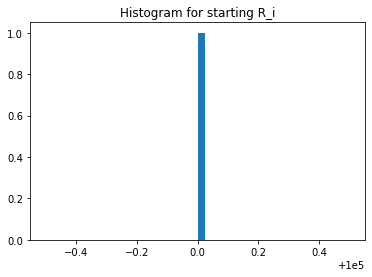

In [22]:
import matplotlib.pyplot as plt
a = starting_Ri.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_i")
plt.show()

In [23]:
experiments.UNI_Qi.unique()

array([200000., 350775., 349826., ..., 357260., 235443., 236442.])

In [24]:
experiments.UNI_Si.unique()

array([10000., 15222., 15073., 15148., 15050., 15129., 15197., 15173.,
       15099., 15123., 15146., 15169., 15200., 15225., 15096., 15195.,
       15075., 15171., 15147., 15118., 15125., 15151., 15126., 15152.,
       15176., 15249., 15180., 15203., 15120., 15150., 15128., 15149.,
       15104., 15094., 15170., 15097., 15248., 15101., 15155., 15098.,
       15127., 15124., 15154., 15175., 15100., 15121., 15223., 15072.,
       15174., 15071., 15119., 15122., 15145., 15144., 15177., 15196.,
       15172., 15102., 15199., 15157., 15153., 15131., 15198., 15074.,
       15143., 15178., 15227., 15077., 15095., 15049., 15130., 15190.,
       15193., 15105., 15220.])

In [25]:
experiments.UNI_Qj.unique()

array([200000., 227705., 226734., ..., 202912., 243358., 245110.])

In [26]:
experiments.UNI_Rj.unique()

array([100000.,  87879.,  88254., ...,  98570.,  82253.,  81666.])

In [27]:
starting_Rj = experiments[experiments.timestep == 0]
starting_Rj = starting_Rj['UNI_Rj']
starting_Rj.reset_index(drop=True)
starting_Rj.unique()

array([100000.])

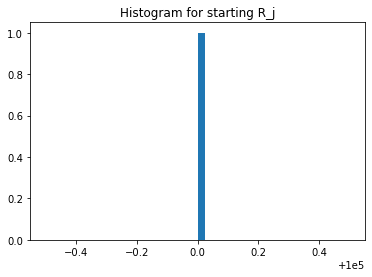

In [28]:
a = starting_Rj.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_j")
plt.show()

In [29]:
experiments.UNI_Sj.unique()

array([10000], dtype=int64)

In [30]:
experiments.UNI_ij.unique()

array([100000.])

In [31]:
experiments.UNI_ji.unique()

array([100000.])

In [32]:
experiments.UNI_Sij.unique()

array([1.e+10])

What are the trade sizes?

In [33]:
experiments.trade_random_size.unique()

array([1000,  992,  949,  971, 1043, 1097, 1017,  973,  957,  933,  988,
       1045, 1032, 1088, 1046, 1012,  984, 1100,  961, 1147,  974,  977,
       1023, 1010, 1076,  916,  926,  951, 1050,  952, 1002, 1018,  979,
        908, 1034, 1015, 1020,  989,  948, 1099,  969, 1104,  999, 1051,
       1054, 1055, 1006,  913,  965,  997, 1009, 1024, 1029,  963, 1057,
        943, 1030,  958, 1059, 1004, 1001,  945,  874, 1072, 1003, 1060,
       1107, 1035, 1052, 1044, 1105,  928, 1025, 1053, 1033,  889,  995,
        976,  978, 1036,  967, 1056,  998,  935, 1048, 1073, 1021,  944,
        980, 1067,  962, 1083,  946,  953,  994, 1127,  970,  956,  937,
        968,  927,  915, 1007,  959, 1077, 1119, 1156, 1008, 1063, 1084,
       1136,  986,  904,  981, 1016, 1069,  964, 1037, 1040, 1075, 1078,
        983, 1065, 1031, 1047,  910,  876, 1013,  991, 1039,  901, 1019,
       1079,  947,  903, 1058, 1061, 1102,  996, 1011, 1042,  954,  985,
        917, 1090, 1098,  920,  892,  960,  950, 10

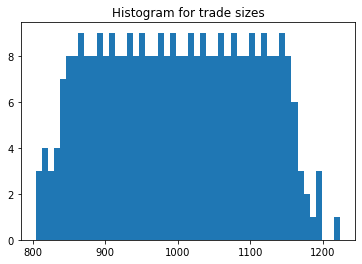

In [34]:
b = experiments.trade_random_size.unique()
_ = plt.hist(b, bins=50)  # arguments are passed to np.histogram
plt.title("Histogram for trade sizes")
#plt.xlim(-2000, 20000)
plt.show()

In [35]:
experiments.asset_random_choice.unique()

array(['i', 'j'], dtype=object)

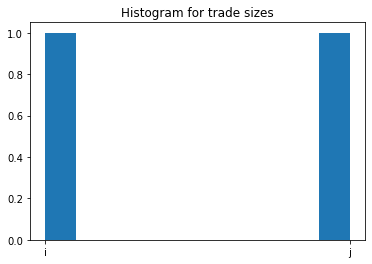

In [36]:
c = experiments.asset_random_choice.unique()
_ = plt.hist(c, bins=10)  # arguments are passed to np.histogram
plt.title("Histogram for trade sizes")
#plt.xlim(-2000, 20000)
plt.show()

In [37]:
def get_M(k, v):
    if k == 'sim_config':
        k, v = 'M', v['M']
    return k, v

config_ids = [
    dict(
        get_M(k, v) for k, v in config.__dict__.items() if k in ['simulation_id', 'run_id', 'sim_config', 'subset_id']
    ) for config in configs
]

# Agent sequences

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


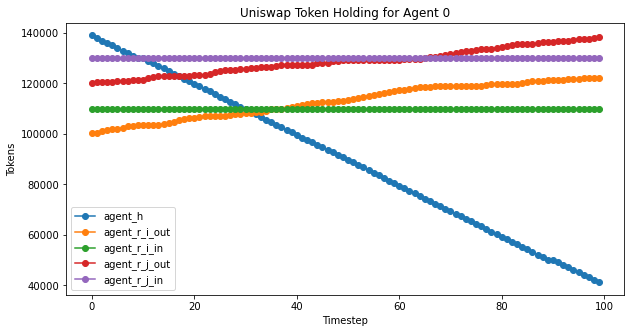

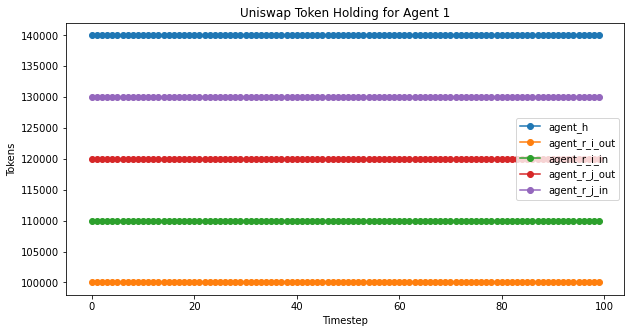

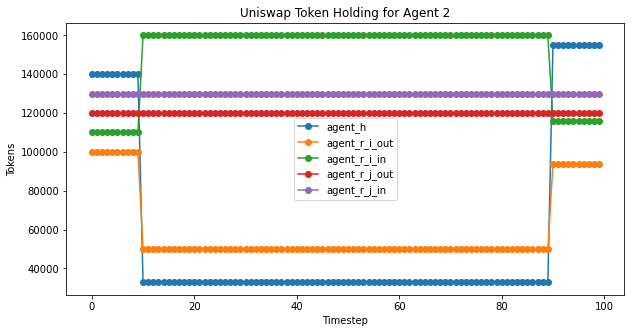

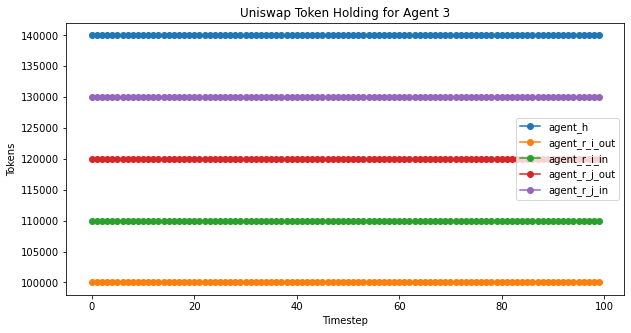

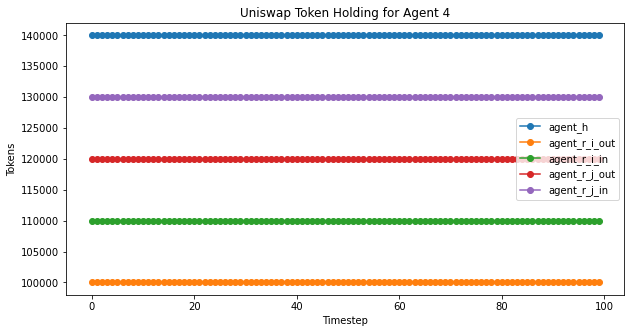

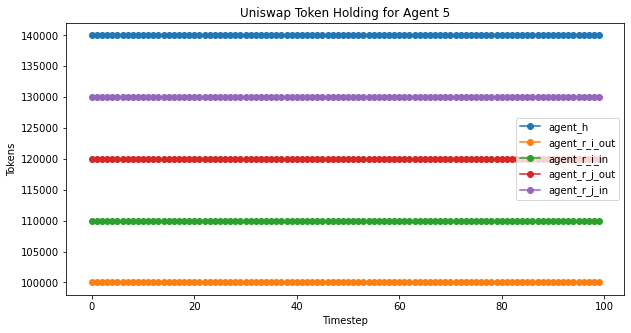

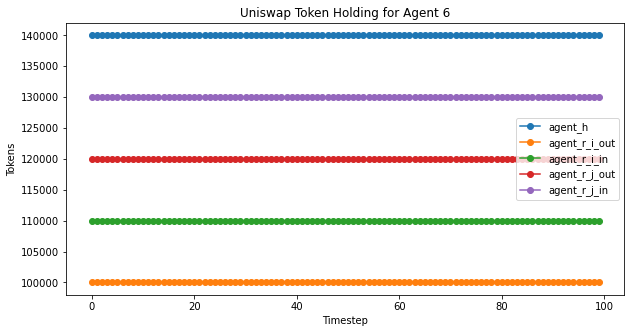

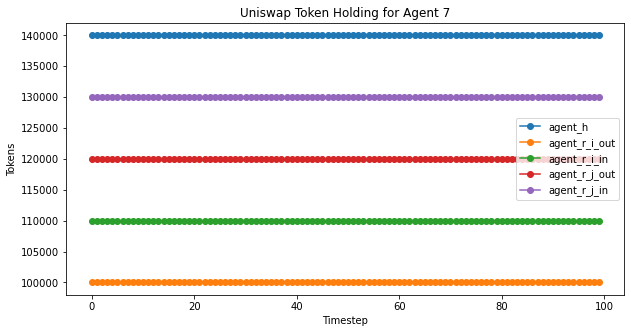

In [38]:
agent_plot(experiment2,'Uniswap Token Holding for Agent ', 100) #,4,'j')

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


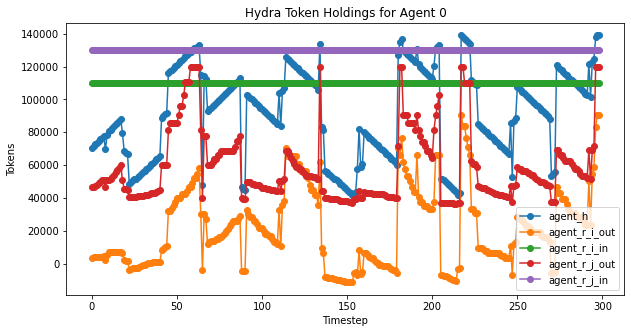

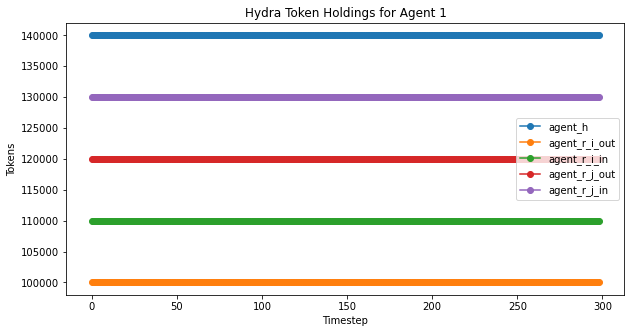

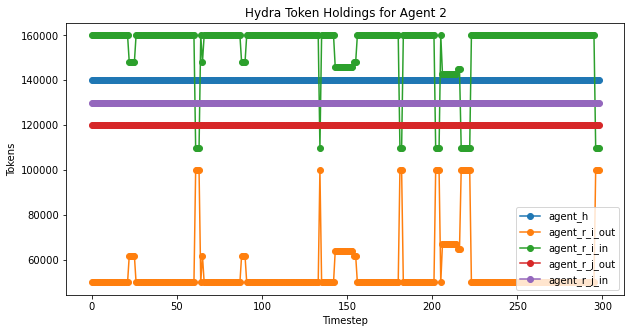

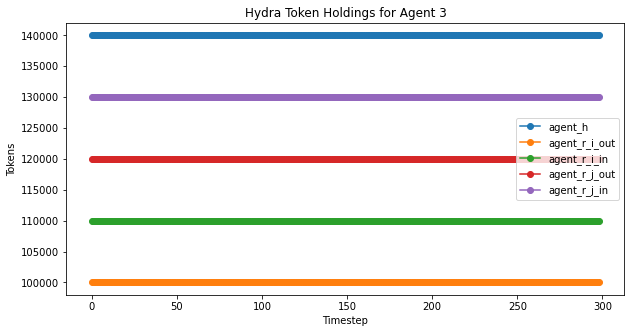

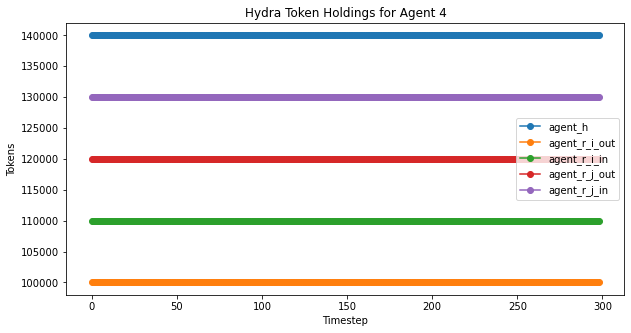

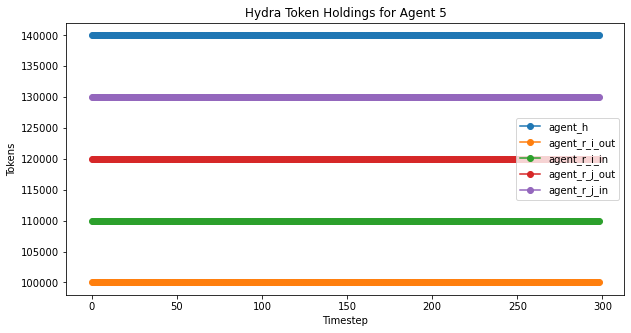

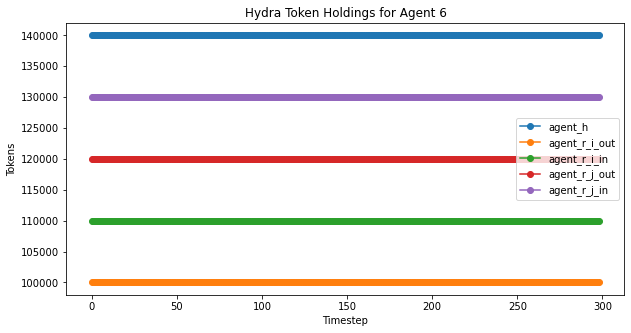

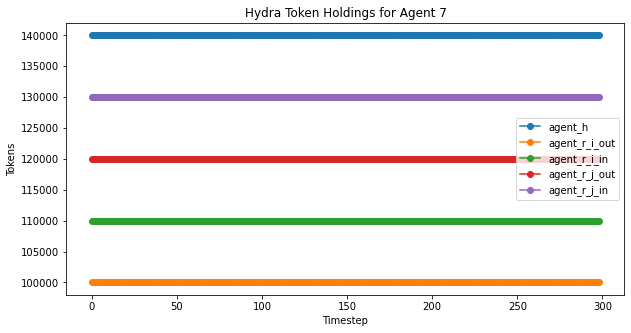

In [39]:
hydra_agent_plot(experiments,'Hydra Token Holdings for Agent ', 299)

# Liquidity dynamics

Movement of the Uniswap variables

- 'UNI_Ri', 'UNI_Qi', 'UNI_Si'
- 'UNI_Rj', 'UNI_Qj', 'UNI_Sj'
- 'UNI_ij', 'UNI_ji', 'UNI_Sij'

## Uniswap -- Ri-Q instance

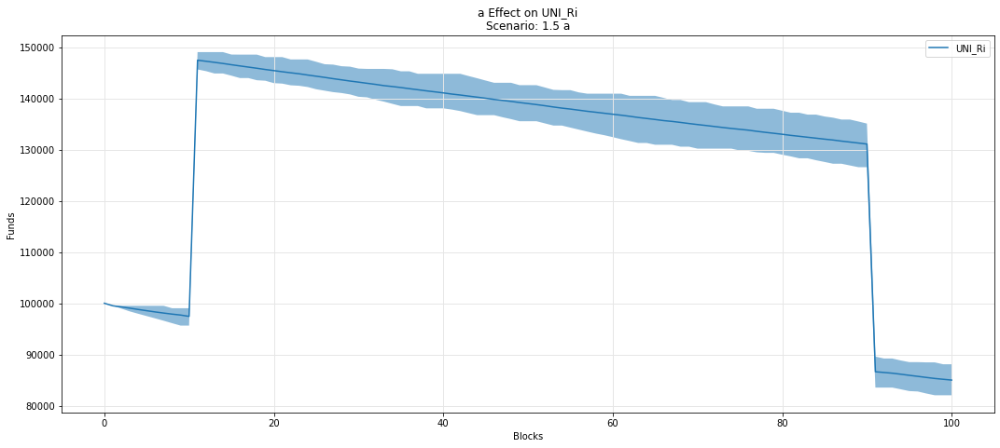

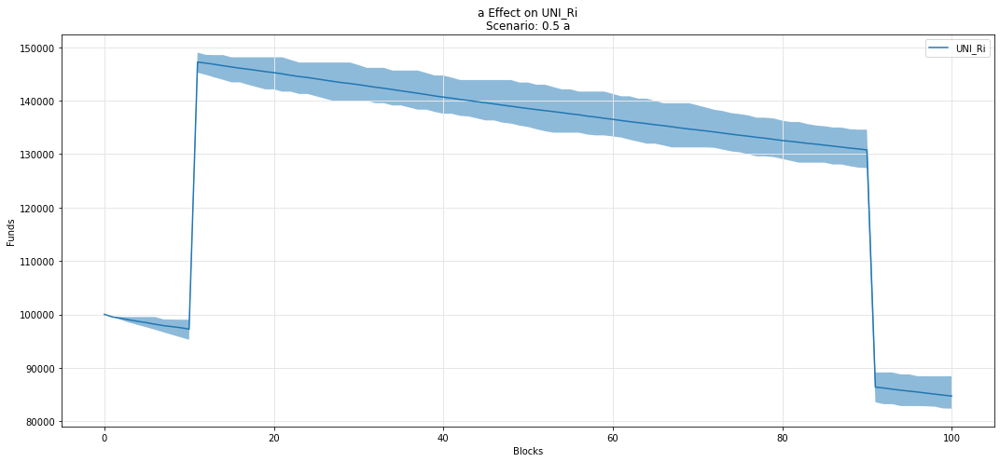

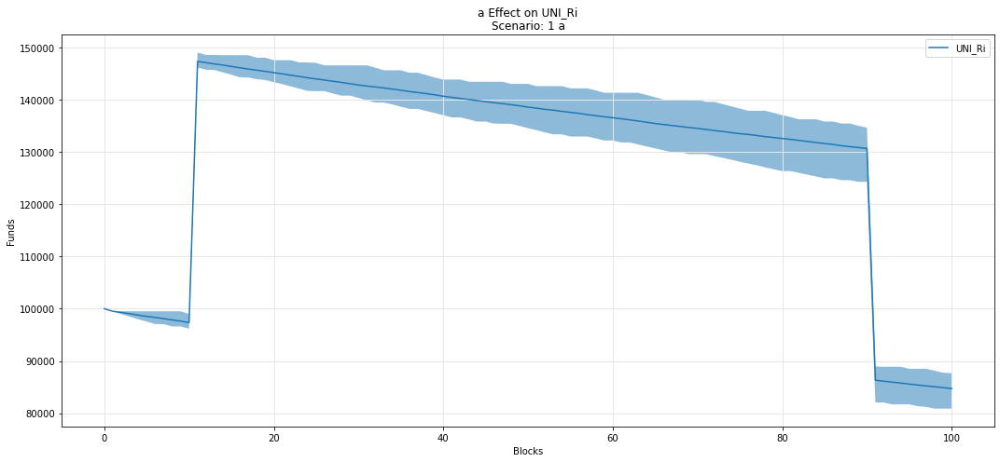

In [40]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Ri')

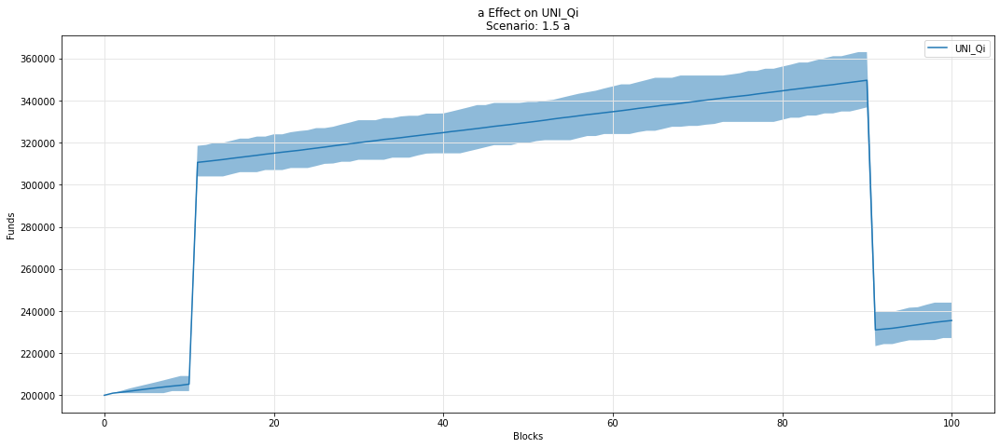

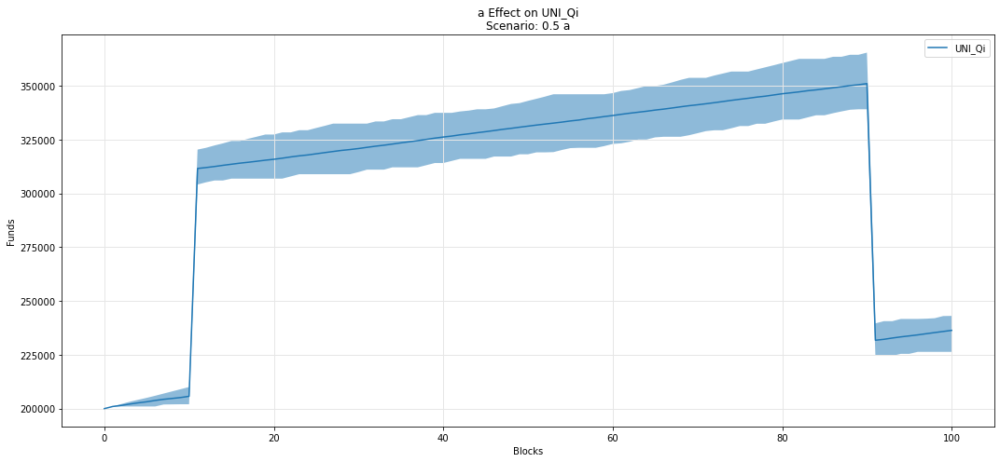

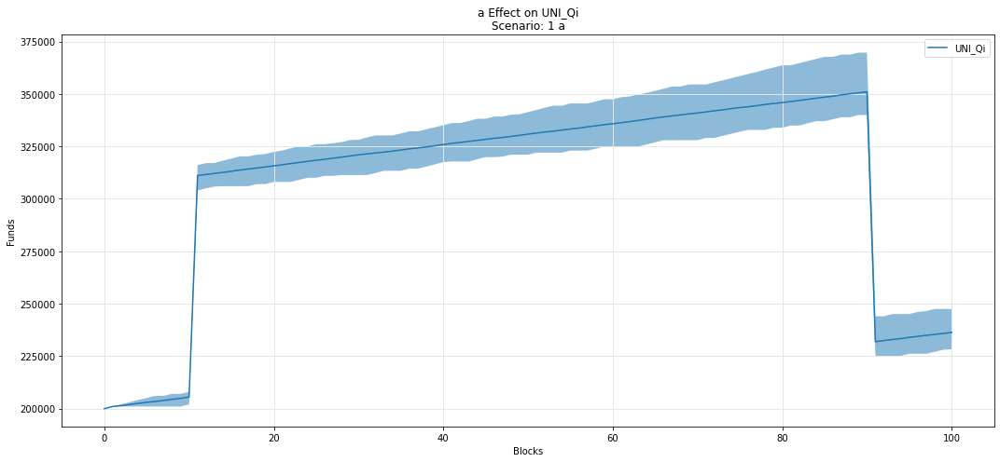

In [41]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qi')

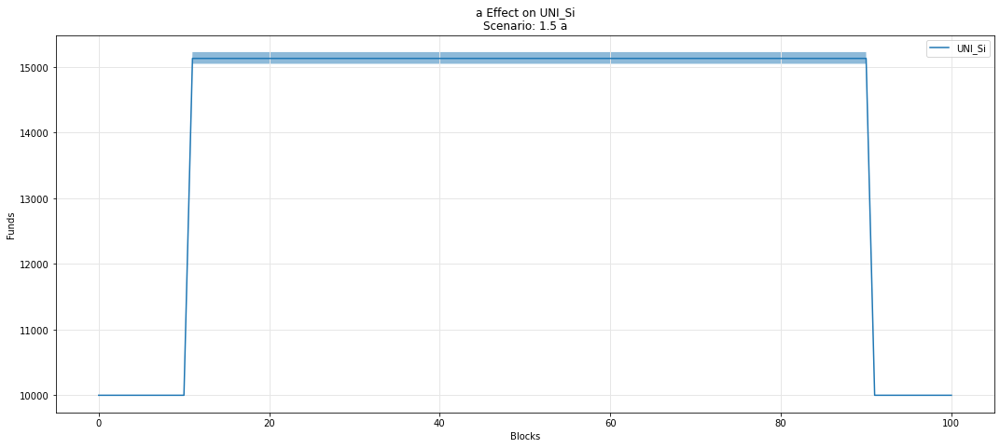

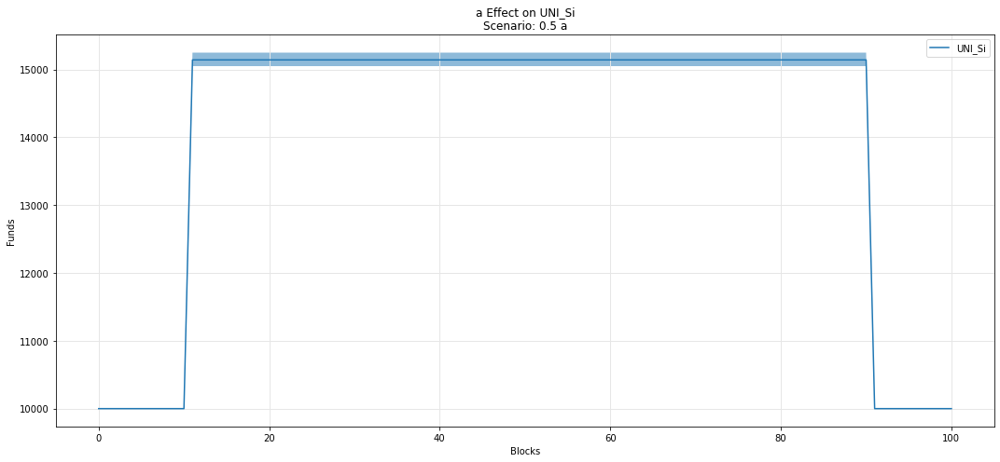

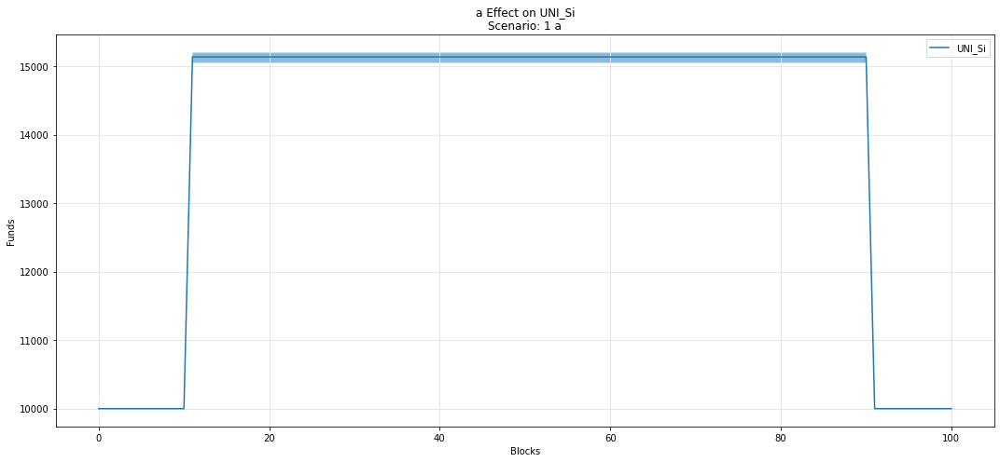

In [42]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Si')

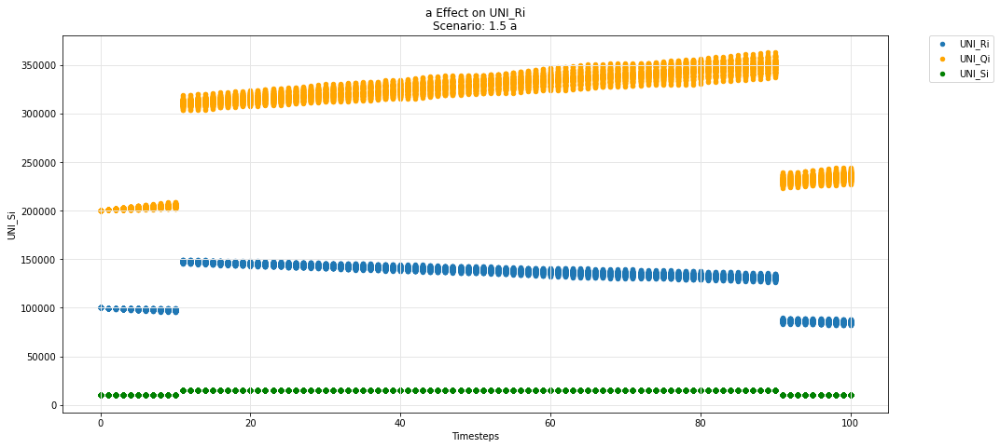

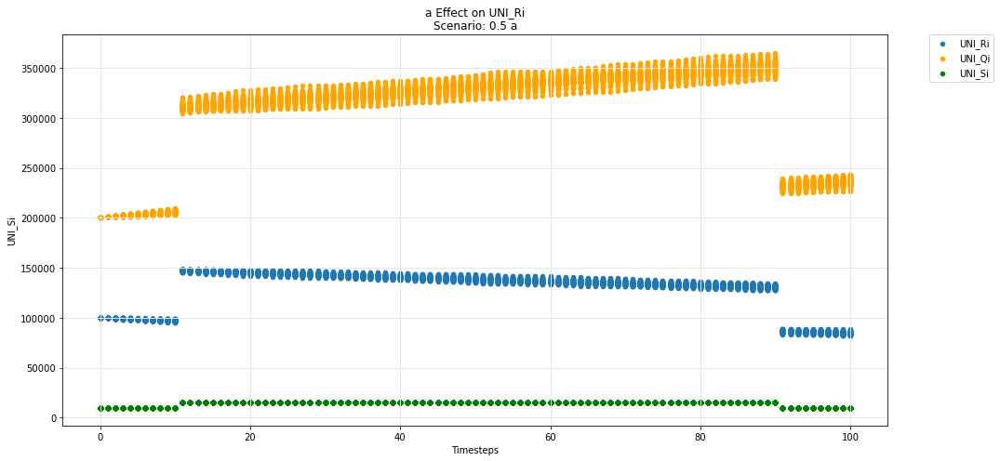

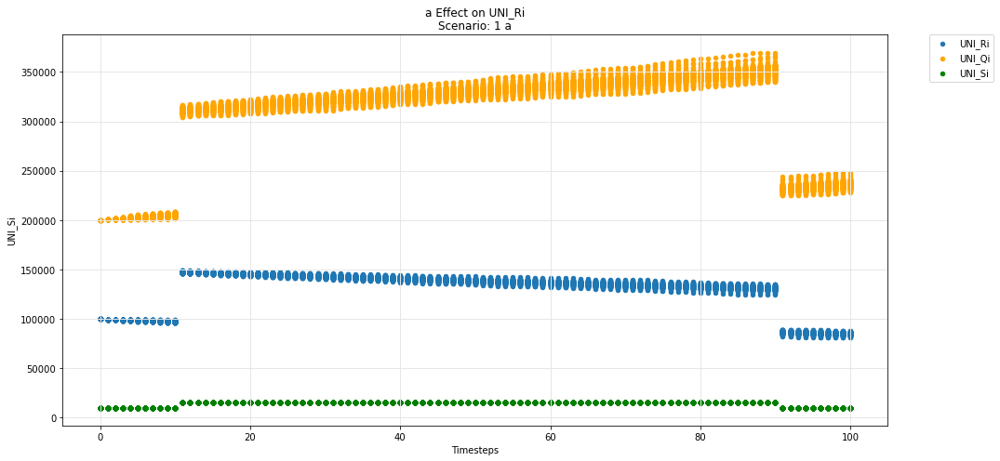

In [43]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Ri', 'UNI_Qi', 'UNI_Si')

## Uniswap -- Rj-Q instance

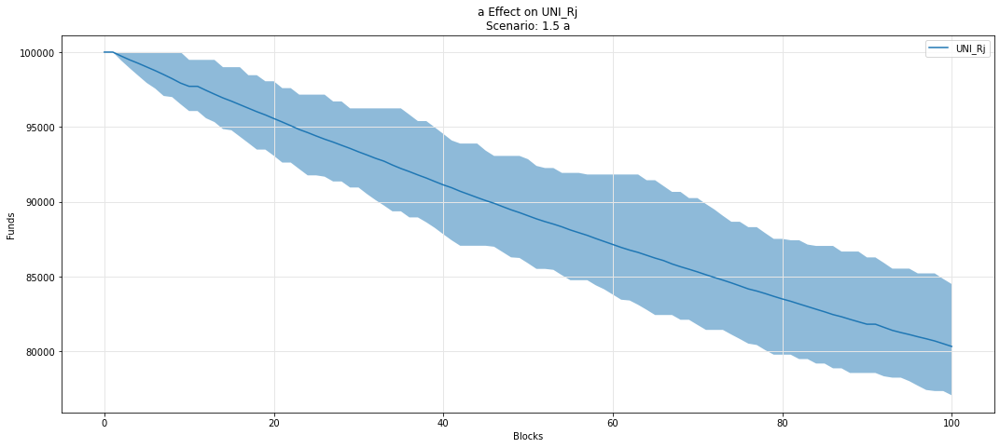

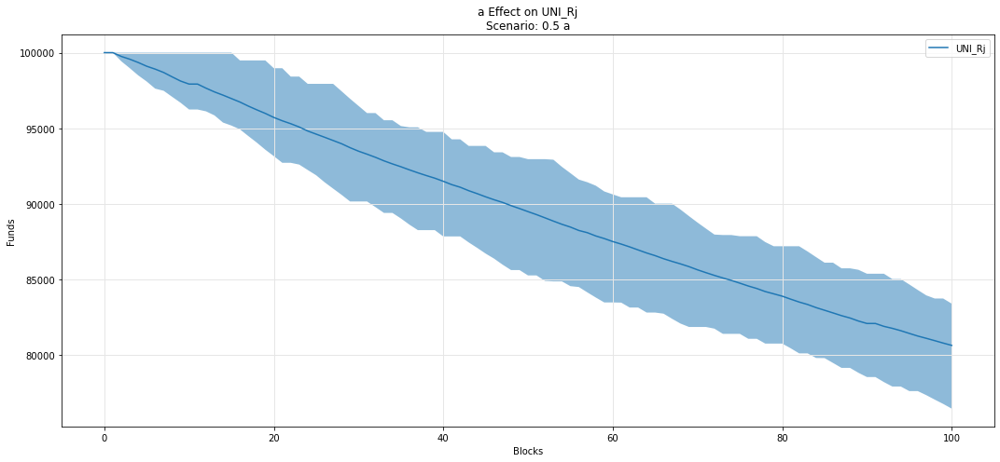

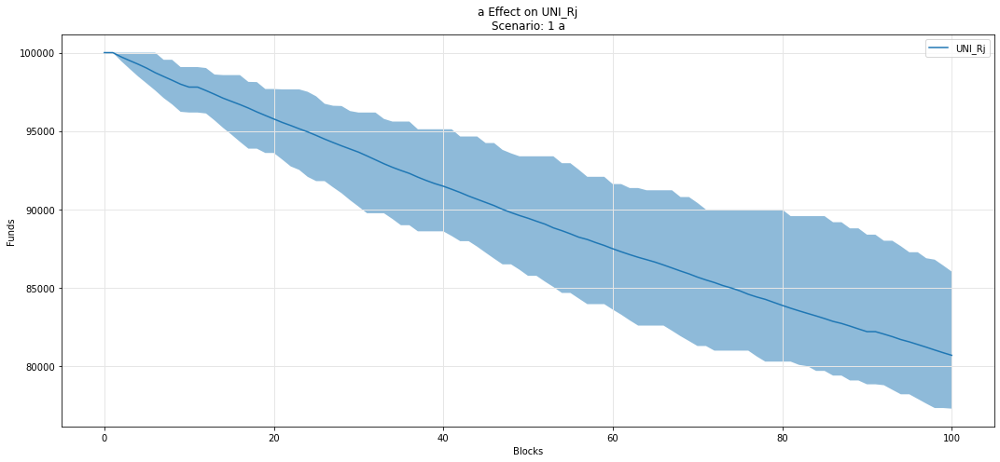

In [44]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Rj')

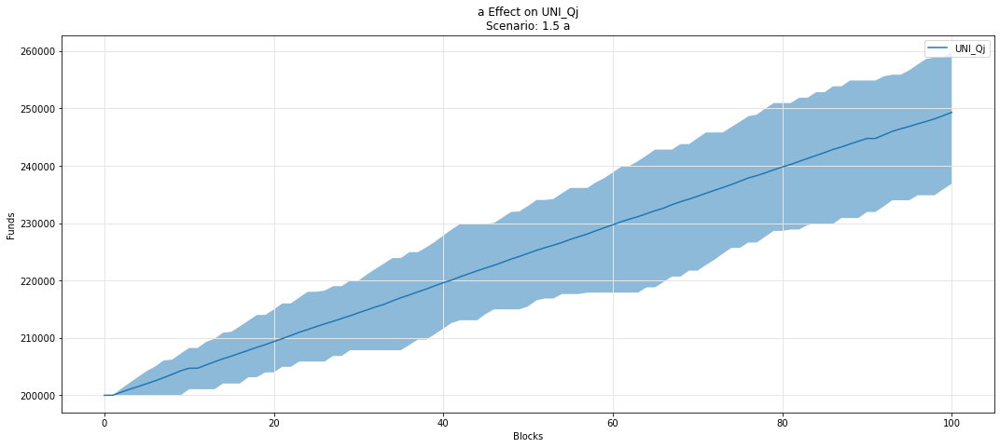

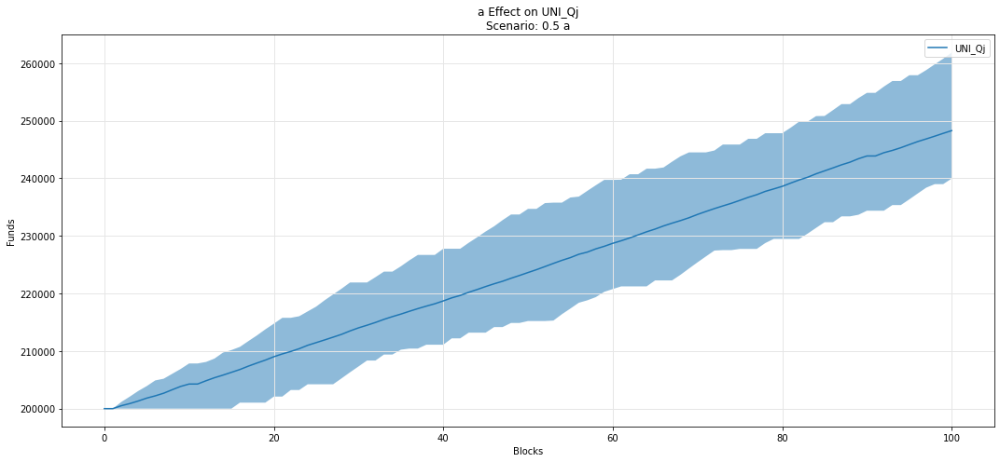

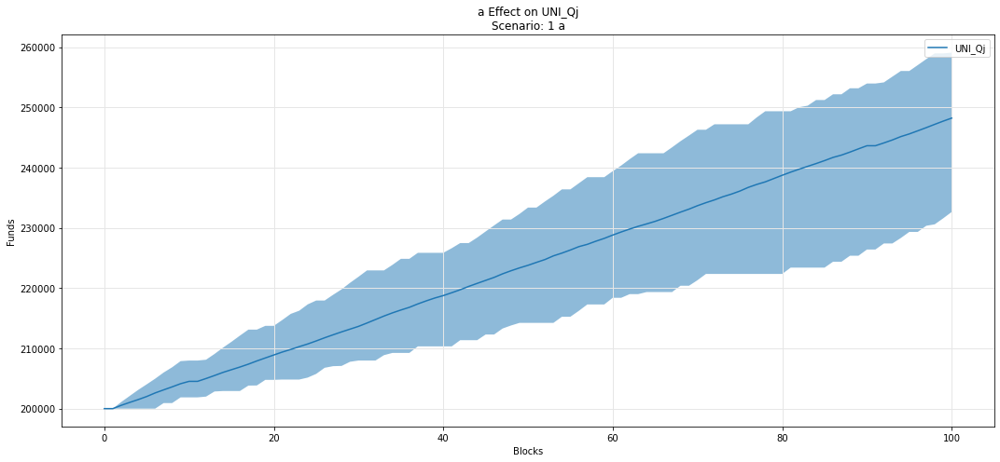

In [45]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qj')

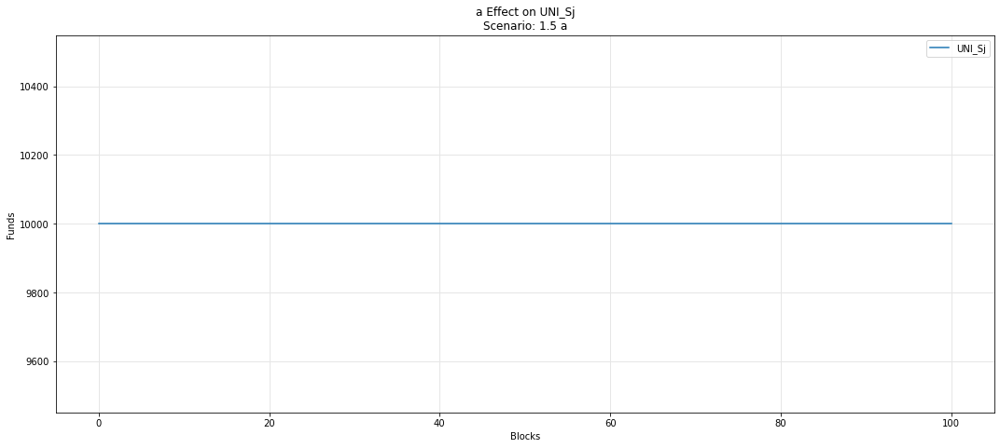

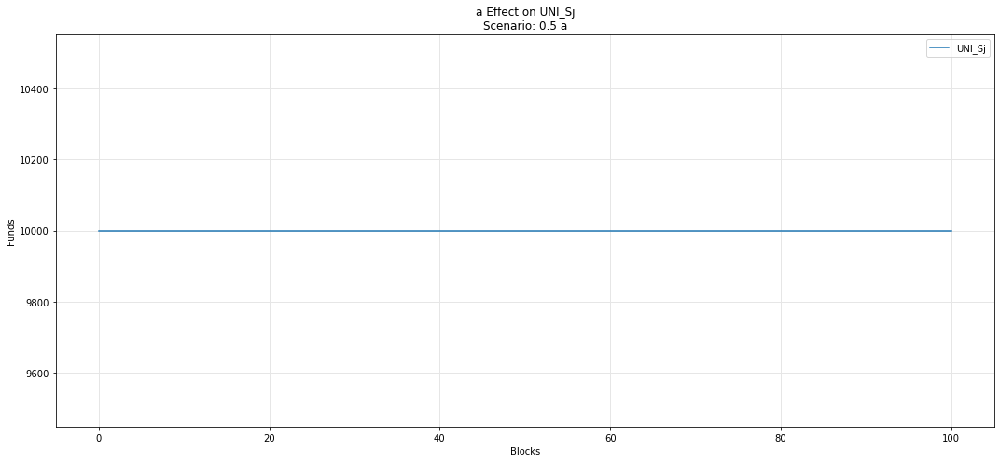

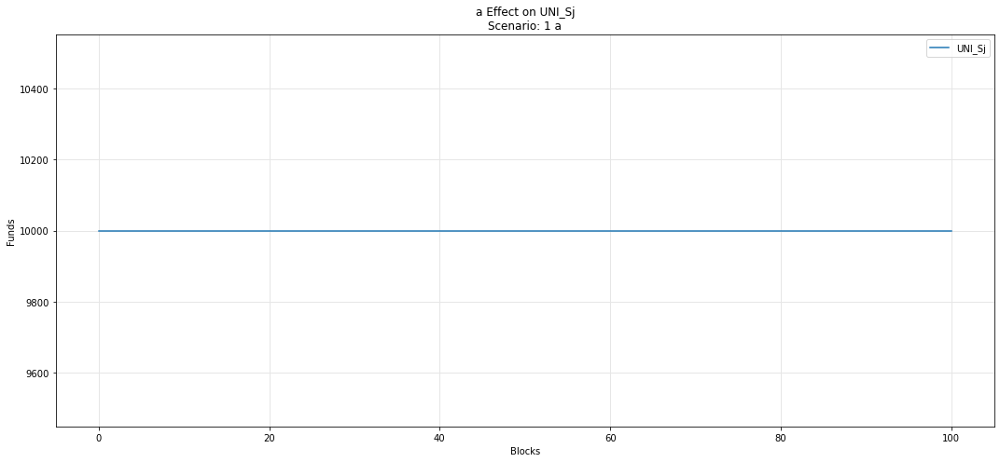

In [46]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sj')

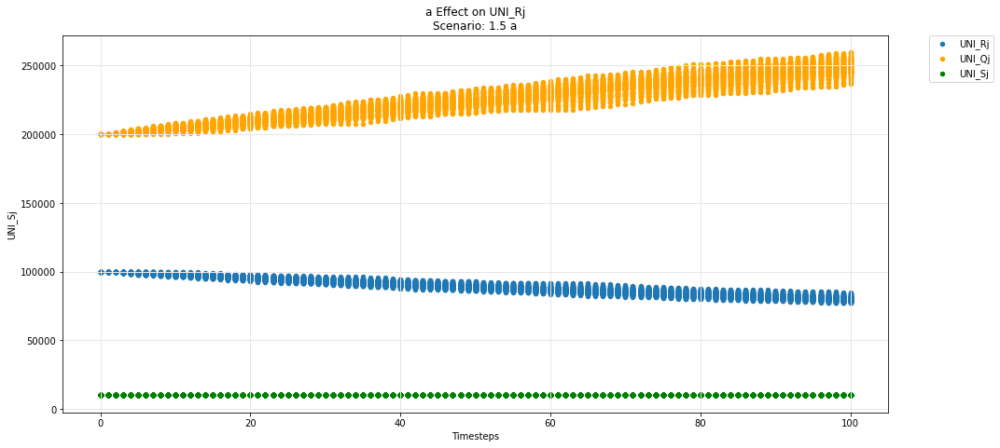

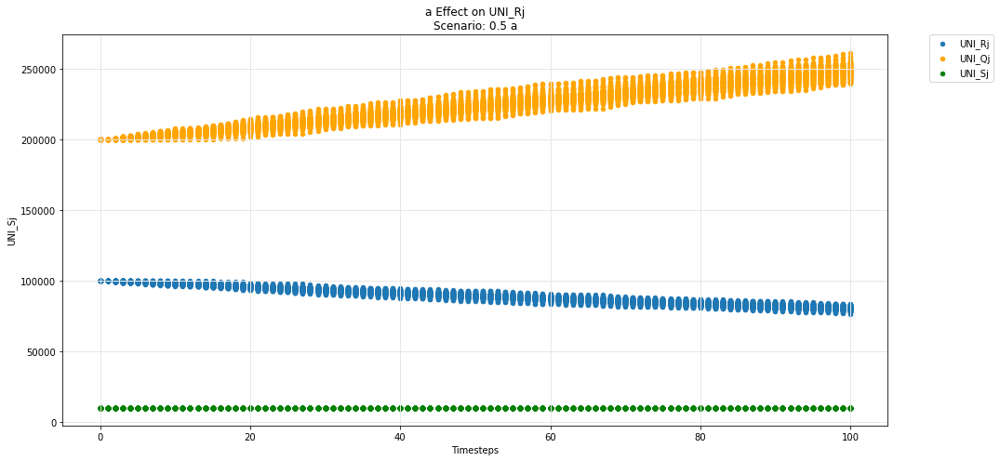

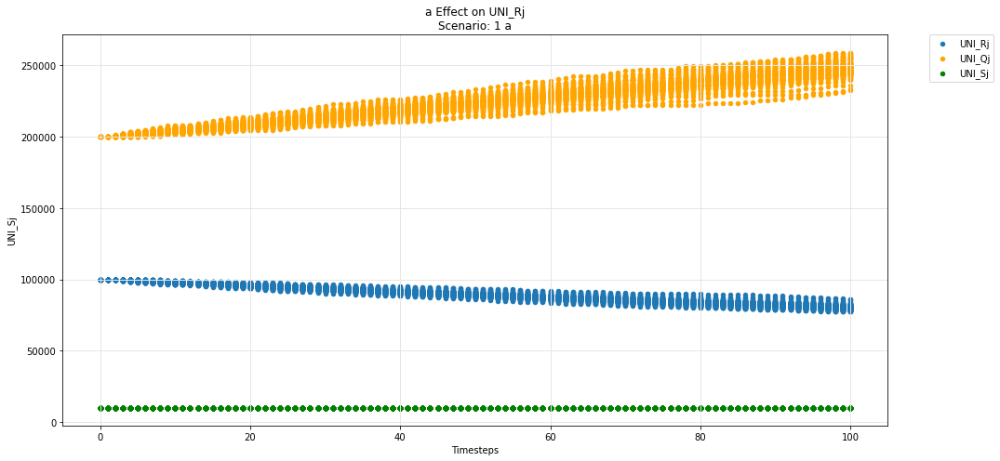

In [47]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Rj', 'UNI_Qj', 'UNI_Sj')

## Uniswap -- ij-Q instance

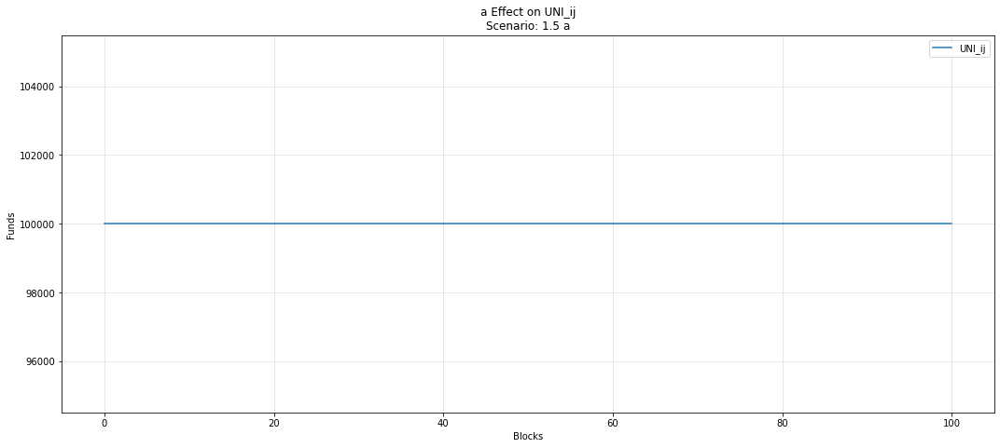

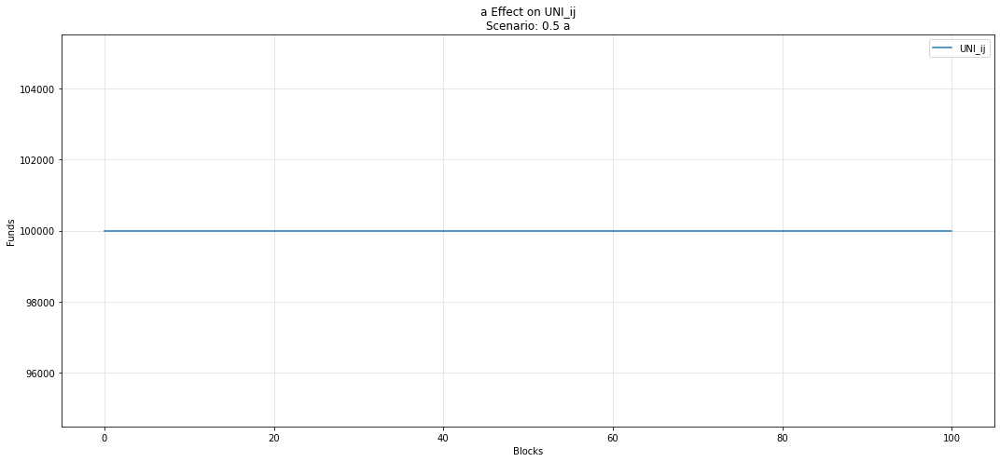

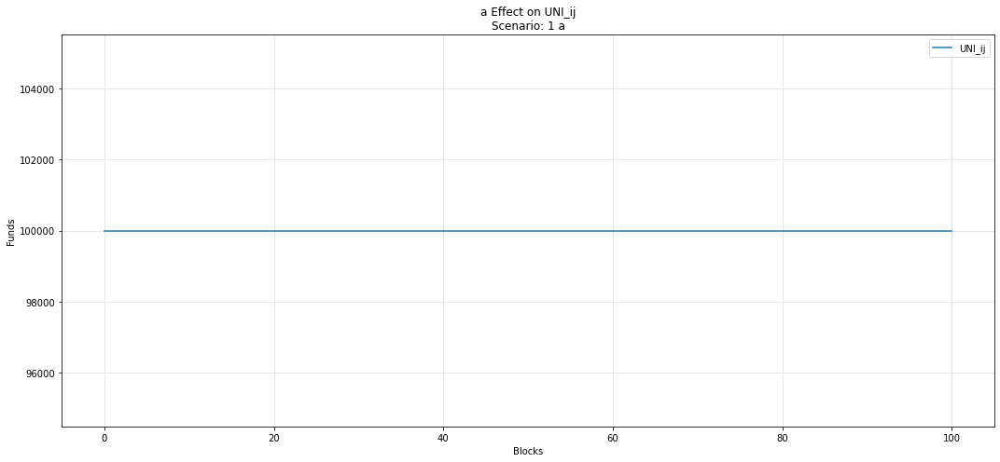

In [48]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ij')

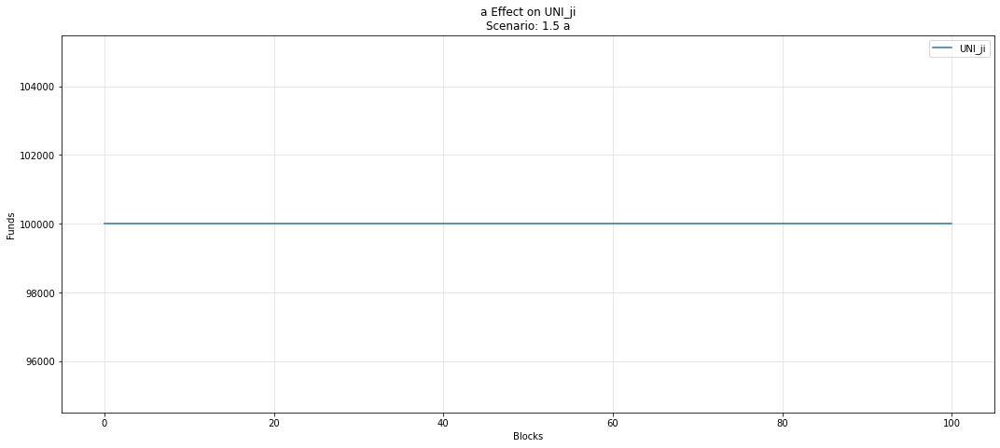

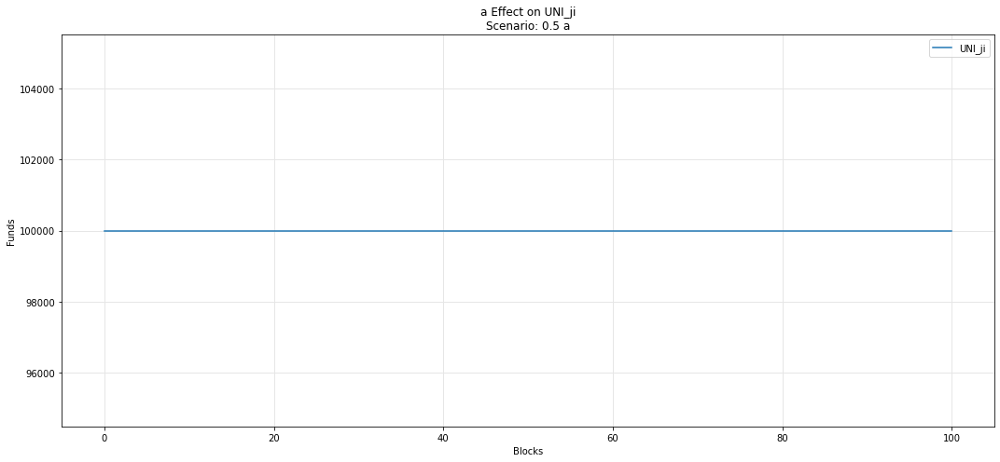

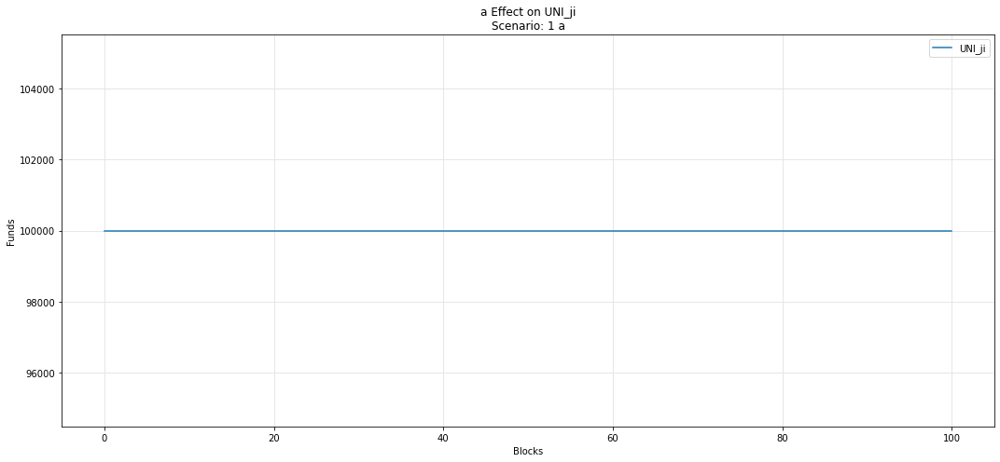

In [49]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ji')

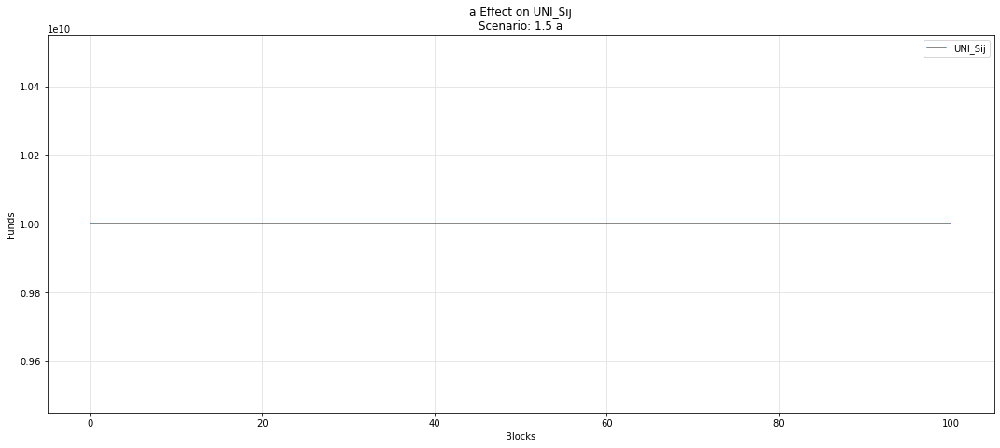

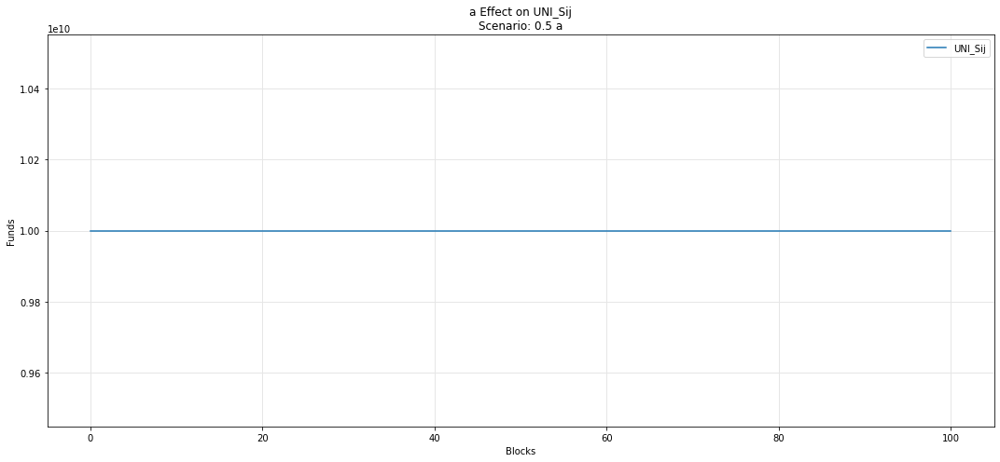

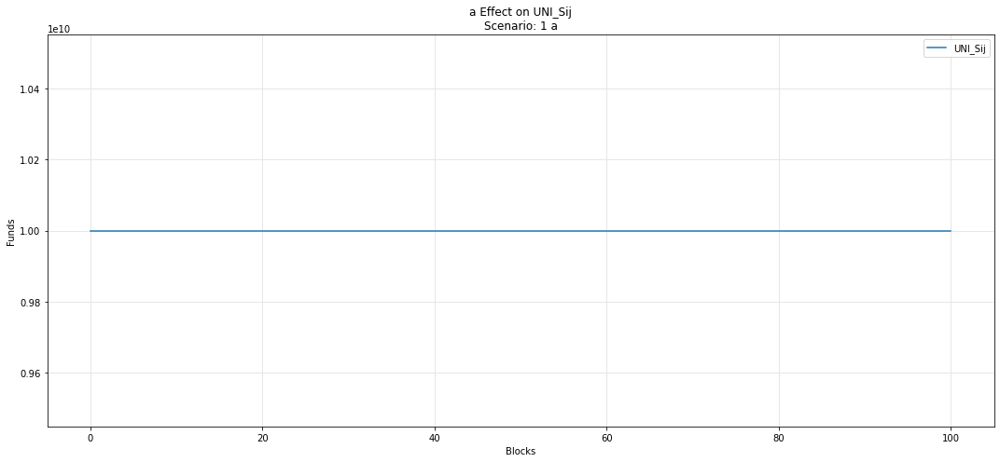

In [50]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sij')

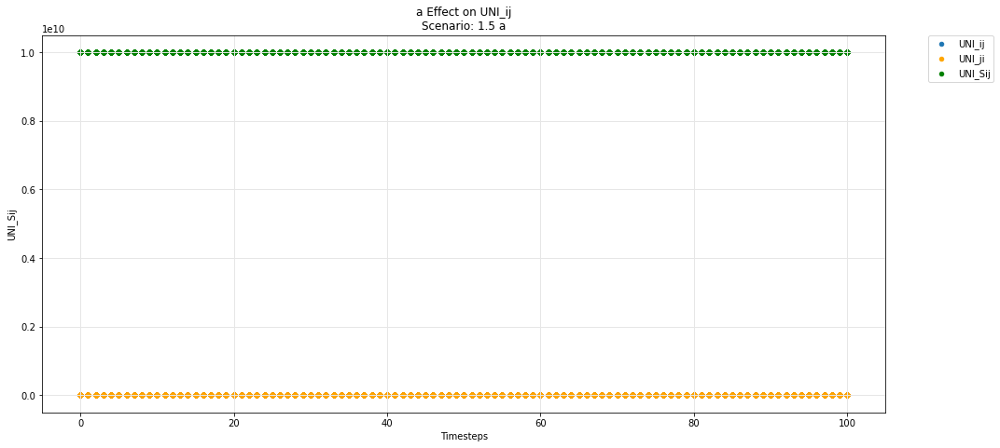

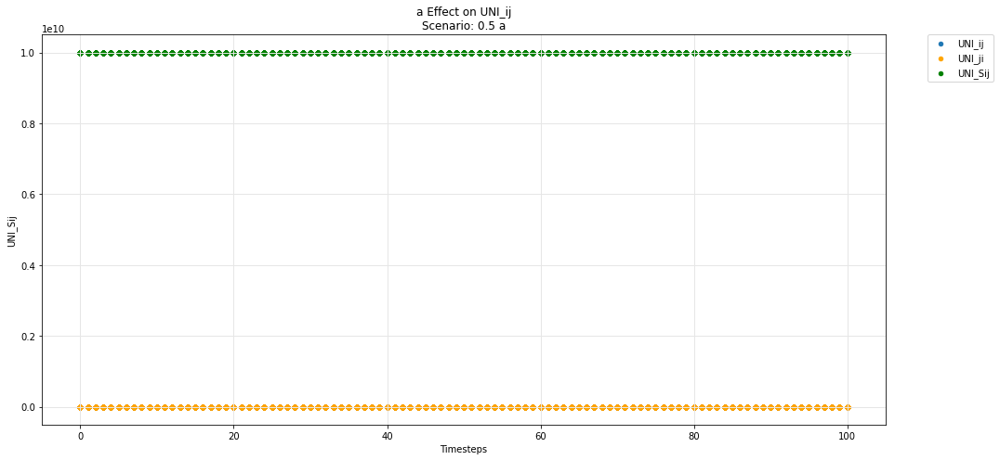

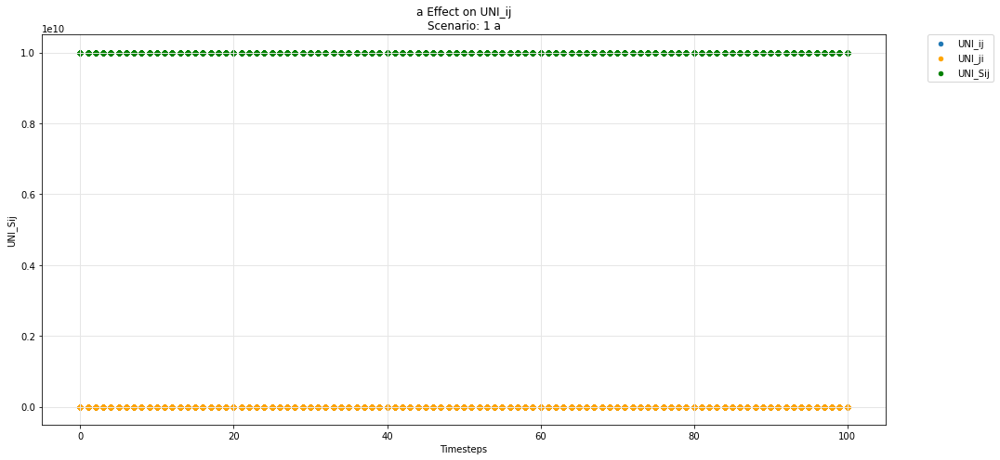

In [51]:
param_test_plot(experiments, config_ids, 'a', 'UNI_ij', 'UNI_ji', 'UNI_Sij')

## Hydra -- base

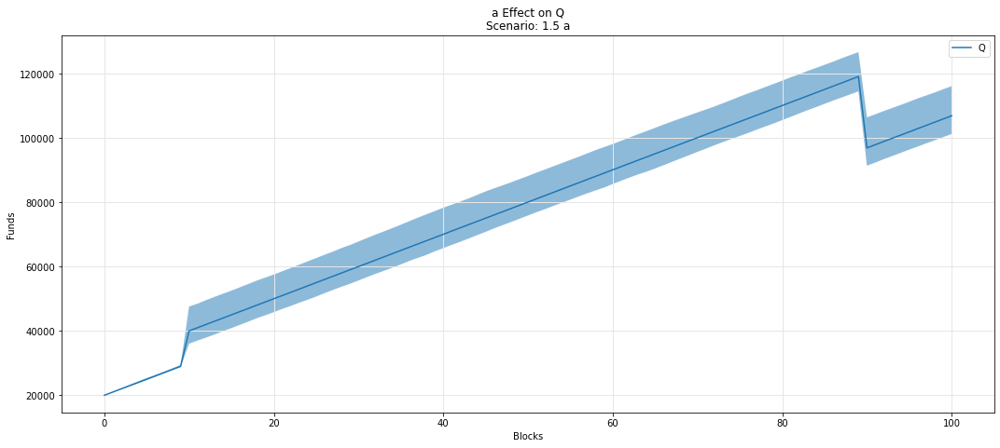

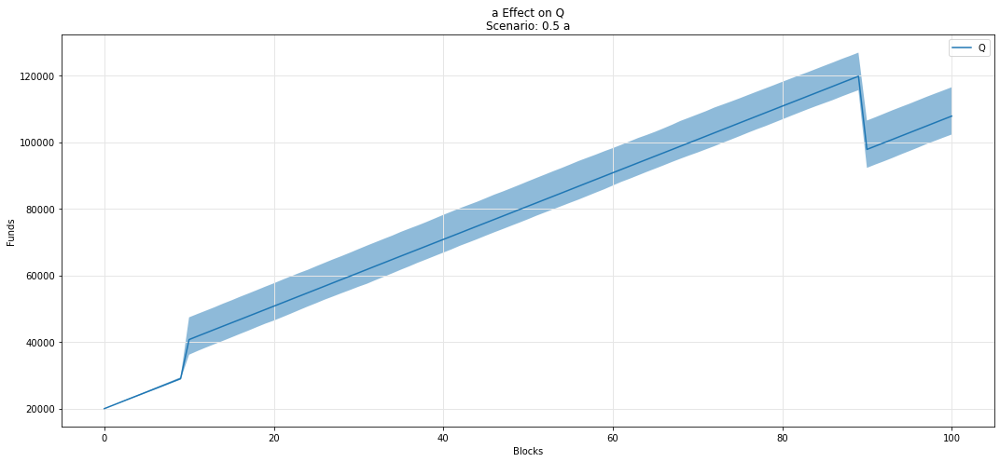

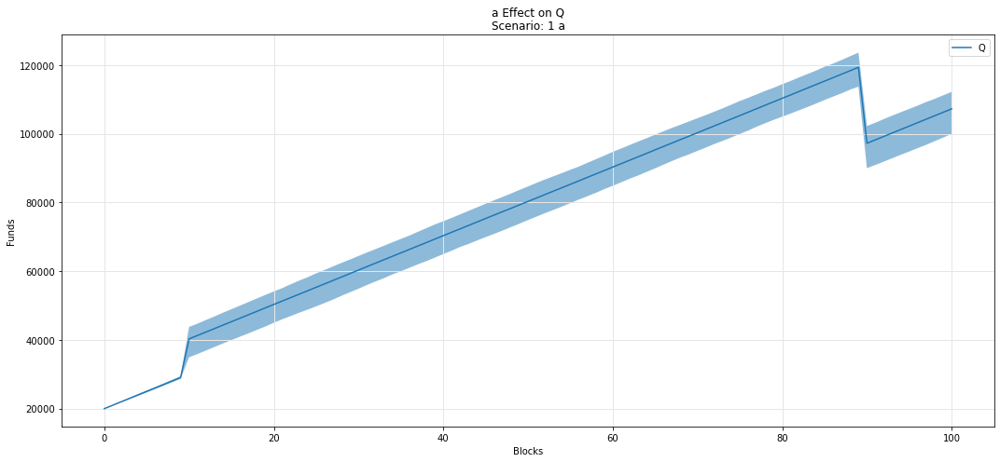

In [52]:
param_fan_plot3(experiments, config_ids, 'a','Q')

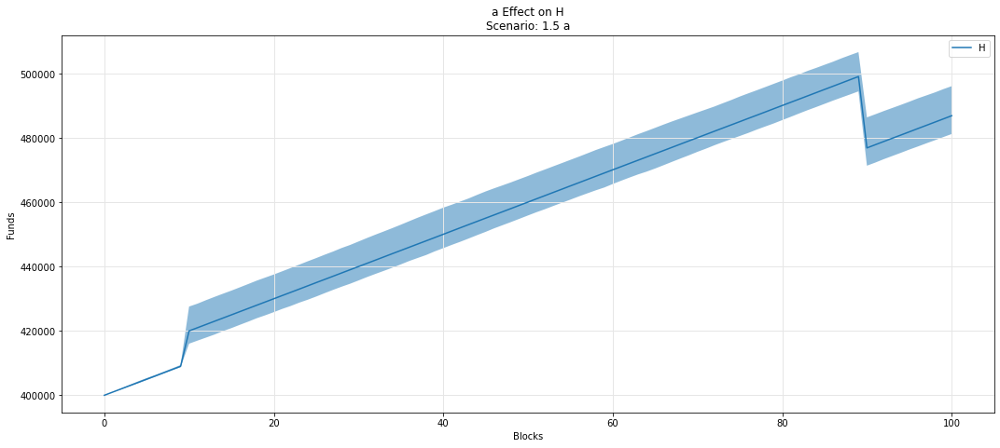

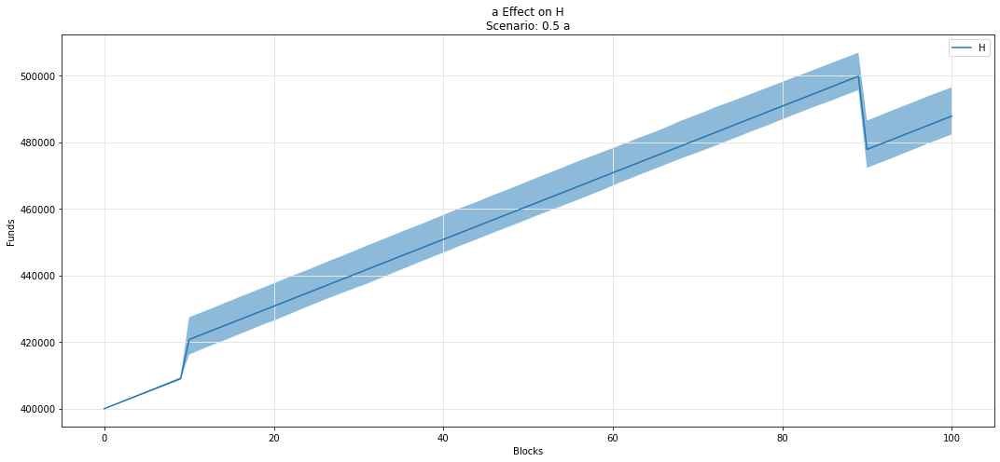

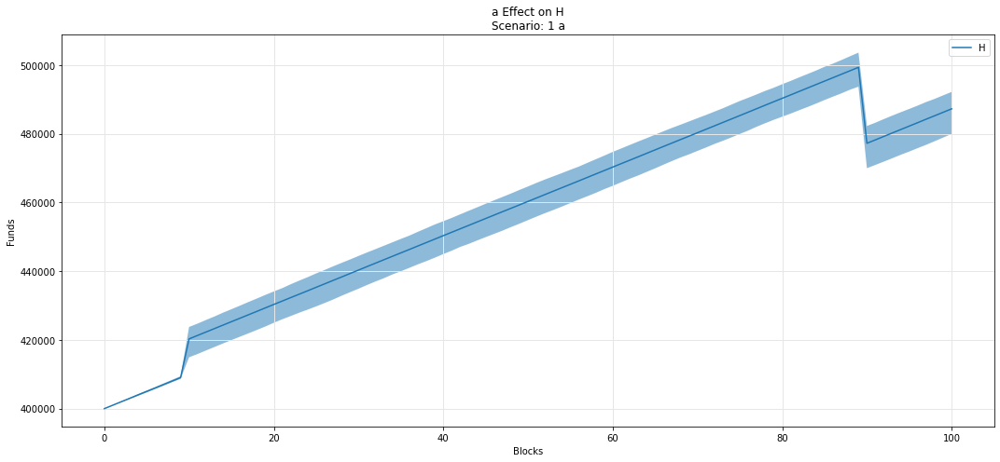

In [53]:
param_fan_plot3(experiments, config_ids, 'a','H')

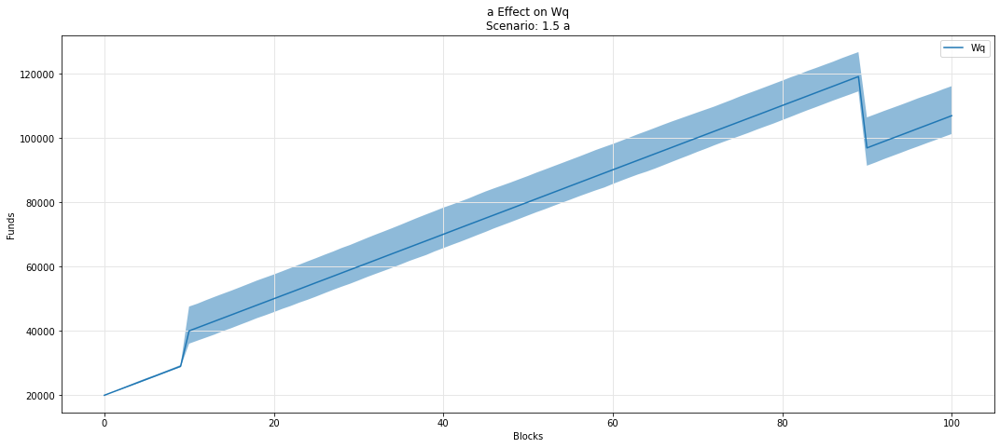

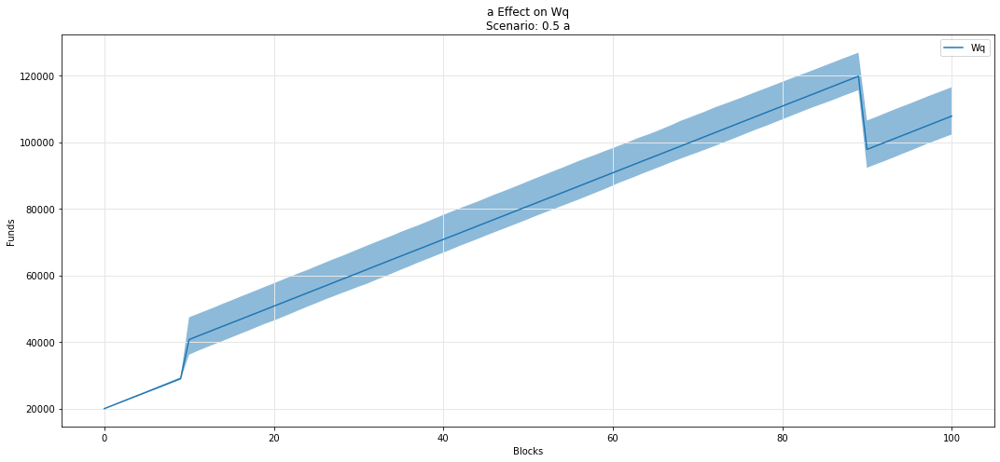

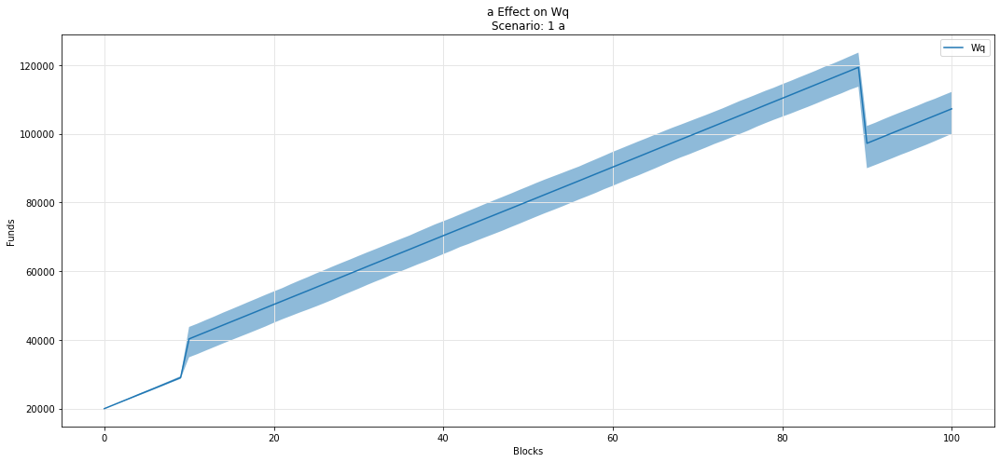

In [54]:
param_fan_plot3(experiments, config_ids, 'a','Wq')

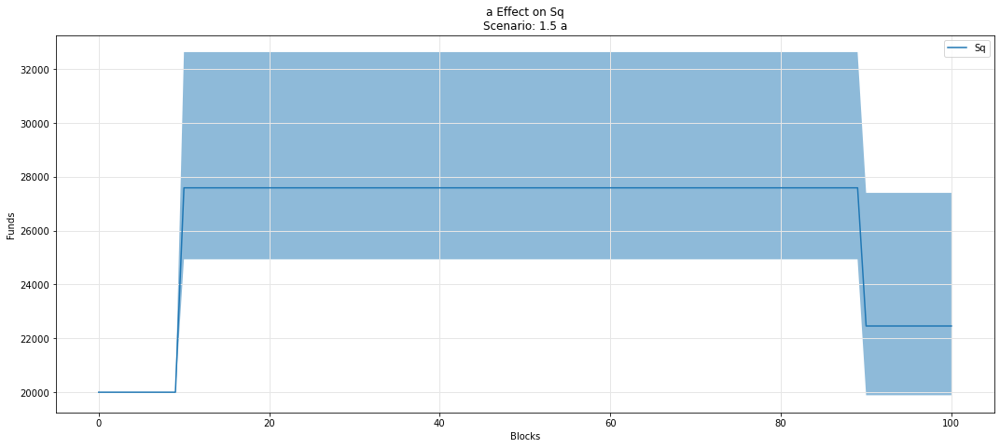

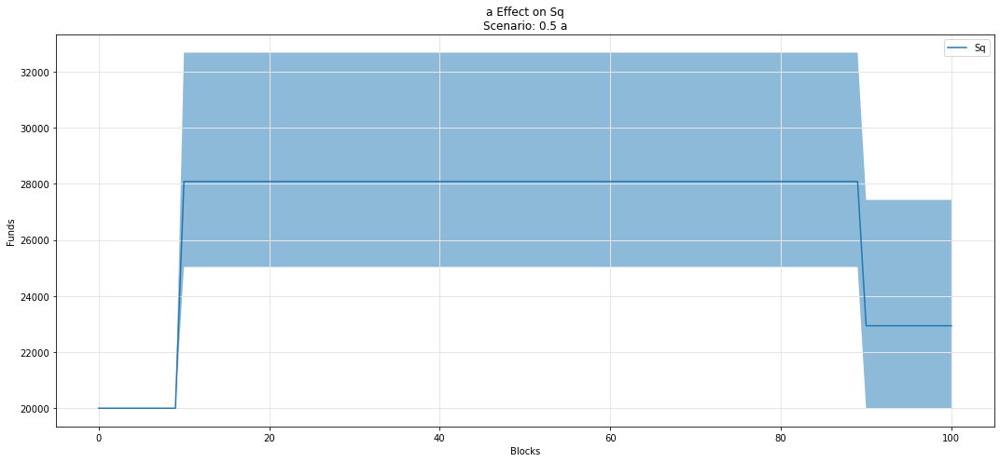

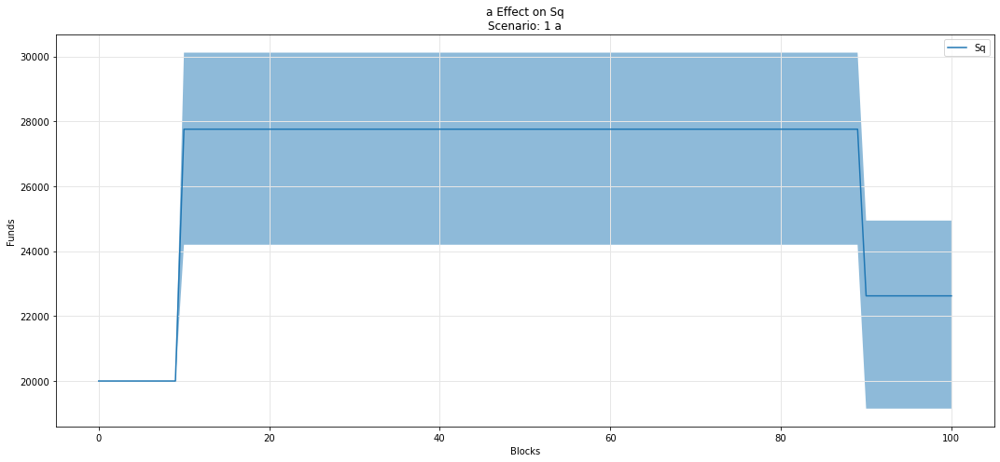

In [55]:
param_fan_plot3(experiments, config_ids, 'a','Sq')

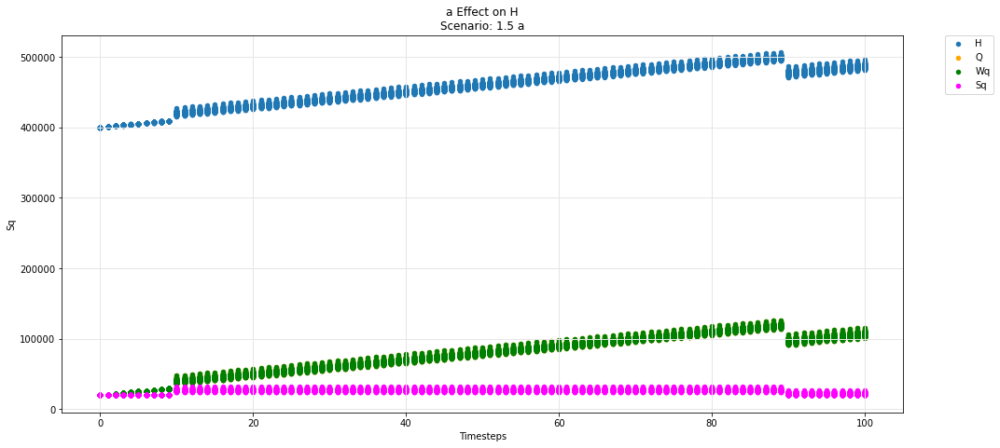

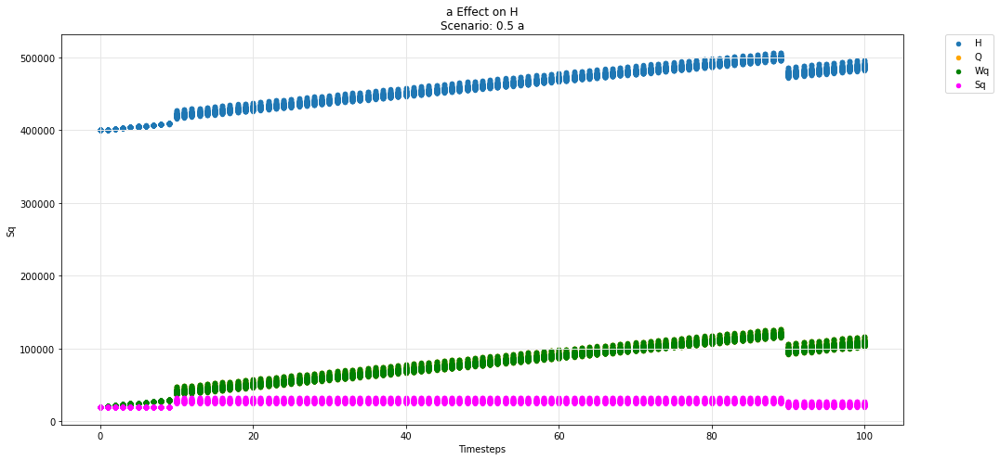

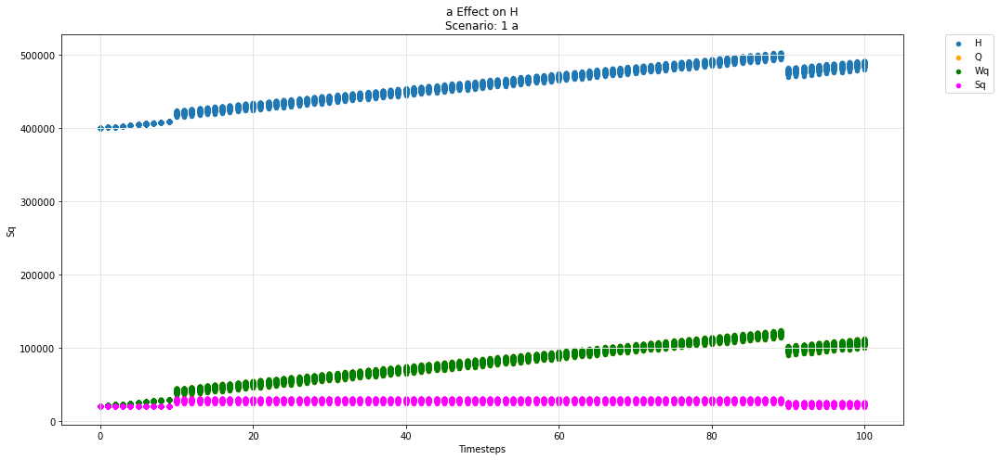

In [56]:
param_test_plot(experiments, config_ids, 'a', 'H', 'Q', 'Wq', 'Sq')

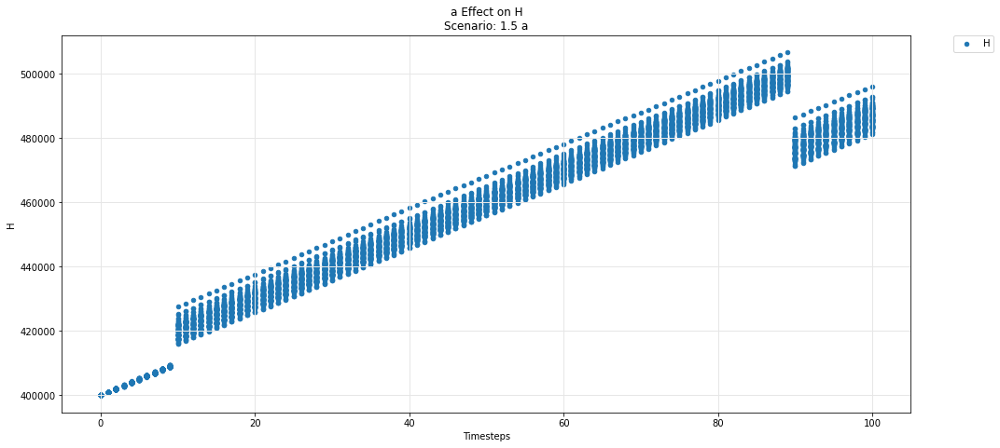

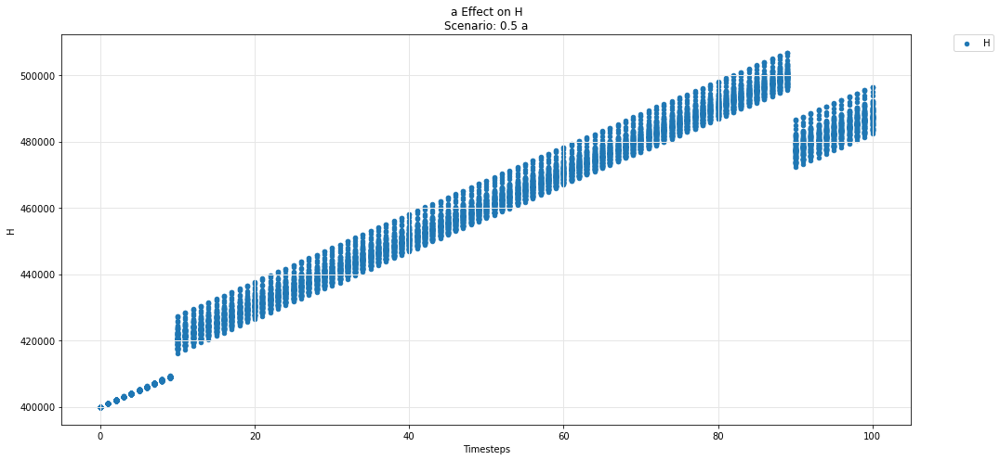

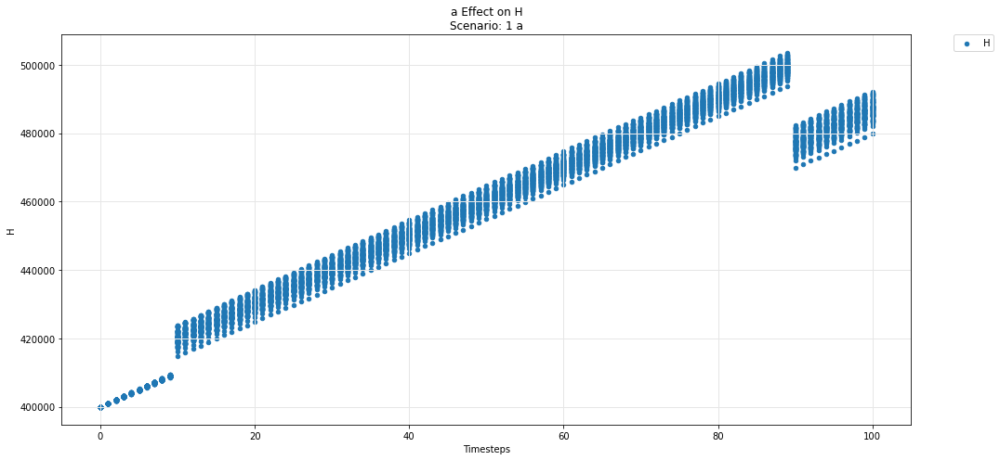

In [57]:
param_test_plot(experiments, config_ids, 'a', 'H')

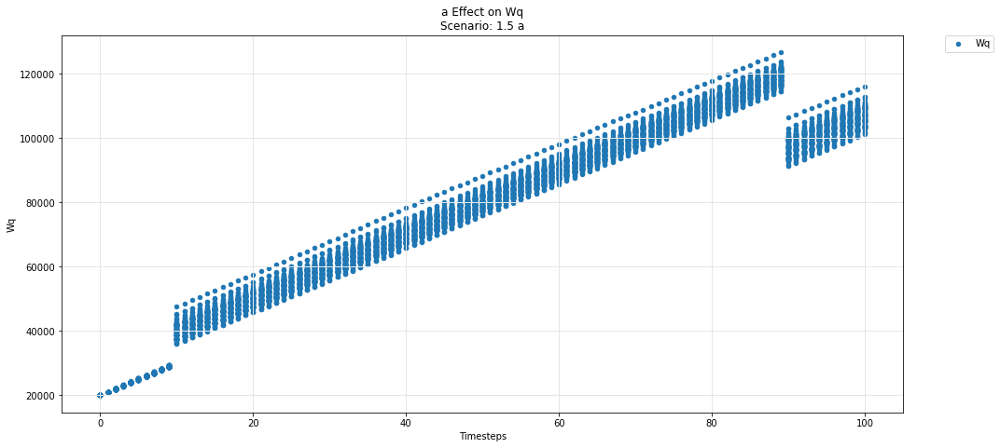

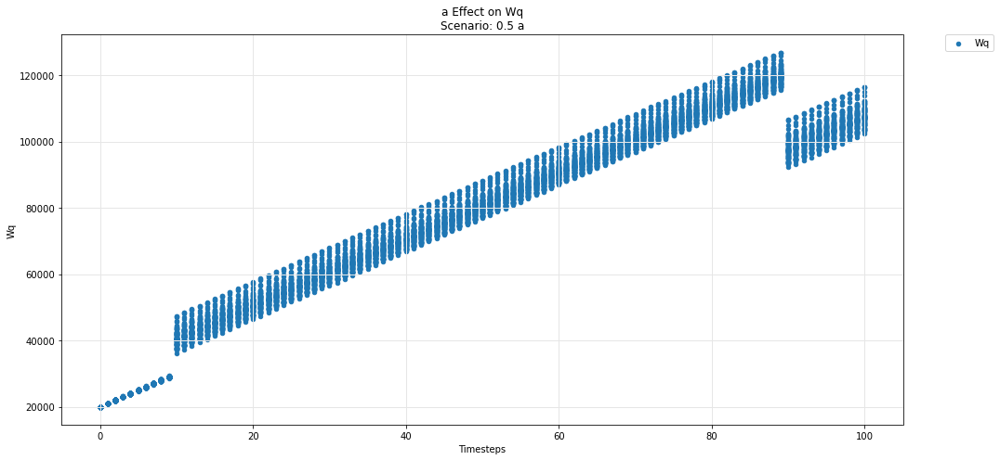

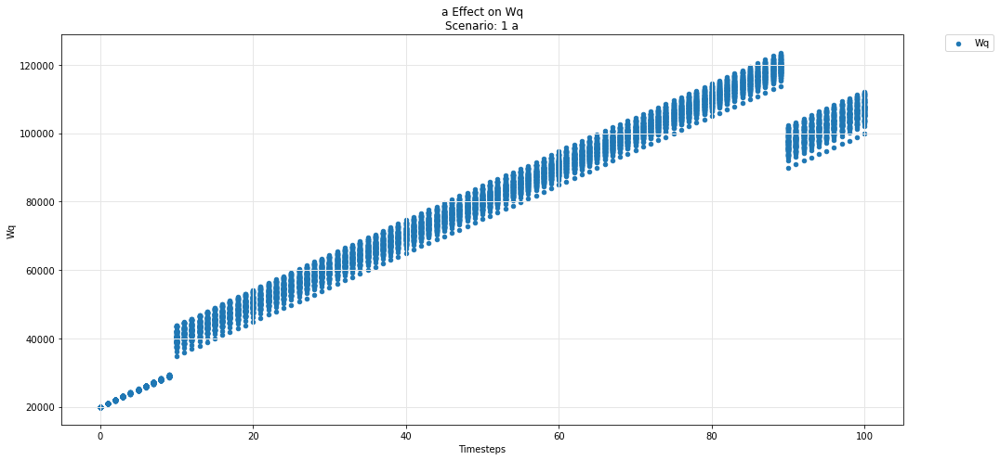

In [58]:
param_test_plot(experiments, config_ids, 'a', 'Wq')

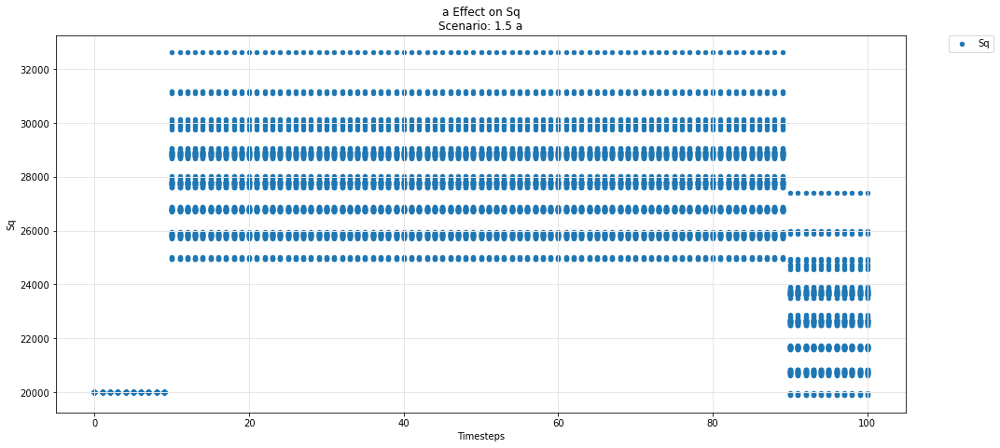

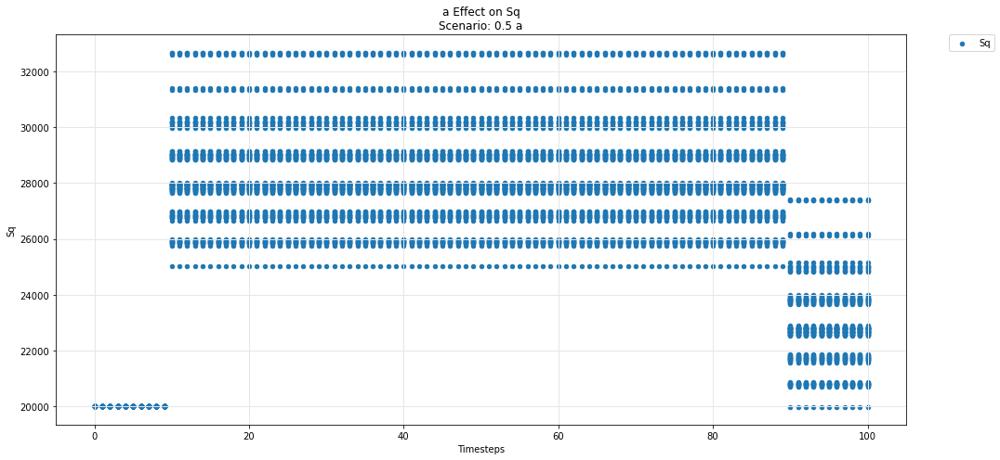

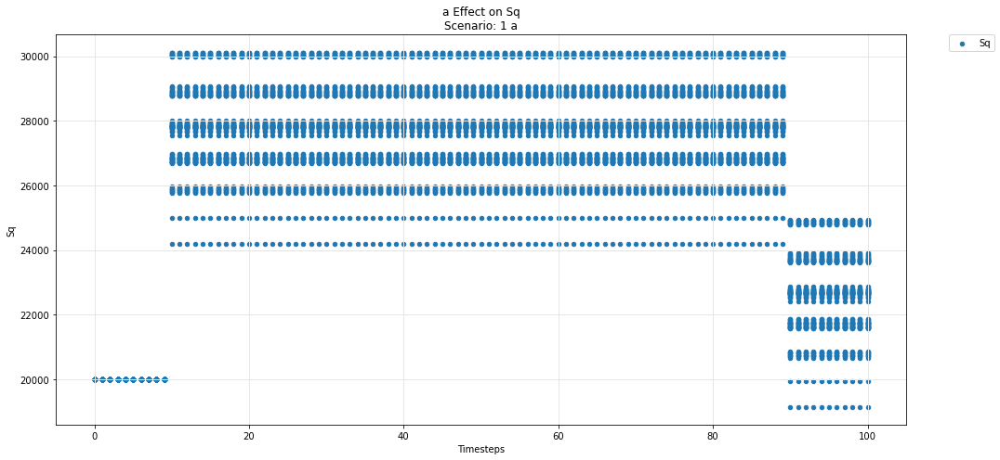

In [59]:
param_test_plot(experiments, config_ids, 'a', 'Sq')

## Hydra -- pool

Movement of the Omnipool variables
- Asset i
- Asset j
- Asset k

over the course of the simulation

In [60]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

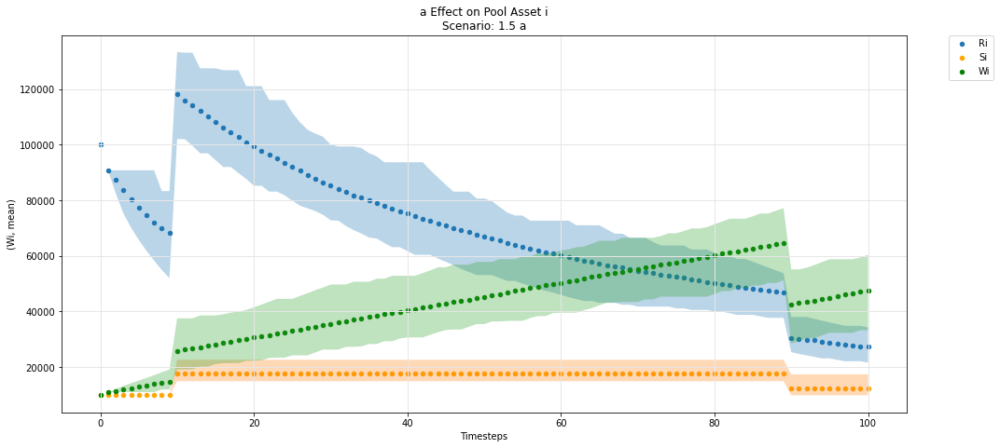

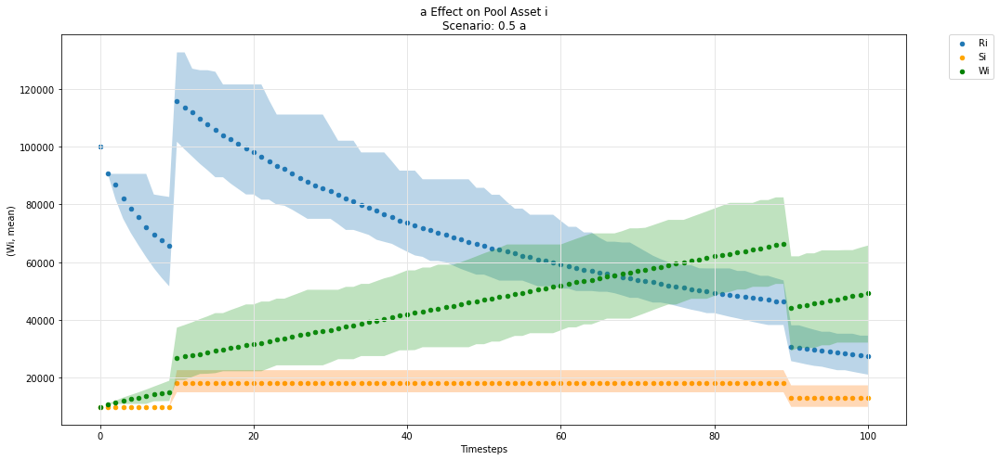

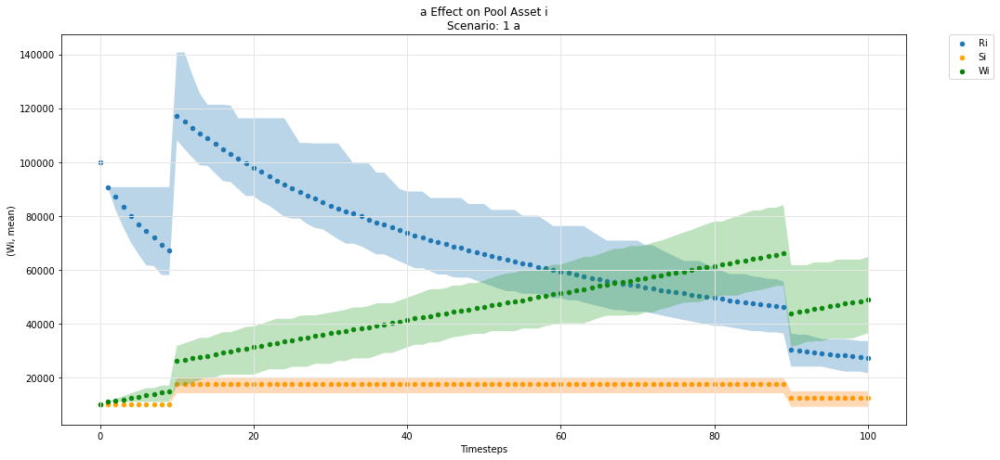

In [61]:
param_pool_simulation_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

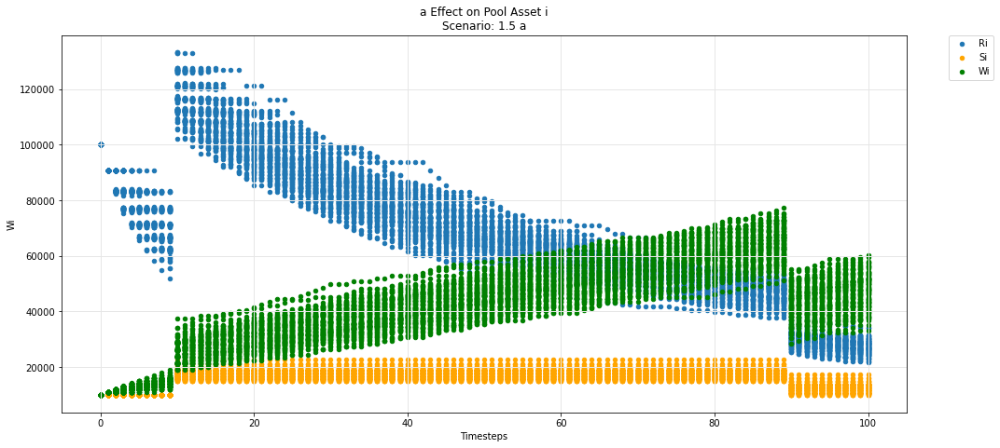

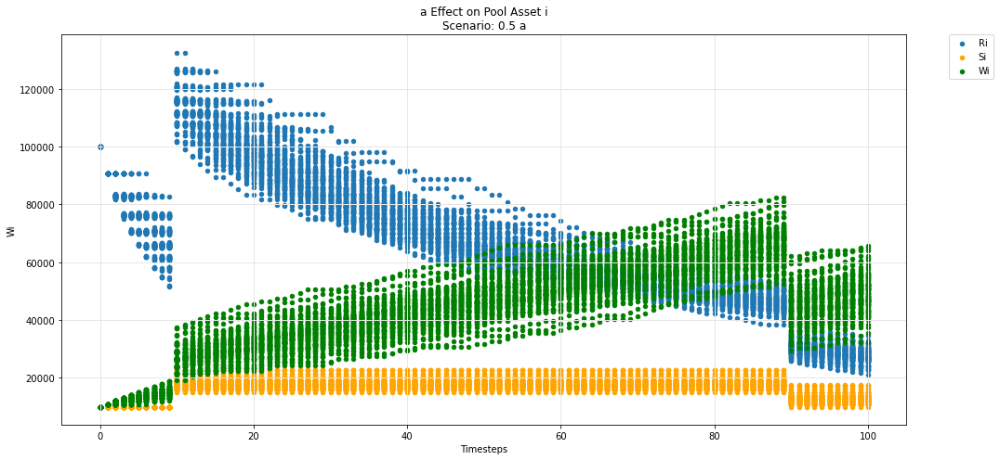

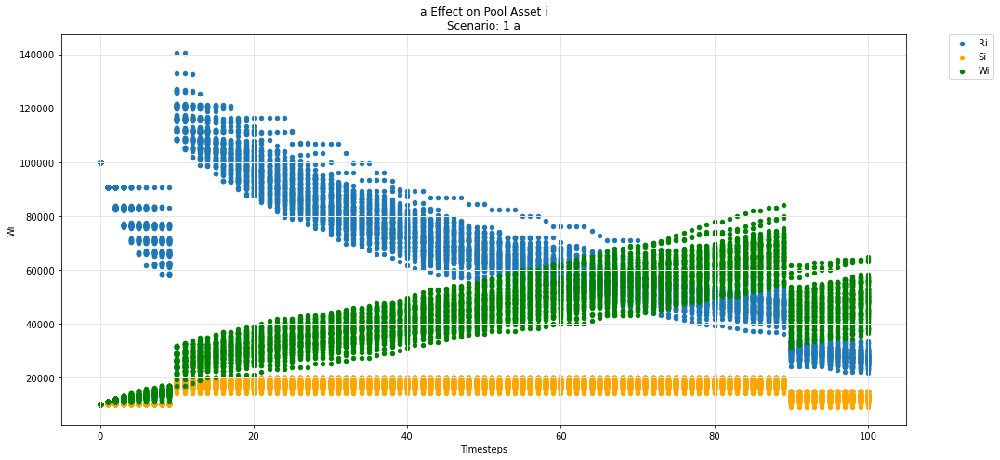

In [62]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

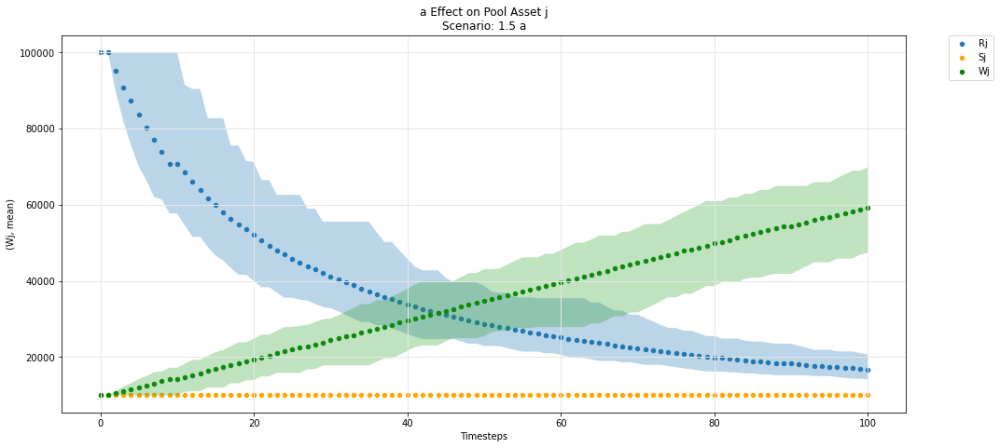

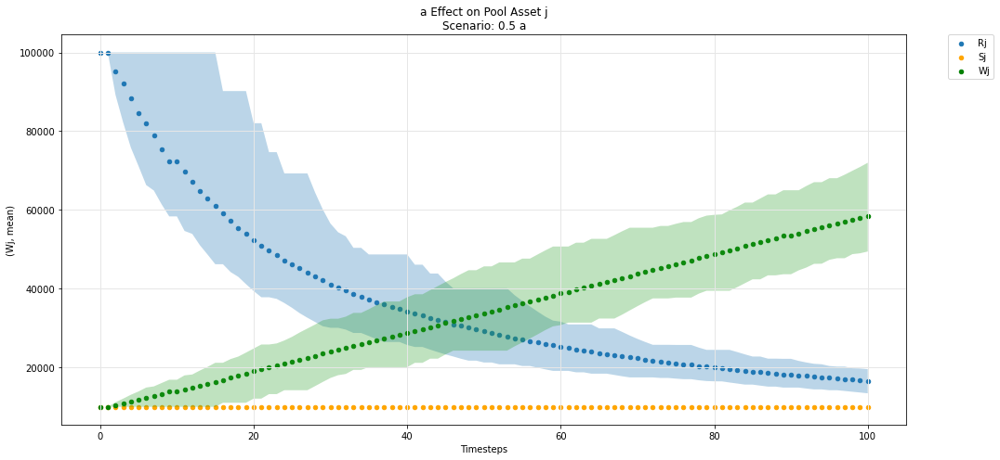

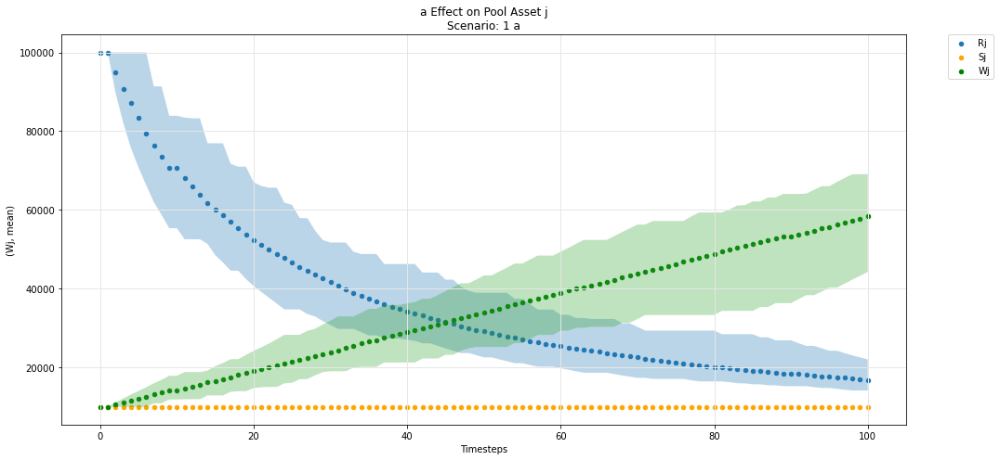

In [63]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

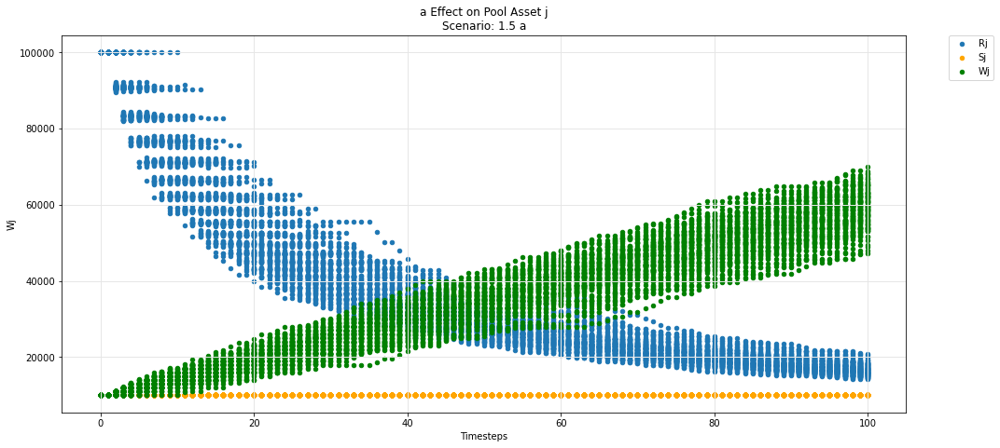

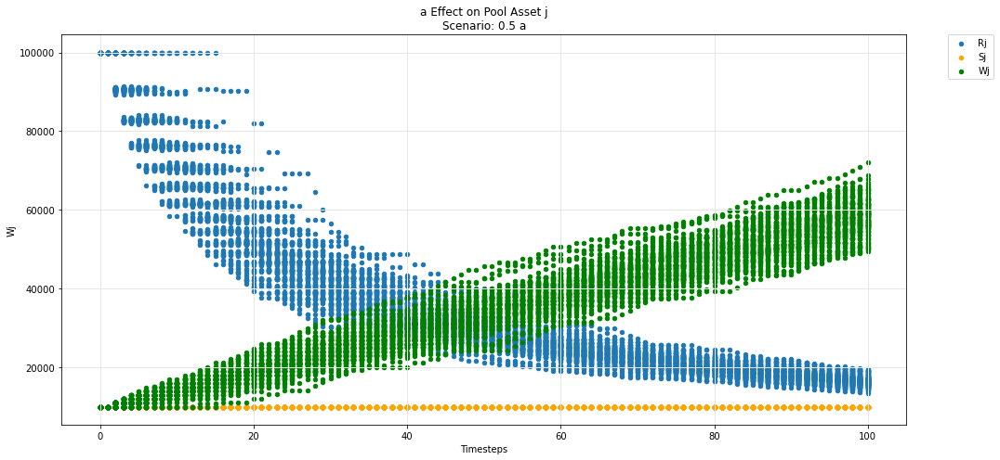

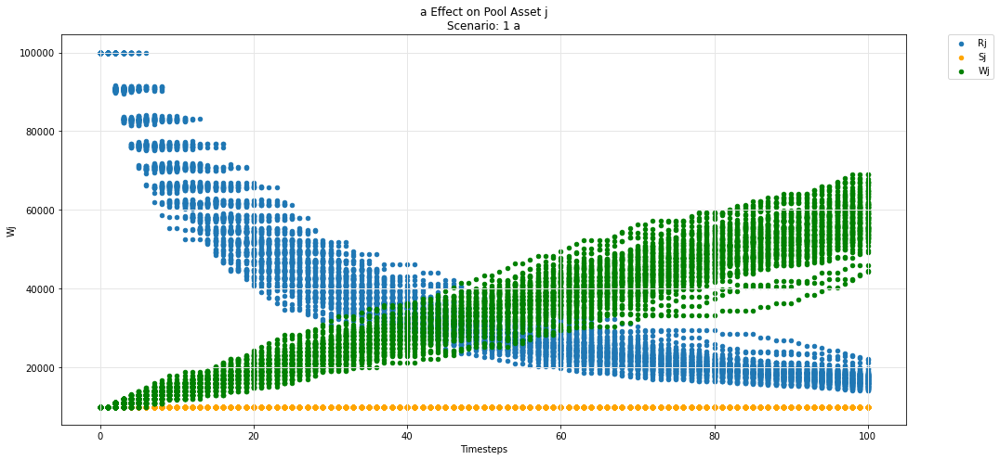

In [64]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

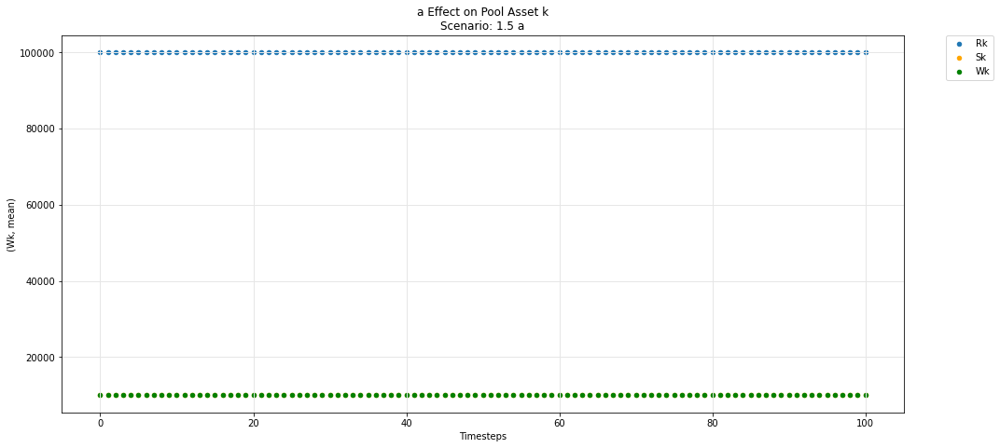

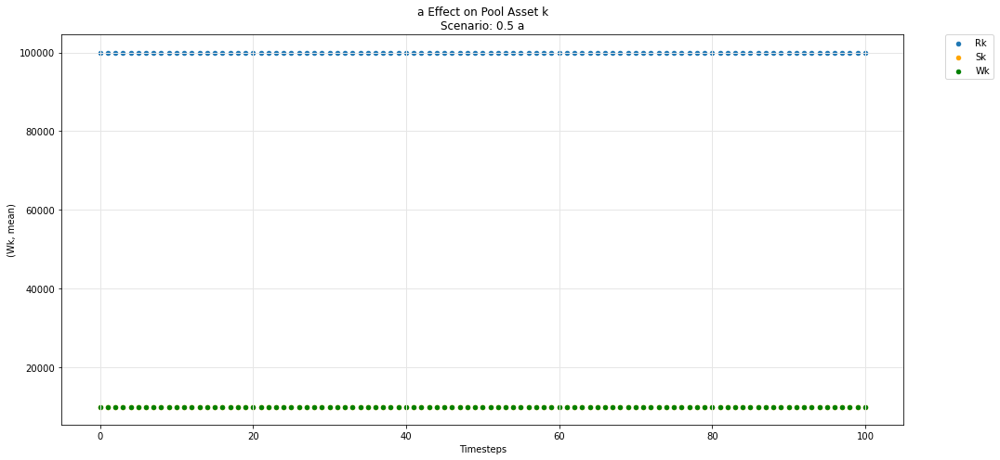

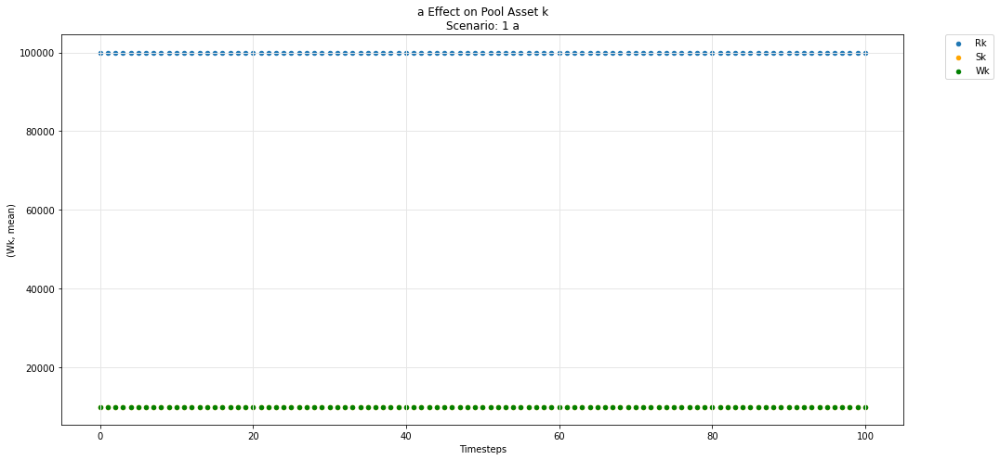

In [65]:
param_pool_simulation_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

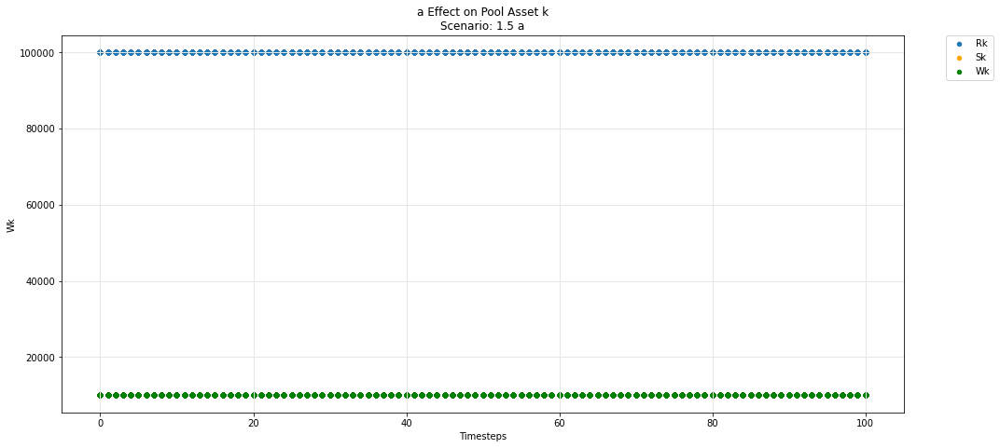

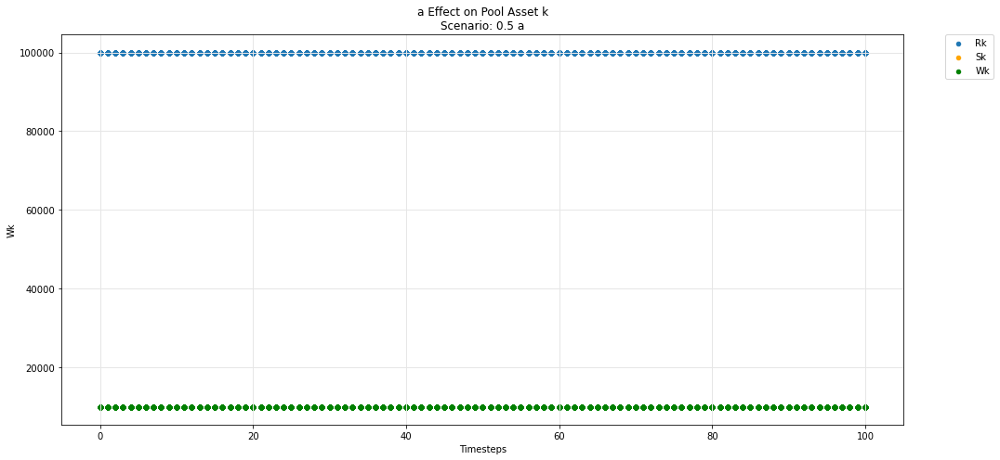

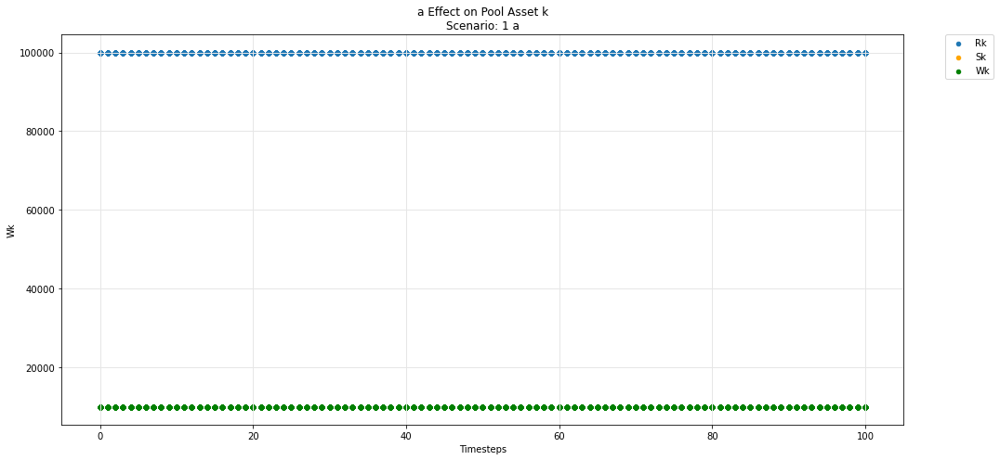

In [66]:
param_pool_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

In [67]:
def param_pool_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=df_label, label=df_label, ax=ax, legend=True, kind ='scatter')

        for count, arg in enumerate(args):
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))

            df.plot(x='timestep', y=df_arg_label, label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

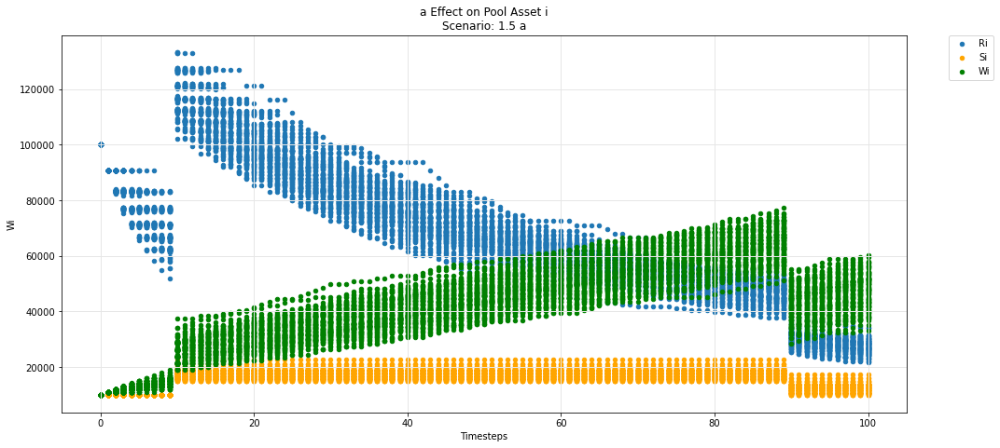

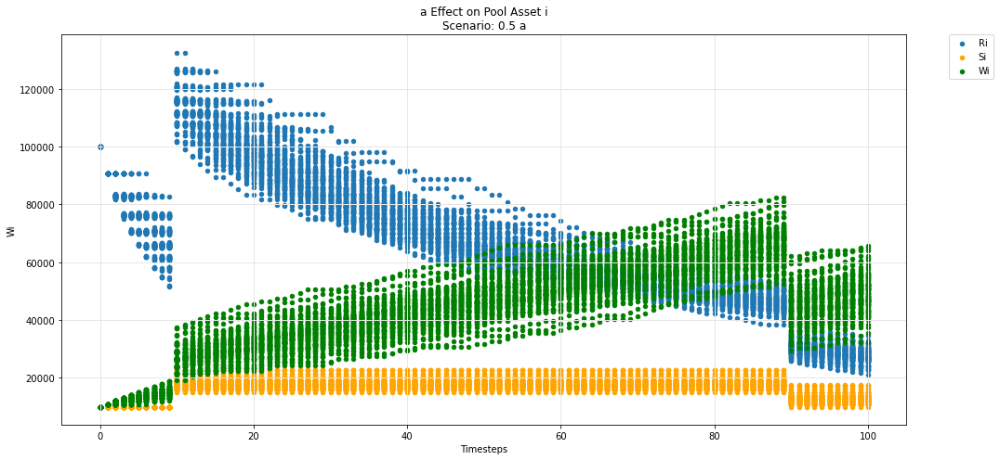

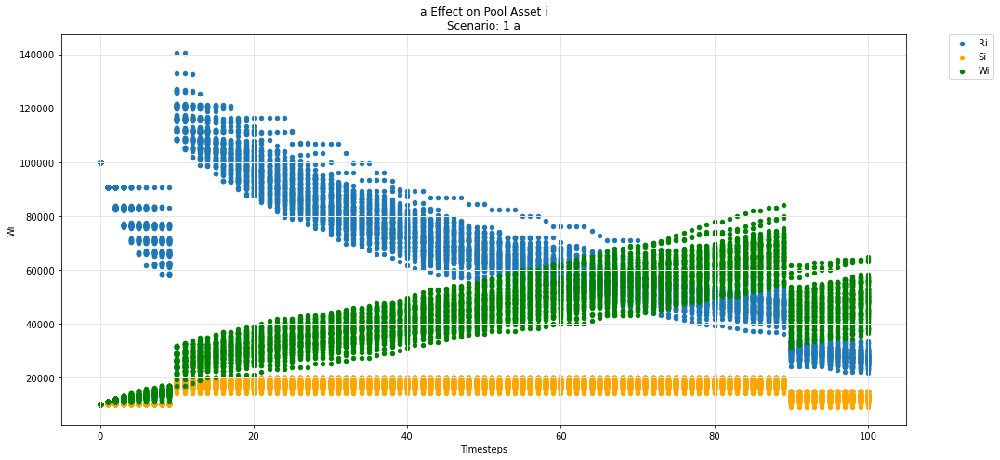

In [68]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

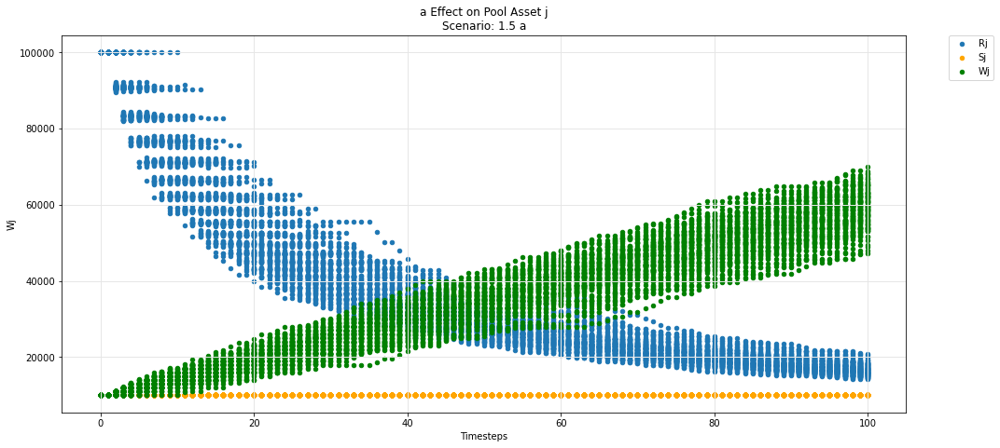

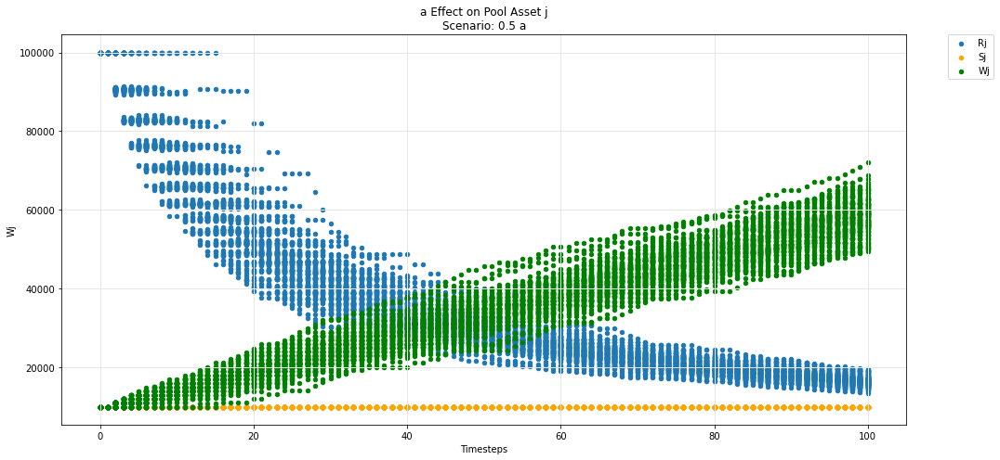

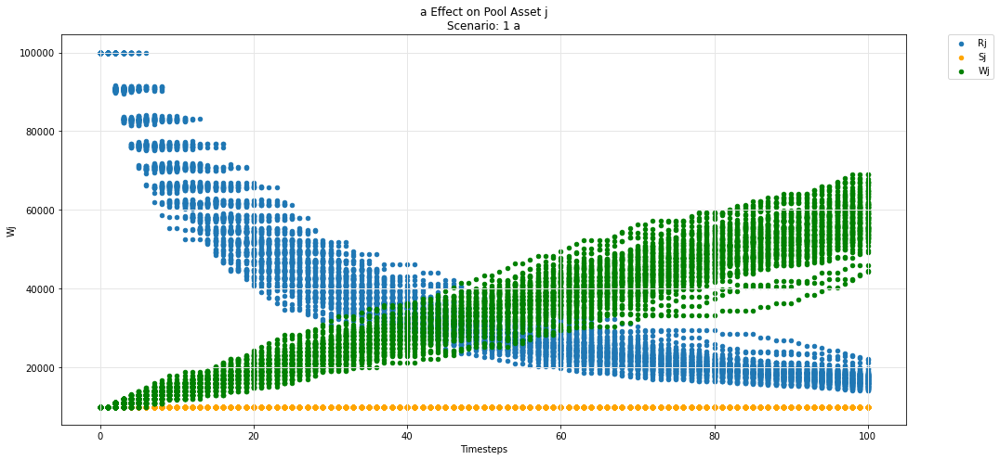

In [69]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

In [70]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

# Prices

## Uniswap

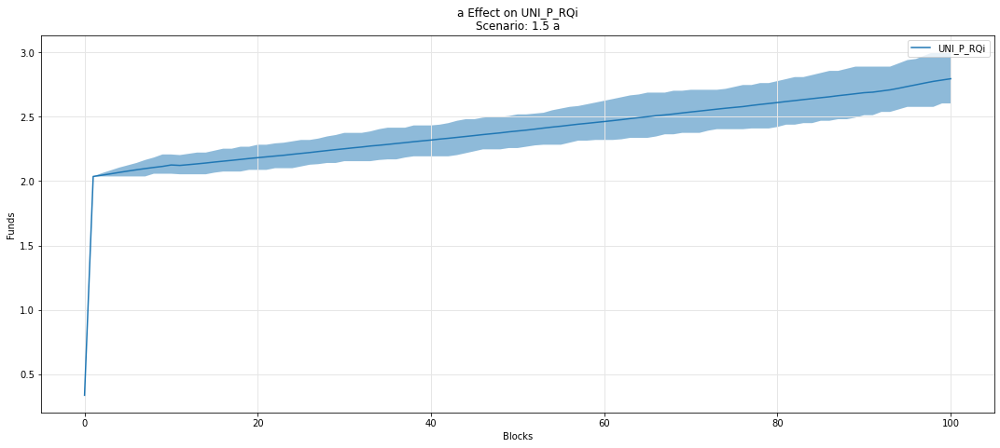

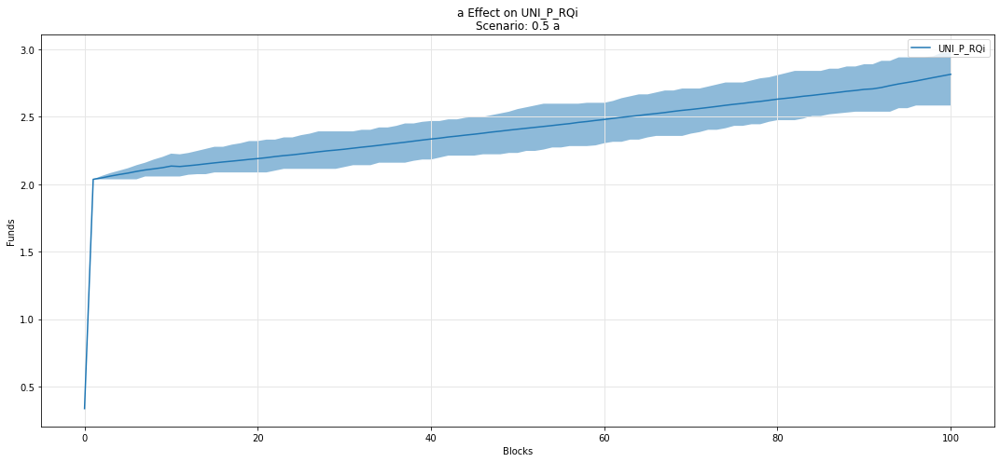

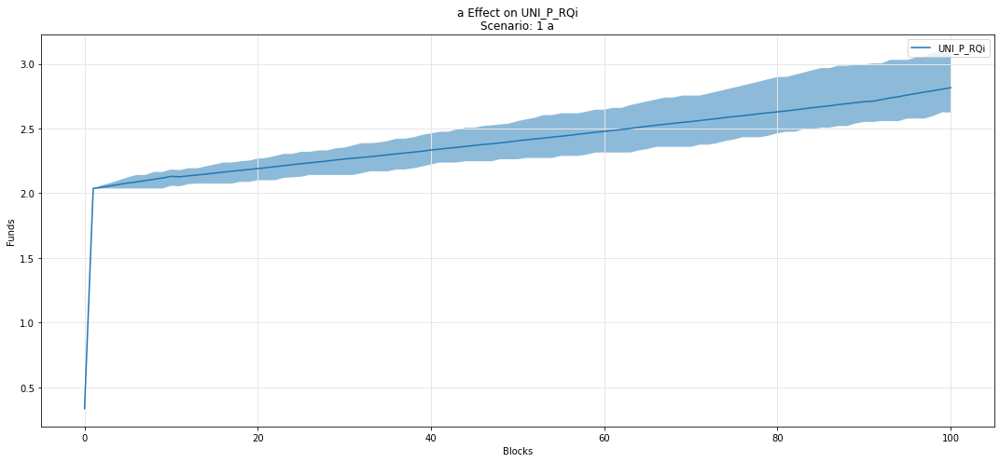

In [71]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQi')

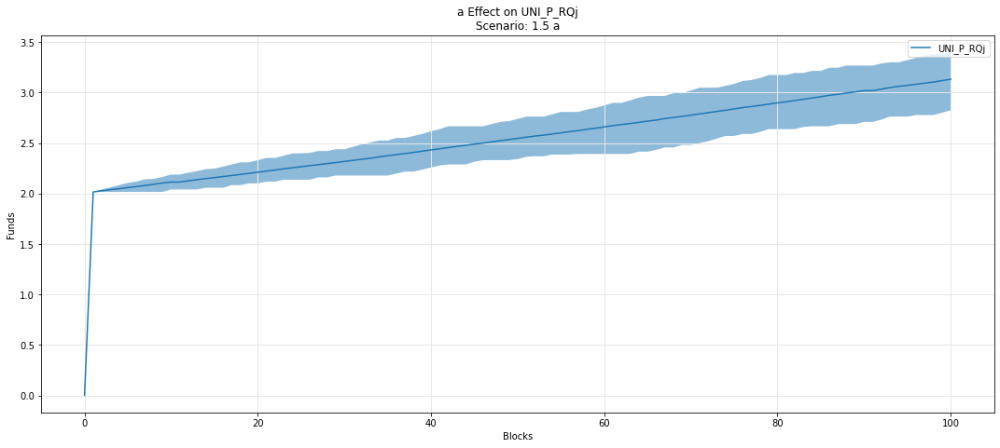

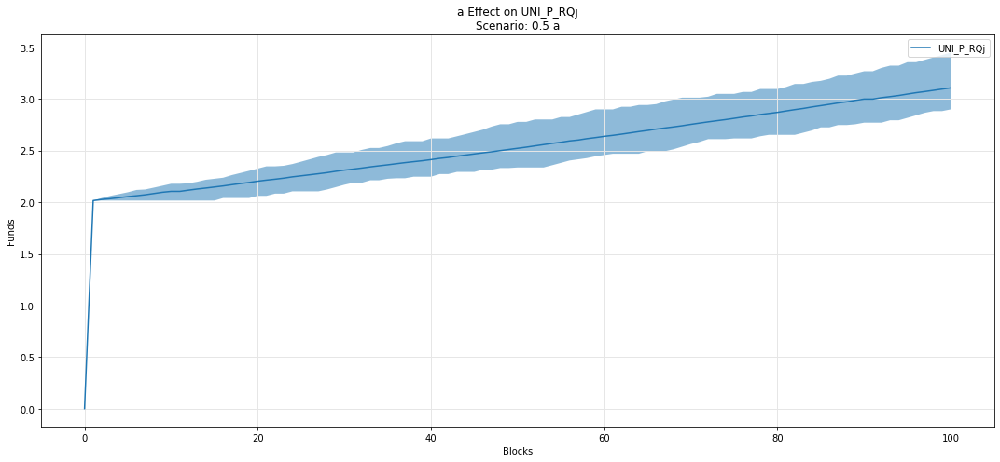

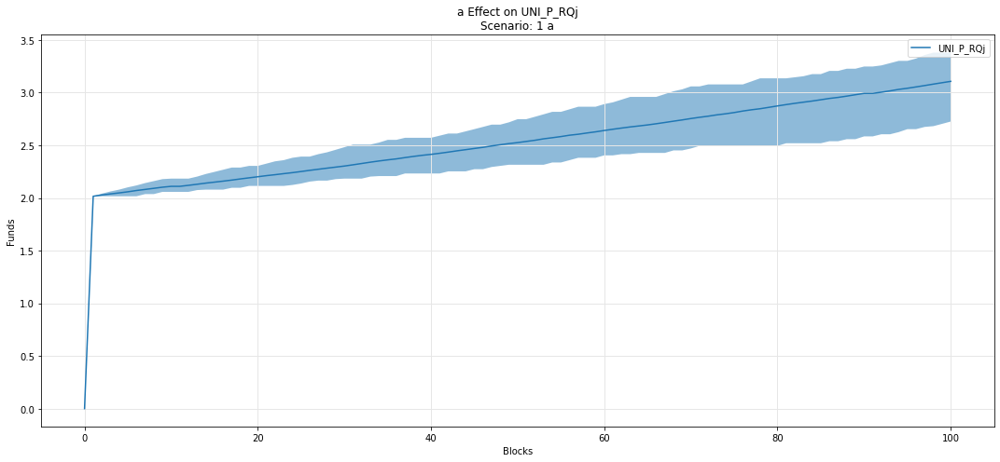

In [72]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQj')

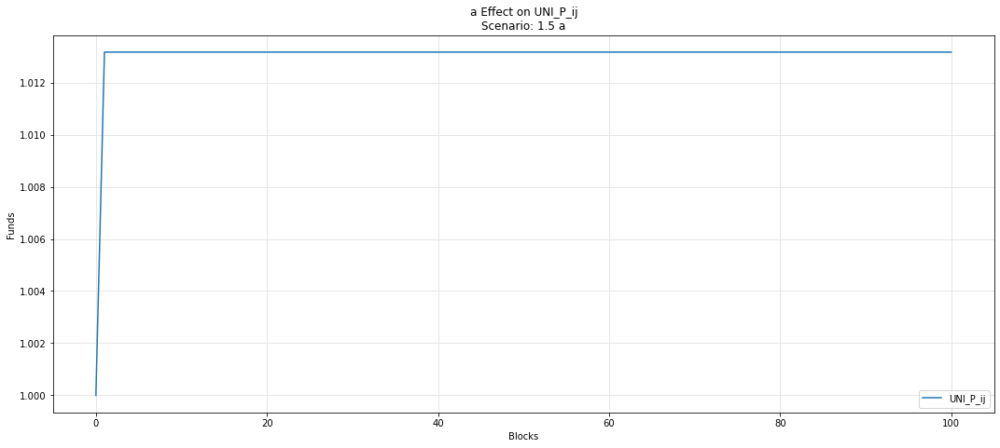

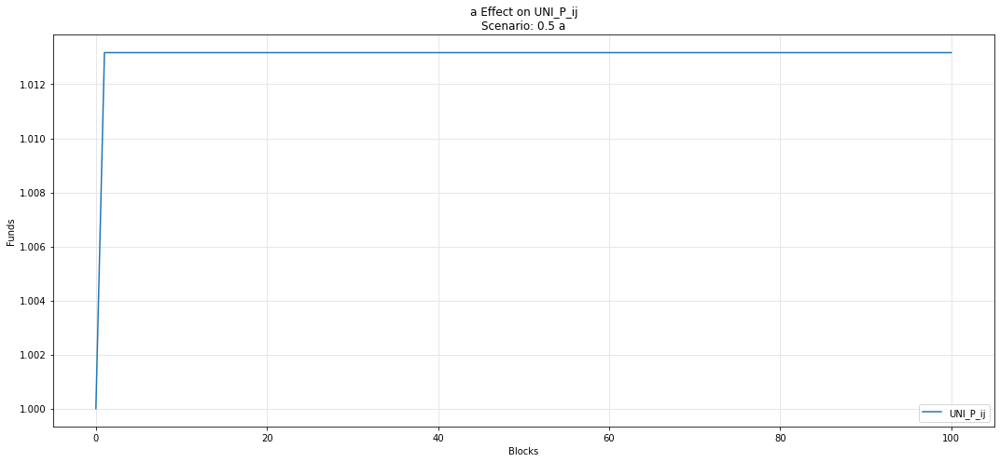

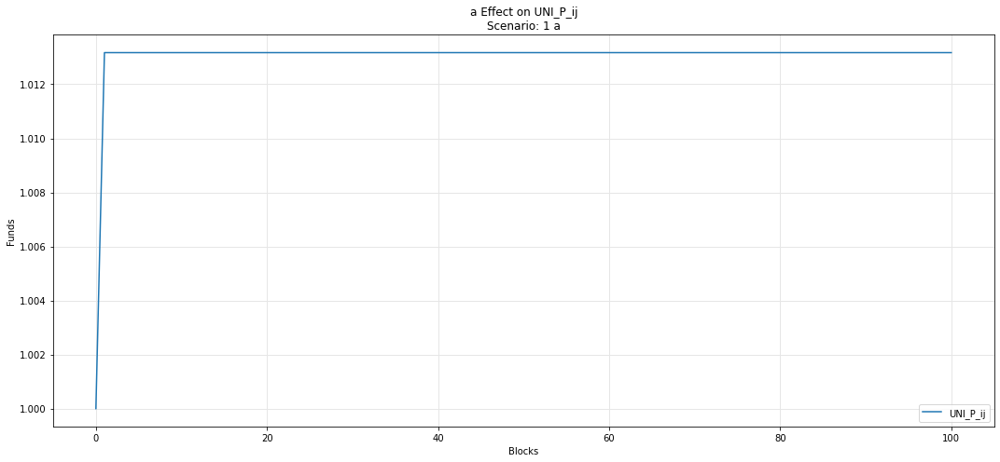

In [73]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_ij')

## Omnipool

## Asset i

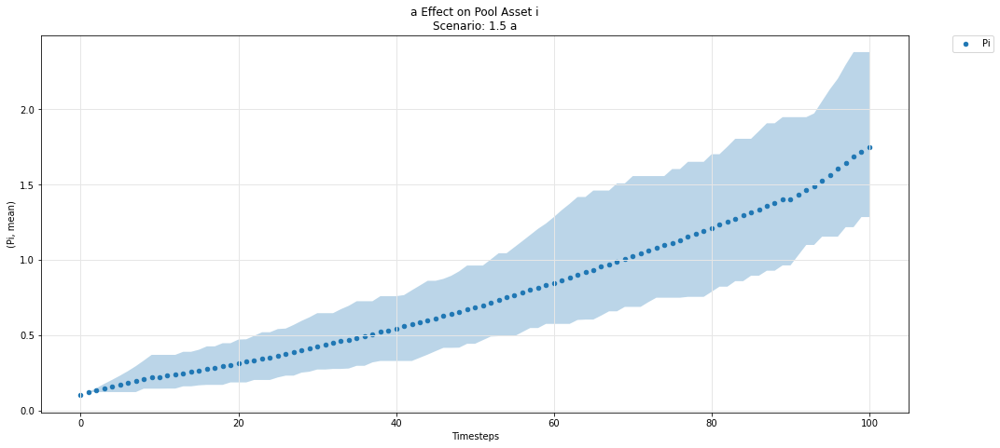

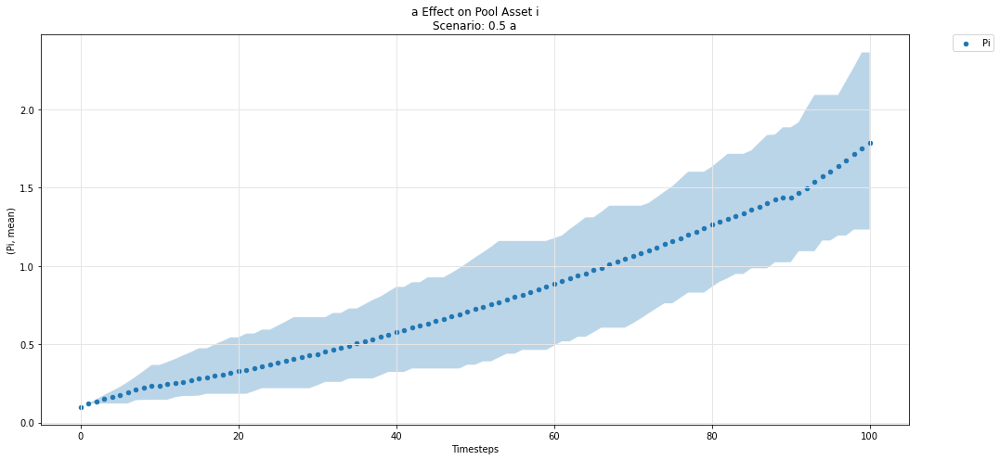

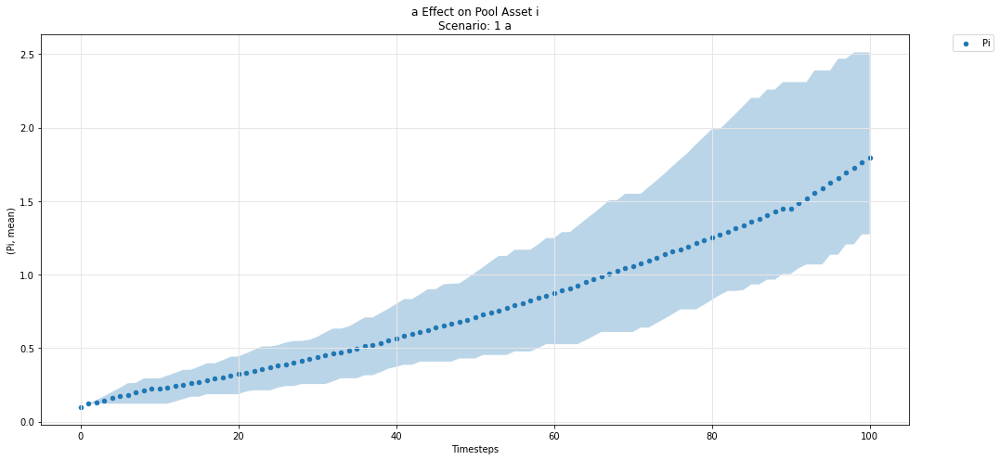

In [74]:
param_pool_simulation_plot(experiments, config_ids, 'a','i','P')

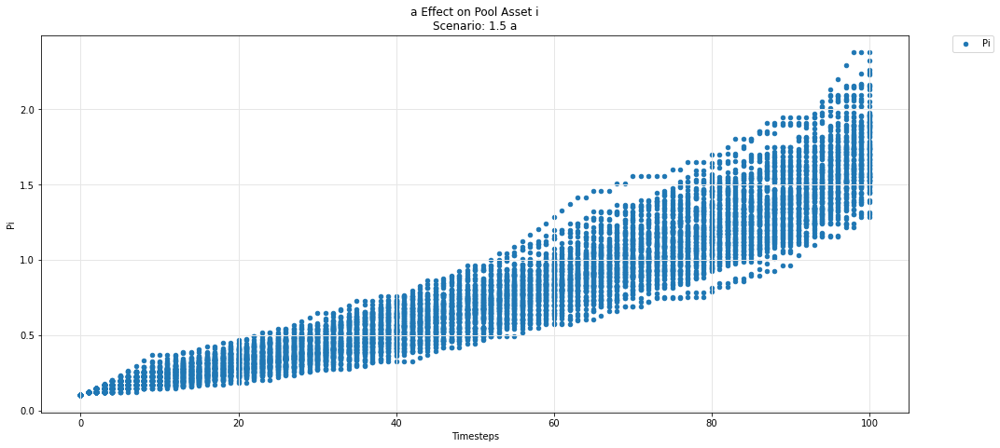

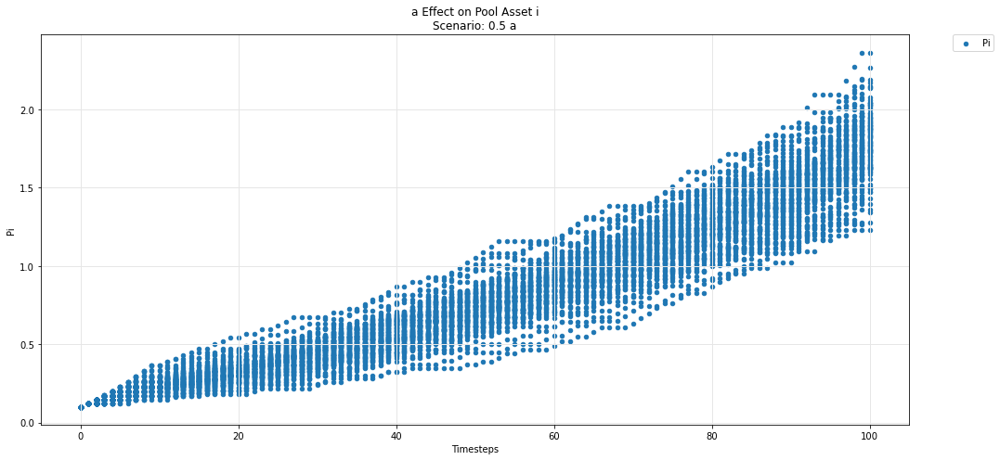

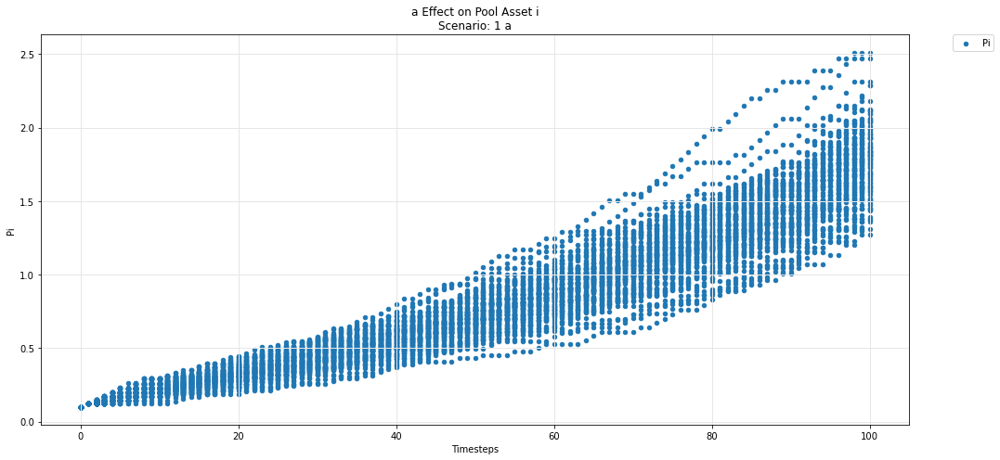

In [75]:
param_pool_plot(experiments, config_ids, 'a','i','P')

## Asset j

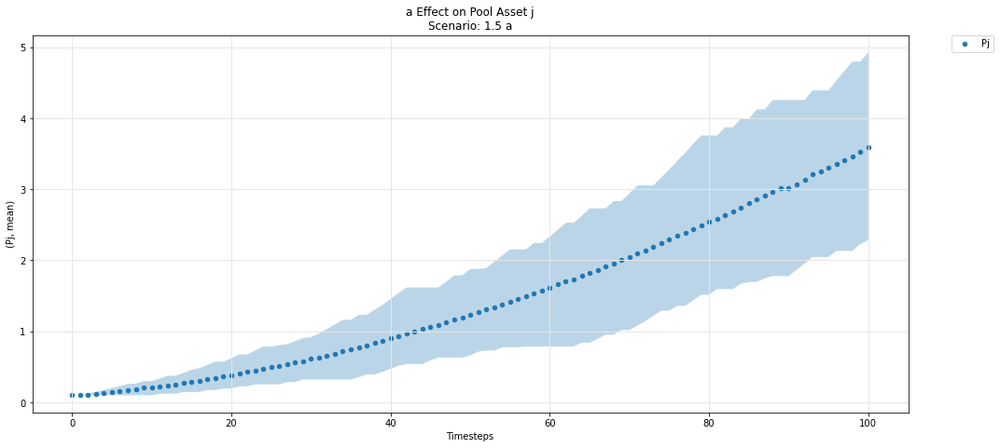

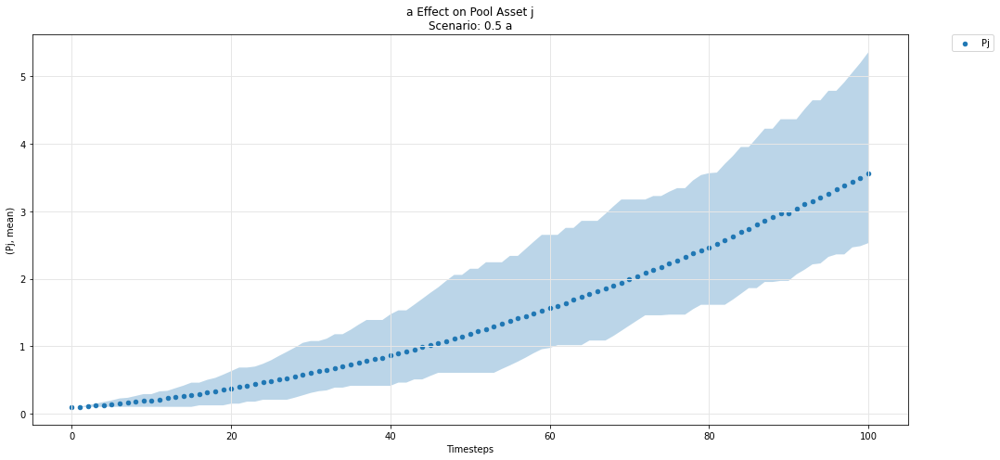

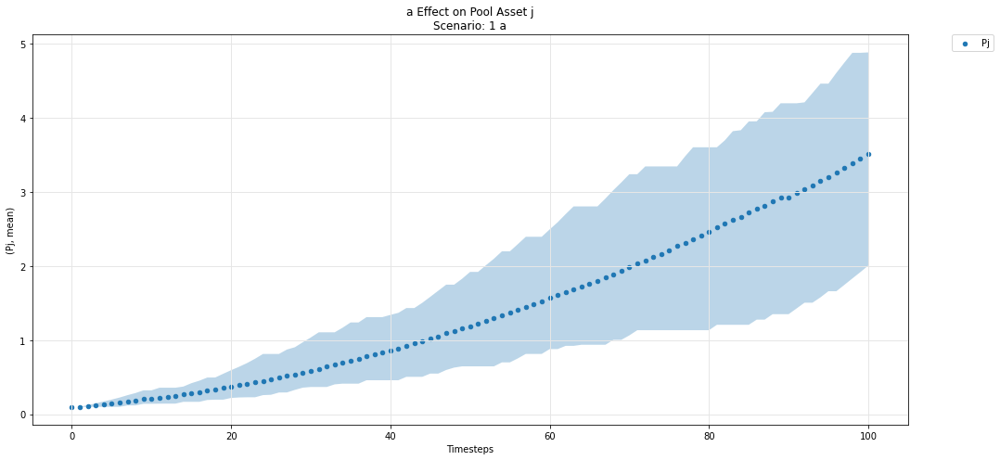

In [76]:
param_pool_simulation_plot(experiments, config_ids, 'a','j','P')

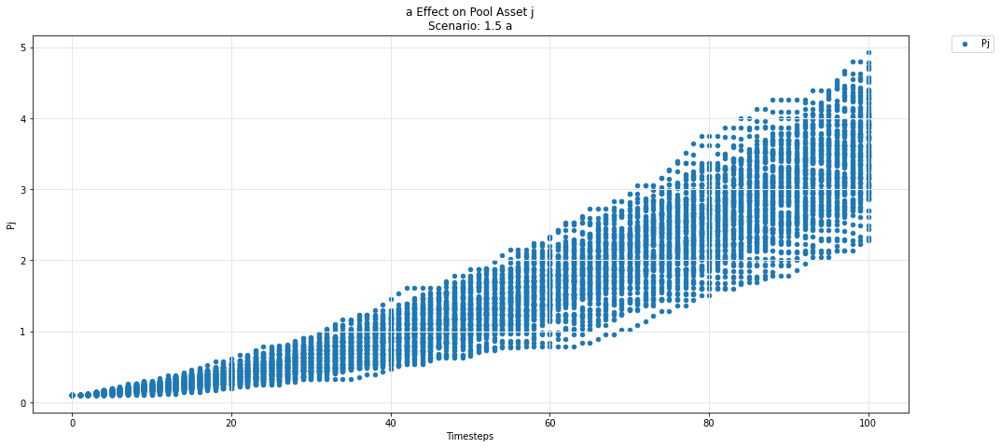

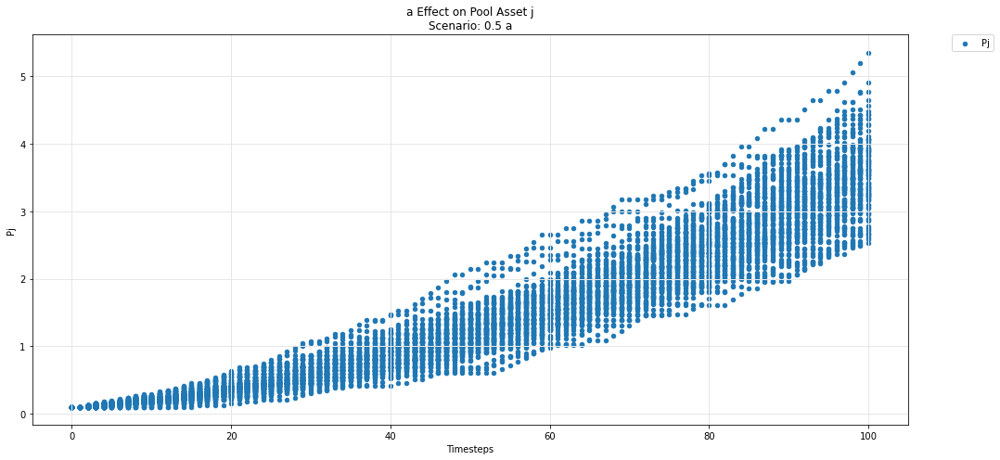

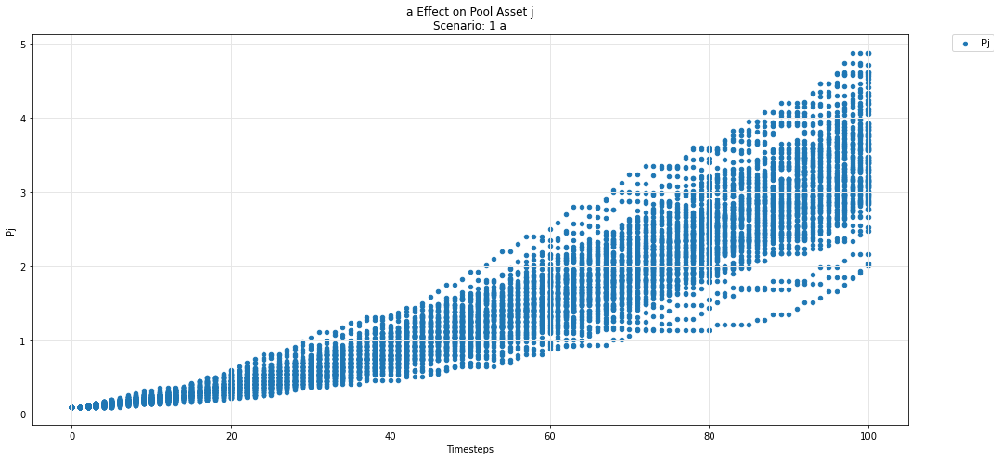

In [77]:
param_pool_plot(experiments, config_ids, 'a','j','P')

## Asset k

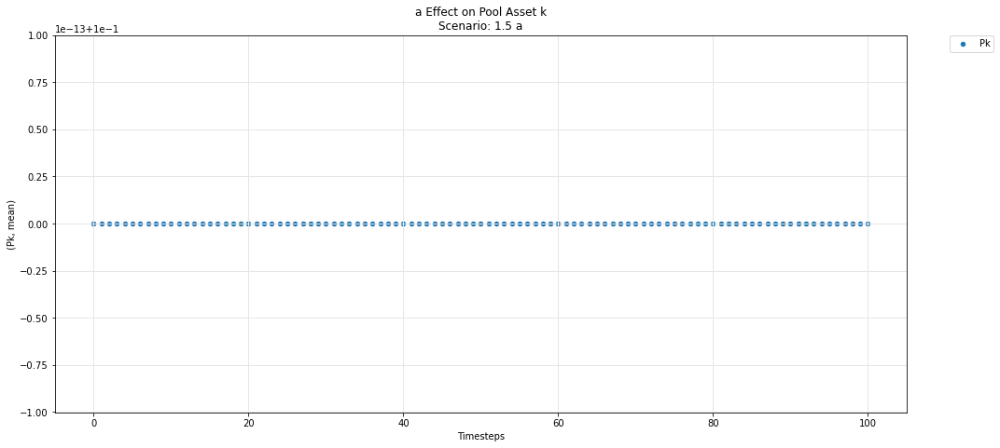

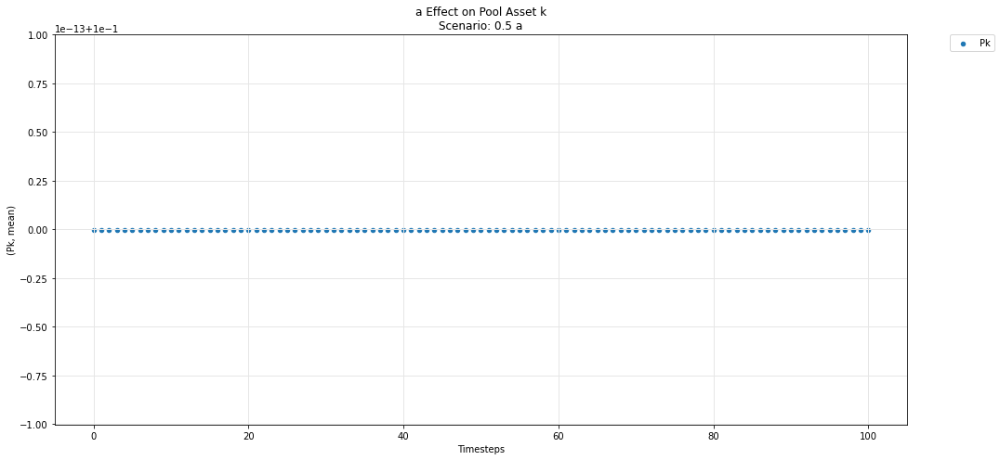

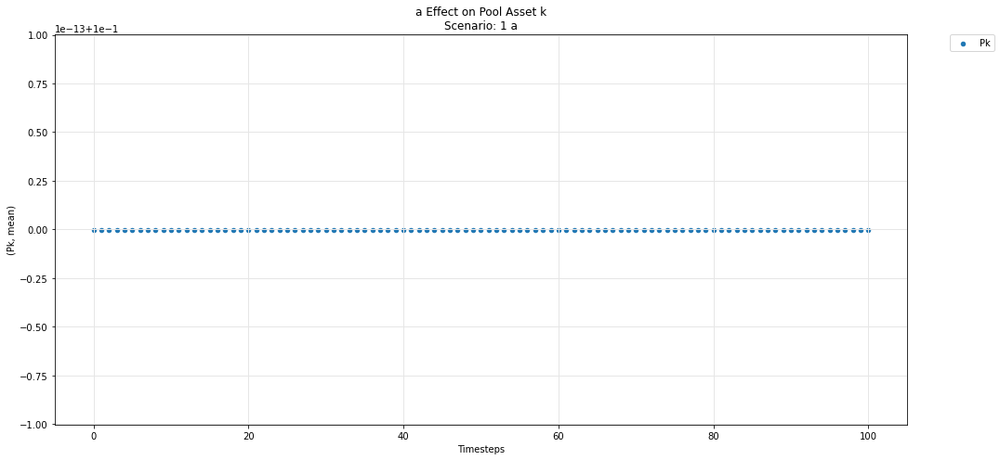

In [78]:
param_pool_simulation_plot(experiments, config_ids, 'a','k','P')

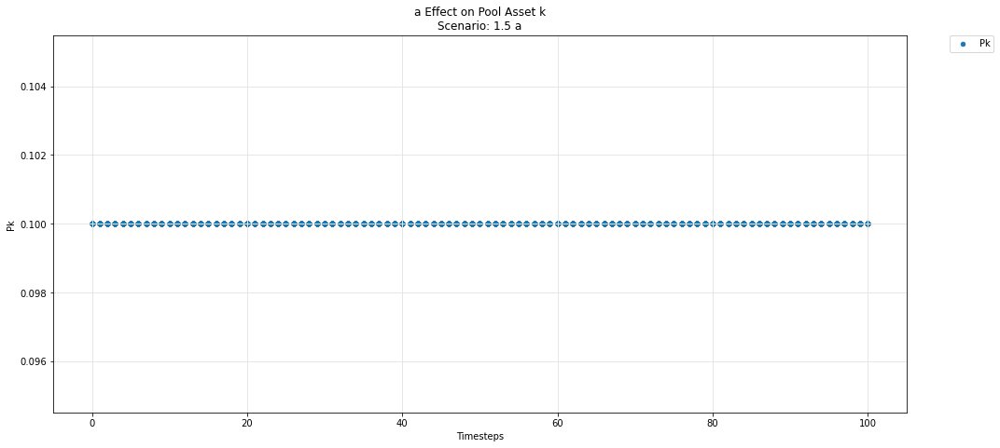

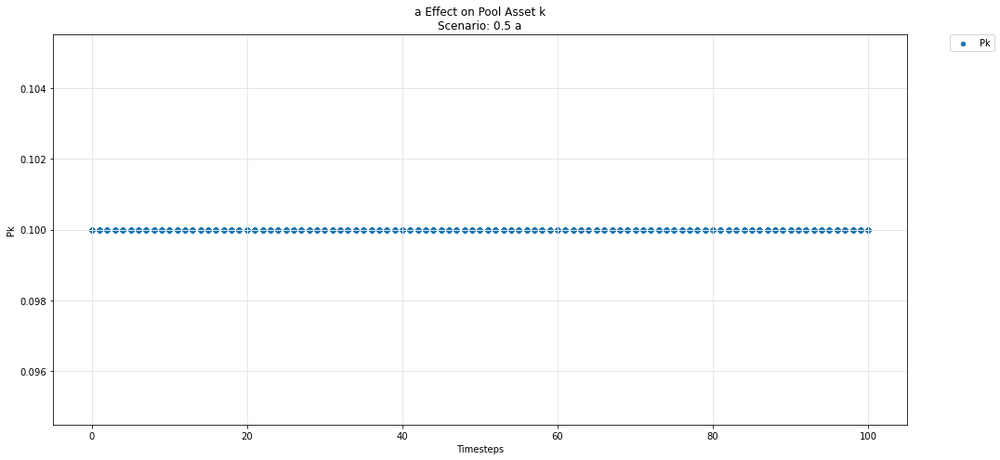

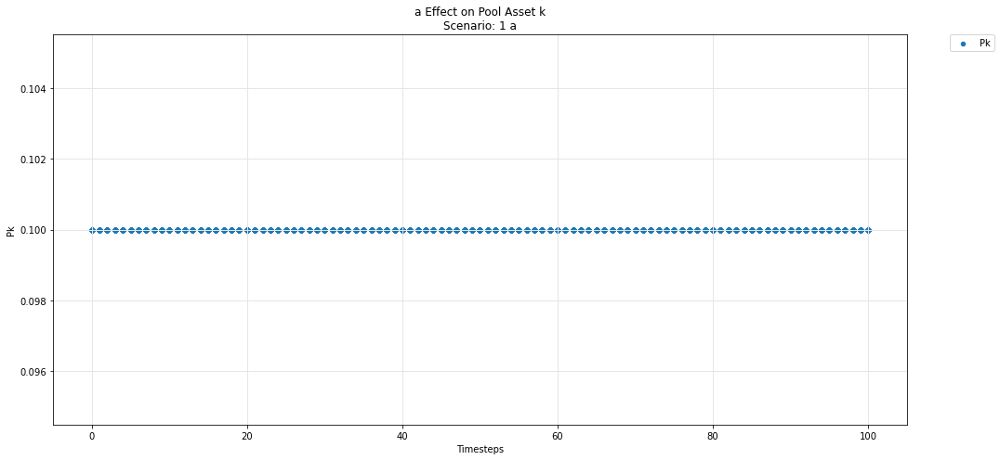

In [79]:
param_pool_plot(experiments, config_ids, 'a','k','P')